# MultiOmics RNA + ATAC for Chao dataset (MORNAATACC) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACC_5 notebook**

<hr>

In [ ]:
#Memory needed for a full run : 256Gb

In [17]:
#Early1               = P21208_1003_EAE_ARC
#PeakCtrl2            = P21208_1004_EAE_ARC
#Peak2                = P21208_1005_EAE_ARC
#LateCtrl1            = MORNAATACC_1002 (P21520_1002)
#Late1                = MORNAATACC_1003 (P21520_1003)
#Early2               = P23605_1001
#EarlyCtrl2           = P23605_1002
#Peak3                = P23605_1003
#PeakCtrl3            = P23605_1004
#EarlyCtrl3           = P24115_1001
#EarlyFemale3         = P24115_1002
#EarlyMale3           = P24115_1003
#Late2                = P25316_1001
#LateCtrl2            = P25316_1002
#Late3                = P25316_1003
#LateCtrl3            = P25316_1004
#PeakMale4            = P27208_1001
#PeakFemale4          = P27208_1002
#LateMale4            = P27208_1003
#LateFemale4          = P27208_1004
#Naive1               = P26203_1003
#Naive2               = P26203_1004
#Peak5                = P29557_1001
#Late5                = P29557_1002
#Naive3               = P29557_1004
#EarlyCtrl4           = P29557_1005
#EarlyCtrlMale5       = P29557_1006
#EarlyCtrlFemale5     = P29557_1007
#Early4               = P29557_1008
#EarlyMale5           = P29557_1009
#EarlyFemale5         = P29557_1010

## 0. Environment status

In [1]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [2]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [3]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              16
On-line CPU(s) list: 0-15
Thread(s) per core:  1
Core(s) per socket:  8
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               63
Model name:          Intel(R) Xeon(R) CPU E5-2630 v3 @ 2.40GHz
Stepping:            2
CPU MHz:             1206.591
CPU max MHz:         3200.0000
CPU min MHz:         1200.0000
BogoMIPS:            4799.57
Virtualization:      VT-x
L1d cache:           512 KiB
L1i cache:           512 KiB
L2 cache:            4 MiB
L3 cache:            40 MiB
NUMA node0 CPU(s):   0-7
NUMA node1 CPU(s):   8-15
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_tsc

In [4]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

257675


In [5]:
apt list --installed

Listing... Done
adduser/focal,now 3.118ubuntu2 all [installed]
apt-transport-https/focal-security,now 2.0.2ubuntu0.2 all [installed]
apt/focal-security,now 2.0.2ubuntu0.2 amd64 [installed]
autoconf/focal,now 2.69-11.1 all [installed,automatic]
automake/focal,now 1:1.16.1-4ubuntu6 all [installed,automatic]
autotools-dev/focal,now 20180224.1 all [installed,automatic]
base-files/focal,now 11ubuntu5 amd64 [installed]
base-passwd/focal,now 3.5.47 amd64 [installed]
bash/focal,now 5.0-6ubuntu1 amd64 [installed,upgradable to: 5.0-6ubuntu1.2]
binutils-common/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
binutils-x86-64-linux-gnu/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
binutils/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
bsdutils/focal,now 1:2.34-0.1ubuntu9 amd64 [installed,upgradable to: 1:2.34-0.1ubuntu9.3]
build-essential/focal,now 12.8ubuntu1 amd64 [installed]
bzip2/focal,now 1.0.8-2 amd64 [installed,automatic]
ca-certificates-java/f

In [7]:
pip list

Package              Version             
-------------------- --------------------
anndata              0.8.0               
ansiwrap             0.8.4               
anyio                3.6.1               
argon2-cffi          21.3.0              
argon2-cffi-bindings 21.2.0              
asttokens            2.0.5               
attrs                21.4.0              
Babel                2.10.3              
backcall             0.2.0               
bash-kernel          0.7.2               
beautifulsoup4       4.11.1              
bleach               5.0.1               
calysto-bash         0.2.2               
certifi              2019.11.28          
cffi                 1.15.1              
chardet              3.0.4               
click                8.1.3               
cycler               0.11.0              
Cython               0.29.26             
dbus-python          1.2.16              
debugpy              1.6.0               
decorator            5.1.1        

In [8]:
jupyter --version

Selected Jupyter core packages...
IPython          : 8.4.0
ipykernel        : 6.15.0
ipywidgets       : 7.7.1
jupyter_client   : 7.3.4
jupyter_core     : 4.10.0
jupyter_server   : 1.17.0
jupyterlab       : 3.1.17
nbclient         : 0.5.13
nbconvert        : 6.4.4
nbformat         : 5.4.0
notebook         : 6.4.12
qtconsole        : 5.3.1
traitlets        : 5.3.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(mlbench)
library(caret)
library(e1071)
library(ggplot2)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(patchwork)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(circlize)
library(scales)
library(lisi)

#Multicore
library(future)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

#Doublet determination
library(DoubletFinder)

library(textclean)
library(mclust)

#ArchR
library(ArchR)
library(TxDb.Mmusculus.UCSC.mm10.knownGene)

library(muscat)
library(SingleCellExperiment)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect


Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading require

In [2]:
sessionInfo()

R version 4.3.2 (2023-10-31)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 22.04 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.10.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.10.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Etc/UTC
tzcode source: system (glibc)

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] EnhancedVolcano_1.20.0                   
 [2] DESeq2_1.42.1                            
 [3] Matrix.utils_0.9.8                       
 [4] limma_3.58.1                             
 [5] UpSetR_1.4.0                             
 [6] scater_1.30.1                            
 [7] 

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, layer = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = layer == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = LayerData(object = object, assay = assay, layer = layer))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", layer,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", layer, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = LayerData(object = object, assay = assay, layer = layer)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#BCC8BC
#A5B6A5
#8FA38F
#789178
#657B65
#536553
#404F40
#2E382E

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [6]:
names_Naive <- c("Naive1", "Naive2", "Naive3")
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4", "Late5")

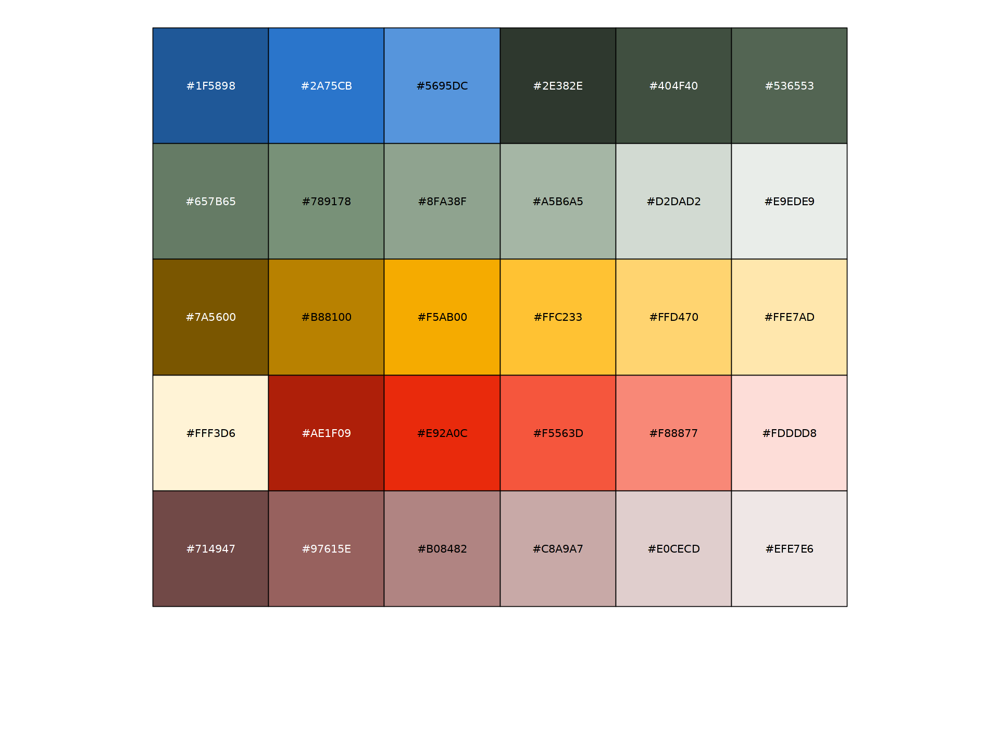

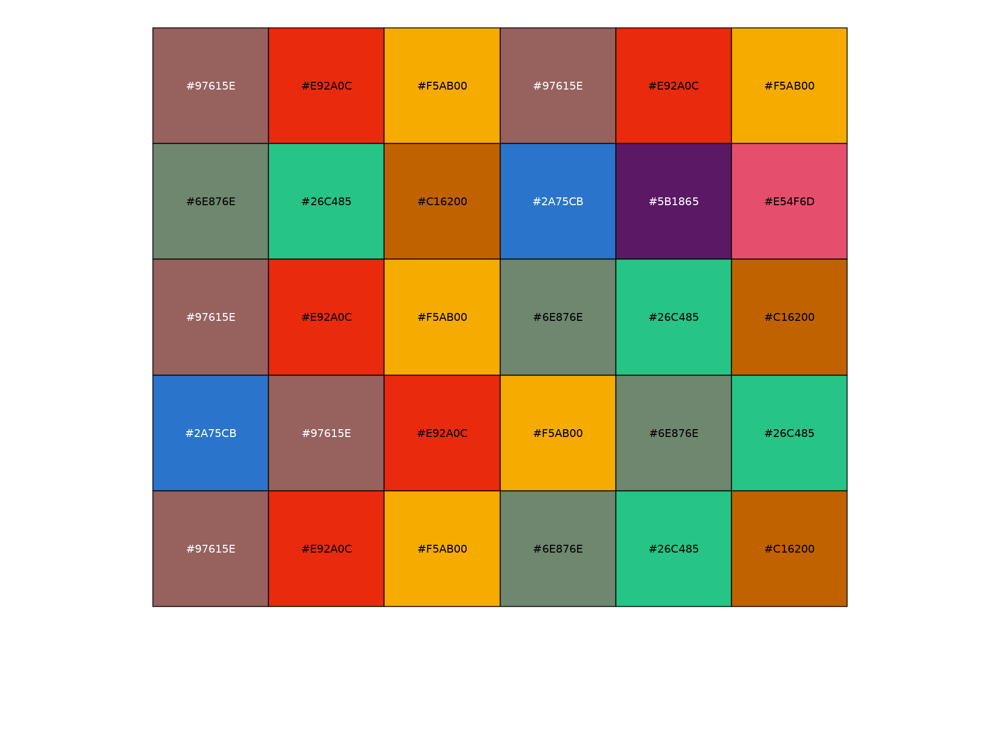

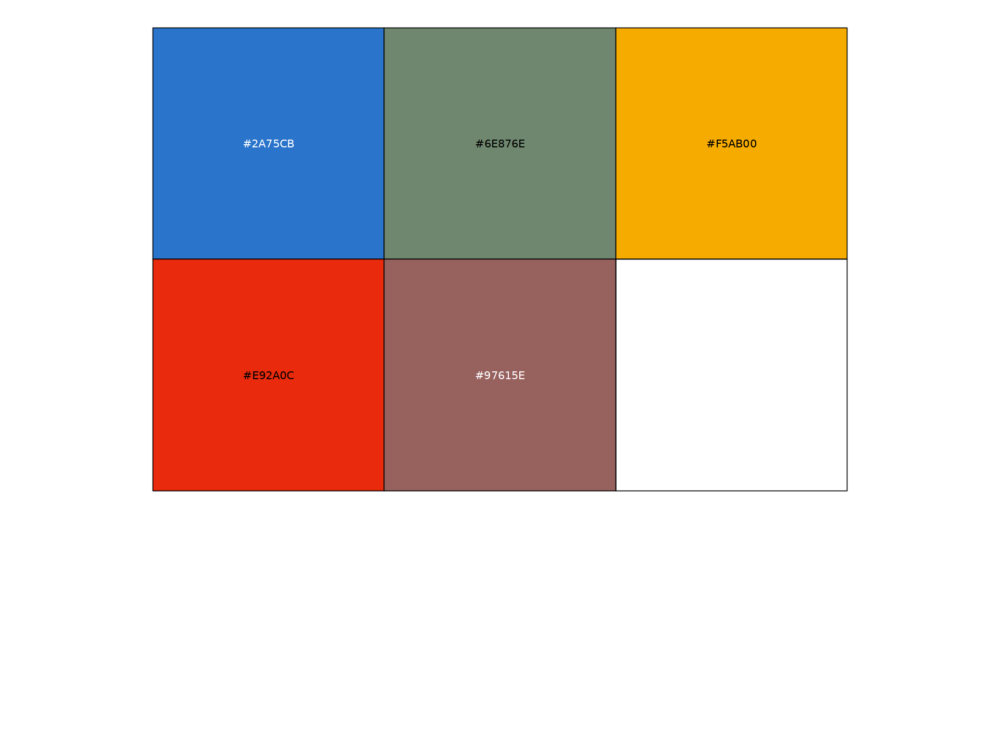

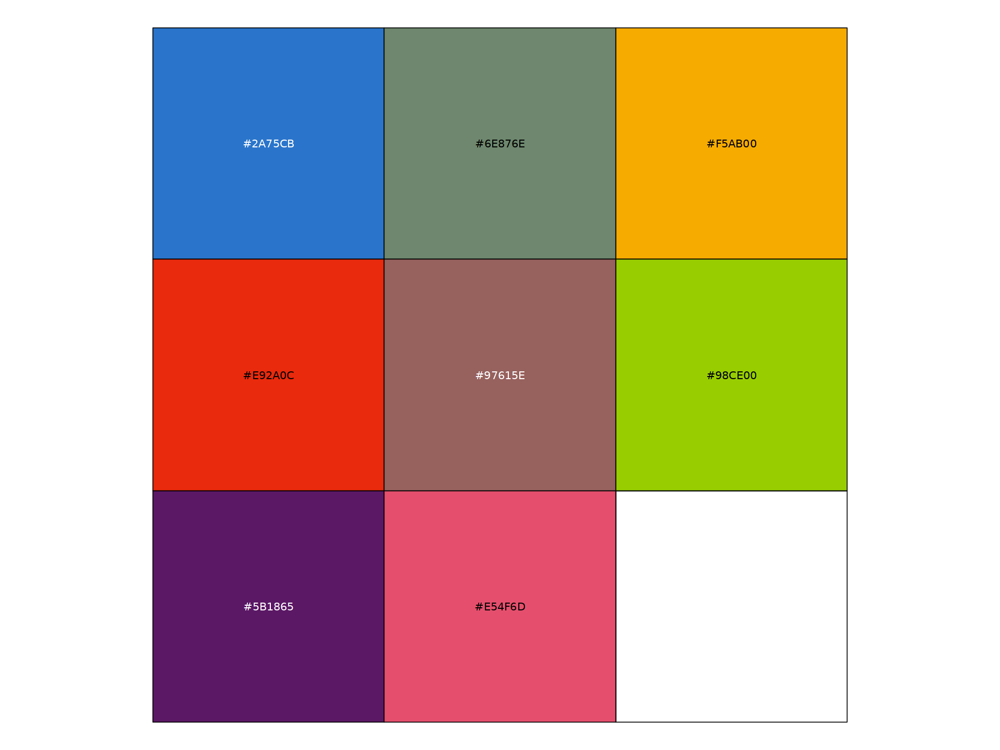

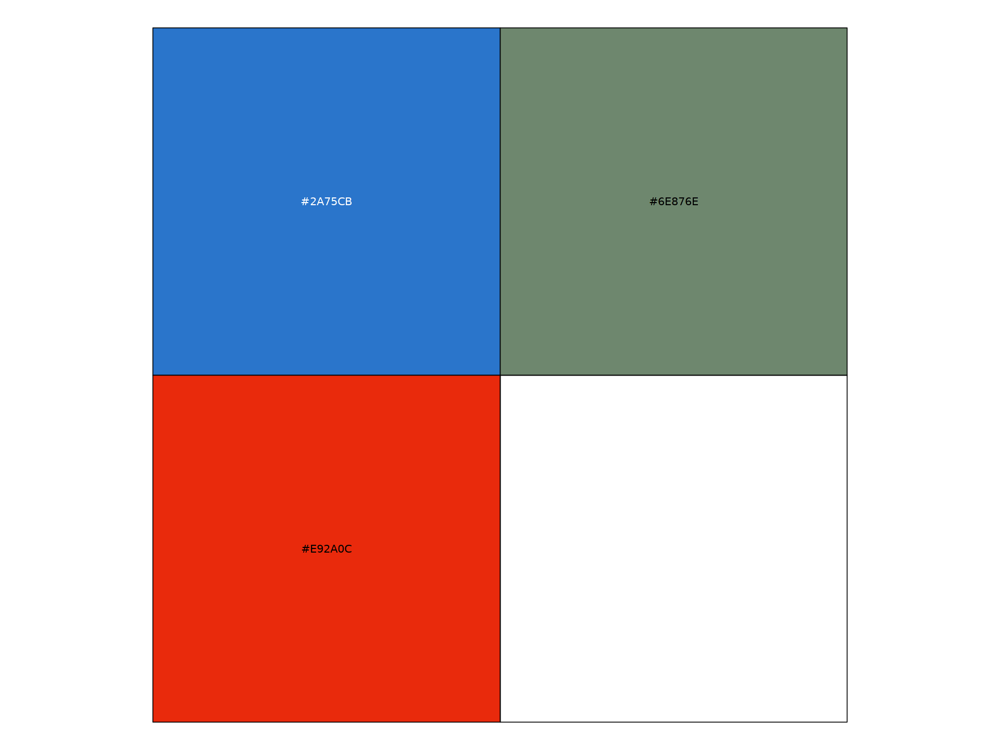

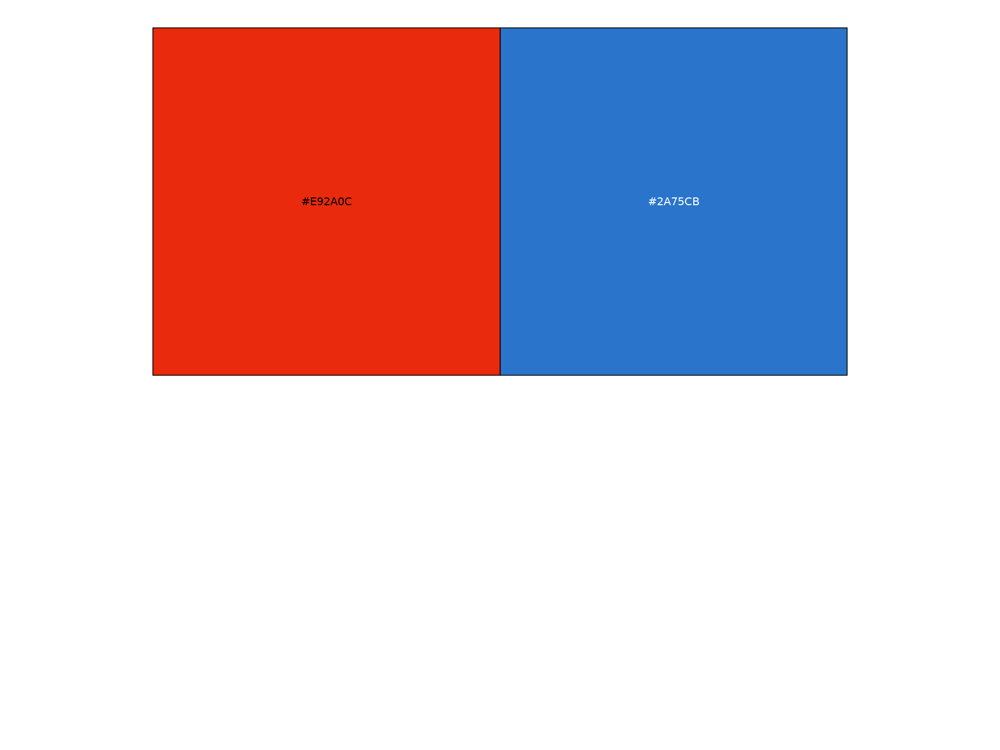

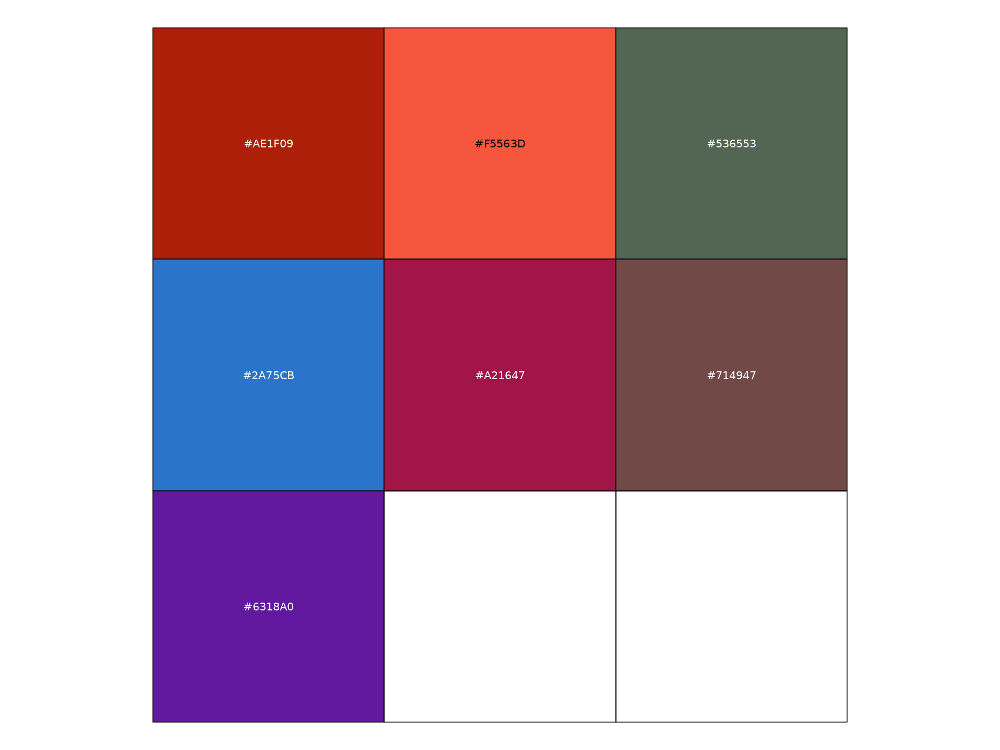

In [7]:
#Colors after removing LateCtrl1
orig.ident_colors <- c("#1F5898", "#2A75CB", "#5695DC", 
                       "#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#D2DAD2", "#E9EDE9", 
                       "#7A5600", "#B88100", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6",
                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8",
                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
names(orig.ident_colors) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
show_col(orig.ident_colors)
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#5B1865", "#E54F6D",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
names(orig.ident_colors_contrast) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
show_col(orig.ident_colors_contrast)

orig.ident_merge_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Naive", "Ctrl", "Early", "Peak", "Late")
show_col(orig.ident_merge_colors)

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00", "#5B1865", "#E54F6D")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6", "B7", "B8")
show_col(batch_colors)

model_colors <- c("#2A75CB", "#6E876E", "#E92A0C")
names(model_colors) <- c("Naive", "Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#E92A0C", "#2A75CB")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("F", "M")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

modality_colors <- c("lightgrey", "blue", "orange", "red")
names(modality_colors) <- c("None", "RNA", "GenePromAcc", "Both")
#show_col(modality_colors)

damage_colors <- c("#A9DFBF", "#D0CCD0")
names(damage_colors) <- c("NonDamage", "Damage")
#show_col(damage_colors)

interferon_colors <- c("#A9DFBF", "#86CAEA")
names(interferon_colors) <- c("NonInterferon", "Interferon")
#show_col(interferon_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

debris_colors <- duo_colors
names(debris_colors) <- c("Percoll", "Debris")

date_tissue_coll_colors <- scales::viridis_pal()(17)
names(date_tissue_coll_colors) <- c('2021_04_30','2021_05_03','2021_05_31','2021_09_30','2021_10_06','2021_11_26','2022_03_09','2022_03_10','2022_08_03','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2022_05_12','2022_05_16')
#show_col(date_tissue_coll_colors)

date_exp_colors <- scales::viridis_pal()(7)
names(date_exp_colors) <- c('2021_04_20','2021_09_22','2021_11_17','2022_01_31','2022_07_18','2023_01_09','2023_06_05')
#show_col(date_exp_colors)

EAE_score_mean_colors <- scales::viridis_pal()(7)
names(EAE_score_mean_colors) <- c(0,0.5,2,2.25,2.33,2.5,3)
#show_col(EAE_score_mean_colors)

cellType_colors <- c("#AE1F09", "#F5563D", "#536553", "#2A75CB", "#A21647", "#714947", "#6318A0")
names(cellType_colors) <- c("OPC", "COP", "MOL", "Astro", "Epen", "Micro", "Neuron")
show_col(cellType_colors)

In [8]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [8]:
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_5.rds"))

## 3. Investigate interferon-associated cells

https://doi.org/10.1038/s41593-022-01183-6

### 3.1 Interferon score calculation based on RNA

In [11]:
list_interferon = unique(c('H2-D1','H2-K1','Ifit3','Ifit1','Usp18','Ifi27l2a','H2-T23','Irf7','Igtp','Rsad2','Gbp7','Gbp3','Tap1','Ifih1','Bst2','Rtp4','Ddx58','Eif2ak2','Psmb8','Zc3hav1','Irgm1','B2m','Irf9','Stat1','Ifit3b','Gm20257','Ifi27','Pard6g','Gm48249'))

In [12]:
non_null_genes <- names(which(rowSums(MORNAATACC[['RNA']]@counts) > 0))

In [13]:
length(list_interferon)

[1] 29

In [14]:
list_interferon <- list_interferon[list_interferon %in% rownames(MORNAATACC[['RNA']]@counts)]
list_interferon <- list_interferon[list_interferon %in% unique(non_null_genes)]

In [15]:
length(list_interferon)

[1] 28

In [16]:
DefaultAssay(MORNAATACC) <- "RNA"

In [17]:
MORNAATACC$InterferonScore <- NA
MORNAATACC$InterferonScoreScaled <- NA
MORNAATACC$zscoreInterferon_Naive <- NA
MORNAATACC$pvalueInterferon_Naive <- NA
MORNAATACC$Interferon <- NA

#### 3.1.1 Set up interferon score

We will use as postulate that Naive cells are the base line of non interferon related cells.

The InterferonScore will be calculated independently for each cell type based on the associated Naive population.

The Naive InterferonScore distribution for each cell type will be used to test InterferonScore of the other cells.

The InterferonScore is following a Gaussian distribution for all cell types separetely and all together.

Cells having a pvalue higher than 0.05 of falling into the Naive InterferonScore distribution will be classified as "Non Interferon".

All cells with less than 0.05 pvalue reject the null hyphotesis stating that each individual InterferonScore equals the mean of the Naive InterferonScore distribution.

##### 3.1.1.1 MOL

In [18]:
tmp <- subset(MORNAATACC, subset = cellType == "MOL")

In [19]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [20]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
15805 42564 30913 14445 28689 

In [21]:
tmp$InterferonScore <- NULL
tmp$InterferonScoreScaled <- NULL
tmp$zscoreInterferon_Naive <- NULL
tmp$pvalueInterferon_Naive <- NULL
tmp$Interferon <- NULL

In [22]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [23]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScore")

In [24]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaled <- (tmp$InterferonScore - min(tmp$InterferonScore)) / (max(tmp$InterferonScore) - min(tmp$InterferonScore))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Picking joint bandwidth of 0.00922



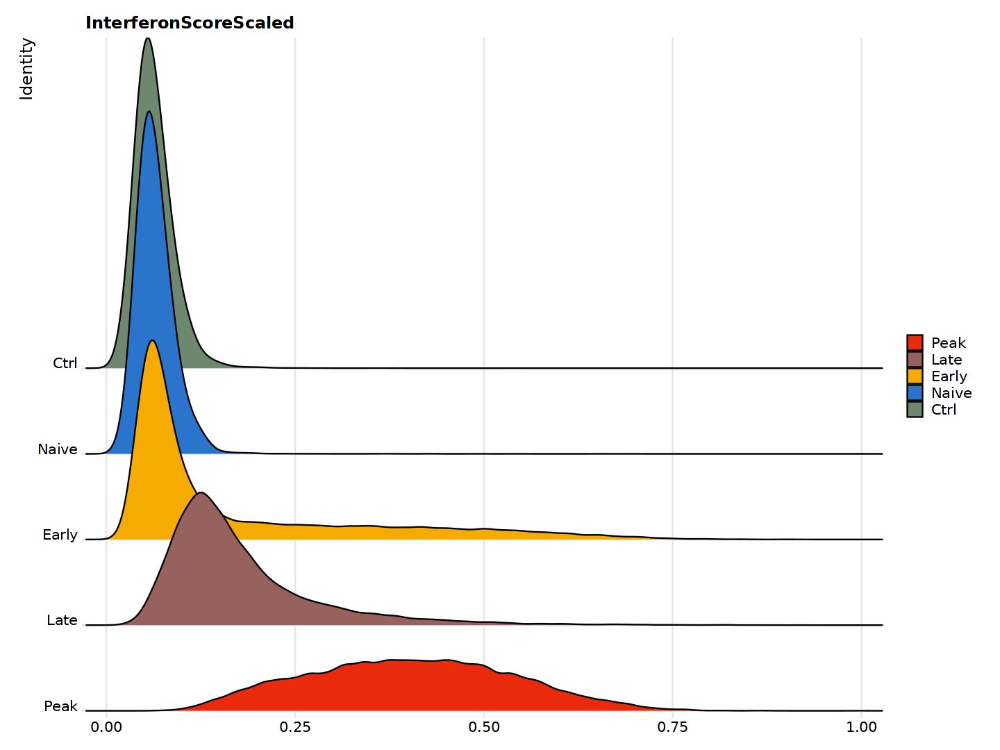

In [25]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaled', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [26]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [27]:
#Calculating mean and standard deviation for Naive population
meanInterferon_Naive <- mean(tmp_Naive$InterferonScoreScaled)
sdInterferon_Naive <- sd(tmp_Naive$InterferonScoreScaled)

In [28]:
#Calculate zscore
tmp_Naive$zscoreInterferon <- (tmp_Naive$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [29]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferon <- pnorm(tmp_Naive$zscoreInterferon, mean = 0, sd = 1, lower.tail=FALSE)

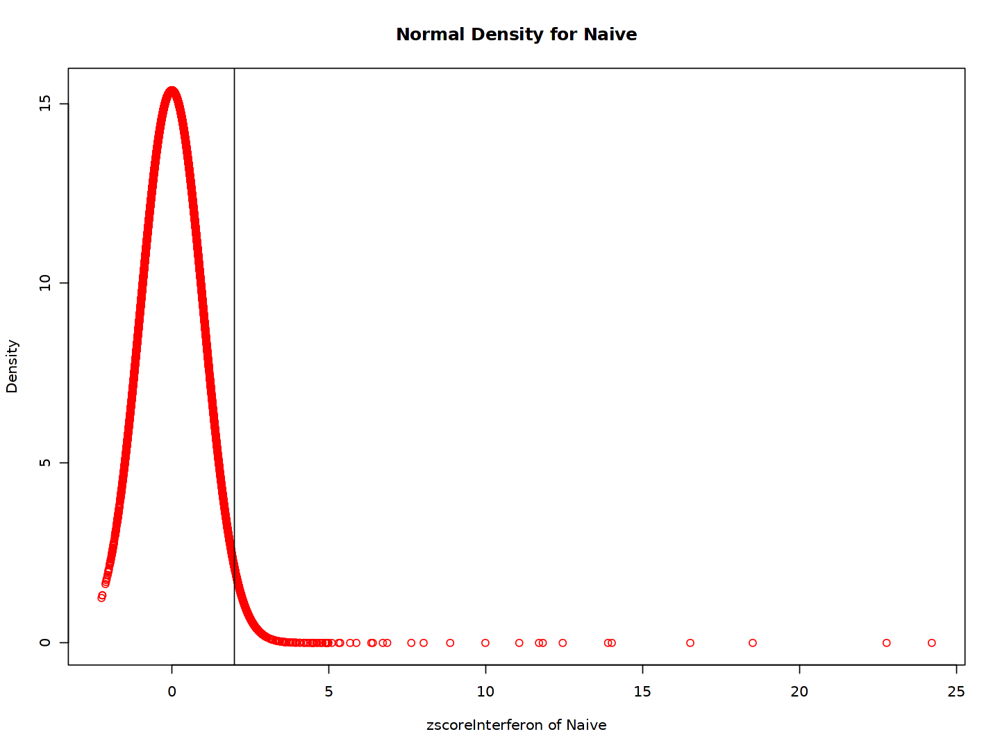

In [30]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,dnorm(tmp_Naive$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

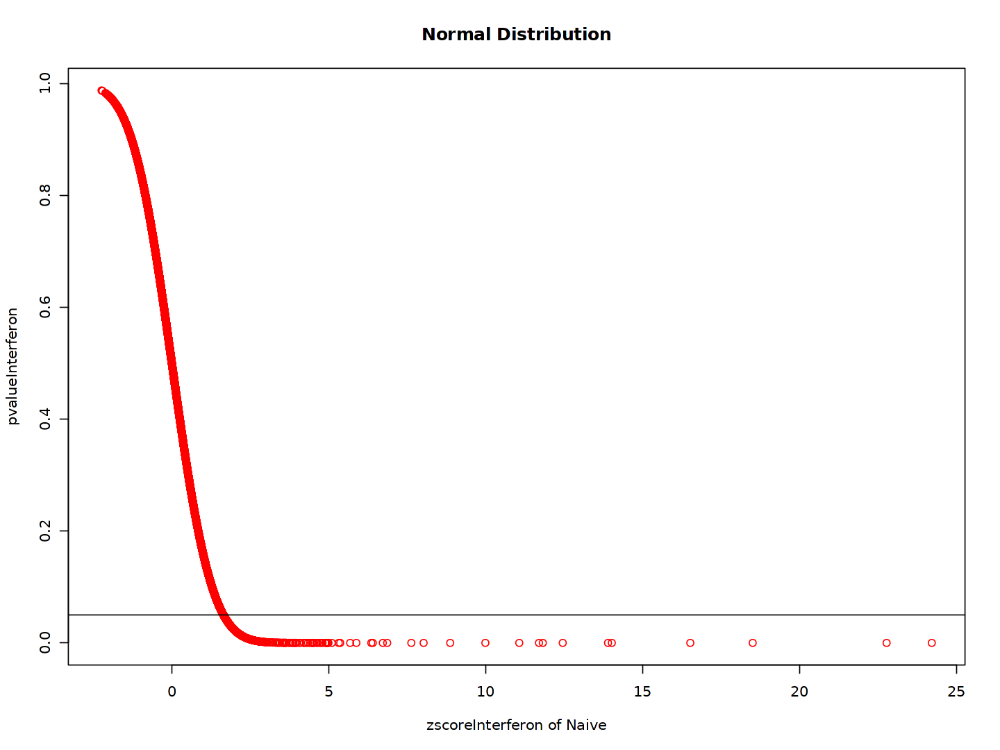

In [31]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,tmp_Naive$pvalueInterferon, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [32]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_Naive = (tmp$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [33]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_Naive <- pnorm(tmp$zscoreInterferon_Naive, mean = 0, sd = 1, lower.tail=FALSE)

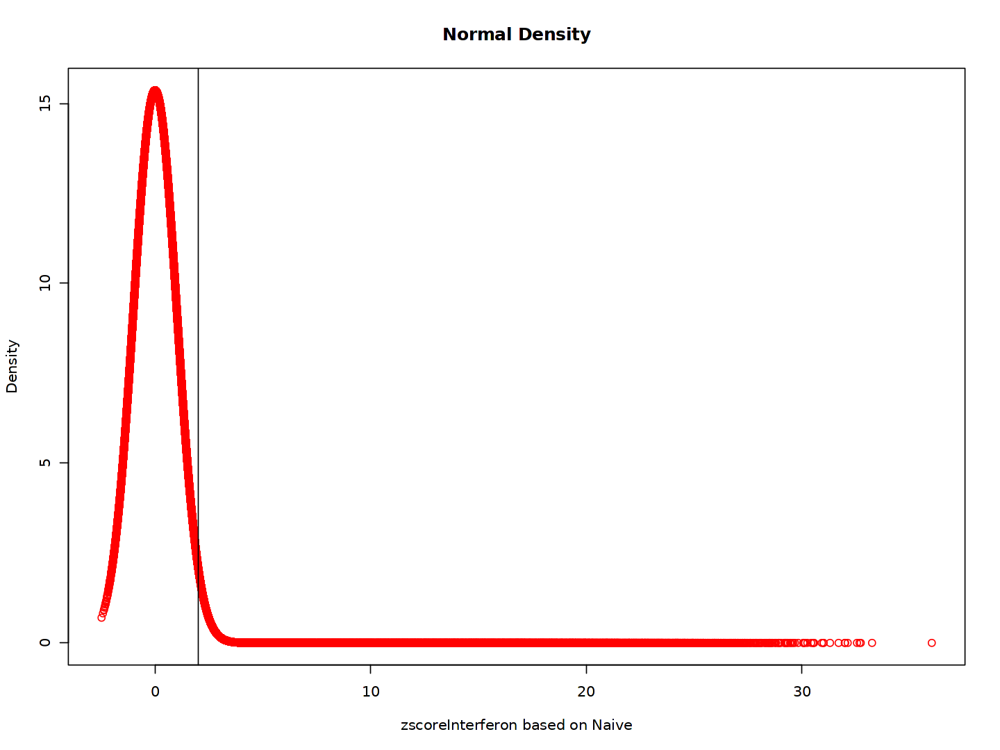

In [34]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="zscoreInterferon based on Naive", ylab="Density", col = "red")
abline(v=2)

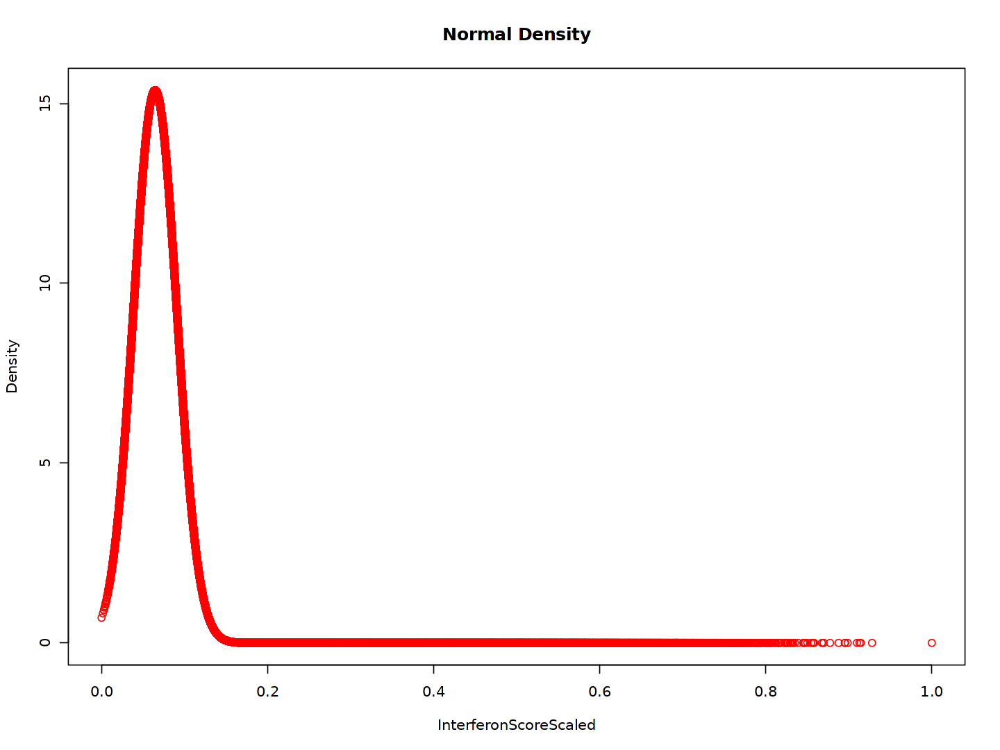

In [35]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="InterferonScoreScaled", ylab="Density", col = "red")

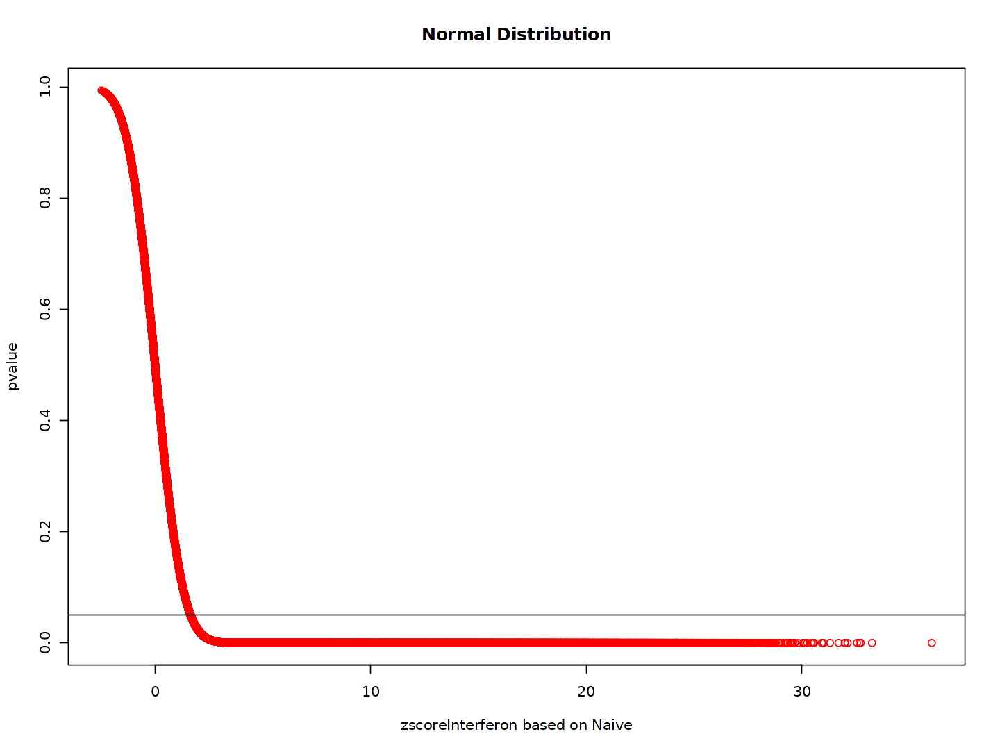

In [36]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="zscoreInterferon based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

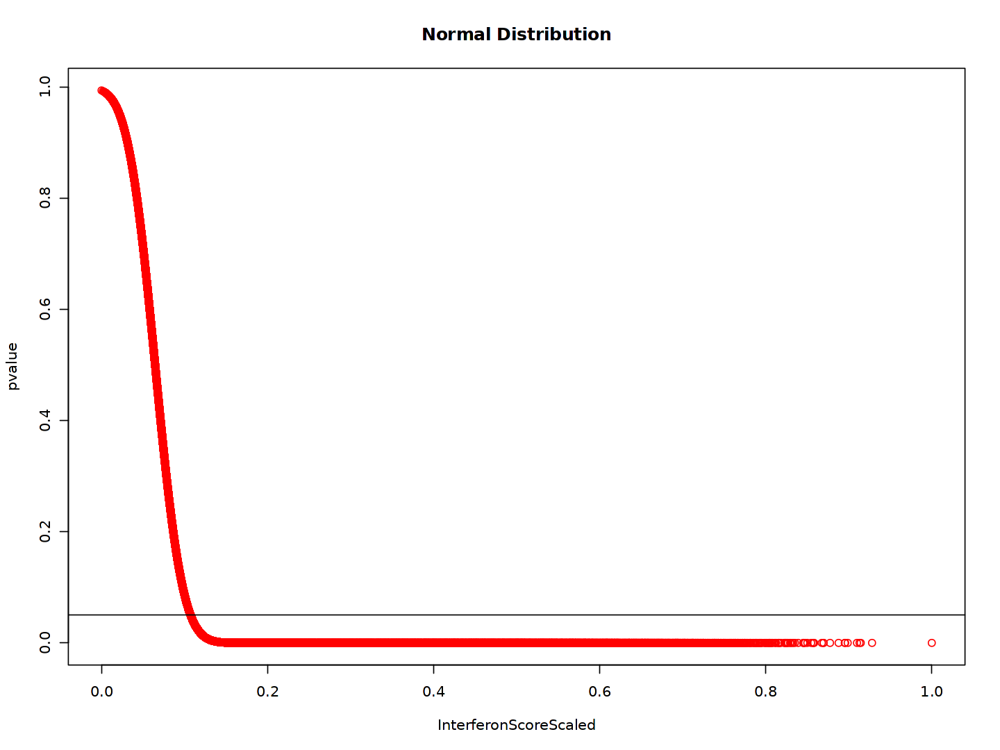

In [37]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="InterferonScoreScaled", ylab="pvalue", col = "red")
abline(h=0.05)

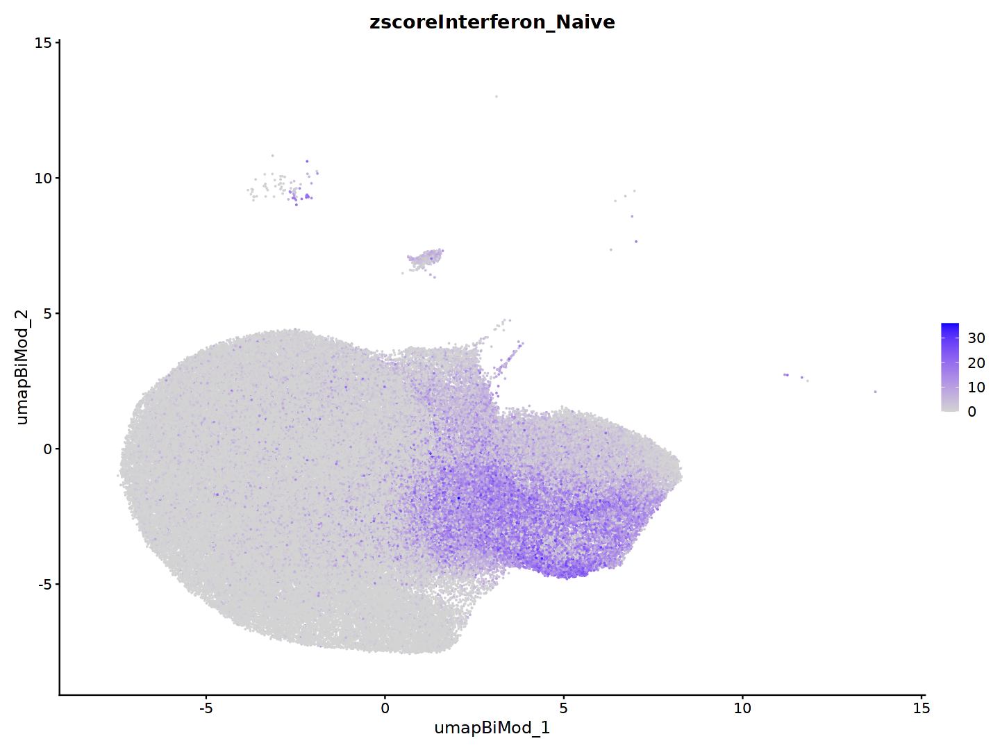

In [38]:
FeaturePlot(tmp, features="zscoreInterferon_Naive", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

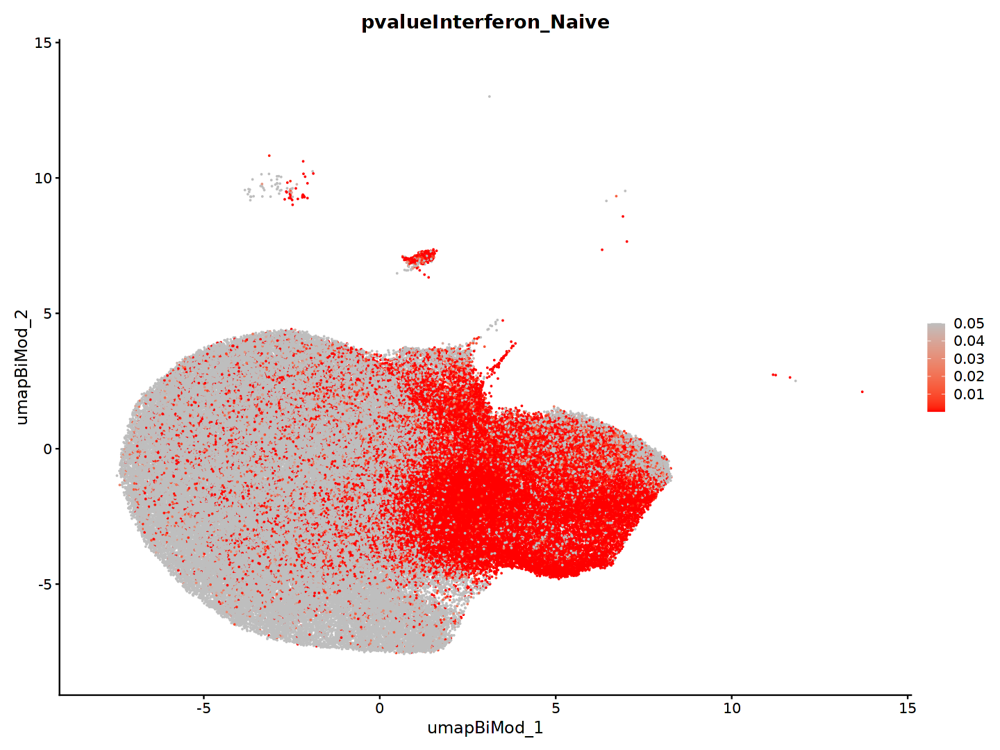

In [39]:
FeaturePlot(tmp, features="pvalueInterferon_Naive", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [40]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScore"] <- tmp$InterferonScore
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaled"] <-tmp$InterferonScoreScaled
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_Naive"] <-tmp$zscoreInterferon_Naive
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_Naive"] <-tmp$pvalueInterferon_Naive

##### 3.1.1.2 OPC

In [41]:
tmp <- subset(MORNAATACC, subset = cellType == "OPC")

In [42]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [43]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  374   639   789   680  1395 

In [44]:
tmp$InterferonScore <- NULL
tmp$InterferonScoreScaled <- NULL
tmp$zscoreInterferon_Naive <- NULL
tmp$pvalueInterferon_Naive <- NULL
tmp$Interferon <- NULL

In [45]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [46]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScore")

In [47]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaled <- (tmp$InterferonScore - min(tmp$InterferonScore)) / (max(tmp$InterferonScore) - min(tmp$InterferonScore))

Picking joint bandwidth of 0.0203



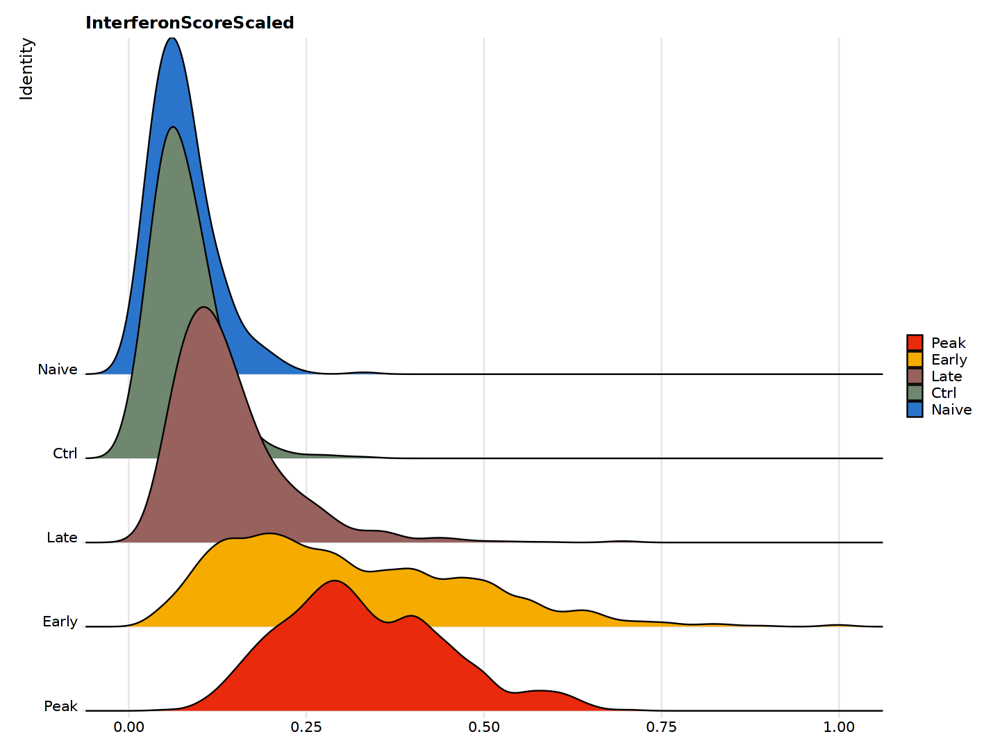

In [48]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaled', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [49]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [50]:
#Calculating mean and standard deviation for Naive population
meanInterferon_Naive <- mean(tmp_Naive$InterferonScoreScaled)
sdInterferon_Naive <- sd(tmp_Naive$InterferonScoreScaled)

In [51]:
#Calculate zscore
tmp_Naive$zscoreInterferon <- (tmp_Naive$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [52]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferon <- pnorm(tmp_Naive$zscoreInterferon, mean = 0, sd = 1, lower.tail=FALSE)

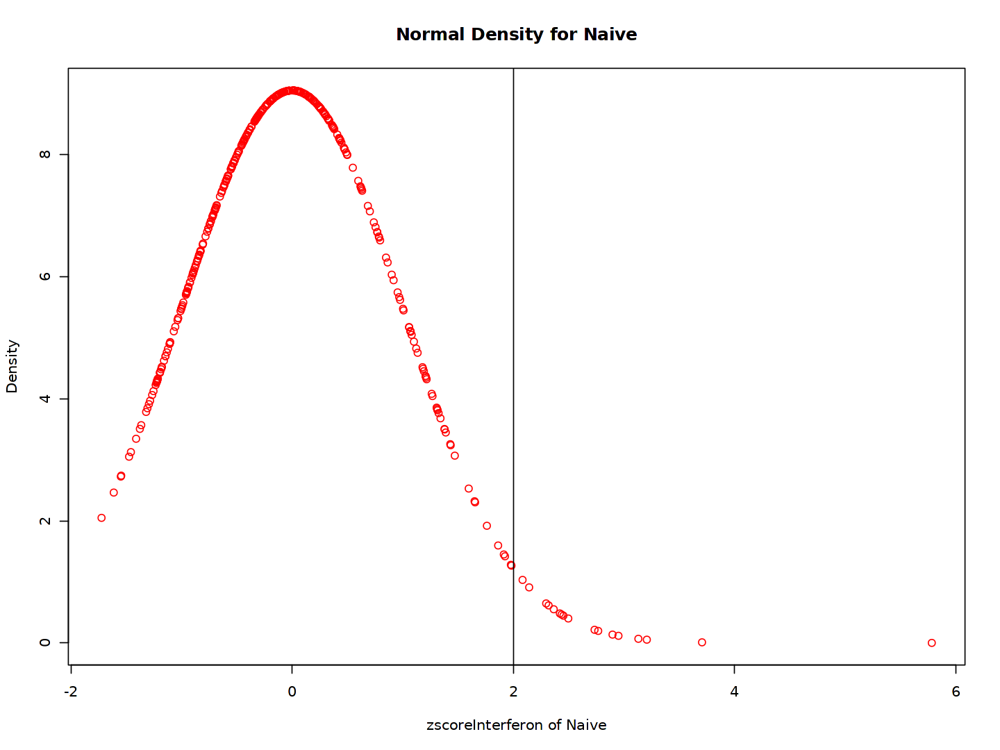

In [53]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,dnorm(tmp_Naive$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

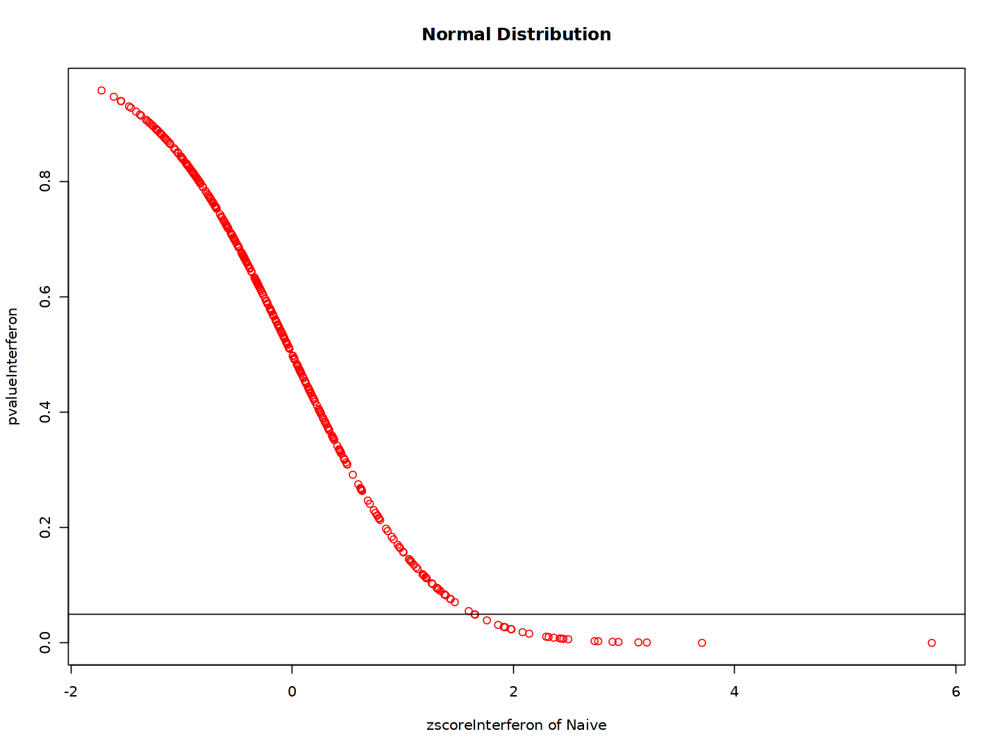

In [54]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,tmp_Naive$pvalueInterferon, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [55]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_Naive = (tmp$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [56]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_Naive <- pnorm(tmp$zscoreInterferon_Naive, mean = 0, sd = 1, lower.tail=FALSE)

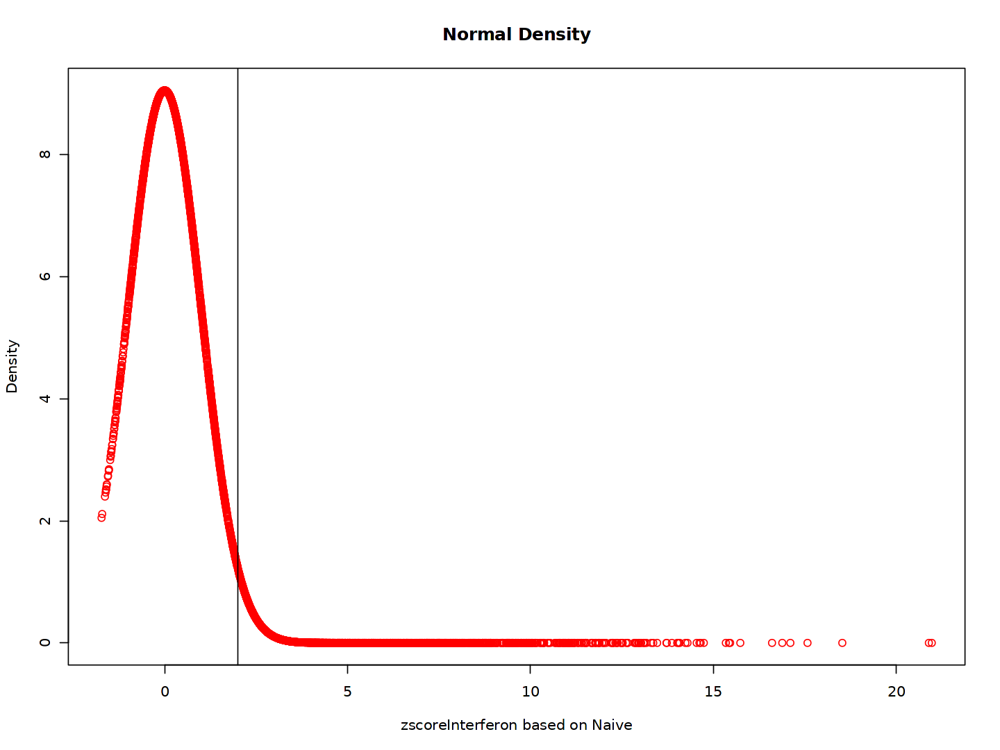

In [57]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="zscoreInterferon based on Naive", ylab="Density", col = "red")
abline(v=2)

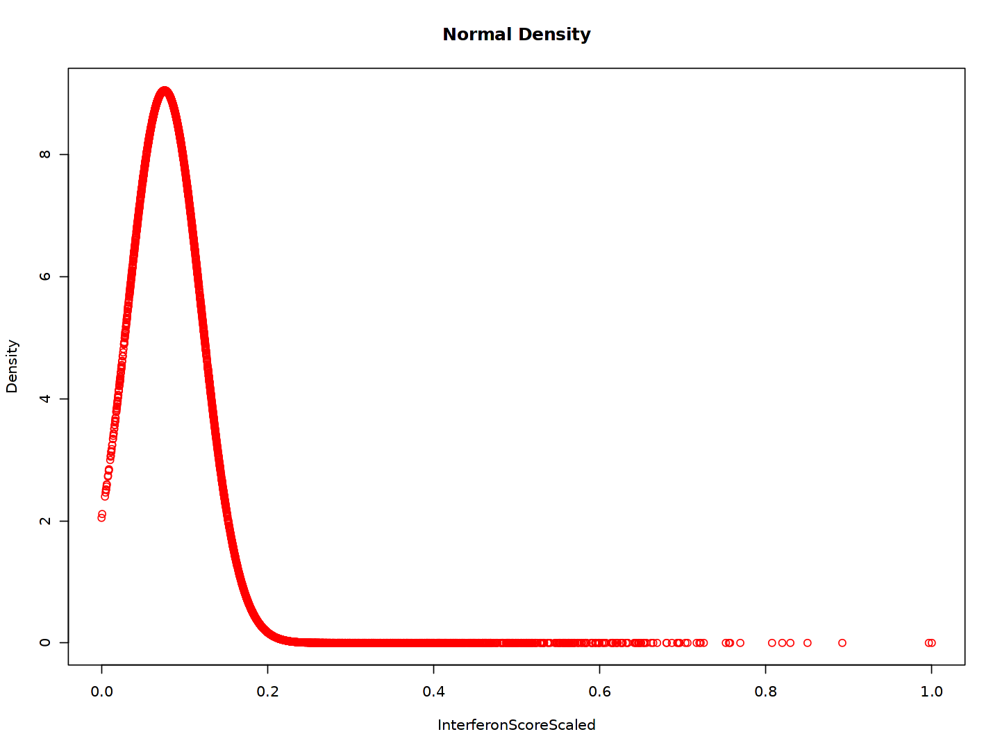

In [58]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="InterferonScoreScaled", ylab="Density", col = "red")

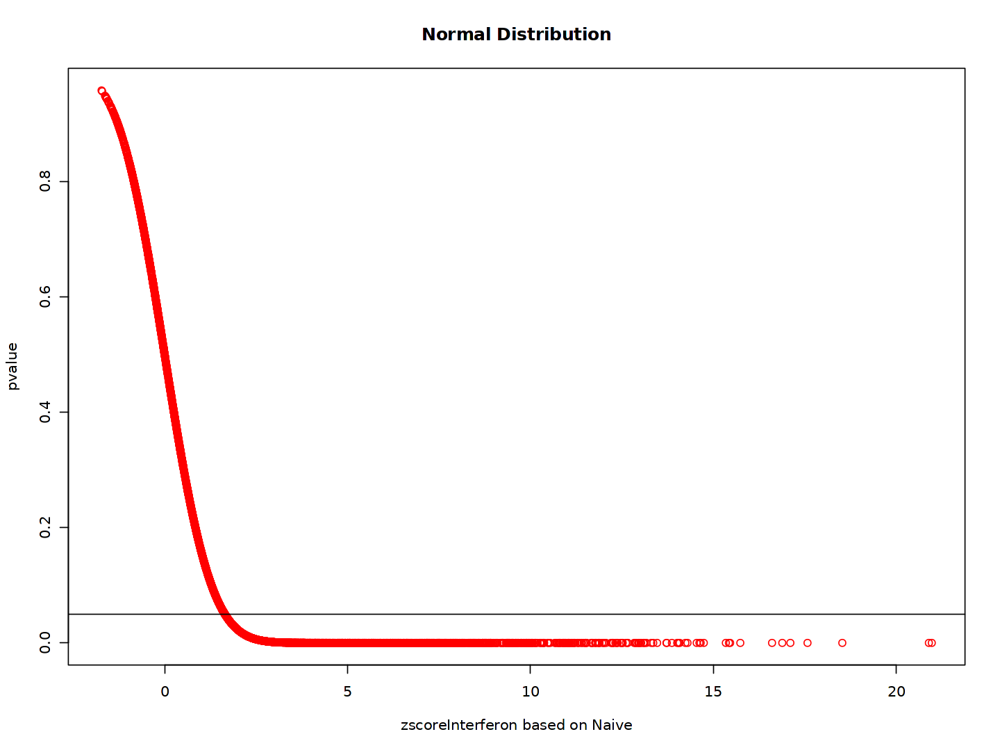

In [59]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="zscoreInterferon based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

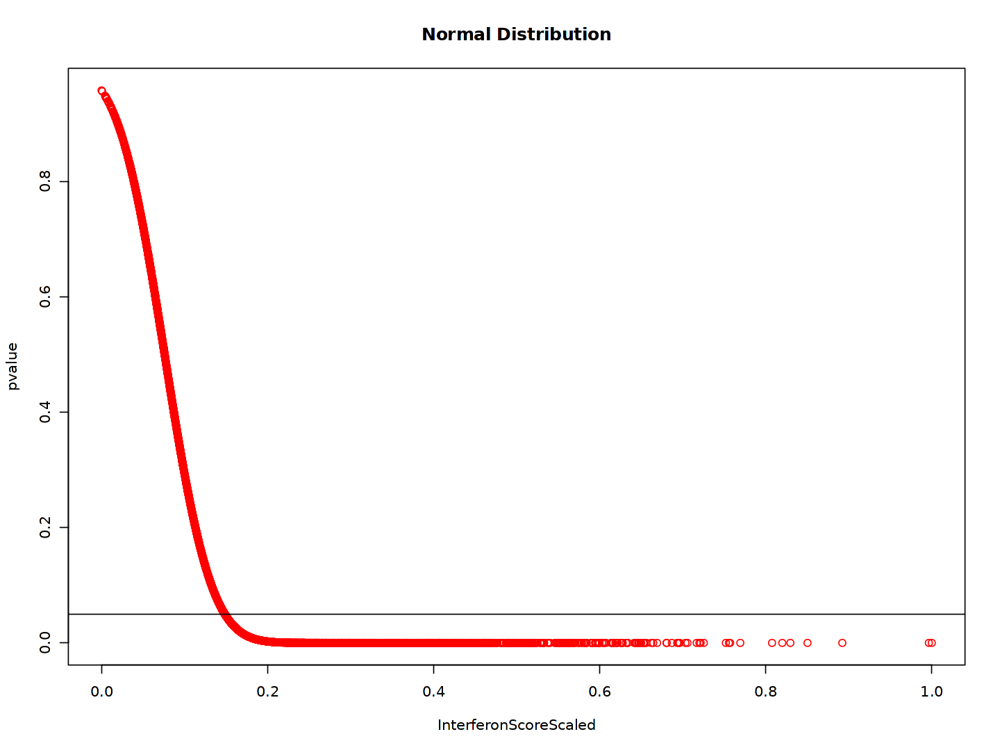

In [60]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="InterferonScoreScaled", ylab="pvalue", col = "red")
abline(h=0.05)

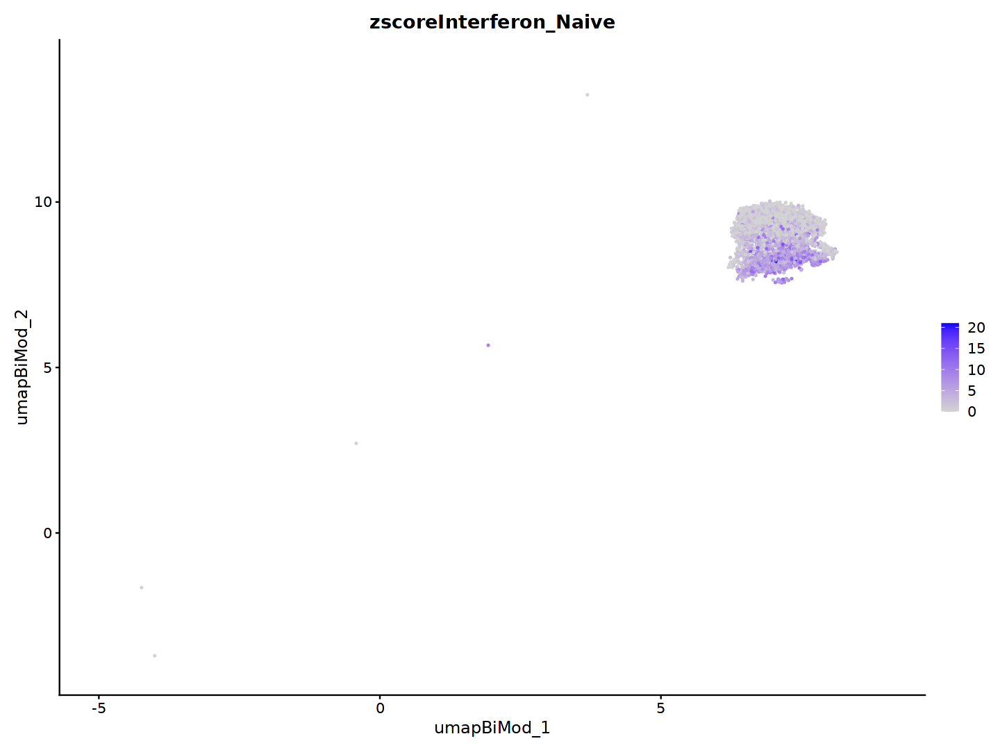

In [61]:
FeaturePlot(tmp, features="zscoreInterferon_Naive", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

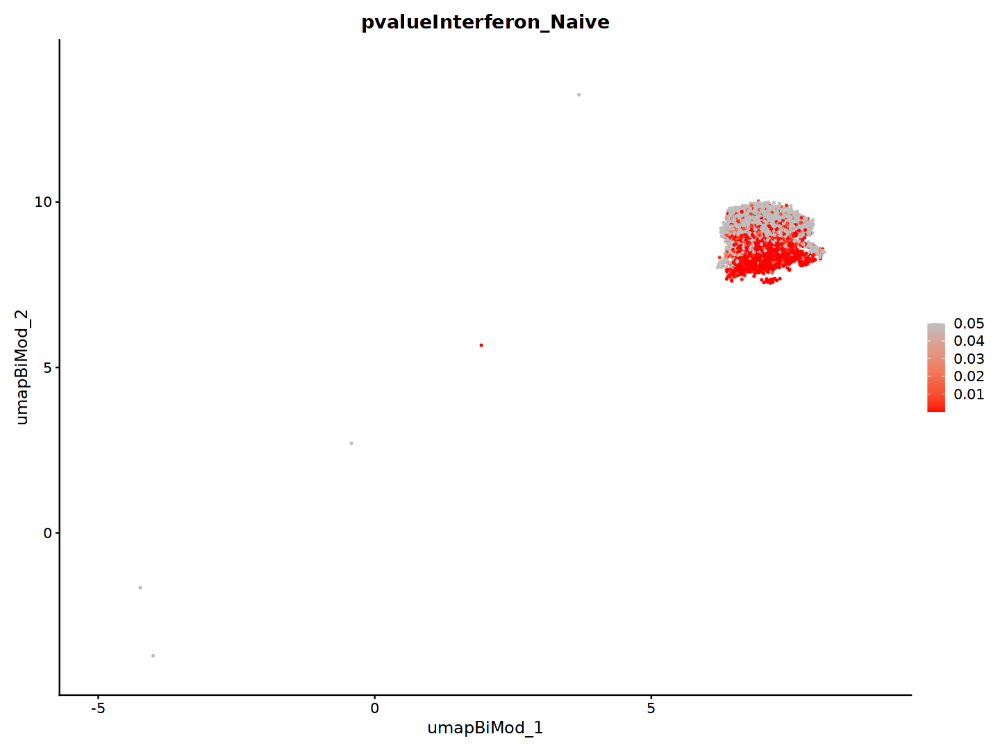

In [62]:
FeaturePlot(tmp, features="pvalueInterferon_Naive", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [63]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScore"] <- tmp$InterferonScore
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaled"] <-tmp$InterferonScoreScaled
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_Naive"] <-tmp$zscoreInterferon_Naive
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_Naive"] <-tmp$pvalueInterferon_Naive

##### 3.1.1.3 COP

In [64]:
tmp <- subset(MORNAATACC, subset = cellType == "COP")

In [65]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [66]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  123    90   155   123   621 

In [67]:
tmp$InterferonScore <- NULL
tmp$InterferonScoreScaled <- NULL
tmp$zscoreInterferon_Naive <- NULL
tmp$pvalueInterferon_Naive <- NULL
tmp$Interferon <- NULL

In [68]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [69]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScore")

In [70]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaled <- (tmp$InterferonScore - min(tmp$InterferonScore)) / (max(tmp$InterferonScore) - min(tmp$InterferonScore))

Picking joint bandwidth of 0.0287



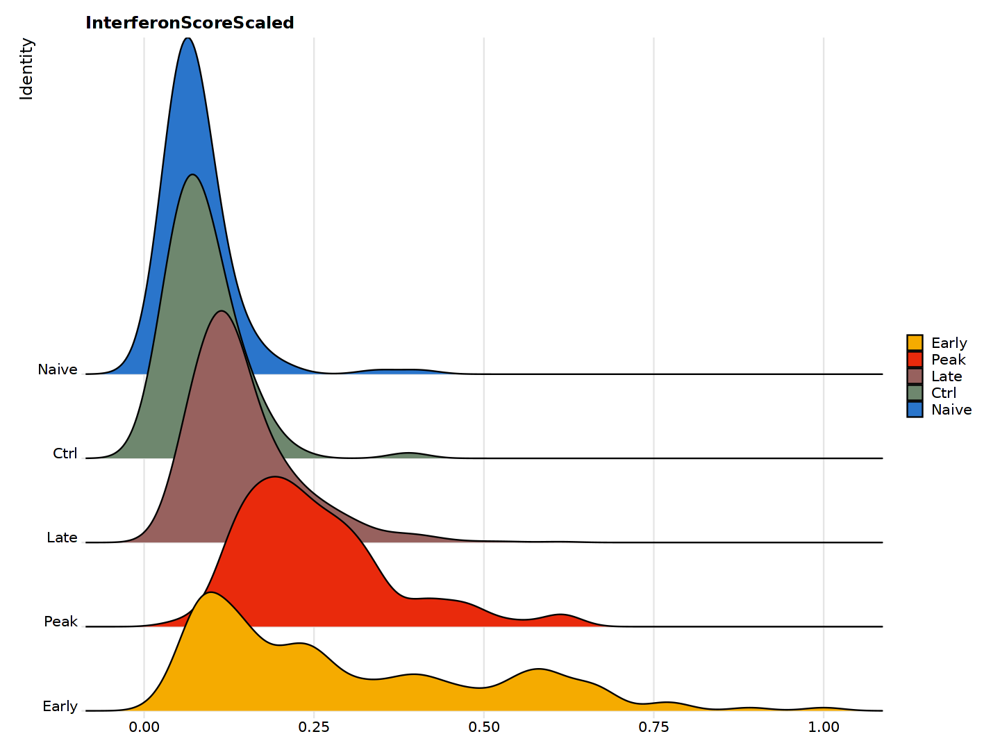

In [71]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaled', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [72]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [73]:
#Calculating mean and standard deviation for Naive population
meanInterferon_Naive <- mean(tmp_Naive$InterferonScoreScaled)
sdInterferon_Naive <- sd(tmp_Naive$InterferonScoreScaled)

In [74]:
#Calculate zscore
tmp_Naive$zscoreInterferon <- (tmp_Naive$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [75]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferon <- pnorm(tmp_Naive$zscoreInterferon, mean = 0, sd = 1, lower.tail=FALSE)

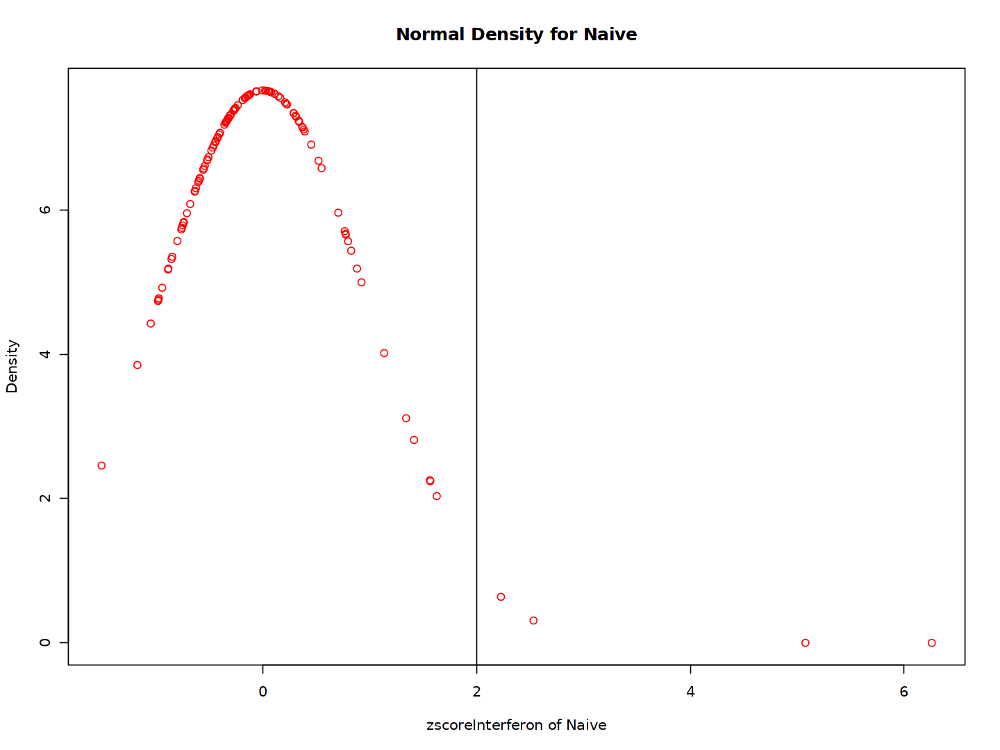

In [76]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,dnorm(tmp_Naive$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

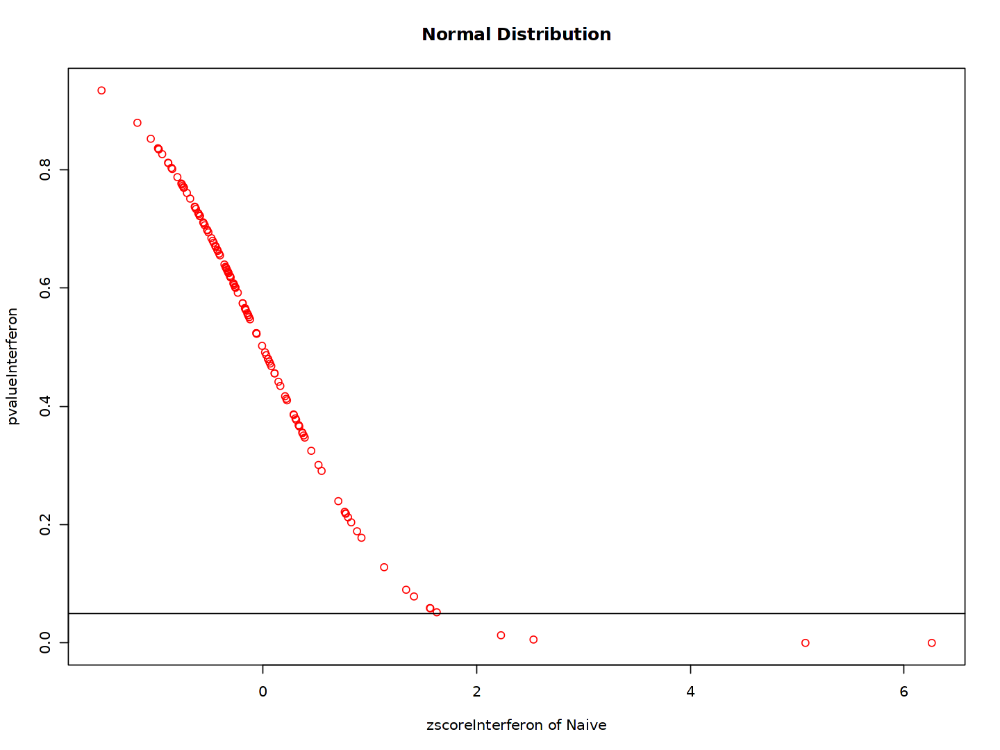

In [77]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,tmp_Naive$pvalueInterferon, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [78]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_Naive = (tmp$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [79]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_Naive <- pnorm(tmp$zscoreInterferon_Naive, mean = 0, sd = 1, lower.tail=FALSE)

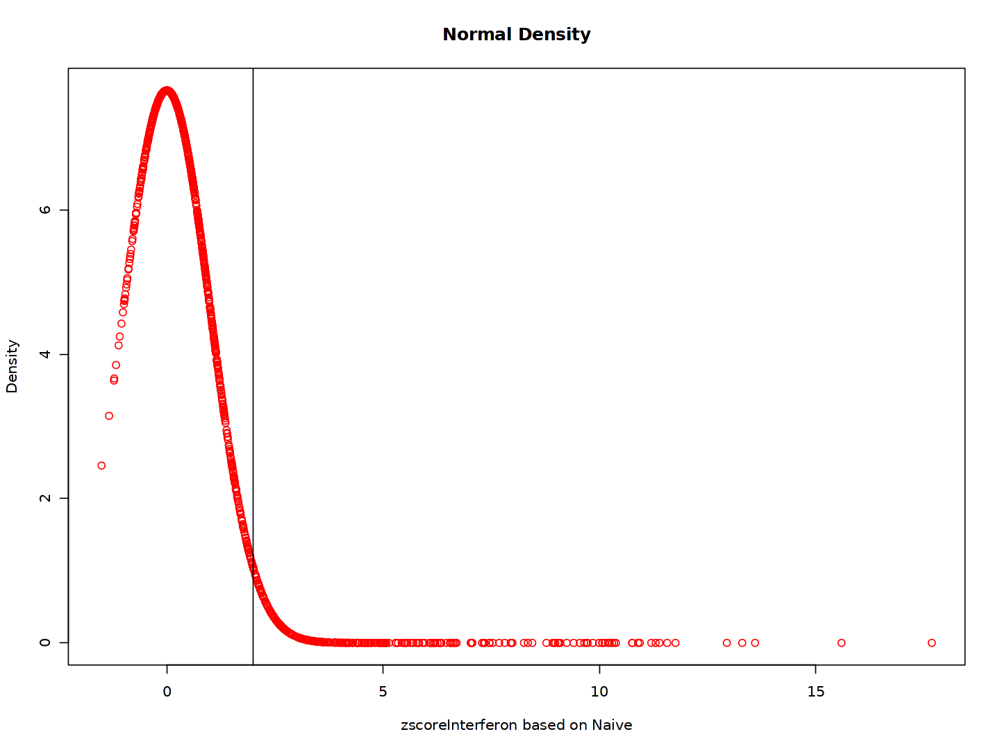

In [80]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="zscoreInterferon based on Naive", ylab="Density", col = "red")
abline(v=2)

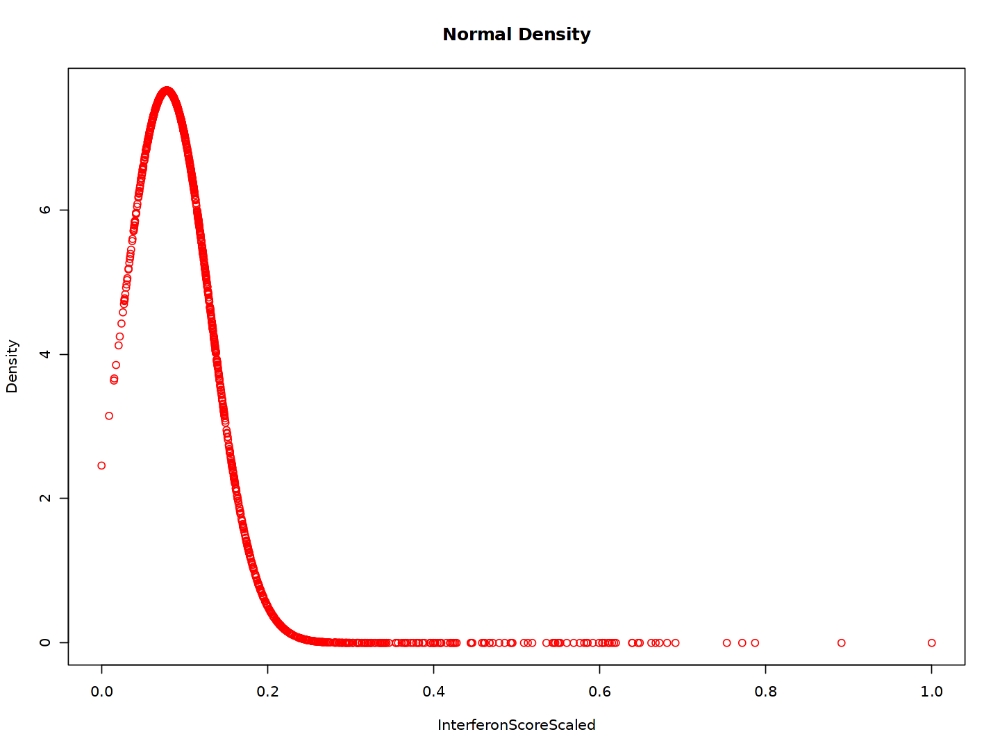

In [81]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="InterferonScoreScaled", ylab="Density", col = "red")

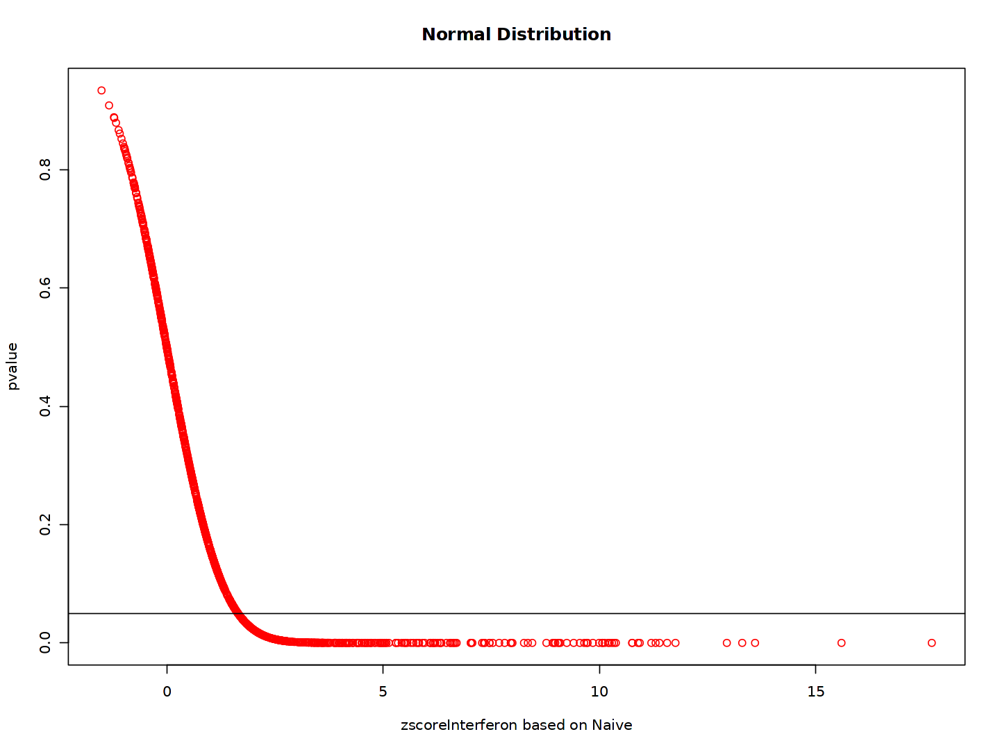

In [82]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="zscoreInterferon based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

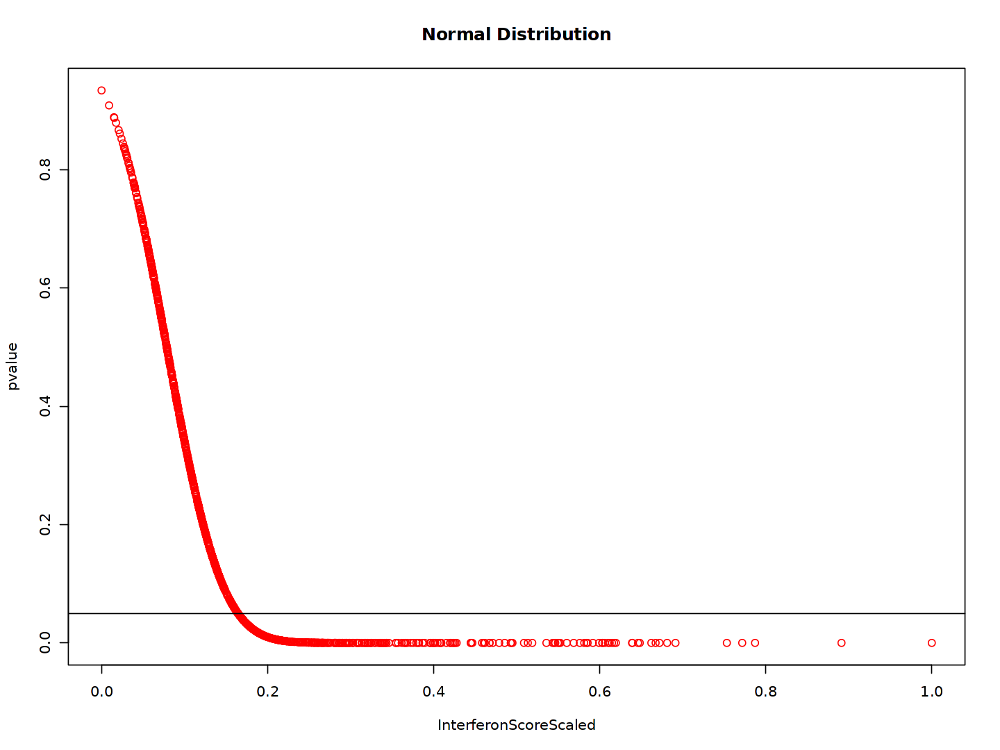

In [83]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="InterferonScoreScaled", ylab="pvalue", col = "red")
abline(h=0.05)

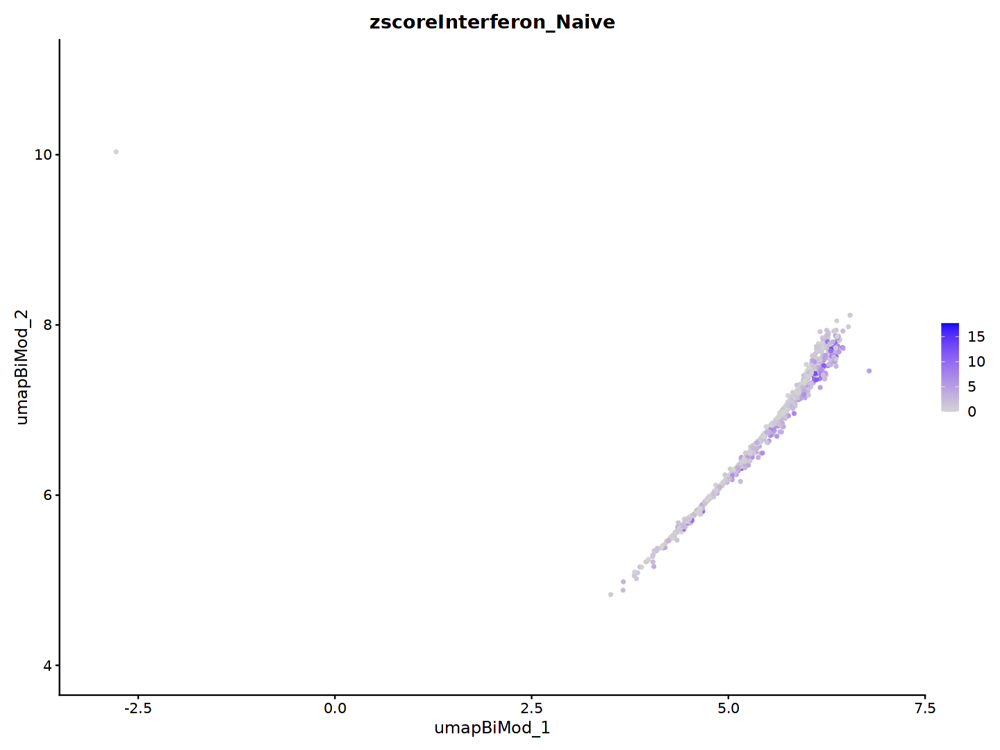

In [84]:
FeaturePlot(tmp, features="zscoreInterferon_Naive", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

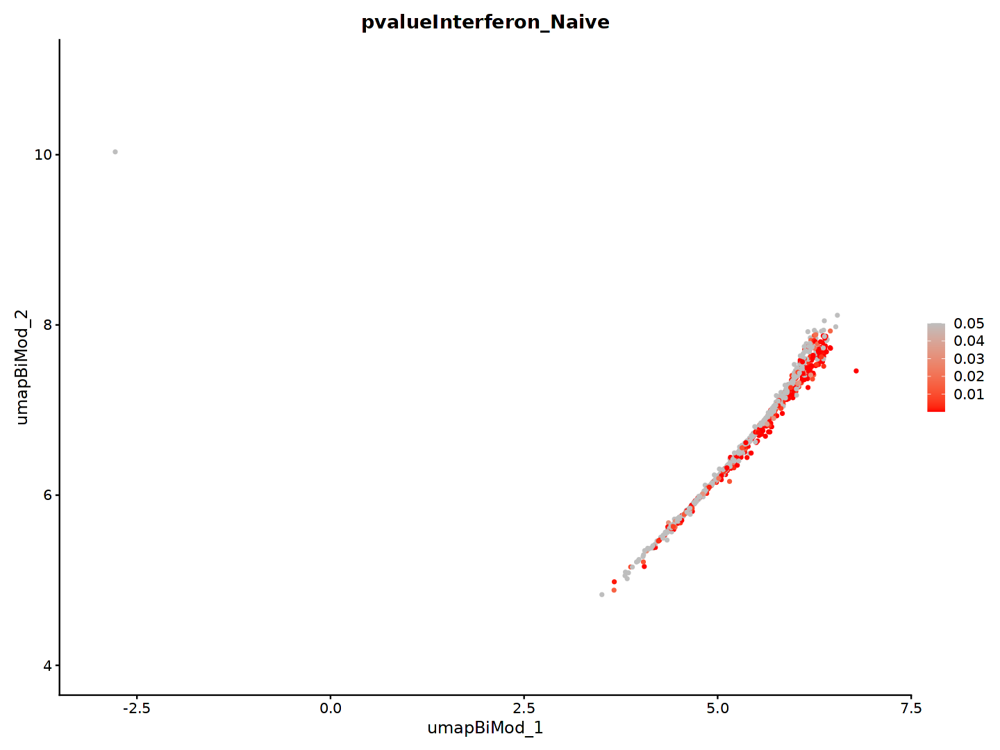

In [85]:
FeaturePlot(tmp, features="pvalueInterferon_Naive", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [86]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScore"] <- tmp$InterferonScore
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaled"] <-tmp$InterferonScoreScaled
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_Naive"] <-tmp$zscoreInterferon_Naive
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_Naive"] <-tmp$pvalueInterferon_Naive

##### 3.1.1.4 Micro

In [87]:
tmp <- subset(MORNAATACC, subset = cellType == "Micro")

In [88]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [89]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  676   297   386  1325   839 

In [90]:
tmp$InterferonScore <- NULL
tmp$InterferonScoreScaled <- NULL
tmp$zscoreInterferon_Naive <- NULL
tmp$pvalueInterferon_Naive <- NULL
tmp$Interferon <- NULL

In [91]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [92]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScore")

In [93]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaled <- (tmp$InterferonScore - min(tmp$InterferonScore)) / (max(tmp$InterferonScore) - min(tmp$InterferonScore))

Picking joint bandwidth of 0.0226



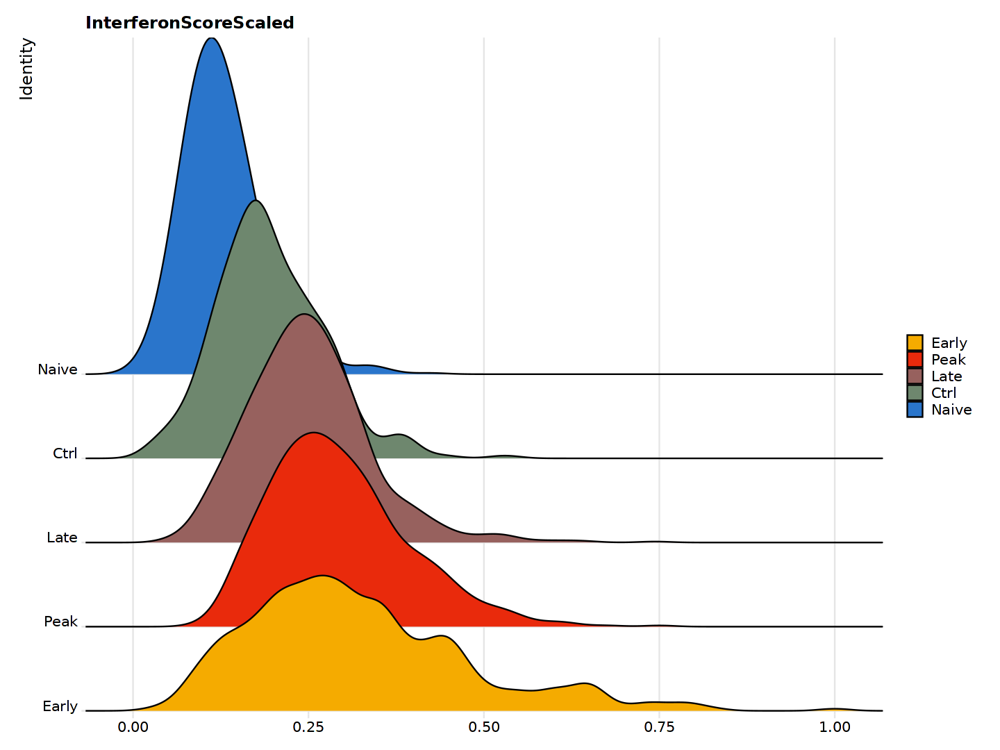

In [94]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaled', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [95]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [96]:
#Calculating mean and standard deviation for Naive population
meanInterferon_Naive <- mean(tmp_Naive$InterferonScoreScaled)
sdInterferon_Naive <- sd(tmp_Naive$InterferonScoreScaled)

In [97]:
#Calculate zscore
tmp_Naive$zscoreInterferon <- (tmp_Naive$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [98]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferon <- pnorm(tmp_Naive$zscoreInterferon, mean = 0, sd = 1, lower.tail=FALSE)

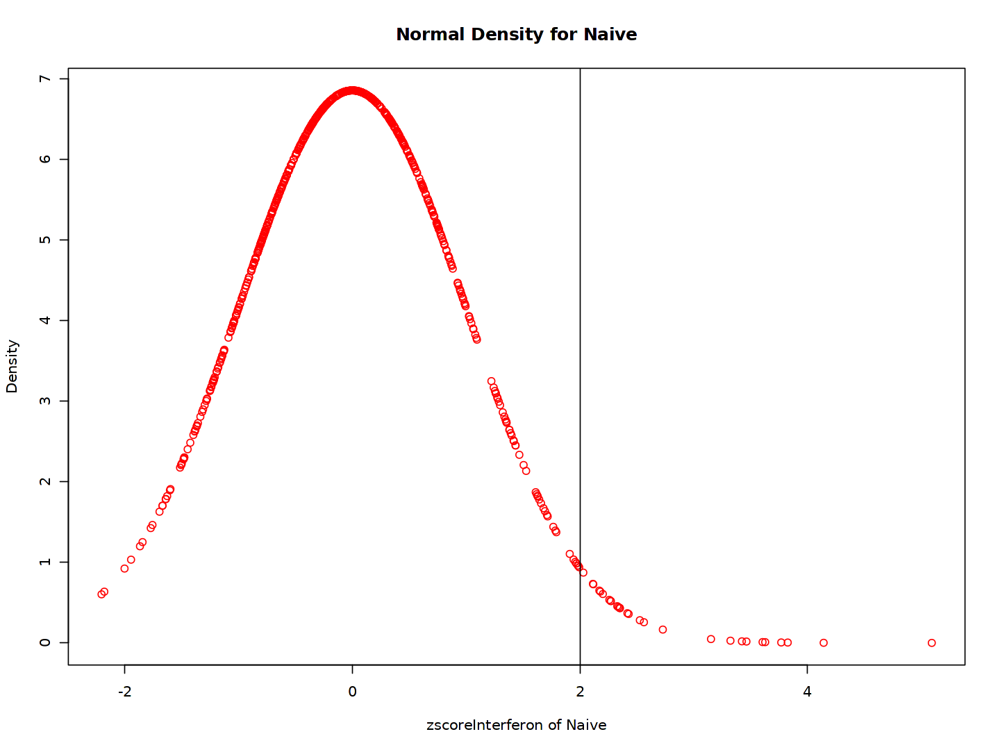

In [99]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,dnorm(tmp_Naive$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

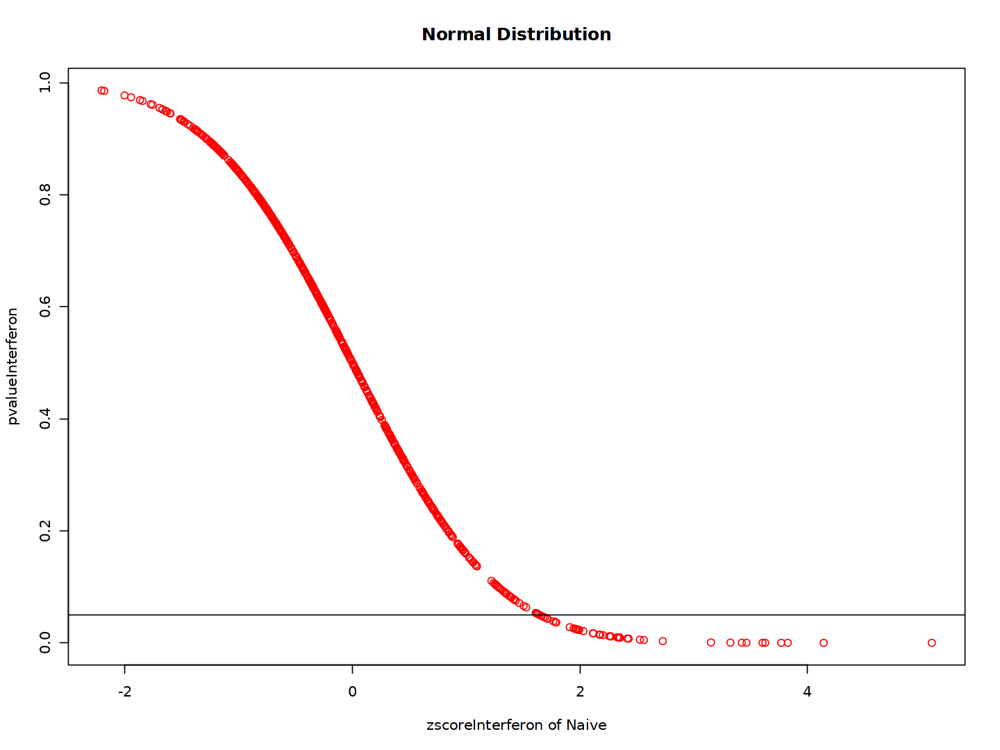

In [100]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,tmp_Naive$pvalueInterferon, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [101]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_Naive = (tmp$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [102]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_Naive <- pnorm(tmp$zscoreInterferon_Naive, mean = 0, sd = 1, lower.tail=FALSE)

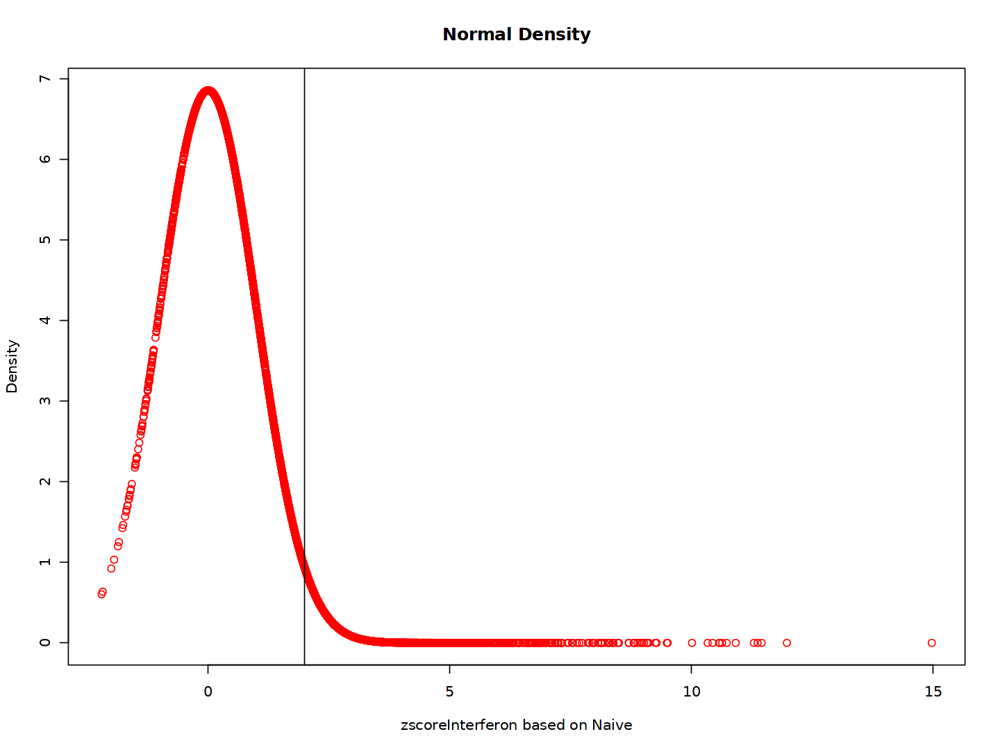

In [103]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="zscoreInterferon based on Naive", ylab="Density", col = "red")
abline(v=2)

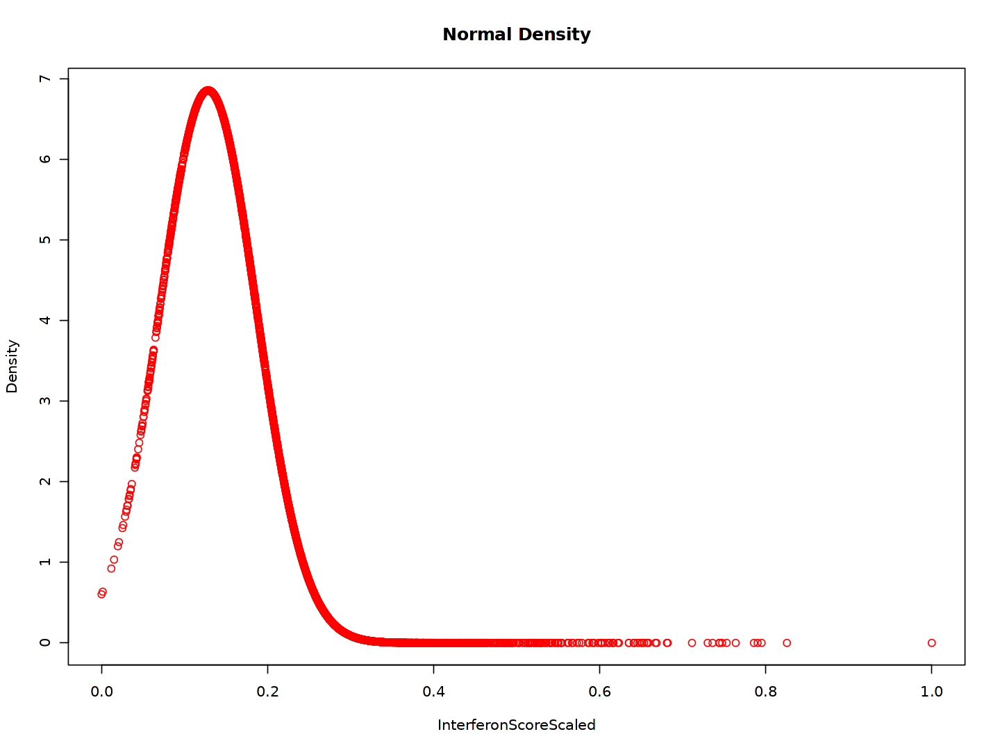

In [104]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="InterferonScoreScaled", ylab="Density", col = "red")

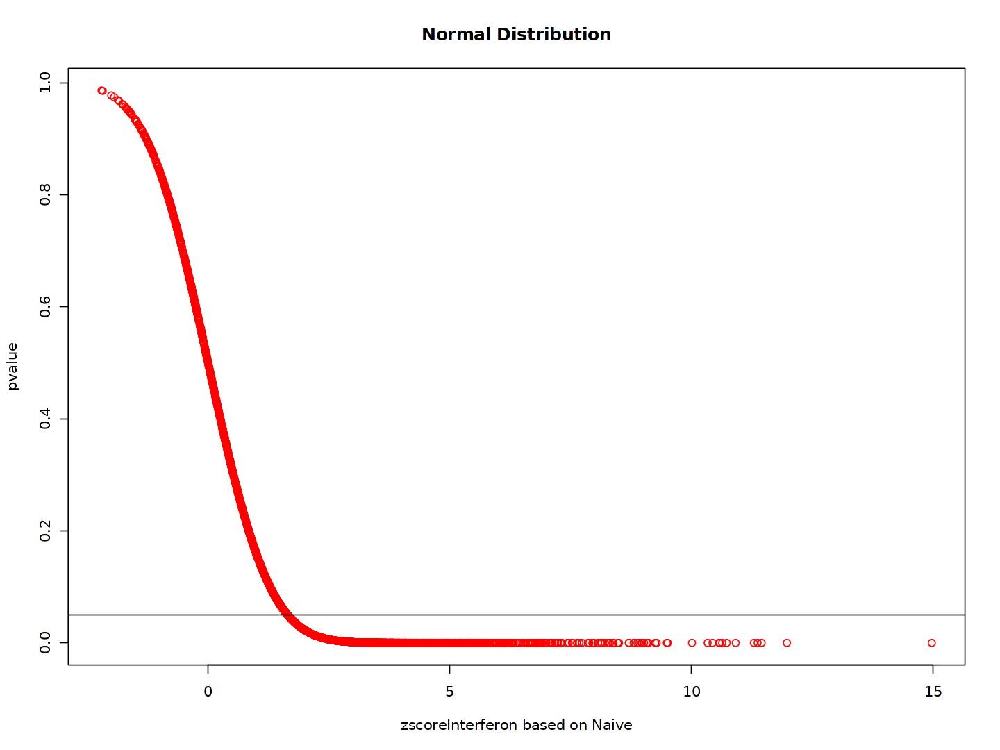

In [105]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="zscoreInterferon based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

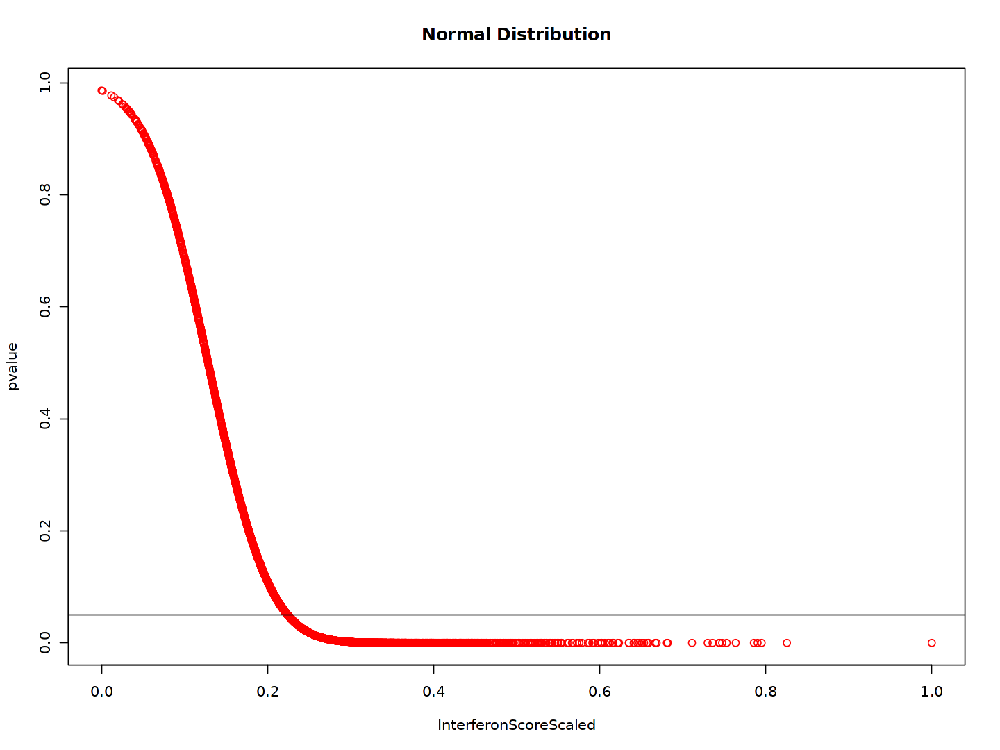

In [106]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="InterferonScoreScaled", ylab="pvalue", col = "red")
abline(h=0.05)

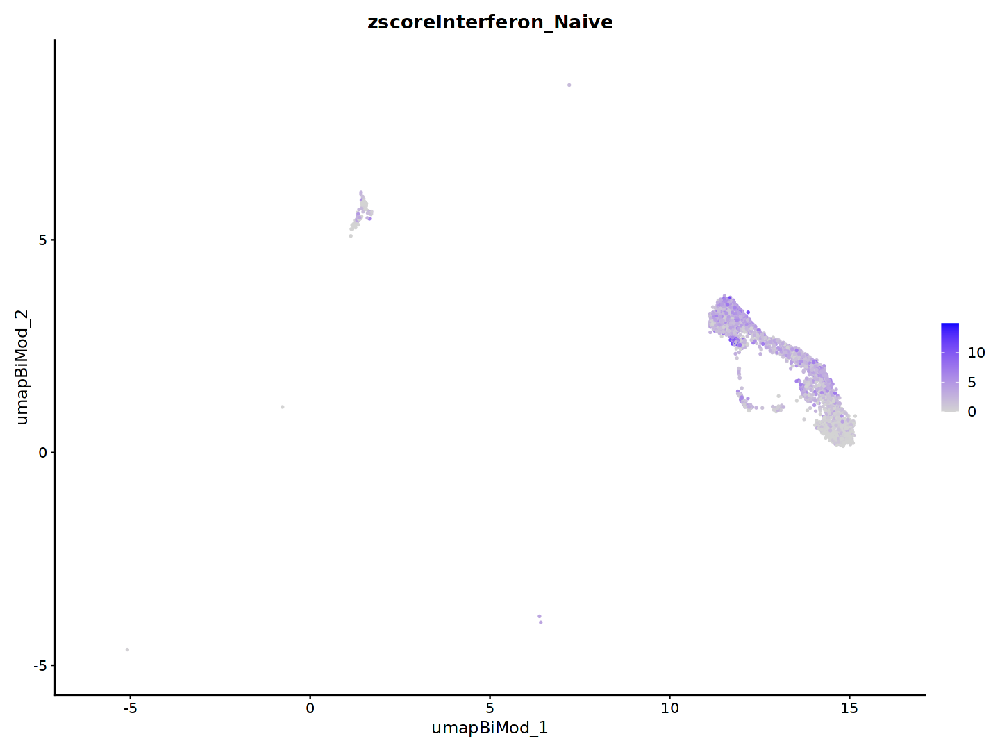

In [107]:
FeaturePlot(tmp, features="zscoreInterferon_Naive", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

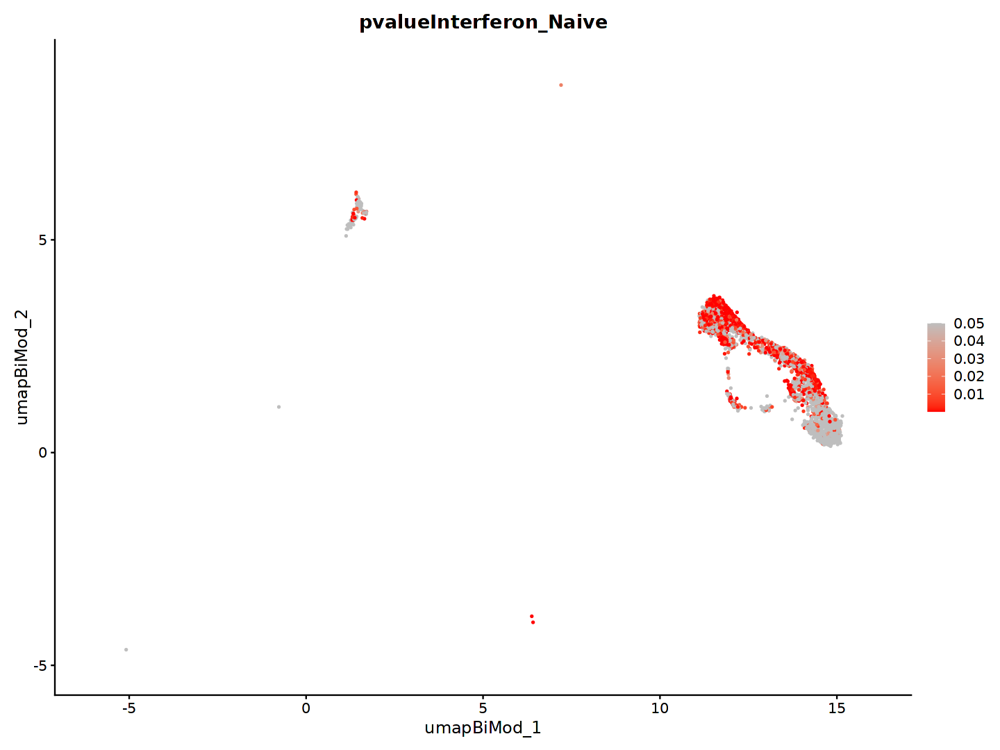

In [108]:
FeaturePlot(tmp, features="pvalueInterferon_Naive", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [109]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScore"] <- tmp$InterferonScore
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaled"] <-tmp$InterferonScoreScaled
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_Naive"] <-tmp$zscoreInterferon_Naive
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_Naive"] <-tmp$pvalueInterferon_Naive

##### 3.1.1.5 Astro

In [110]:
tmp <- subset(MORNAATACC, subset = cellType == "Astro")

In [111]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [112]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
 1385  4703  2976    38    76 

In [113]:
tmp$InterferonScore <- NULL
tmp$InterferonScoreScaled <- NULL
tmp$zscoreInterferon_Naive <- NULL
tmp$pvalueInterferon_Naive <- NULL
tmp$Interferon <- NULL

In [114]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [115]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScore")

In [116]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaled <- (tmp$InterferonScore - min(tmp$InterferonScore)) / (max(tmp$InterferonScore) - min(tmp$InterferonScore))

Picking joint bandwidth of 0.0187



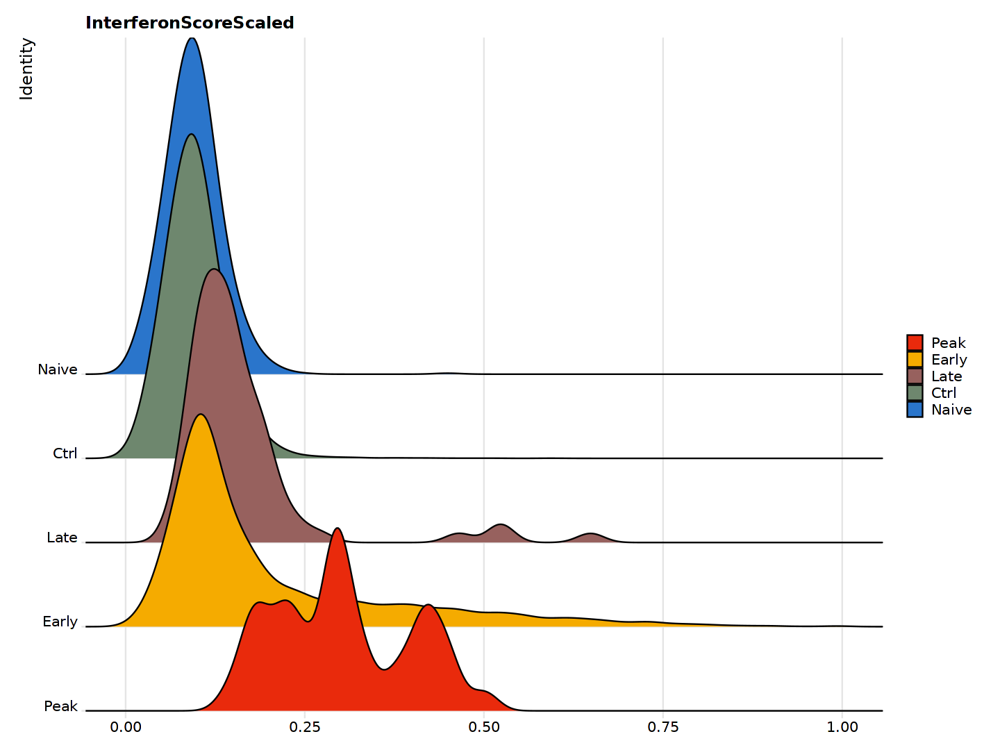

In [117]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaled', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [118]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [119]:
#Calculating mean and standard deviation for Naive population
meanInterferon_Naive <- mean(tmp_Naive$InterferonScoreScaled)
sdInterferon_Naive <- sd(tmp_Naive$InterferonScoreScaled)

In [120]:
#Calculate zscore
tmp_Naive$zscoreInterferon <- (tmp_Naive$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [121]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferon <- pnorm(tmp_Naive$zscoreInterferon, mean = 0, sd = 1, lower.tail=FALSE)

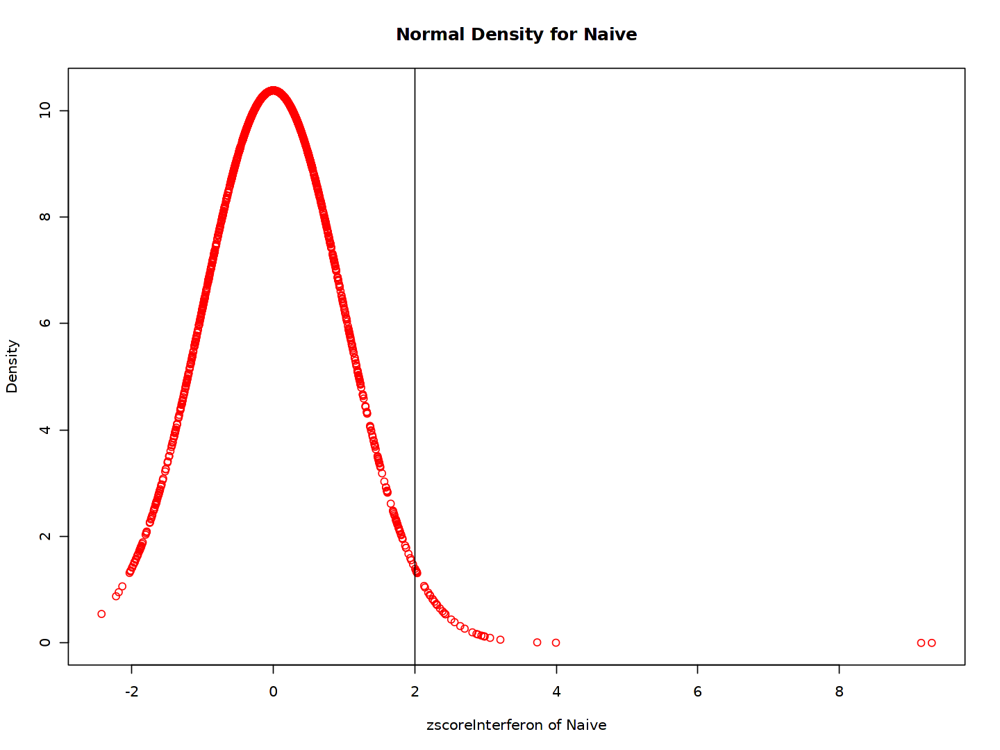

In [122]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,dnorm(tmp_Naive$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

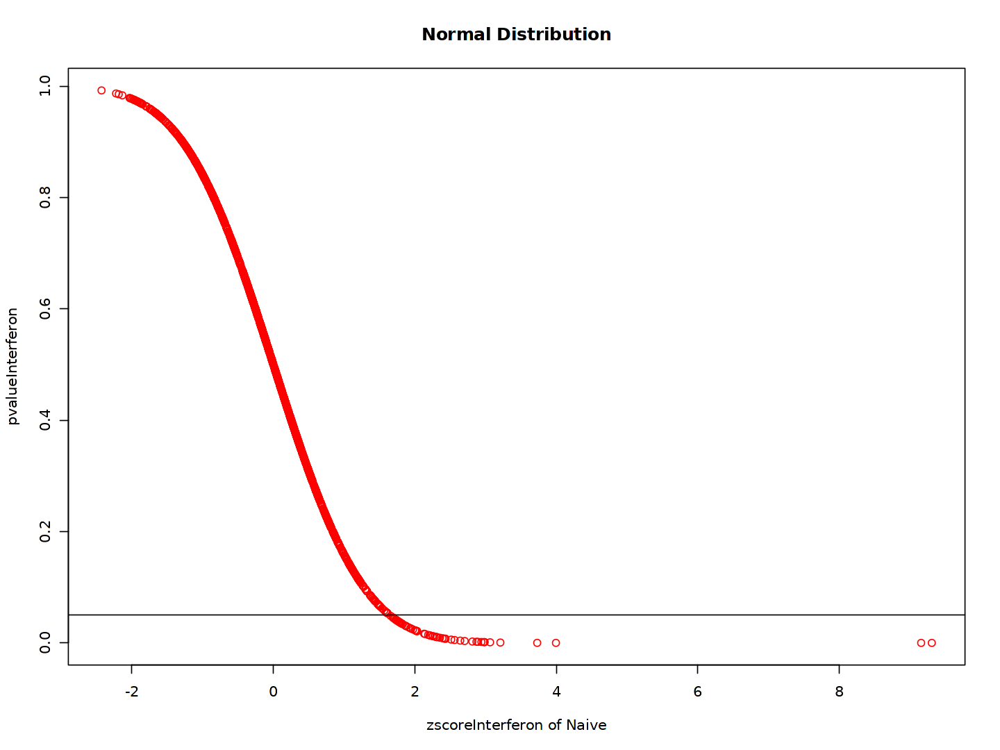

In [123]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,tmp_Naive$pvalueInterferon, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [124]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_Naive = (tmp$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [125]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_Naive <- pnorm(tmp$zscoreInterferon_Naive, mean = 0, sd = 1, lower.tail=FALSE)

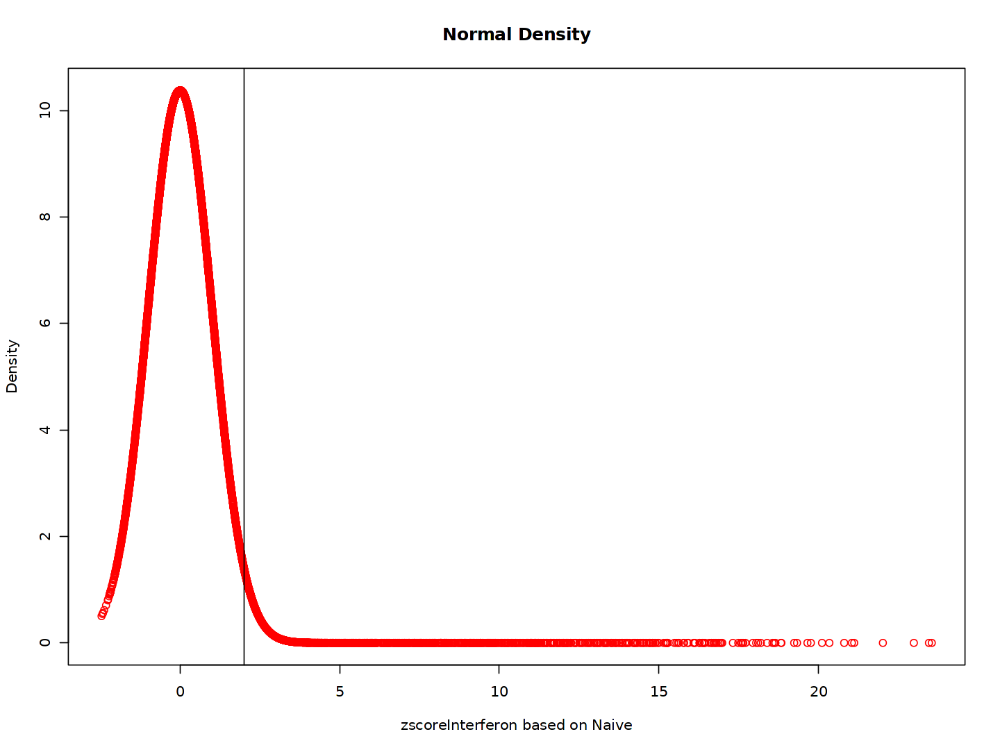

In [126]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="zscoreInterferon based on Naive", ylab="Density", col = "red")
abline(v=2)

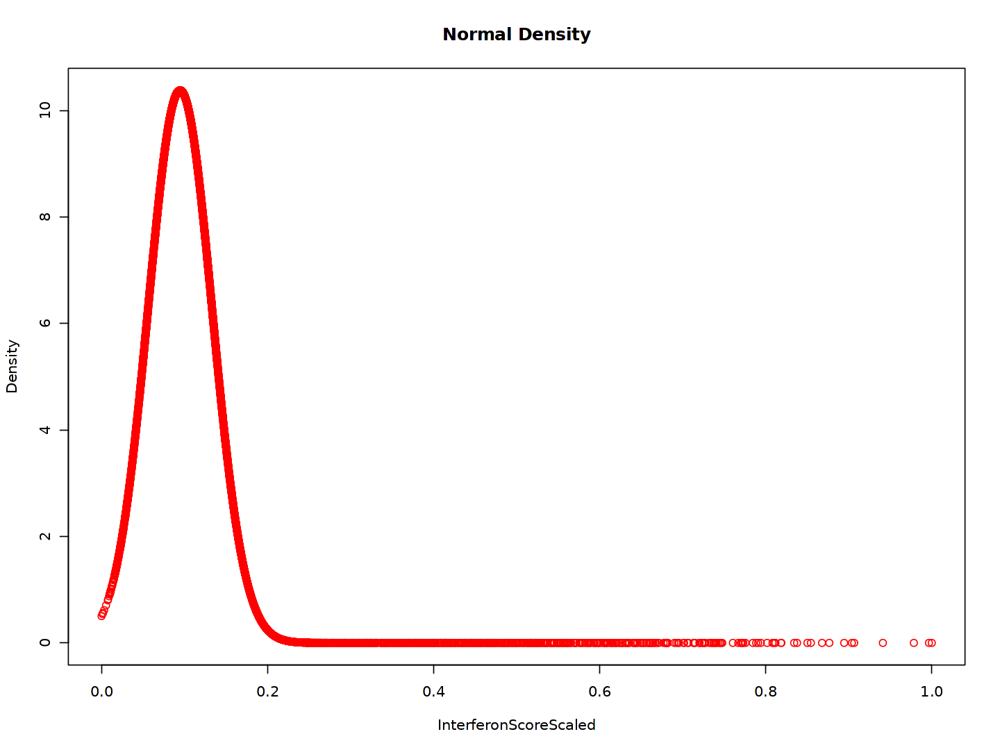

In [127]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="InterferonScoreScaled", ylab="Density", col = "red")

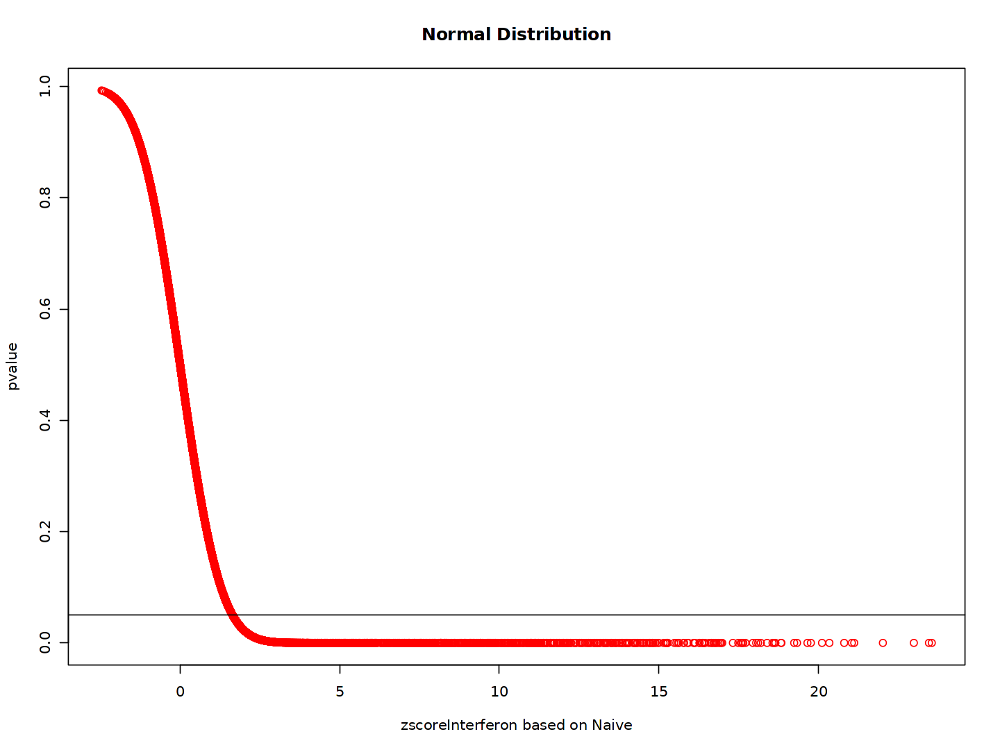

In [128]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="zscoreInterferon based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

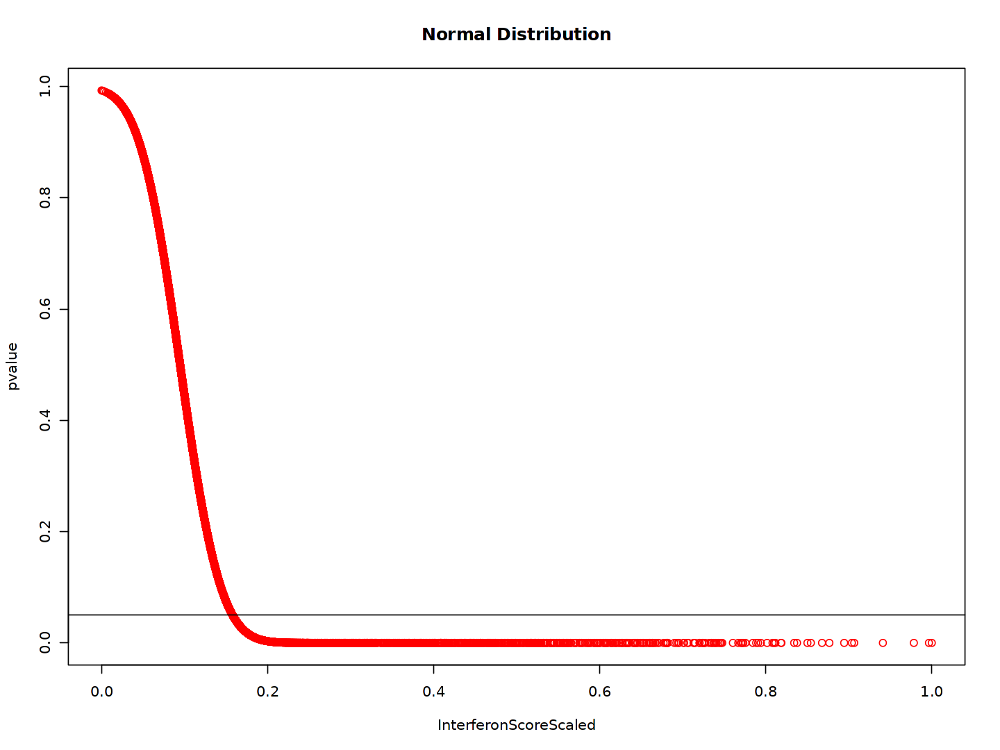

In [129]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="InterferonScoreScaled", ylab="pvalue", col = "red")
abline(h=0.05)

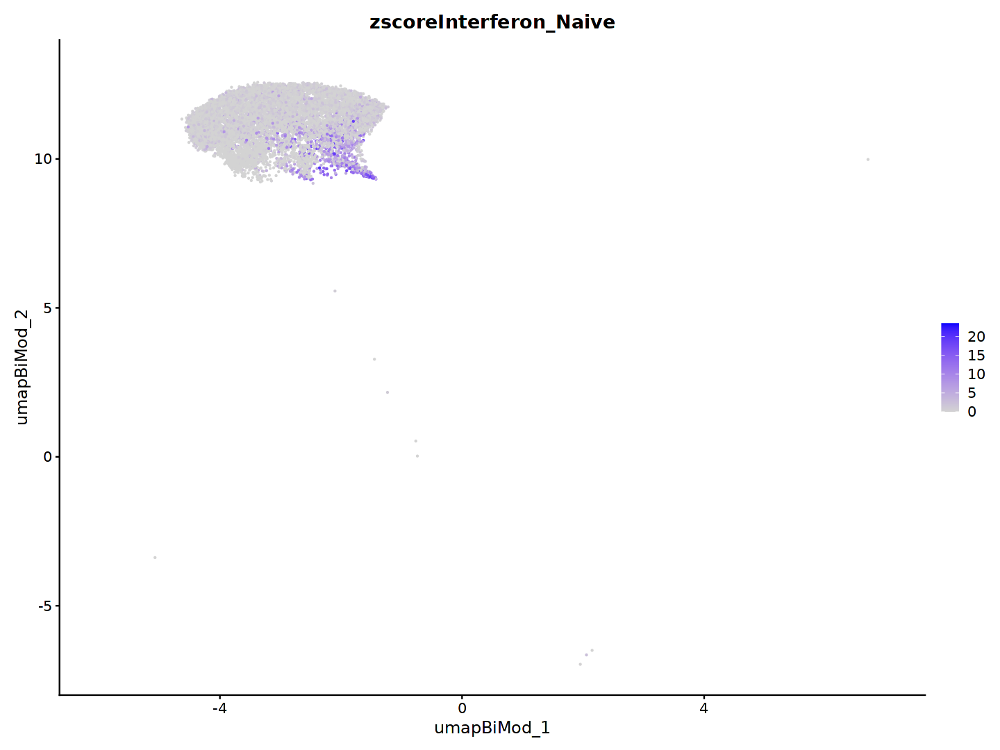

In [130]:
FeaturePlot(tmp, features="zscoreInterferon_Naive", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

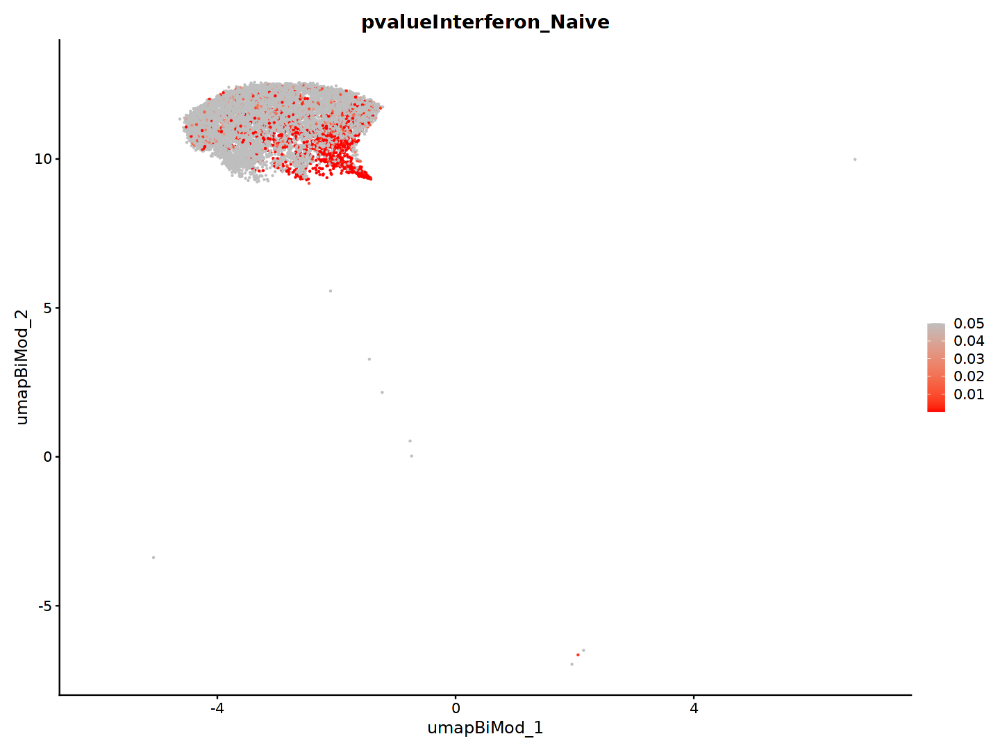

In [131]:
FeaturePlot(tmp, features="pvalueInterferon_Naive", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [132]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScore"] <- tmp$InterferonScore
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaled"] <-tmp$InterferonScoreScaled
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_Naive"] <-tmp$zscoreInterferon_Naive
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_Naive"] <-tmp$pvalueInterferon_Naive

##### 3.1.1.6 Ependymal cells

In [133]:
tmp <- subset(MORNAATACC, subset = cellType == "Epen")

In [134]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [135]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  256   600   261   188   132 

In [136]:
tmp$InterferonScore <- NULL
tmp$InterferonScoreScaled <- NULL
tmp$zscoreInterferon_Naive <- NULL
tmp$pvalueInterferon_Naive <- NULL
tmp$Interferon <- NULL

In [137]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [138]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScore")

In [139]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaled <- (tmp$InterferonScore - min(tmp$InterferonScore)) / (max(tmp$InterferonScore) - min(tmp$InterferonScore))

Picking joint bandwidth of 0.0271



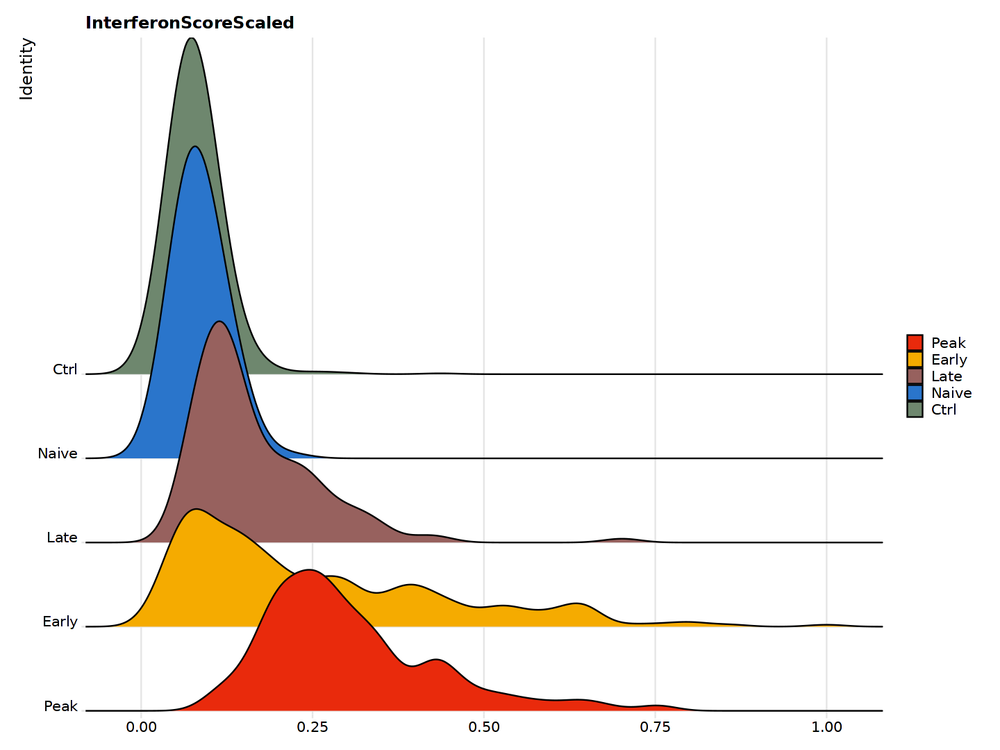

In [140]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaled', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [141]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [142]:
#Calculating mean and standard deviation for Naive population
meanInterferon_Naive <- mean(tmp_Naive$InterferonScoreScaled)
sdInterferon_Naive <- sd(tmp_Naive$InterferonScoreScaled)

In [143]:
#Calculate zscore
tmp_Naive$zscoreInterferon <- (tmp_Naive$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [144]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferon <- pnorm(tmp_Naive$zscoreInterferon, mean = 0, sd = 1, lower.tail=FALSE)

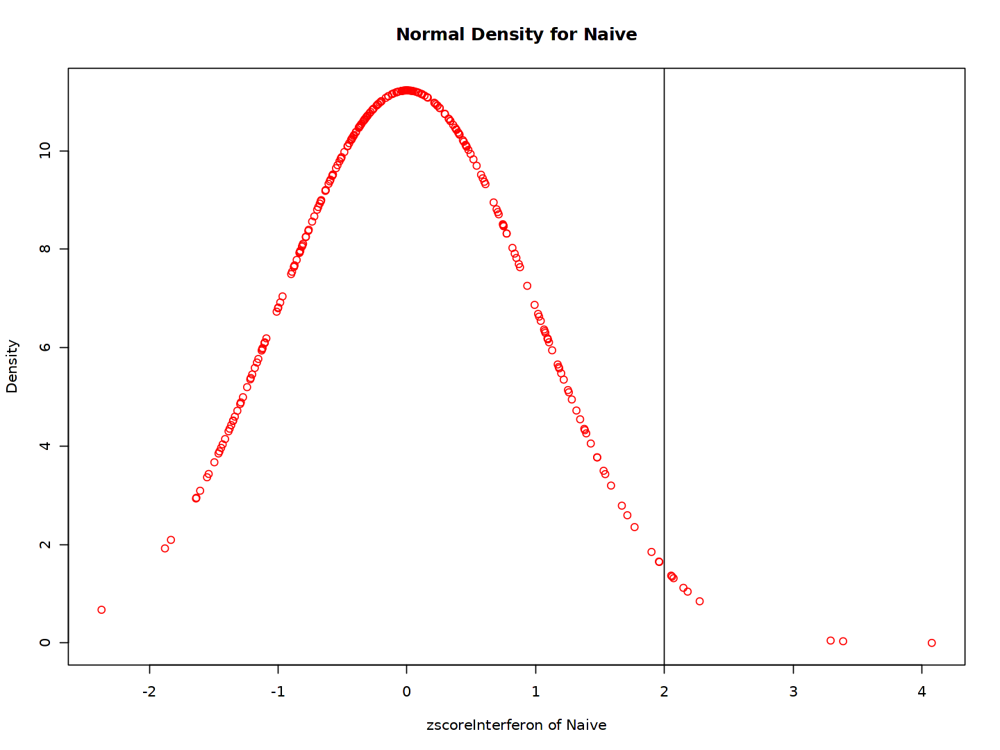

In [145]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,dnorm(tmp_Naive$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

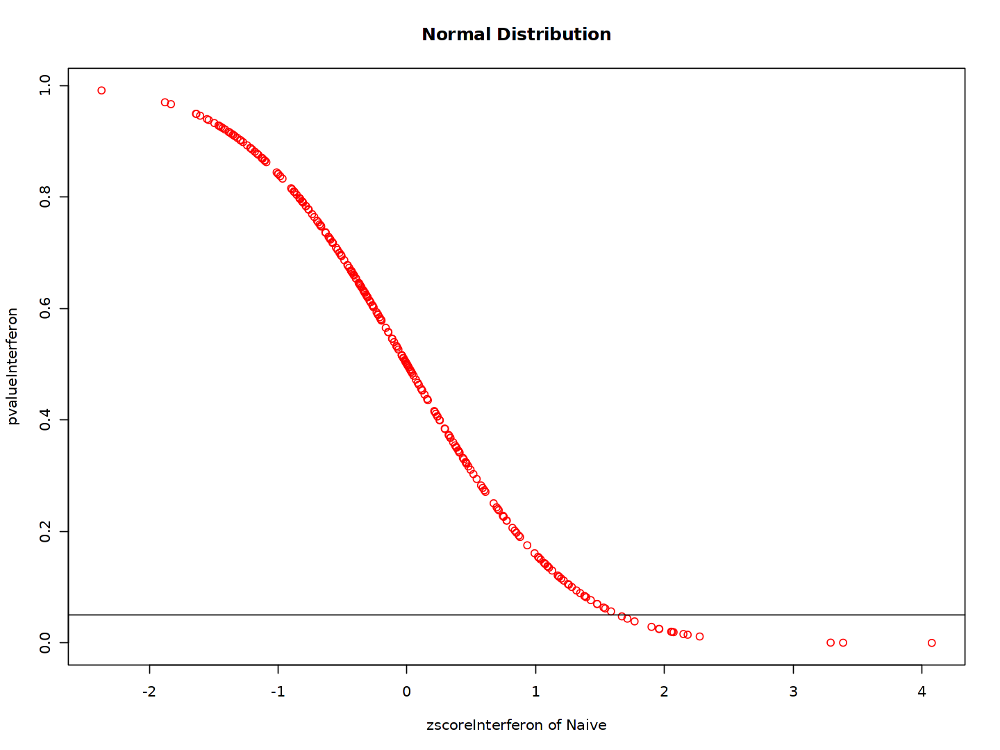

In [146]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferon,tmp_Naive$pvalueInterferon, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [147]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_Naive = (tmp$InterferonScoreScaled-meanInterferon_Naive)/sdInterferon_Naive

In [148]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_Naive <- pnorm(tmp$zscoreInterferon_Naive, mean = 0, sd = 1, lower.tail=FALSE)

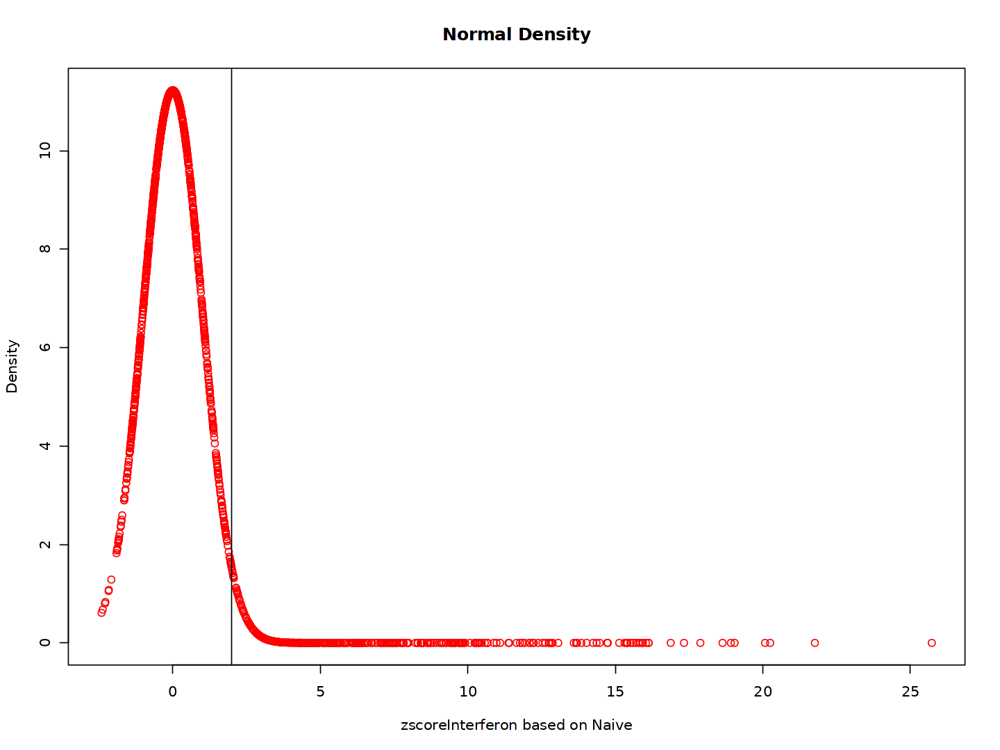

In [149]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="zscoreInterferon based on Naive", ylab="Density", col = "red")
abline(v=2)

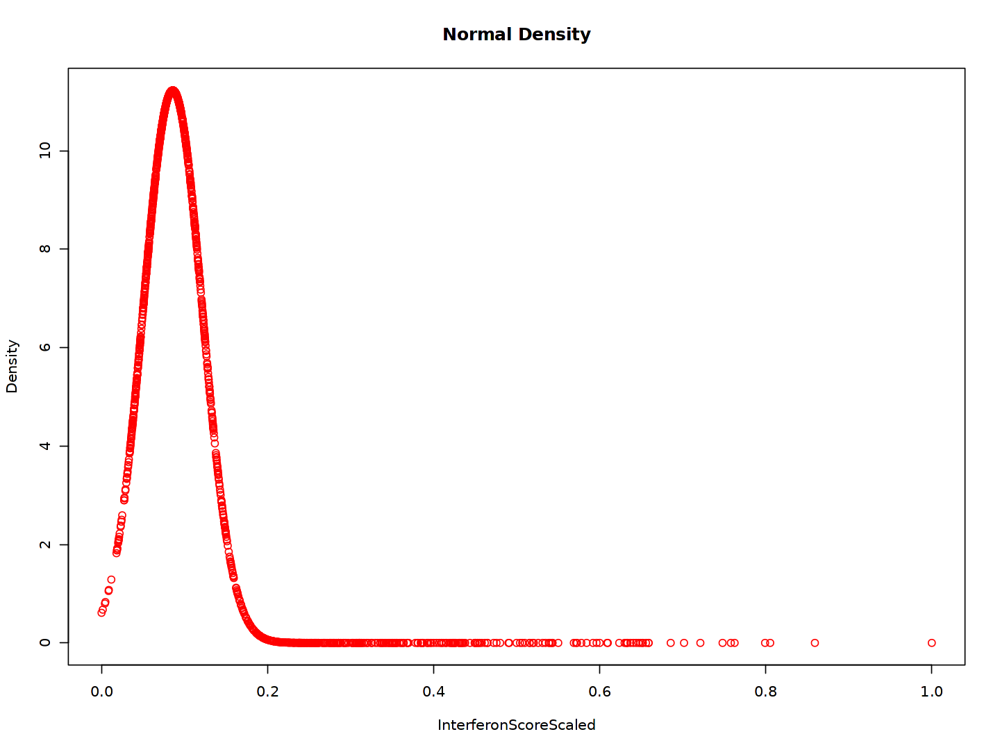

In [150]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,dnorm(tmp$InterferonScoreScaled, mean = meanInterferon_Naive, sd = sdInterferon_Naive), main = "Normal Density", xlab="InterferonScoreScaled", ylab="Density", col = "red")

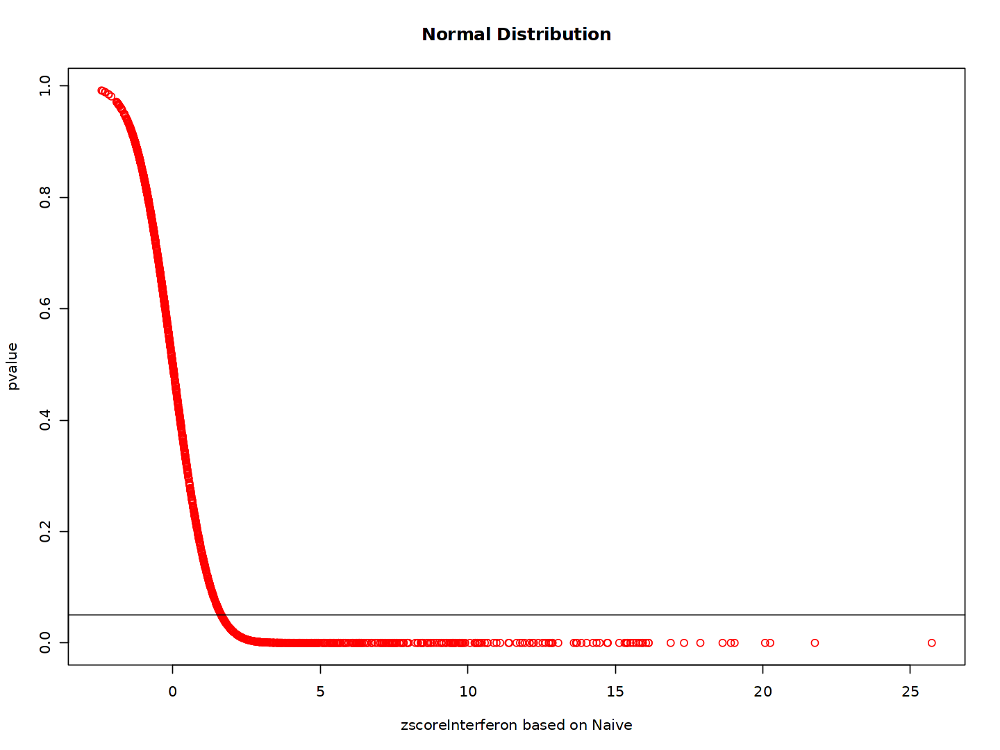

In [151]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_Naive,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="zscoreInterferon based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

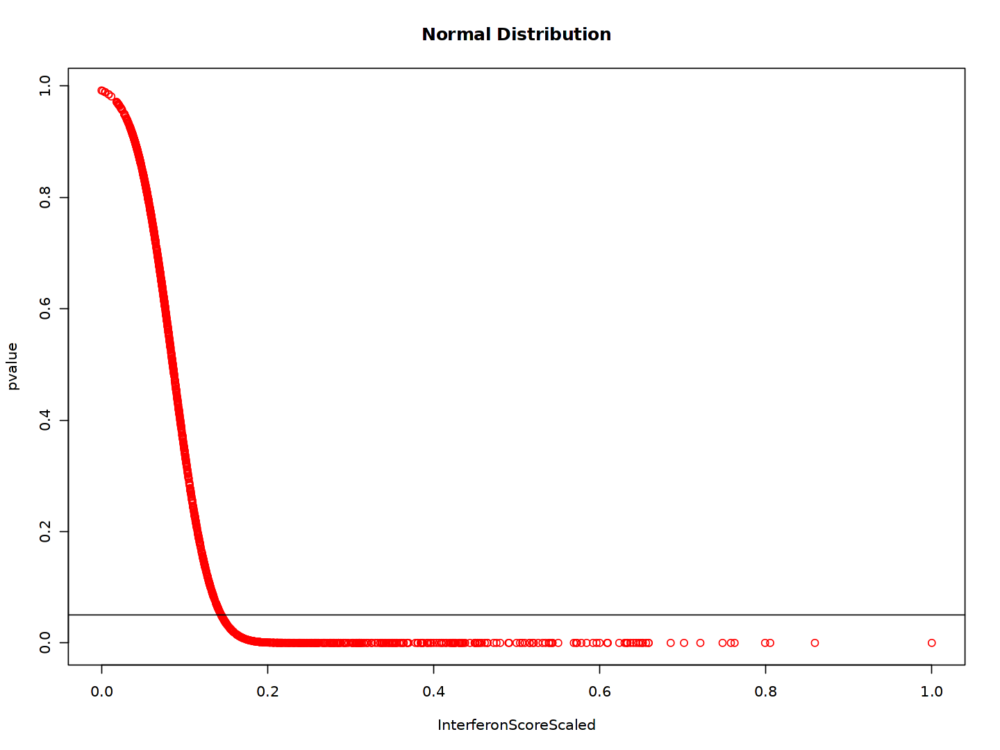

In [152]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaled,tmp$pvalueInterferon_Naive, main = "Normal Distribution", xlab="InterferonScoreScaled", ylab="pvalue", col = "red")
abline(h=0.05)

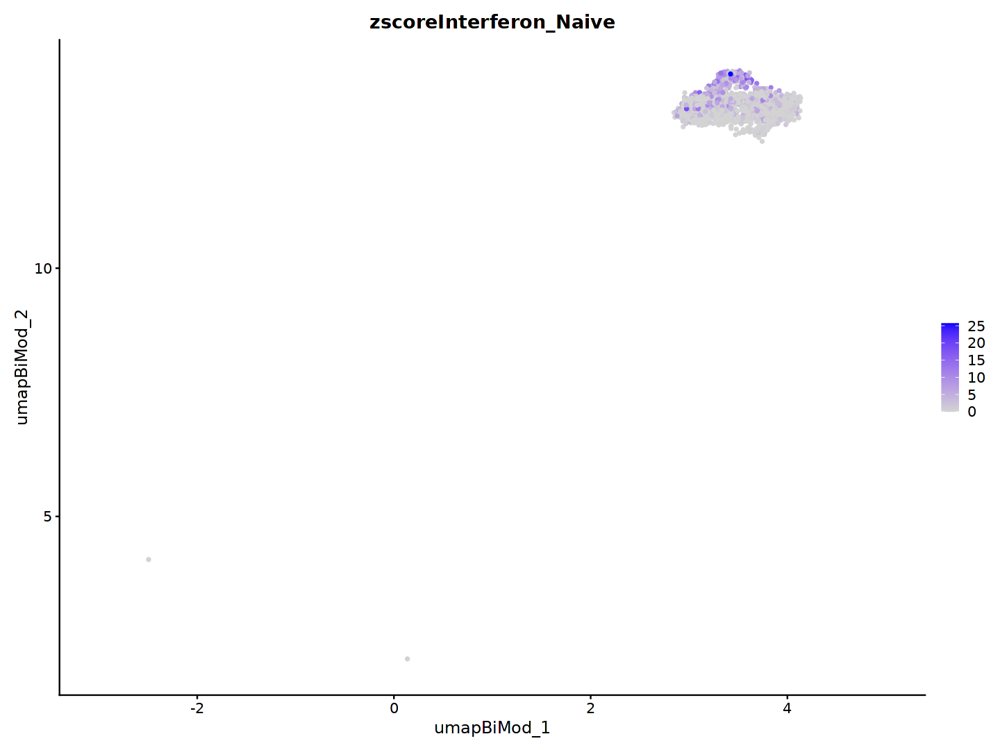

In [153]:
FeaturePlot(tmp, features="zscoreInterferon_Naive", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

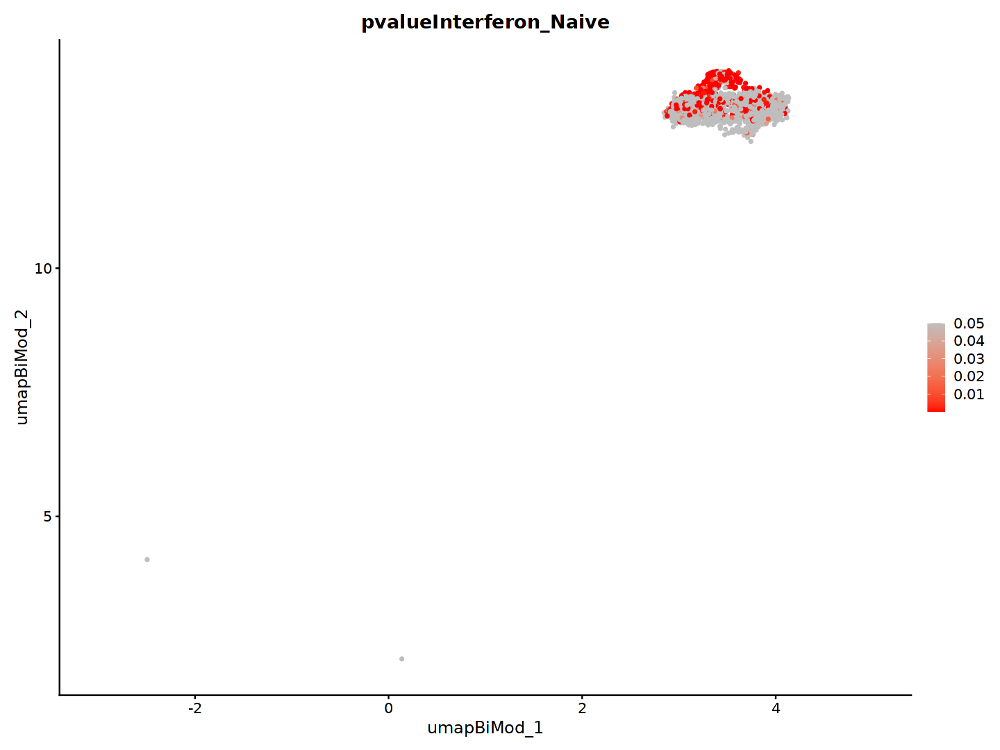

In [154]:
FeaturePlot(tmp, features="pvalueInterferon_Naive", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [155]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScore"] <- tmp$InterferonScore
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaled"] <-tmp$InterferonScoreScaled
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_Naive"] <-tmp$zscoreInterferon_Naive
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_Naive"] <-tmp$pvalueInterferon_Naive

##### 3.1.1.7 Neurons

In [156]:
#Not enough Naïve cells

#### 3.1.2 Annotate Interferon cells

In [157]:
for (i in 1:nrow(MORNAATACC@meta.data)){
    if(is.na(MORNAATACC@meta.data[i,"pvalueInterferon_Naive"])){
        MORNAATACC@meta.data[i,"Interferon"] <- "NonInterferon"
    }else{
        if(MORNAATACC@meta.data[i,"pvalueInterferon_Naive"] <= 0.05){
            MORNAATACC@meta.data[i,"Interferon"] <- "Interferon"
        }else{
            MORNAATACC@meta.data[i,"Interferon"] <- "NonInterferon"
        }
    }
}

In [158]:
MORNAATACC$Interferon <- factor(x = MORNAATACC$Interferon, levels = names(interferon_colors))

#### 3.1.3 Visualizing the scores

In [159]:
ctrl <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Ctrl",]
early <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Early",]
peak <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Peak",]
late <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Late",]

In [160]:
df <- data.frame(
   InterferonScoreScaled = c(ctrl$InterferonScoreScaled, early$InterferonScoreScaled, peak$InterferonScoreScaled, late$InterferonScoreScaled), 
   timepoint = c(rep("Ctrl", length(ctrl$InterferonScoreScaled)), rep("Early", length(early$InterferonScoreScaled)), rep("Peak", length(peak$InterferonScoreScaled)), rep("Late", length(late$InterferonScoreScaled)))
)

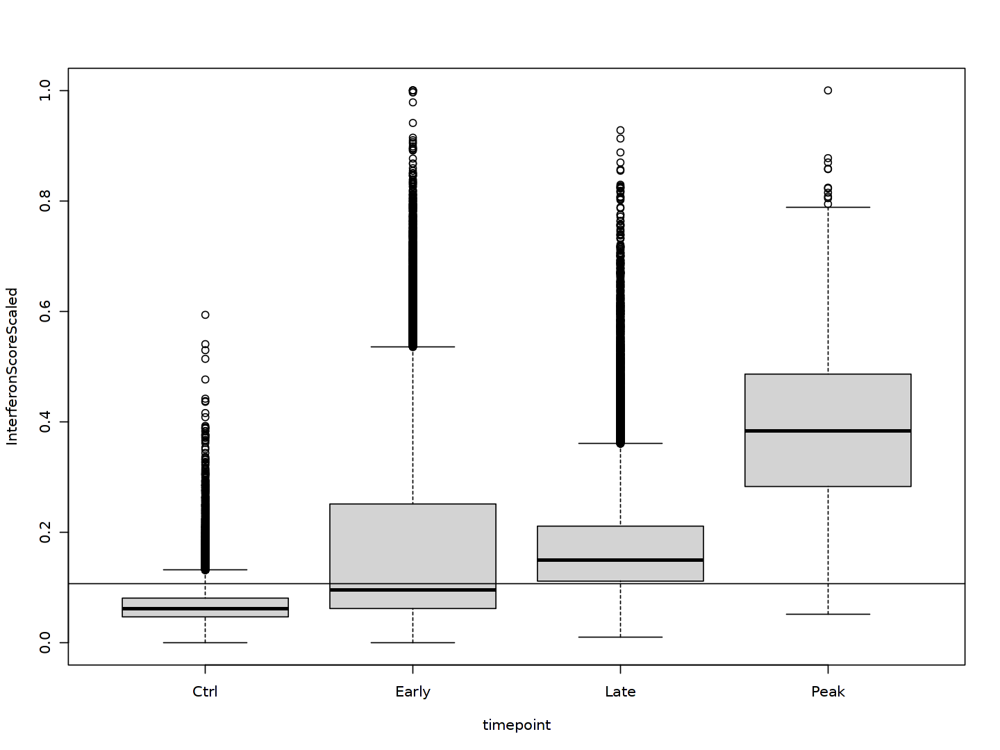

In [161]:
options(repr.plot.width=12, repr.plot.height=9)
boxplot(InterferonScoreScaled ~ timepoint, data = df, ylim=c(0,1))
abline(h=min(MORNAATACC$InterferonScoreScaled[MORNAATACC$Interferon == "Interferon"]))

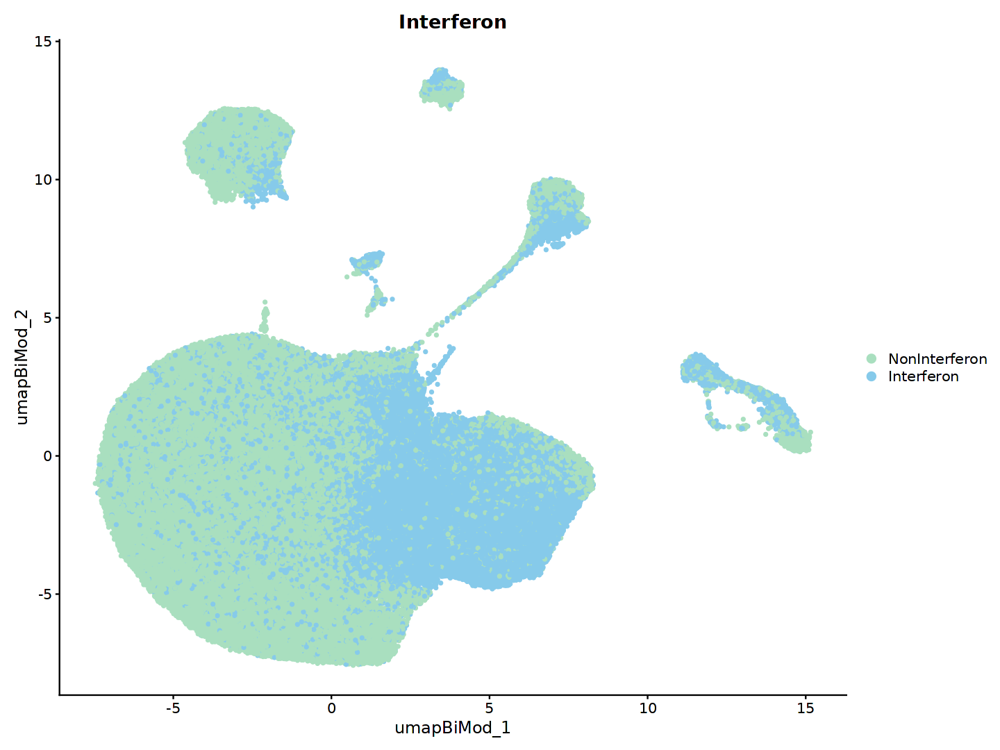

In [164]:
options(repr.plot.width=12, repr.plot.height=9)
DimPlot(MORNAATACC, reduction="umap_BiMod", group.by = "Interferon", shuffle = TRUE, cols = interferon_colors, pt.size = 1, raster=FALSE)

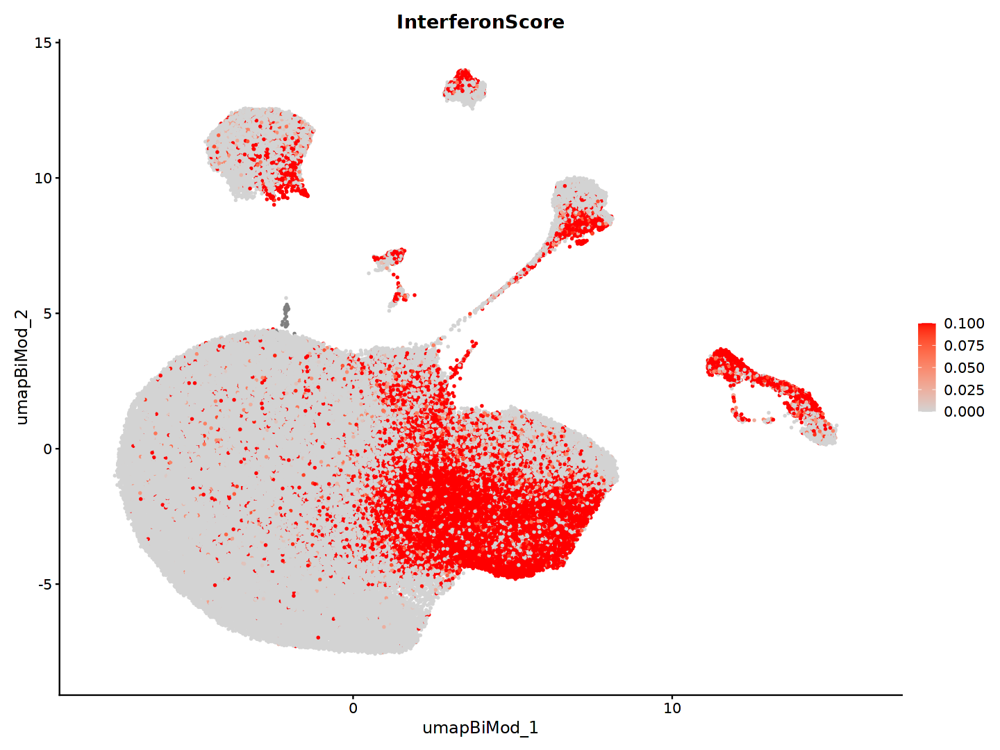

In [10]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC, features = "InterferonScore", reduction = "umap_BiMod", cols=c("lightgrey", "red"), pt.size=0.5, min.cutoff = 0, max.cutoff = 0.1, raster=FALSE)

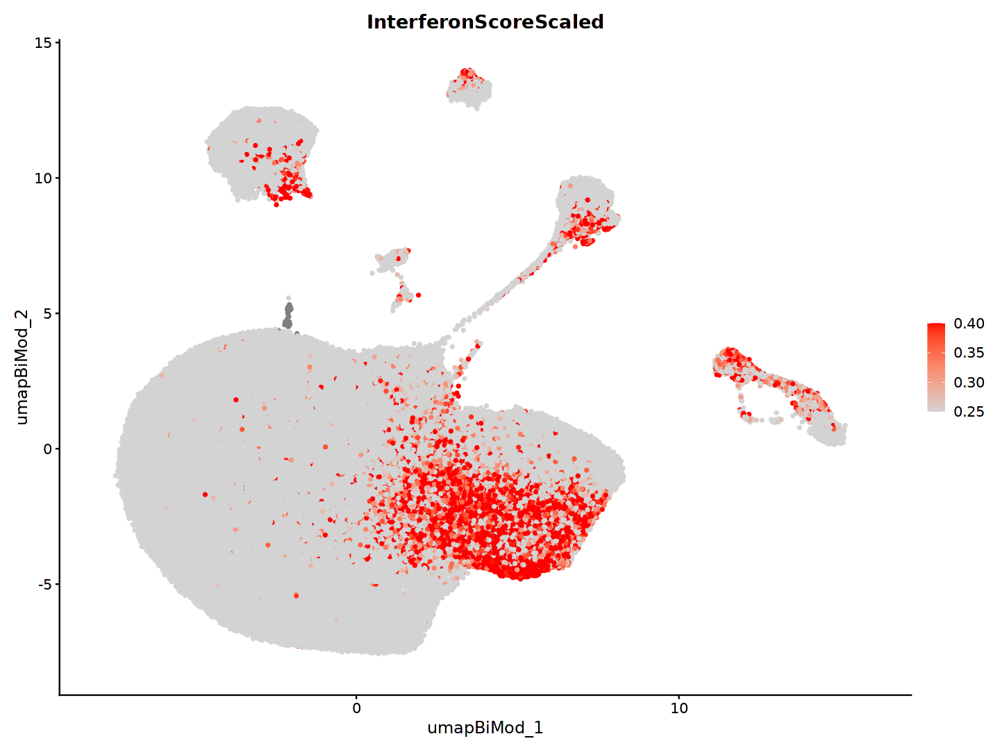

In [165]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC, features = "InterferonScoreScaled", reduction = "umap_BiMod", cols=c("lightgrey", "red"), pt.size=1, max.cutoff = 0.4, min.cutoff = 0.25, raster=FALSE)

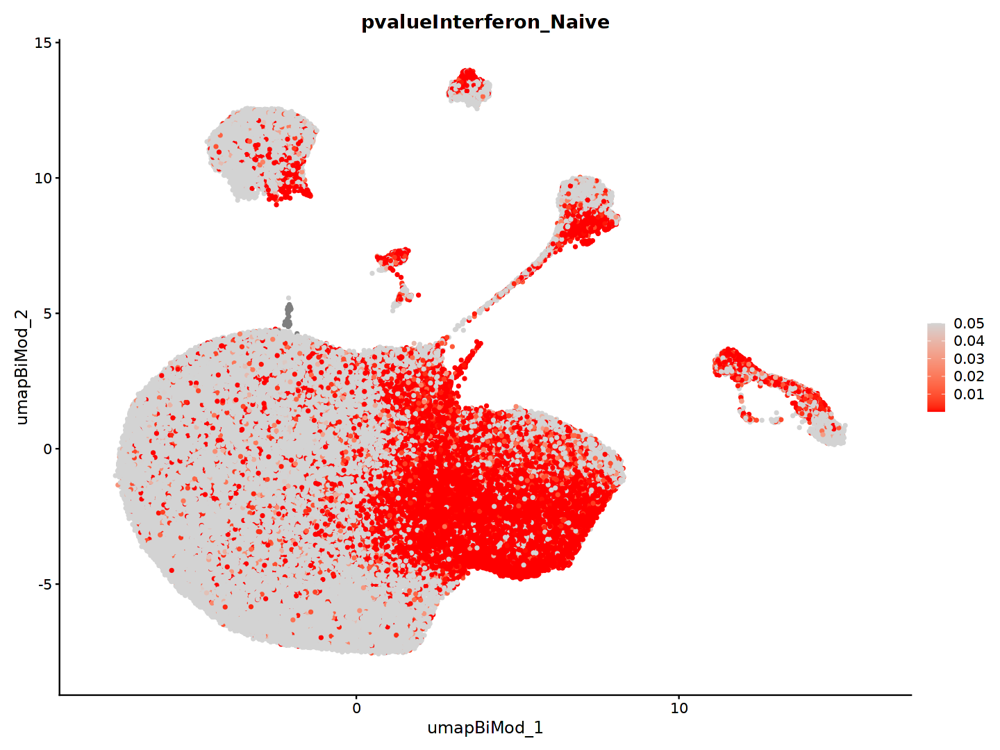

In [166]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC, features = "pvalueInterferon_Naive", reduction = "umap_BiMod", cols = c("red", "lightgrey"), pt.size=1, max.cutoff = 0.05, raster=FALSE)

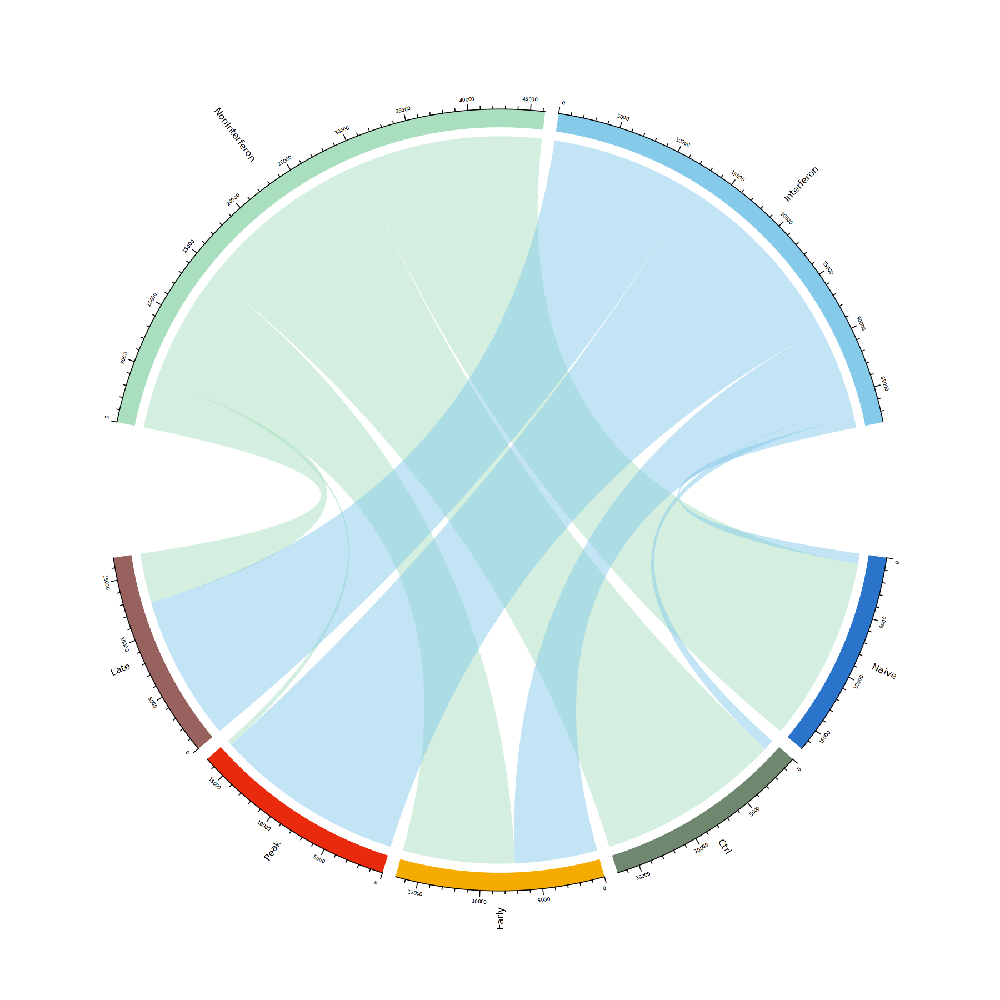

In [167]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(80)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$orig.ident_merge))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

### 3.2 Interferon score calculation based on ATAC

In [168]:
list_interferon = unique(c('H2-D1','H2-K1','Ifit3','Ifit1','Usp18','Ifi27l2a','H2-T23','Irf7','Igtp','Rsad2','Gbp7','Gbp3','Tap1','Ifih1','Bst2','Rtp4','Ddx58','Eif2ak2','Psmb8','Zc3hav1','Irgm1','B2m','Irf9','Stat1','Ifit3b','Gm20257','Ifi27','Pard6g','Gm48249'))

In [169]:
non_null_genes <- names(which(rowSums(MORNAATACC[['GenePromAcc']]@counts) > 0))

In [170]:
length(list_interferon)

[1] 29

In [171]:
list_interferon <- list_interferon[list_interferon %in% rownames(MORNAATACC[['GenePromAcc']]@counts)]
list_interferon <- list_interferon[list_interferon %in% unique(non_null_genes)]

In [172]:
length(list_interferon)

[1] 26

In [173]:
DefaultAssay(MORNAATACC) <- "GenePromAcc"

In [174]:
MORNAATACC$InterferonScoreGenePromAcc <- NA
MORNAATACC$InterferonScoreScaledGenePromAcc <- NA
MORNAATACC$zscoreInterferon_NaiveGenePromAcc <- NA
MORNAATACC$pvalueInterferon_NaiveGenePromAcc <- NA
MORNAATACC$InterferonGenePromAcc <- NA

#### 3.2.1 Set up interferon score

We will use as postulate that Naive cells are the base line of non interferon related cells.

The InterferonScore will be calculated independently for each cell type based on the associated Naive population.

The Naive InterferonScore distribution for each cell type will be used to test InterferonScore of the other cells.

The InterferonScore is following a Gaussian distribution for all cell types separetely and all together.

Cells having a pvalue higher than 0.05 of falling into the Naive InterferonScore distribution will be classified as "Non Interferon".

All cells with less than 0.05 pvalue reject the null hyphotesis stating that each individual InterferonScore equals the mean of the Naive InterferonScore distribution.

##### 3.2.1.1 MOL

In [175]:
tmp <- subset(MORNAATACC, subset = cellType == "MOL")

In [176]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [177]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
15805 42564 30913 14445 28689 

In [178]:
tmp$InterferonScoreGenePromAcc <- NULL
tmp$InterferonScoreScaledGenePromAcc <- NULL
tmp$zscoreInterferon_NaiveGenePromAcc <- NULL
tmp$pvalueInterferon_NaiveGenePromAcc <- NULL
tmp$InterferonGenePromAcc <- NULL

In [179]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [180]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScoreGenePromAcc")

In [181]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaledGenePromAcc <- (tmp$InterferonScoreGenePromAcc - min(tmp$InterferonScoreGenePromAcc)) / (max(tmp$InterferonScoreGenePromAcc) - min(tmp$InterferonScoreGenePromAcc))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Picking joint bandwidth of 0.0106



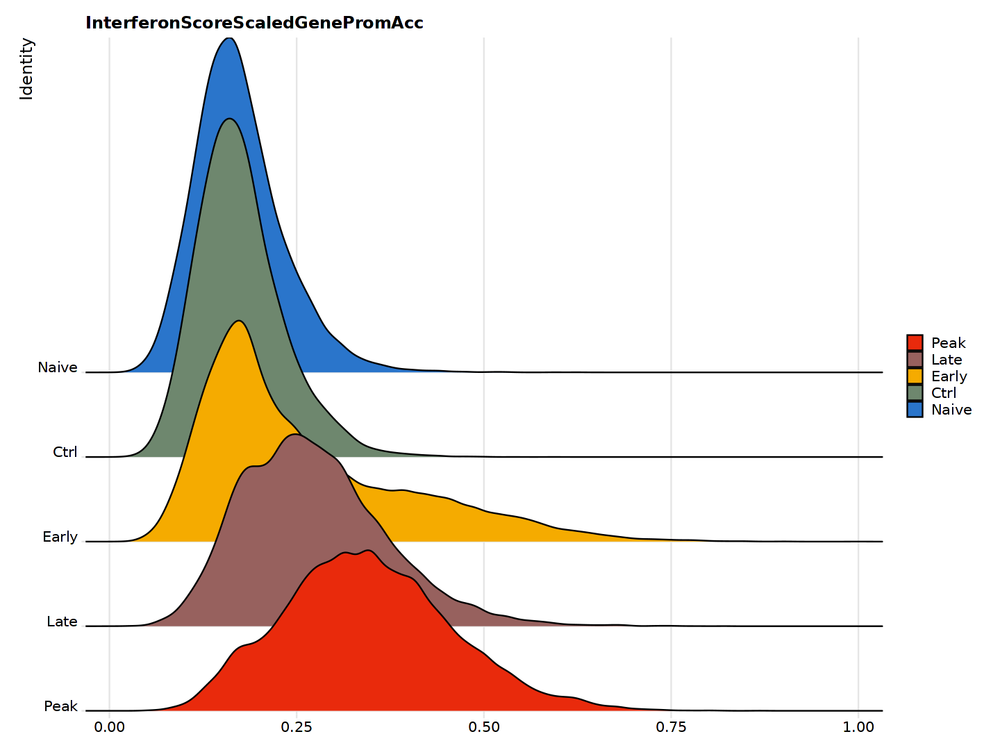

In [182]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaledGenePromAcc', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [183]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [184]:
#Calculating mean and standard deviation for Naive population
meanInterferon_NaiveGenePromAcc <- mean(tmp_Naive$InterferonScoreScaledGenePromAcc)
sdInterferon_NaiveGenePromAcc <- sd(tmp_Naive$InterferonScoreScaledGenePromAcc)

In [185]:
#Calculate zscore
tmp_Naive$zscoreInterferonGenePromAcc <- (tmp_Naive$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [186]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferonGenePromAcc <- pnorm(tmp_Naive$zscoreInterferonGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

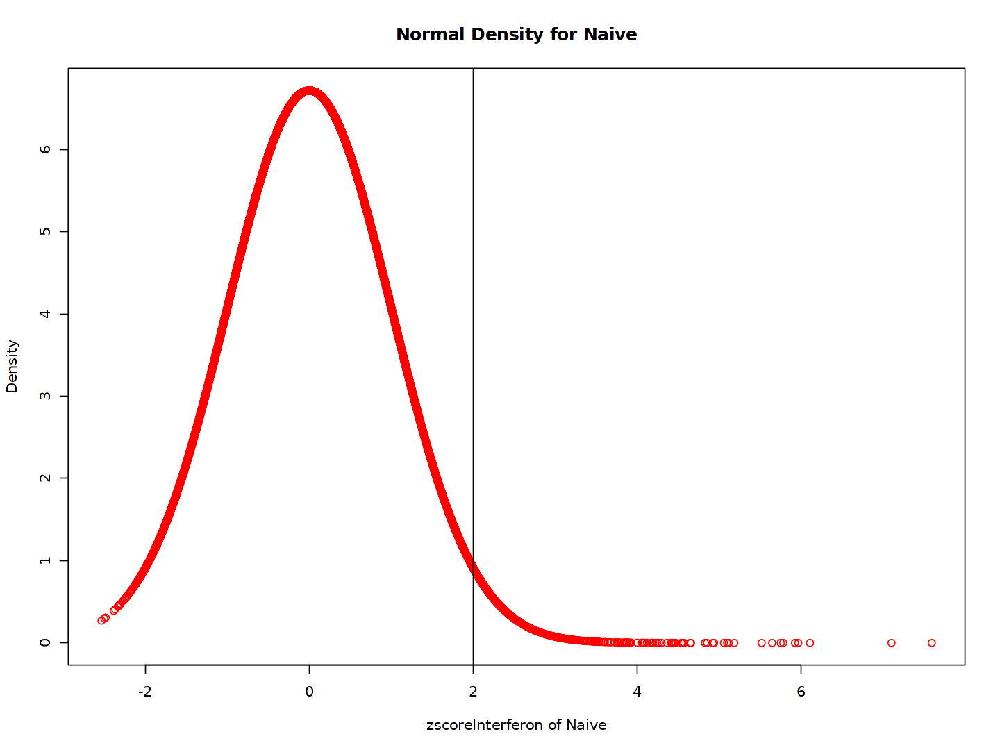

In [187]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,dnorm(tmp_Naive$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

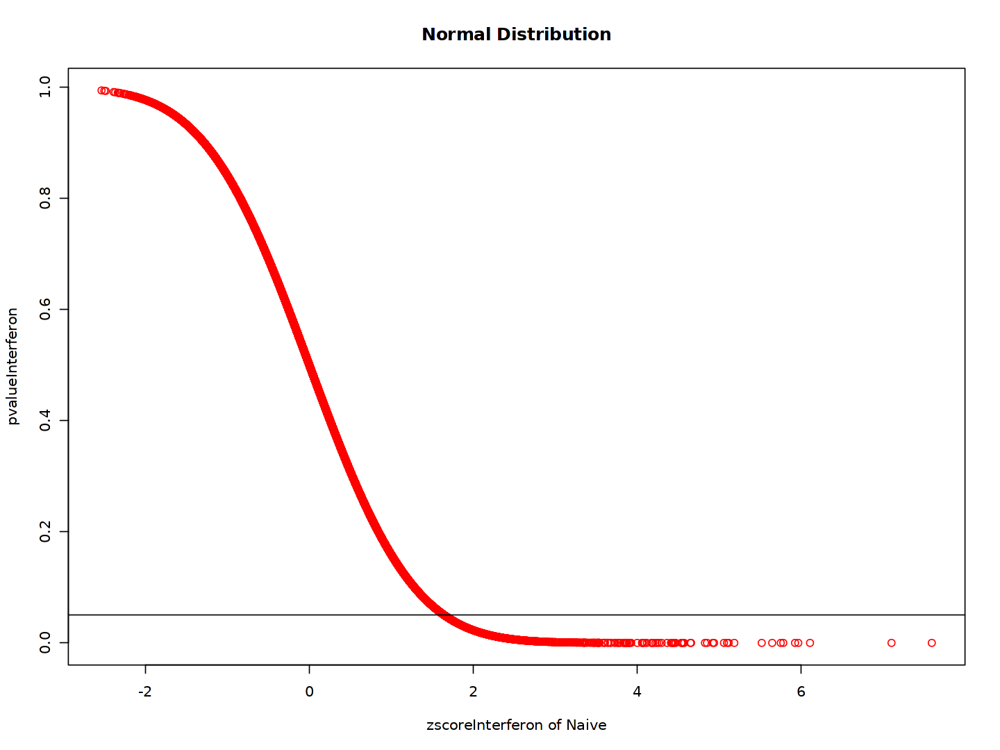

In [188]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,tmp_Naive$pvalueInterferonGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [189]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_NaiveGenePromAcc = (tmp$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [190]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_NaiveGenePromAcc <- pnorm(tmp$zscoreInterferon_NaiveGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

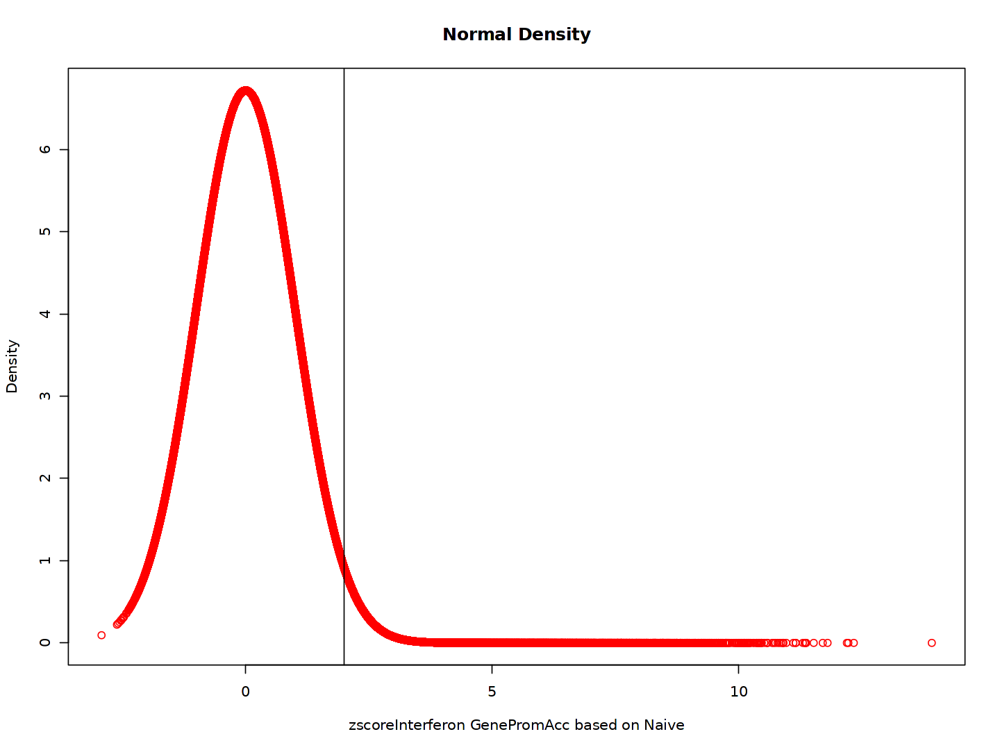

In [191]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="zscoreInterferon GenePromAcc based on Naive", ylab="Density", col = "red")
abline(v=2)

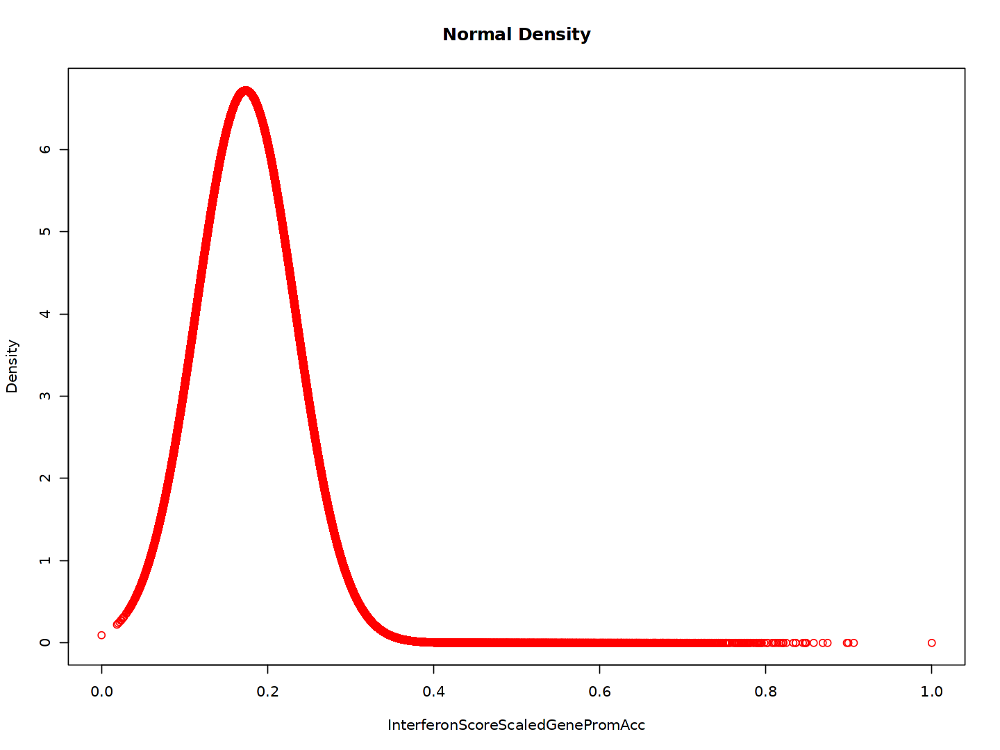

In [192]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="InterferonScoreScaledGenePromAcc", ylab="Density", col = "red")

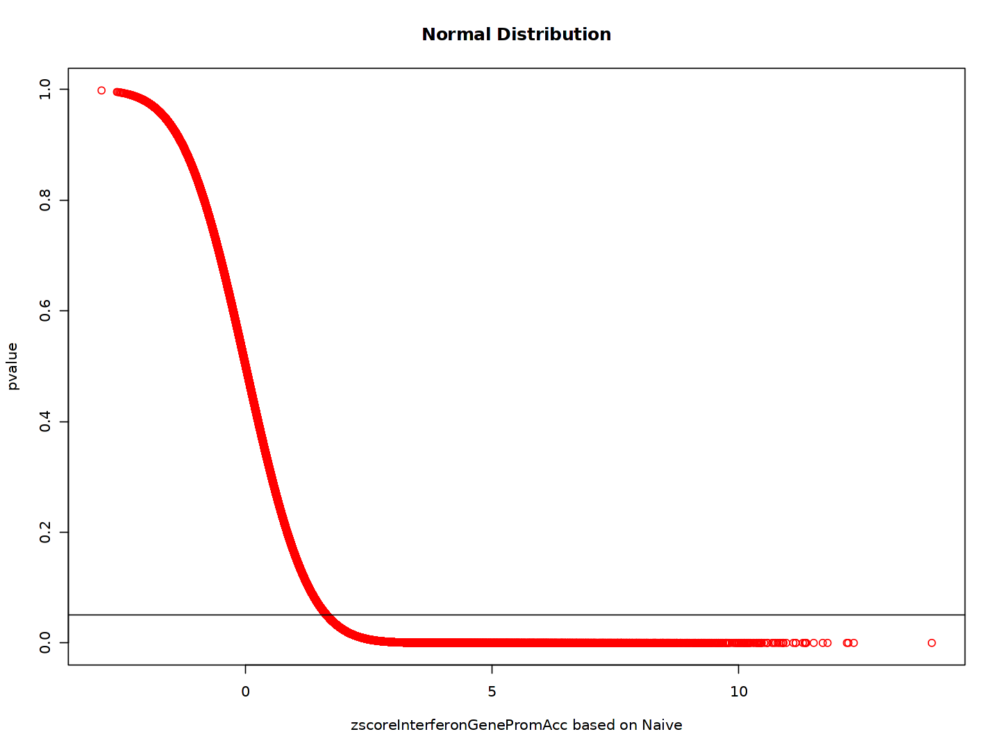

In [193]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferonGenePromAcc based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

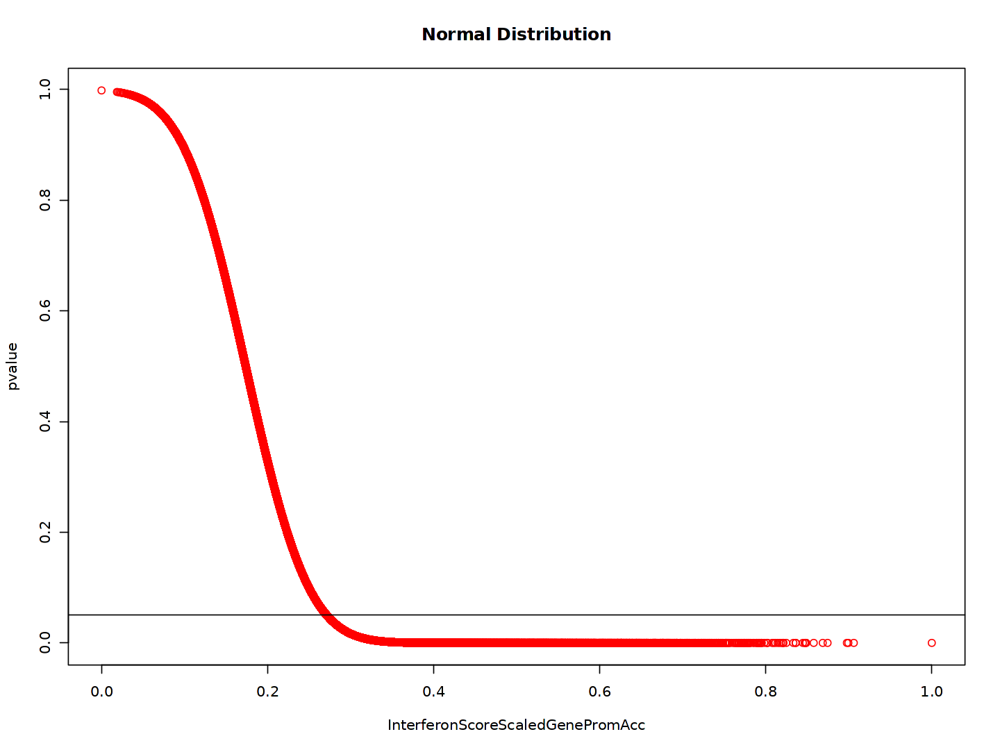

In [194]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="InterferonScoreScaledGenePromAcc", ylab="pvalue", col = "red")
abline(h=0.05)

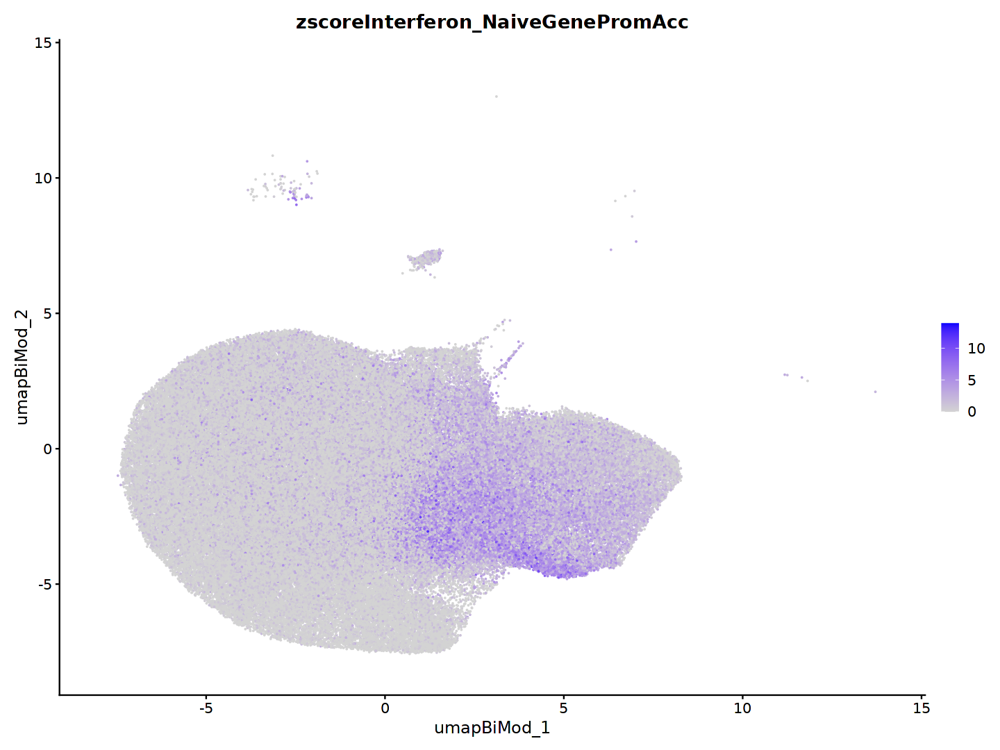

In [195]:
FeaturePlot(tmp, features="zscoreInterferon_NaiveGenePromAcc", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

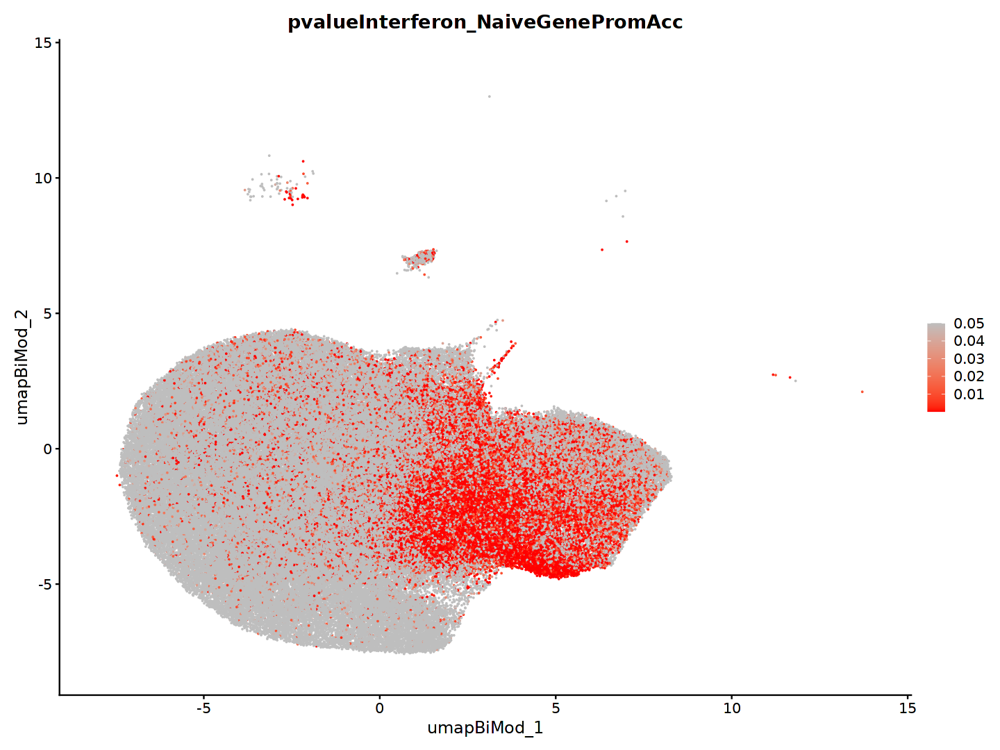

In [196]:
FeaturePlot(tmp, features="pvalueInterferon_NaiveGenePromAcc", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [197]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreGenePromAcc"] <- tmp$InterferonScoreGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaledGenePromAcc"] <-tmp$InterferonScoreScaledGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_NaiveGenePromAcc"] <-tmp$zscoreInterferon_NaiveGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_NaiveGenePromAcc"] <-tmp$pvalueInterferon_NaiveGenePromAcc

##### 3.2.1.2 OPC

In [198]:
tmp <- subset(MORNAATACC, subset = cellType == "OPC")

In [199]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [200]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  374   639   789   680  1395 

In [201]:
tmp$InterferonScoreGenePromAcc <- NULL
tmp$InterferonScoreScaledGenePromAcc <- NULL
tmp$zscoreInterferon_NaiveGenePromAcc <- NULL
tmp$pvalueInterferon_NaiveGenePromAcc <- NULL
tmp$InterferonGenePromAcc <- NULL

In [202]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [203]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScoreGenePromAcc")

In [204]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaledGenePromAcc <- (tmp$InterferonScoreGenePromAcc - min(tmp$InterferonScoreGenePromAcc)) / (max(tmp$InterferonScoreGenePromAcc) - min(tmp$InterferonScoreGenePromAcc))

Picking joint bandwidth of 0.0295



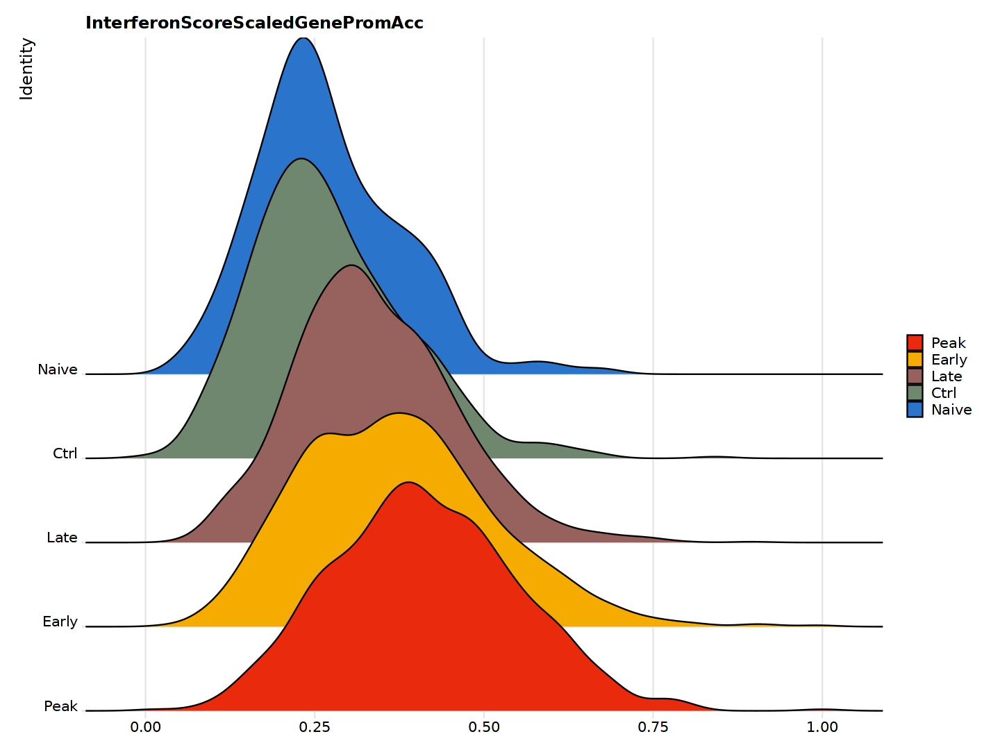

In [205]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaledGenePromAcc', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [206]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [207]:
#Calculating mean and standard deviation for Naive population
meanInterferon_NaiveGenePromAcc <- mean(tmp_Naive$InterferonScoreScaledGenePromAcc)
sdInterferon_NaiveGenePromAcc <- sd(tmp_Naive$InterferonScoreScaledGenePromAcc)

In [208]:
#Calculate zscore
tmp_Naive$zscoreInterferonGenePromAcc <- (tmp_Naive$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [209]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferonGenePromAcc <- pnorm(tmp_Naive$zscoreInterferonGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

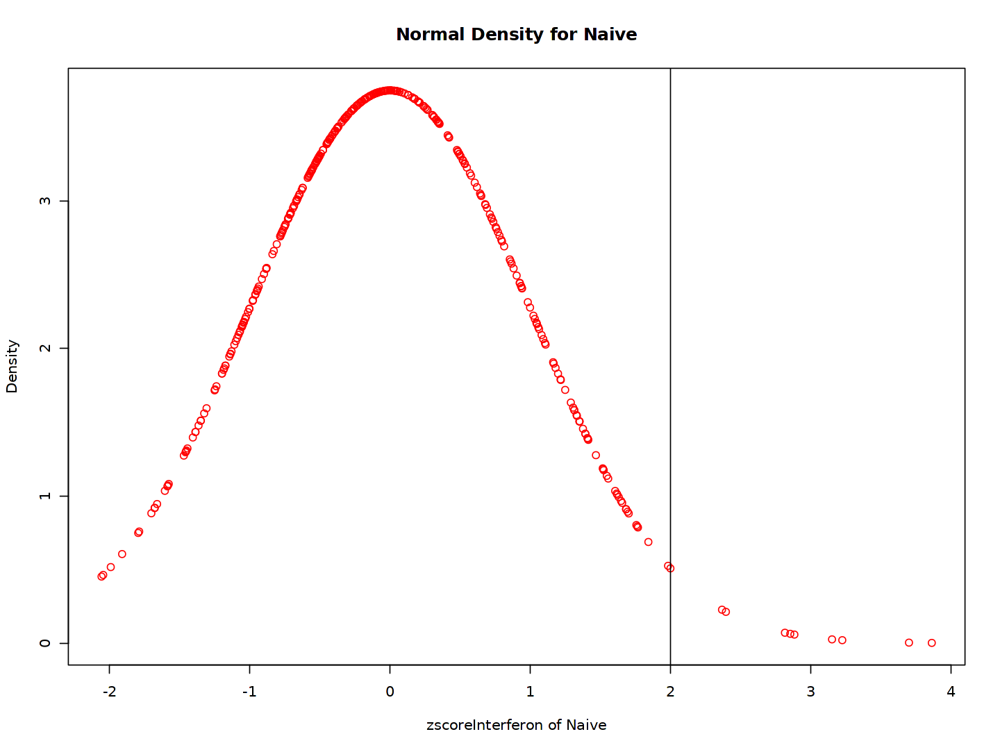

In [210]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,dnorm(tmp_Naive$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

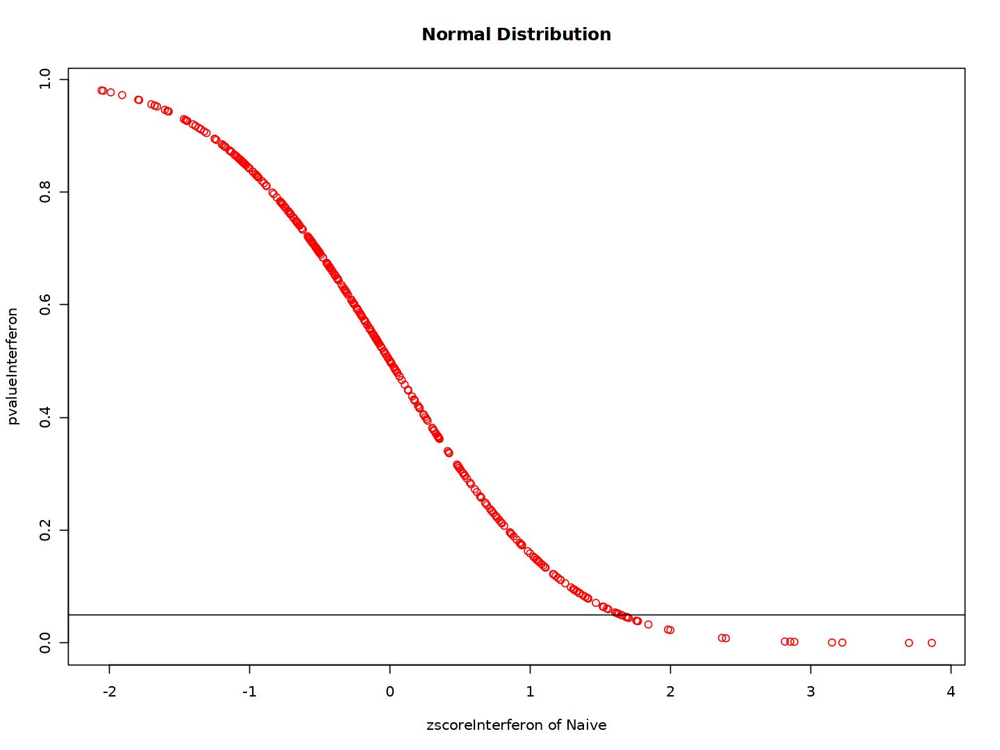

In [211]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,tmp_Naive$pvalueInterferonGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [212]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_NaiveGenePromAcc = (tmp$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [213]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_NaiveGenePromAcc <- pnorm(tmp$zscoreInterferon_NaiveGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

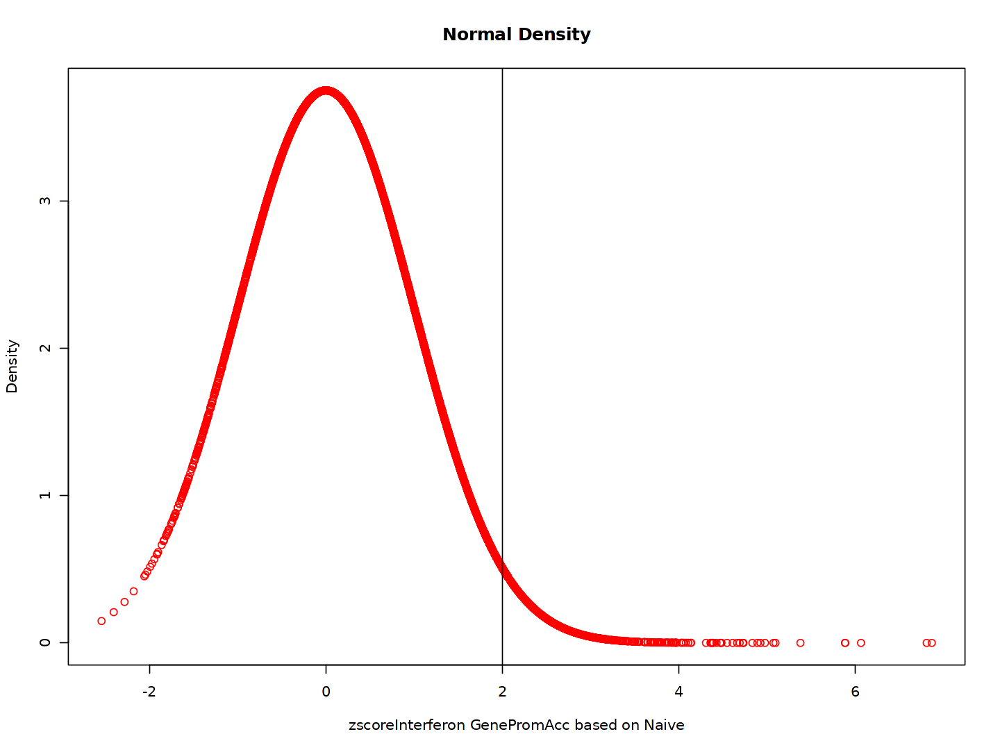

In [214]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="zscoreInterferon GenePromAcc based on Naive", ylab="Density", col = "red")
abline(v=2)

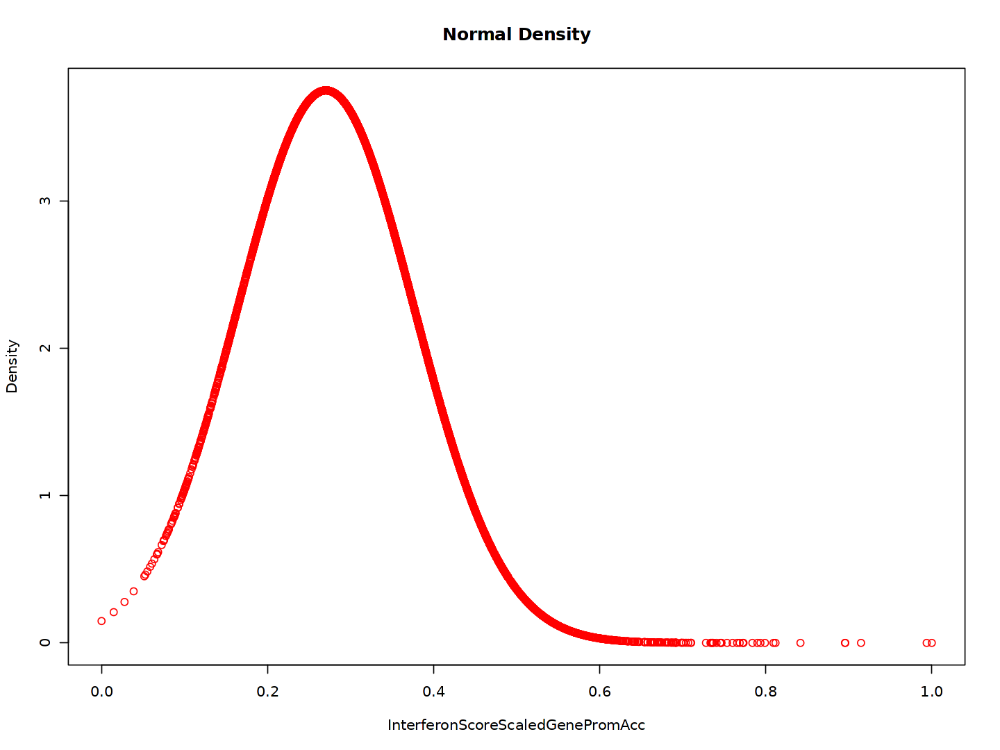

In [215]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="InterferonScoreScaledGenePromAcc", ylab="Density", col = "red")

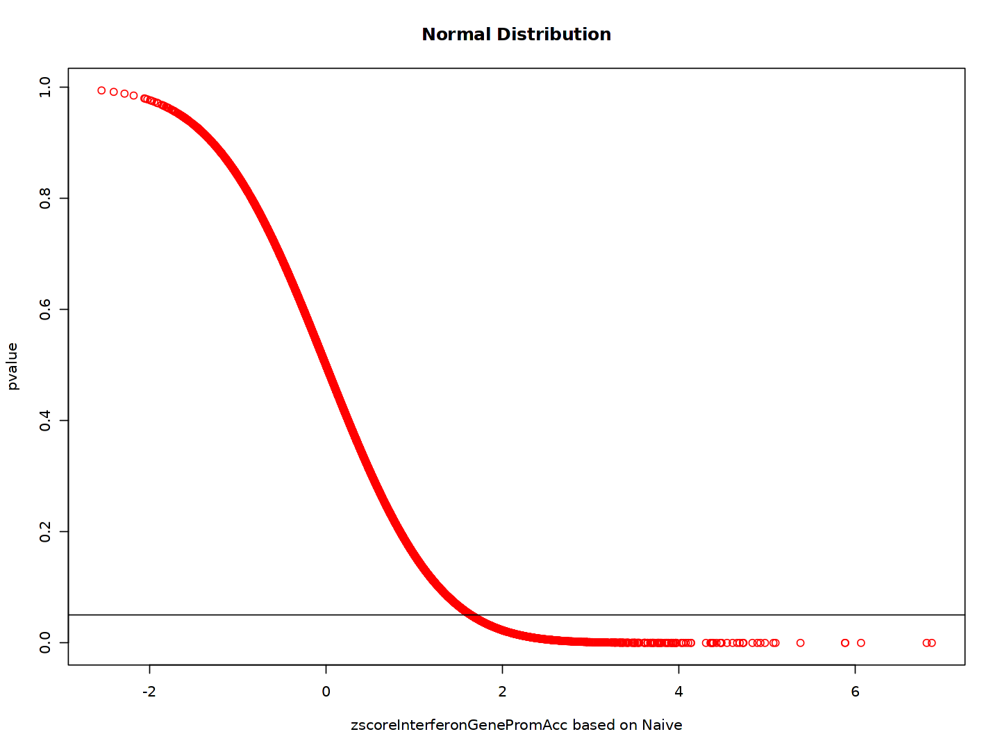

In [216]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferonGenePromAcc based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

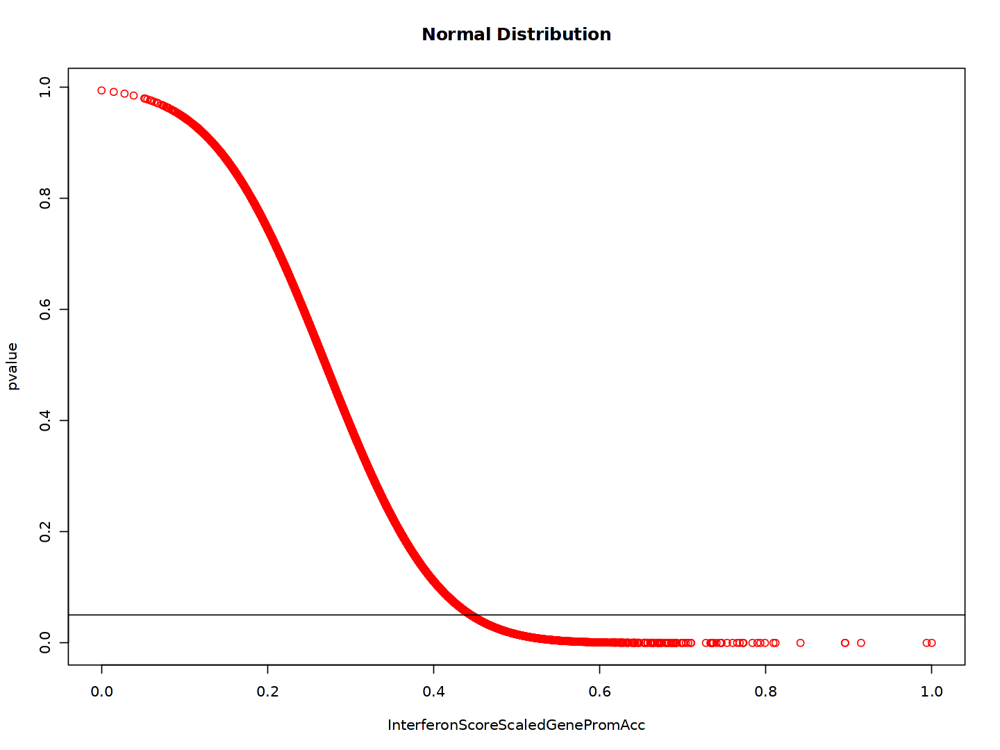

In [217]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="InterferonScoreScaledGenePromAcc", ylab="pvalue", col = "red")
abline(h=0.05)

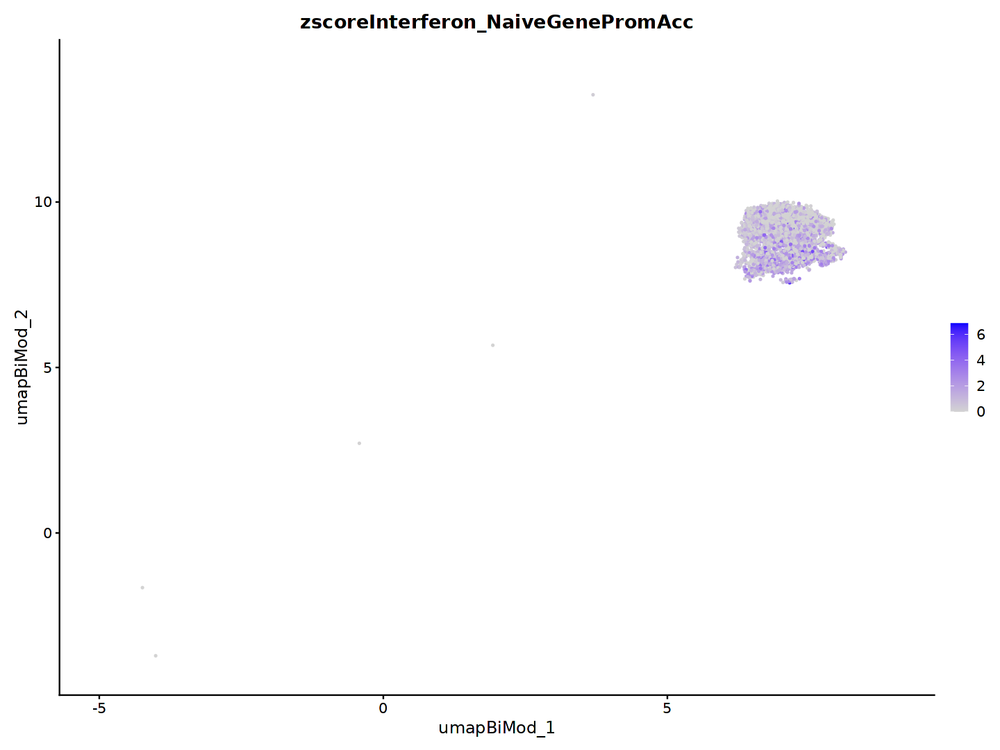

In [218]:
FeaturePlot(tmp, features="zscoreInterferon_NaiveGenePromAcc", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

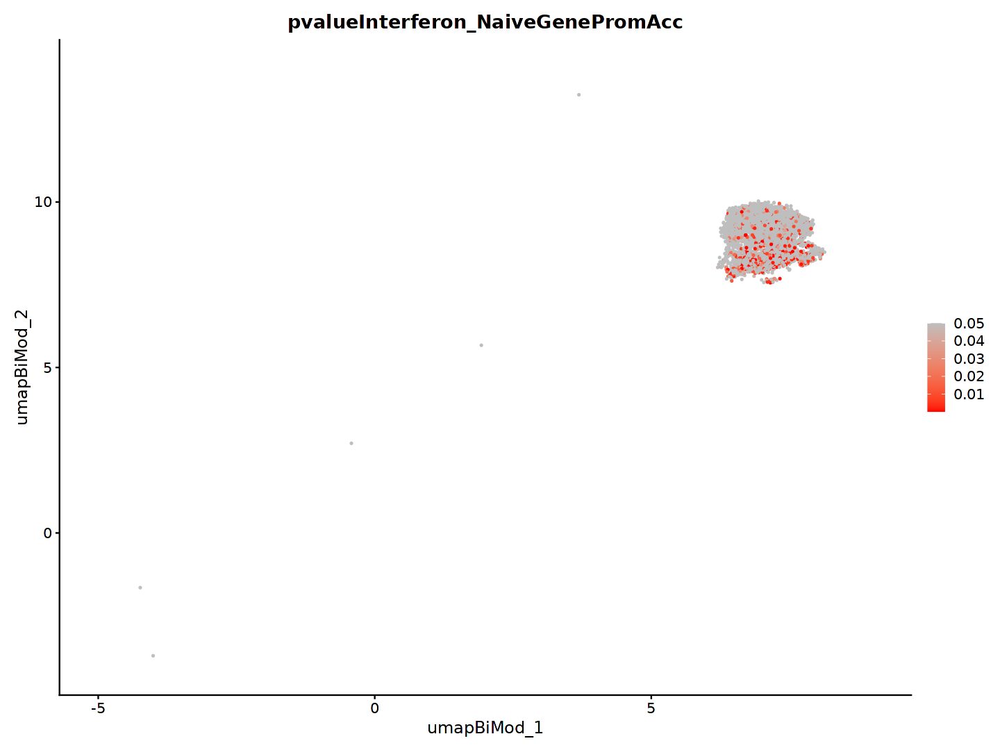

In [219]:
FeaturePlot(tmp, features="pvalueInterferon_NaiveGenePromAcc", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [220]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreGenePromAcc"] <- tmp$InterferonScoreGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaledGenePromAcc"] <-tmp$InterferonScoreScaledGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_NaiveGenePromAcc"] <-tmp$zscoreInterferon_NaiveGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_NaiveGenePromAcc"] <-tmp$pvalueInterferon_NaiveGenePromAcc

##### 3.2.1.3 COP

In [221]:
tmp <- subset(MORNAATACC, subset = cellType == "COP")

In [222]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [223]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  123    90   155   123   621 

In [224]:
tmp$InterferonScoreGenePromAcc <- NULL
tmp$InterferonScoreScaledGenePromAcc <- NULL
tmp$zscoreInterferon_NaiveGenePromAcc <- NULL
tmp$pvalueInterferon_NaiveGenePromAcc <- NULL
tmp$InterferonGenePromAcc <- NULL

In [225]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [226]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScoreGenePromAcc")

In [227]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaledGenePromAcc <- (tmp$InterferonScoreGenePromAcc - min(tmp$InterferonScoreGenePromAcc)) / (max(tmp$InterferonScoreGenePromAcc) - min(tmp$InterferonScoreGenePromAcc))

Picking joint bandwidth of 0.0384



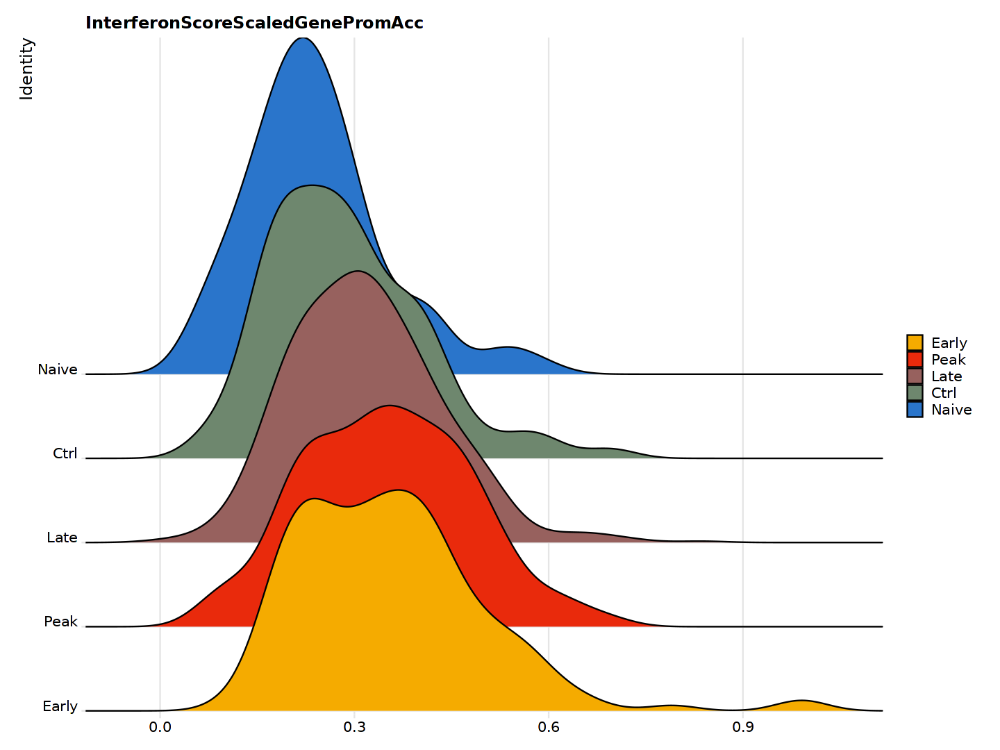

In [228]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaledGenePromAcc', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [229]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [230]:
#Calculating mean and standard deviation for Naive population
meanInterferon_NaiveGenePromAcc <- mean(tmp_Naive$InterferonScoreScaledGenePromAcc)
sdInterferon_NaiveGenePromAcc <- sd(tmp_Naive$InterferonScoreScaledGenePromAcc)

In [231]:
#Calculate zscore
tmp_Naive$zscoreInterferonGenePromAcc <- (tmp_Naive$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [232]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferonGenePromAcc <- pnorm(tmp_Naive$zscoreInterferonGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

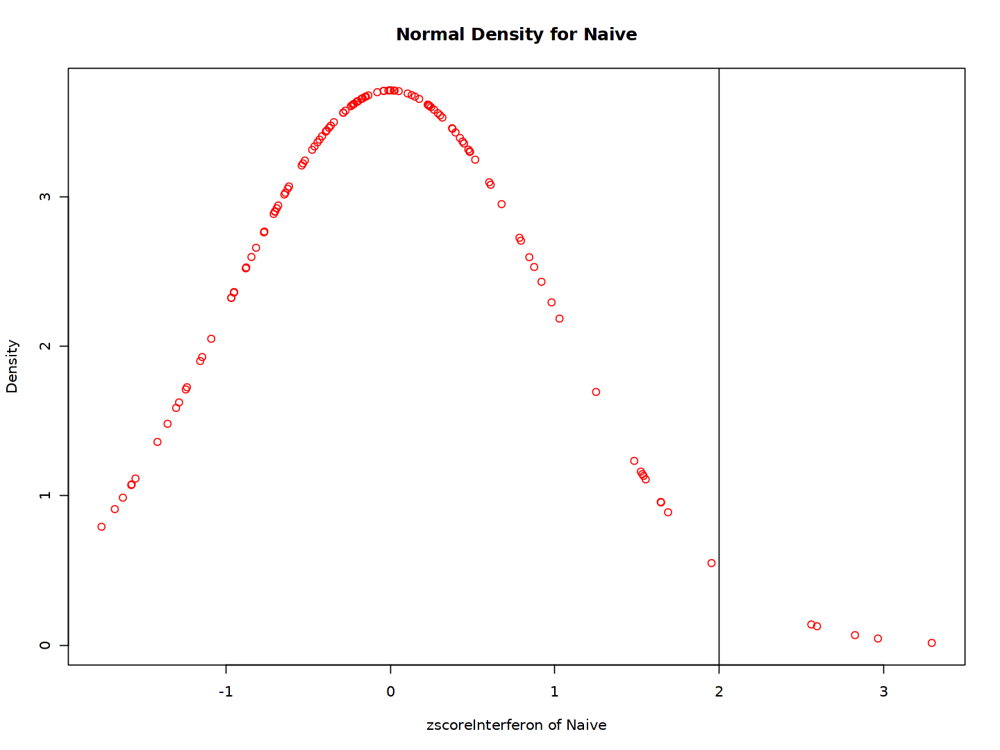

In [233]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,dnorm(tmp_Naive$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

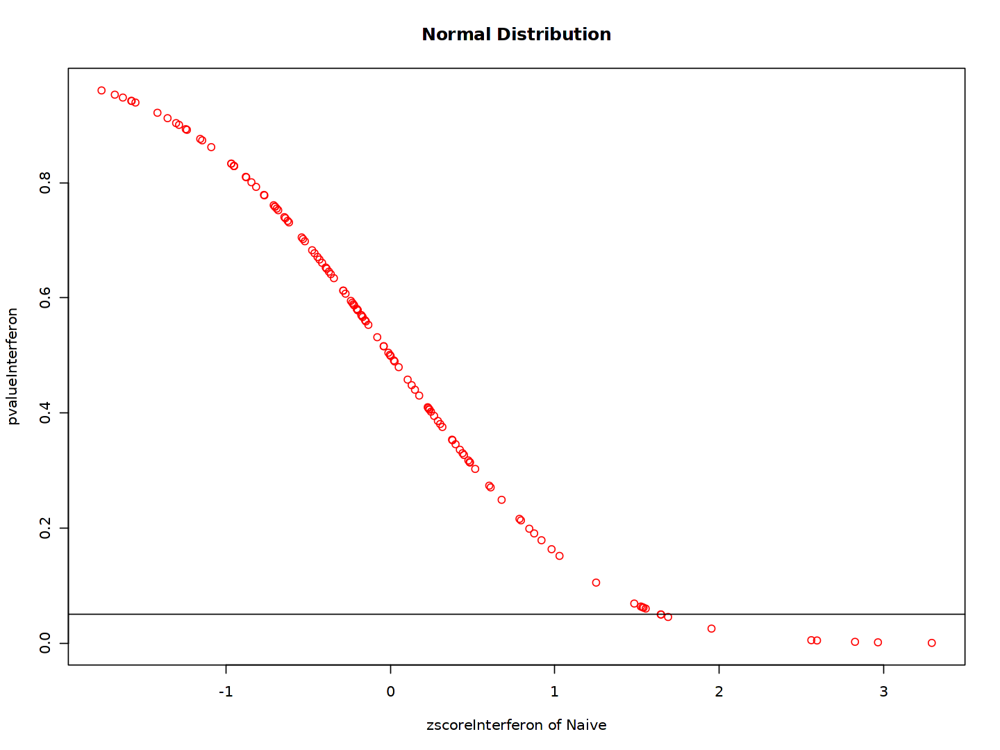

In [234]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,tmp_Naive$pvalueInterferonGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [235]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_NaiveGenePromAcc = (tmp$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [236]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_NaiveGenePromAcc <- pnorm(tmp$zscoreInterferon_NaiveGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

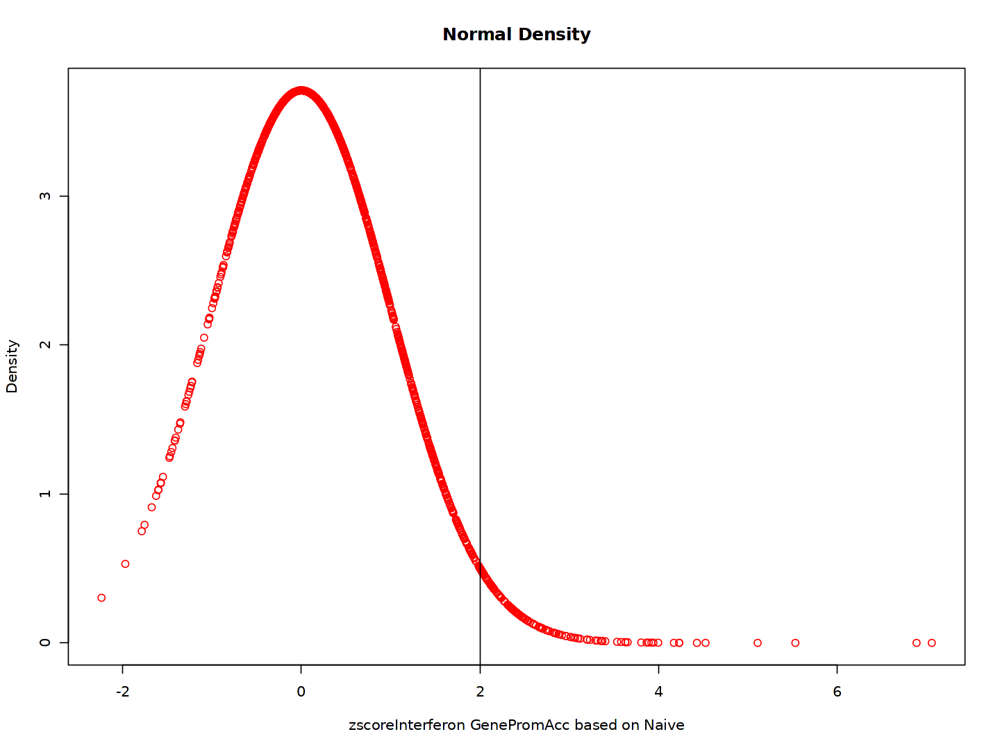

In [237]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="zscoreInterferon GenePromAcc based on Naive", ylab="Density", col = "red")
abline(v=2)

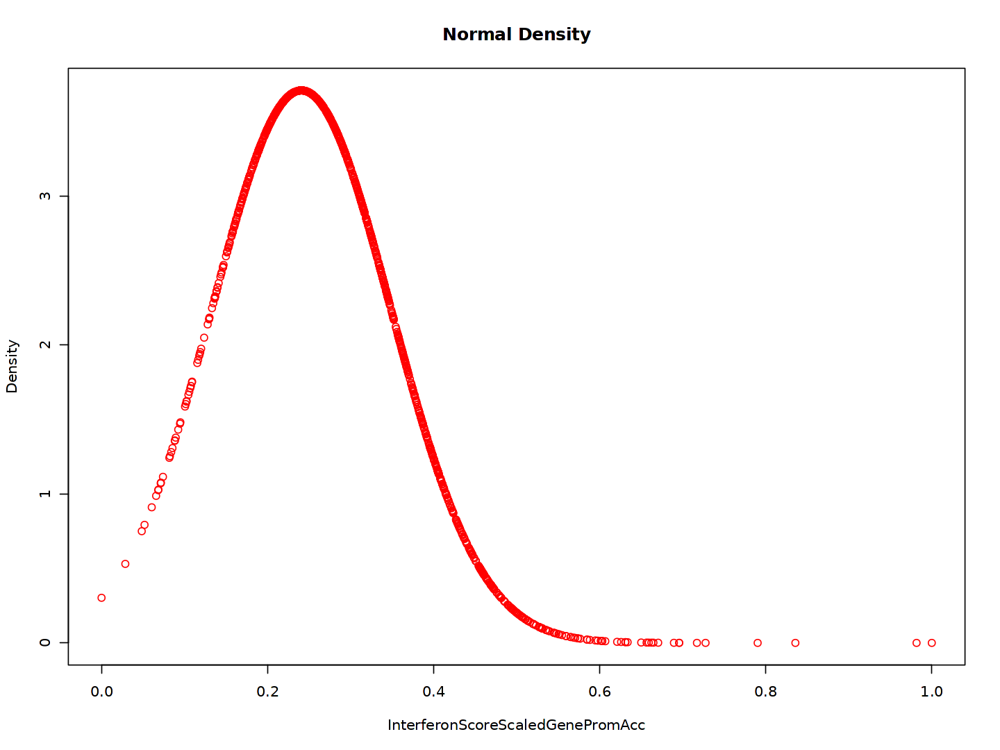

In [238]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="InterferonScoreScaledGenePromAcc", ylab="Density", col = "red")

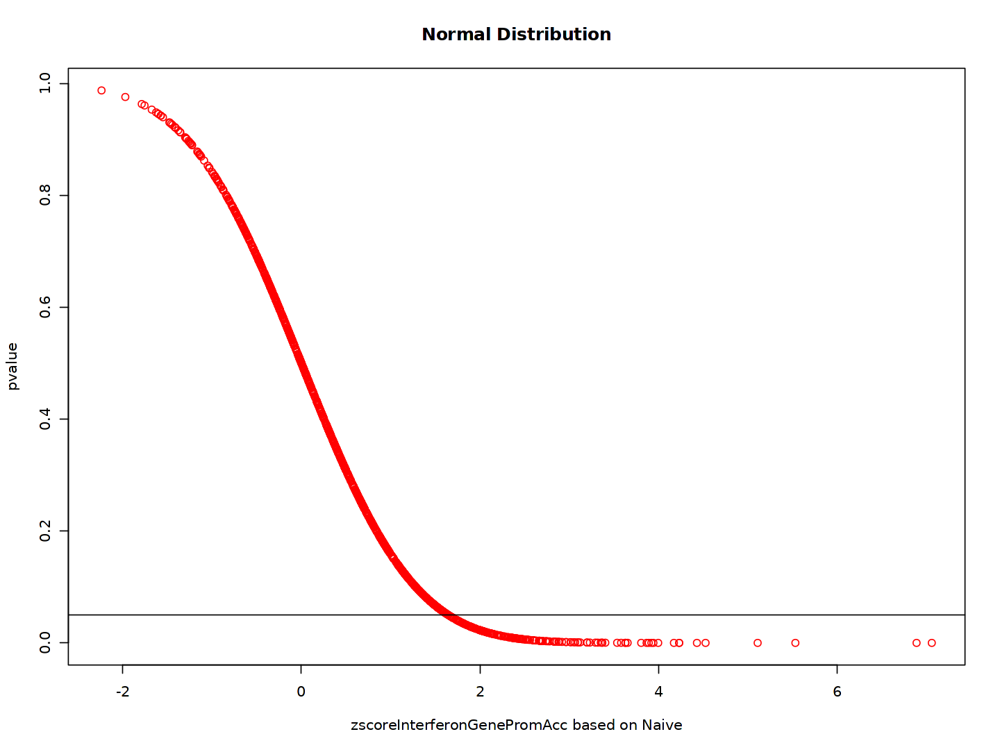

In [239]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferonGenePromAcc based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

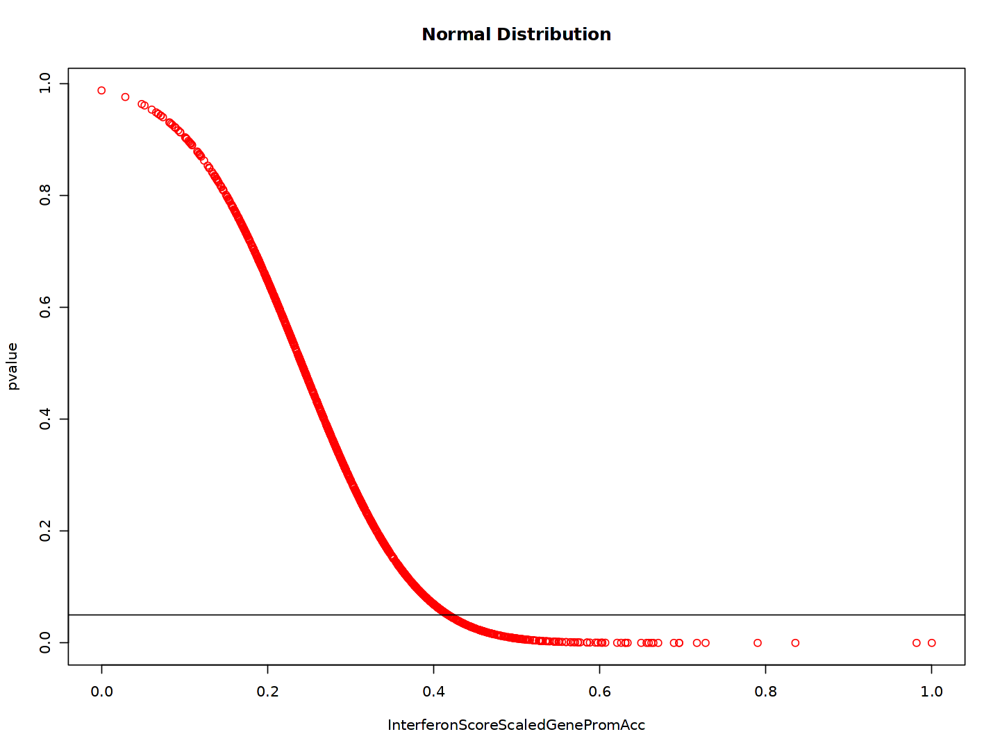

In [240]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="InterferonScoreScaledGenePromAcc", ylab="pvalue", col = "red")
abline(h=0.05)

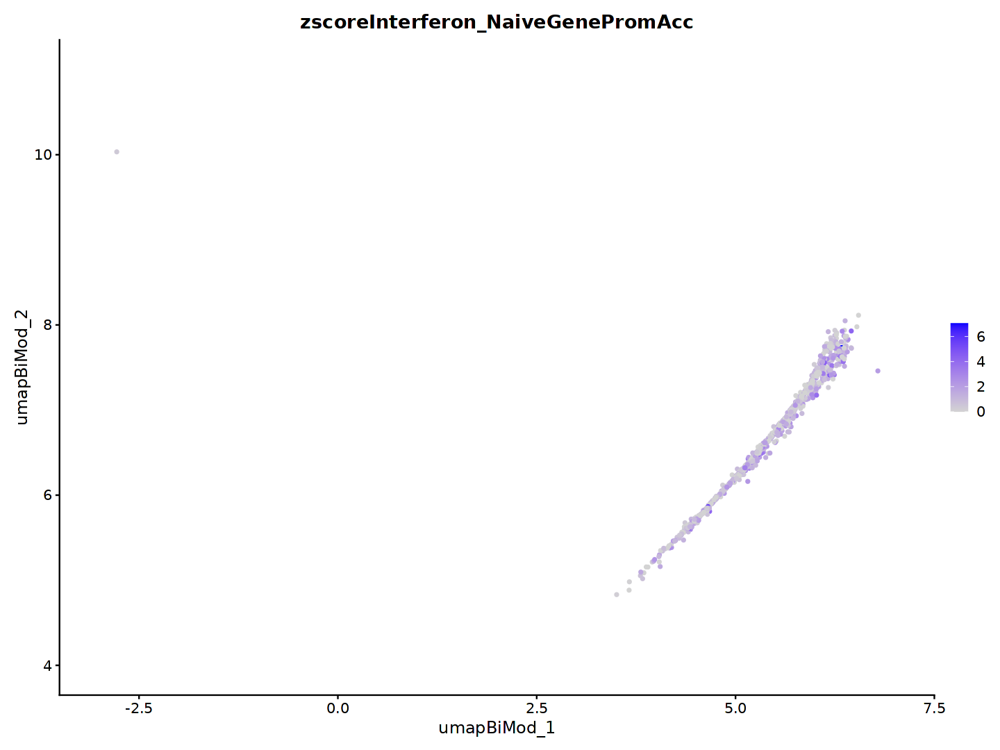

In [241]:
FeaturePlot(tmp, features="zscoreInterferon_NaiveGenePromAcc", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

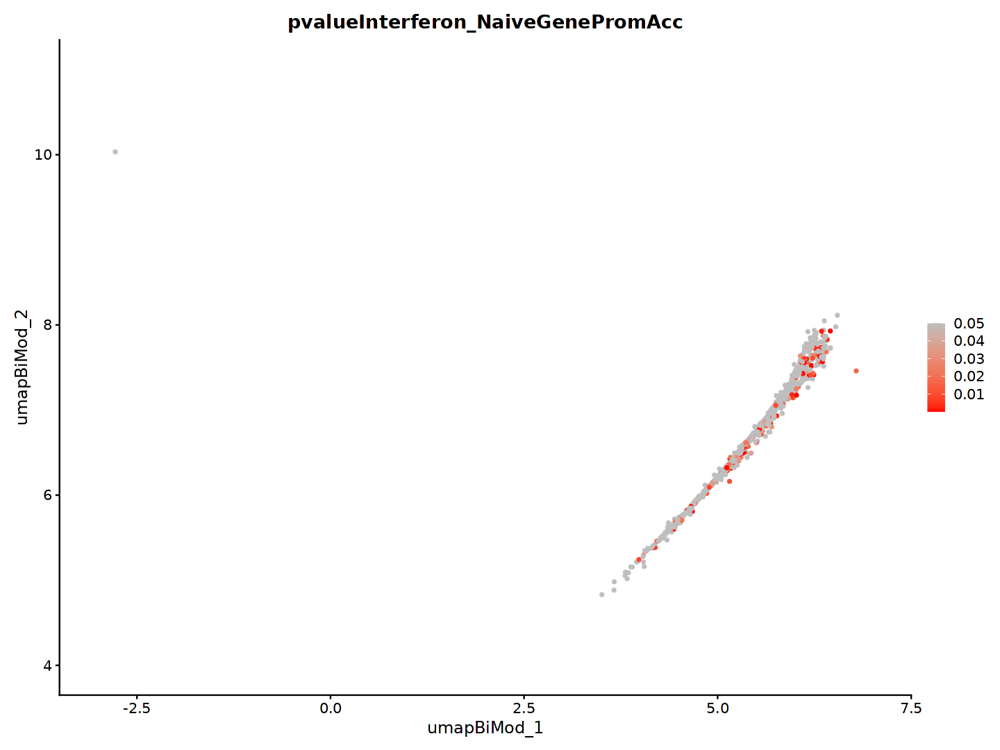

In [242]:
FeaturePlot(tmp, features="pvalueInterferon_NaiveGenePromAcc", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [243]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreGenePromAcc"] <- tmp$InterferonScoreGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaledGenePromAcc"] <-tmp$InterferonScoreScaledGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_NaiveGenePromAcc"] <-tmp$zscoreInterferon_NaiveGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_NaiveGenePromAcc"] <-tmp$pvalueInterferon_NaiveGenePromAcc

##### 3.2.1.4 Micro

In [244]:
tmp <- subset(MORNAATACC, subset = cellType == "Micro")

In [245]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [246]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  676   297   386  1325   839 

In [247]:
tmp$InterferonScoreGenePromAcc <- NULL
tmp$InterferonScoreScaledGenePromAcc <- NULL
tmp$zscoreInterferon_NaiveGenePromAcc <- NULL
tmp$pvalueInterferon_NaiveGenePromAcc <- NULL
tmp$InterferonGenePromAcc <- NULL

In [248]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [249]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScoreGenePromAcc")

In [250]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaledGenePromAcc <- (tmp$InterferonScoreGenePromAcc - min(tmp$InterferonScoreGenePromAcc)) / (max(tmp$InterferonScoreGenePromAcc) - min(tmp$InterferonScoreGenePromAcc))

Picking joint bandwidth of 0.0243



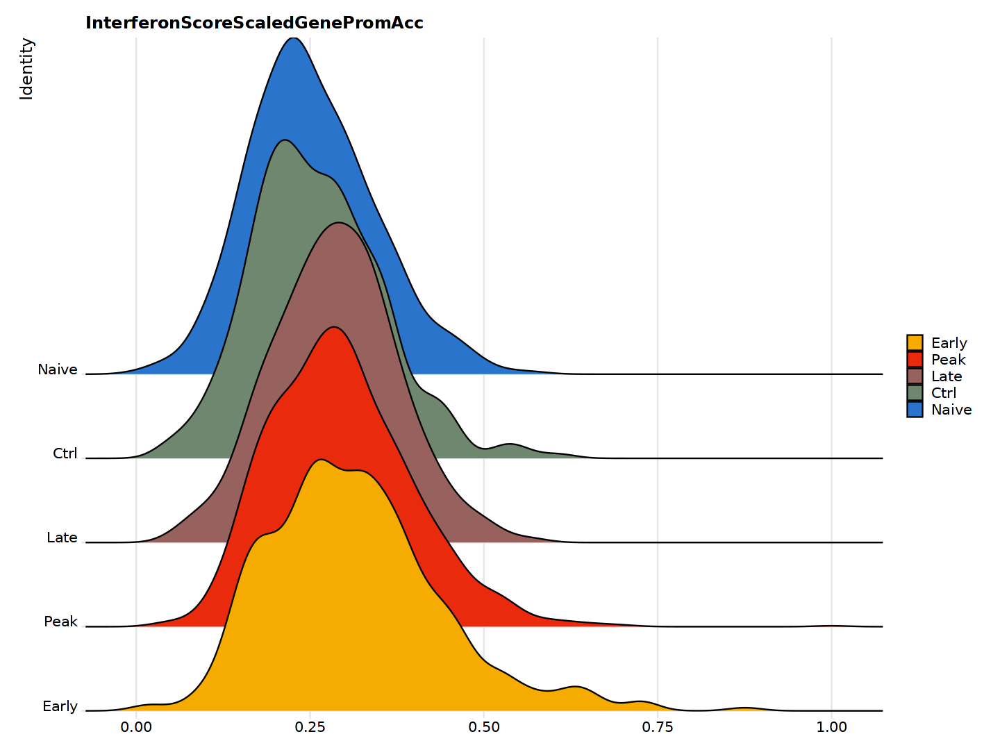

In [251]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaledGenePromAcc', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [252]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [253]:
#Calculating mean and standard deviation for Naive population
meanInterferon_NaiveGenePromAcc <- mean(tmp_Naive$InterferonScoreScaledGenePromAcc)
sdInterferon_NaiveGenePromAcc <- sd(tmp_Naive$InterferonScoreScaledGenePromAcc)

In [254]:
#Calculate zscore
tmp_Naive$zscoreInterferonGenePromAcc <- (tmp_Naive$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [255]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferonGenePromAcc <- pnorm(tmp_Naive$zscoreInterferonGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

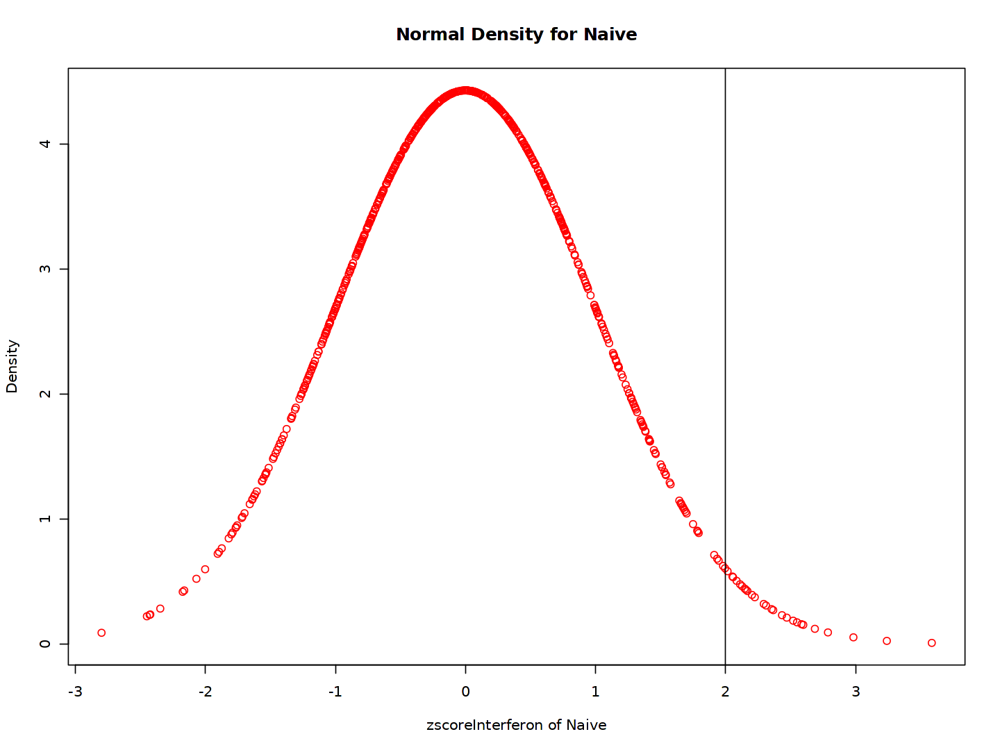

In [256]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,dnorm(tmp_Naive$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

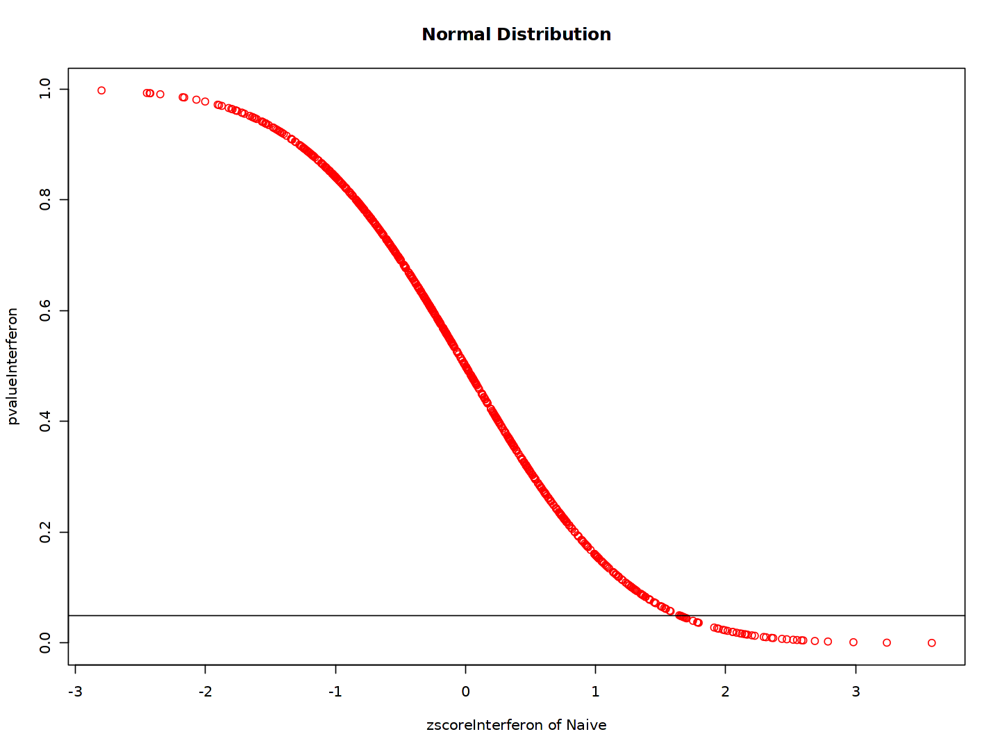

In [257]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,tmp_Naive$pvalueInterferonGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [258]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_NaiveGenePromAcc = (tmp$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [259]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_NaiveGenePromAcc <- pnorm(tmp$zscoreInterferon_NaiveGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

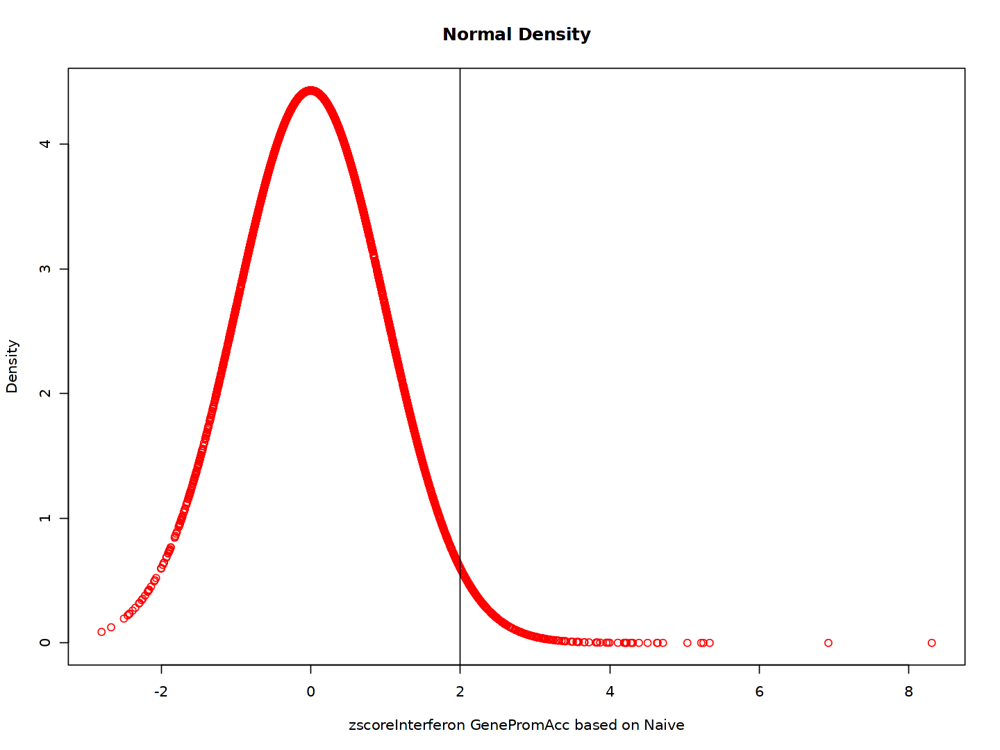

In [260]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="zscoreInterferon GenePromAcc based on Naive", ylab="Density", col = "red")
abline(v=2)

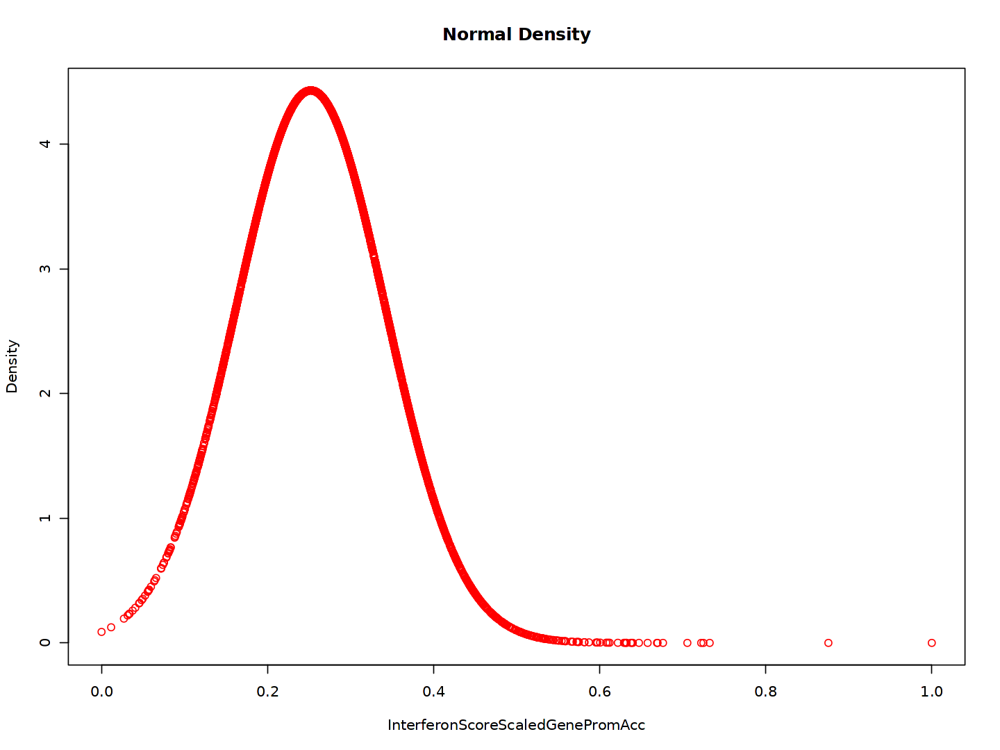

In [261]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="InterferonScoreScaledGenePromAcc", ylab="Density", col = "red")

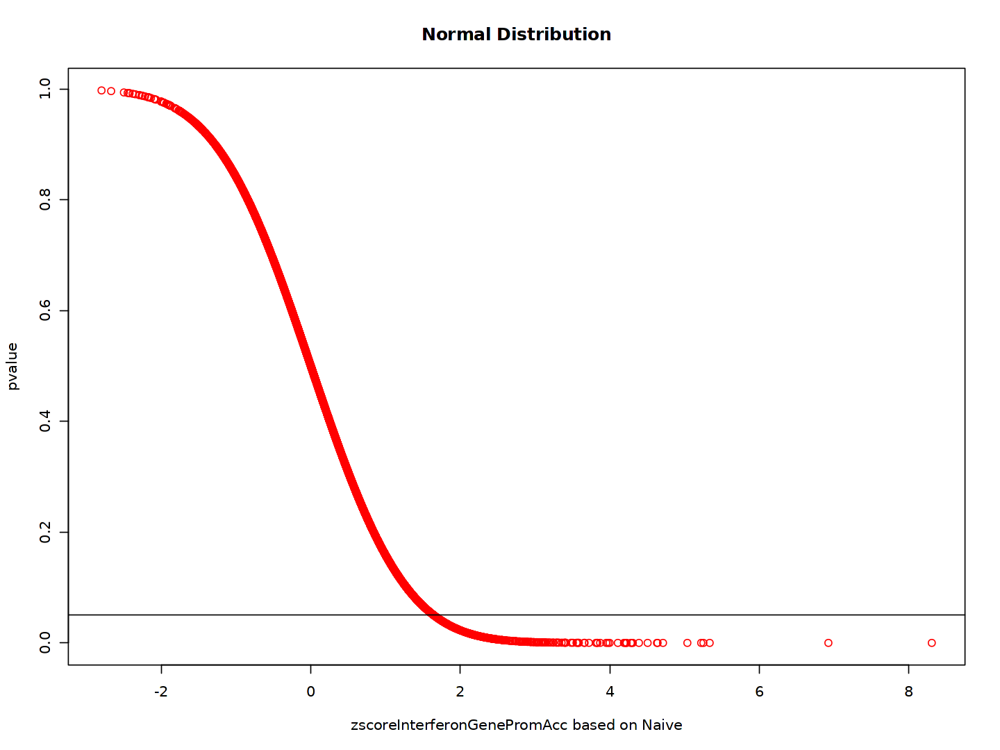

In [262]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferonGenePromAcc based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

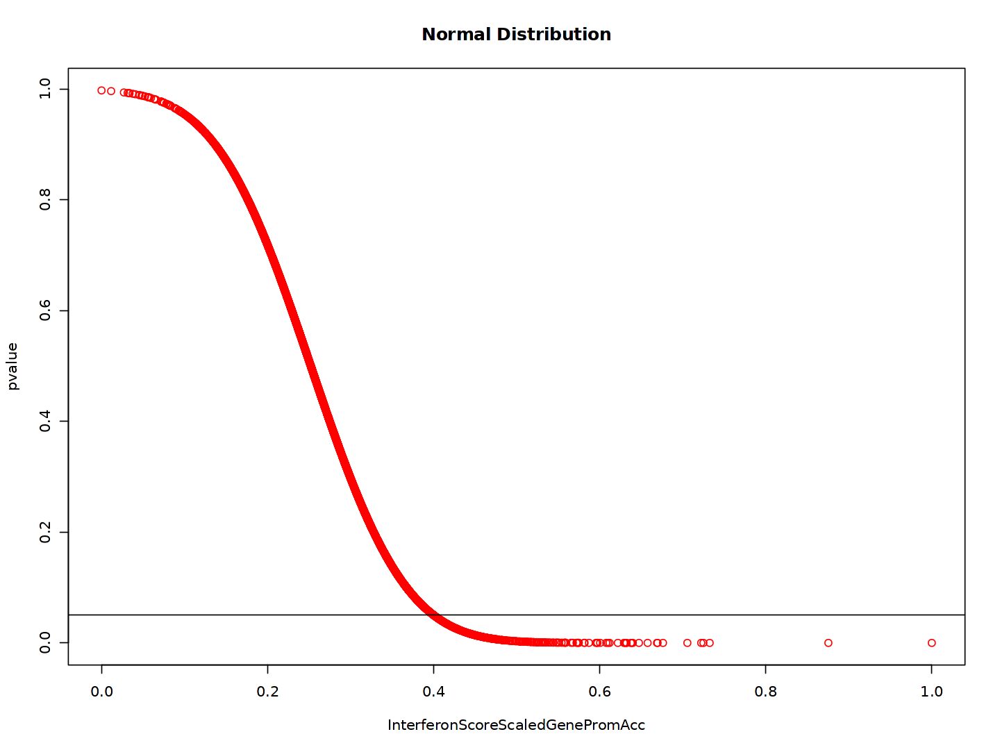

In [263]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="InterferonScoreScaledGenePromAcc", ylab="pvalue", col = "red")
abline(h=0.05)

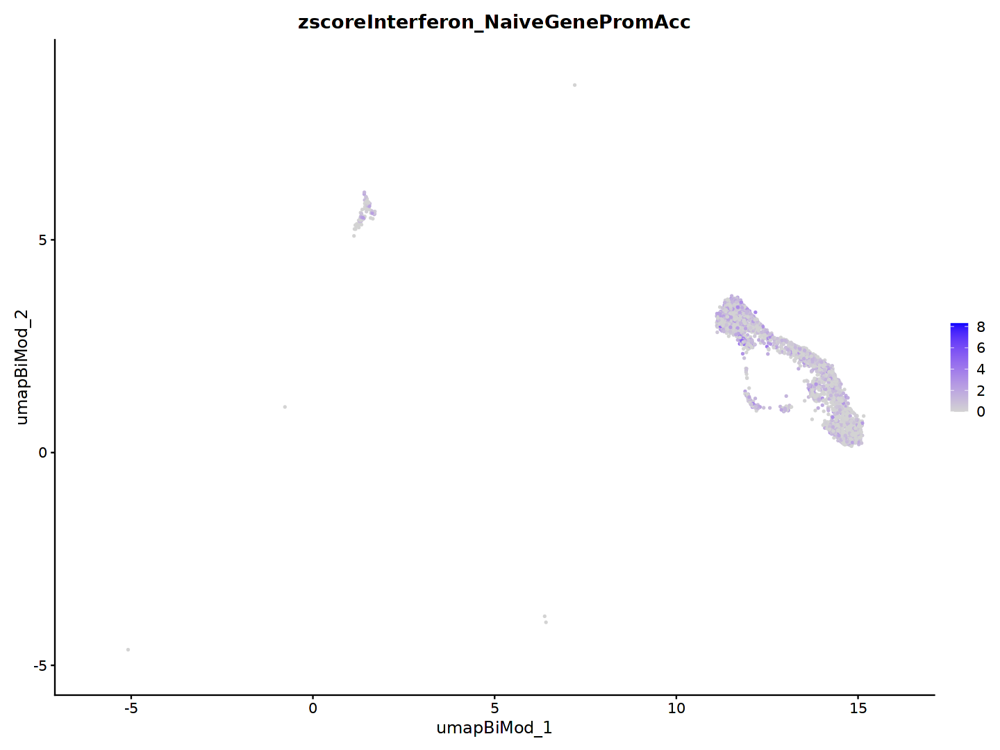

In [264]:
FeaturePlot(tmp, features="zscoreInterferon_NaiveGenePromAcc", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

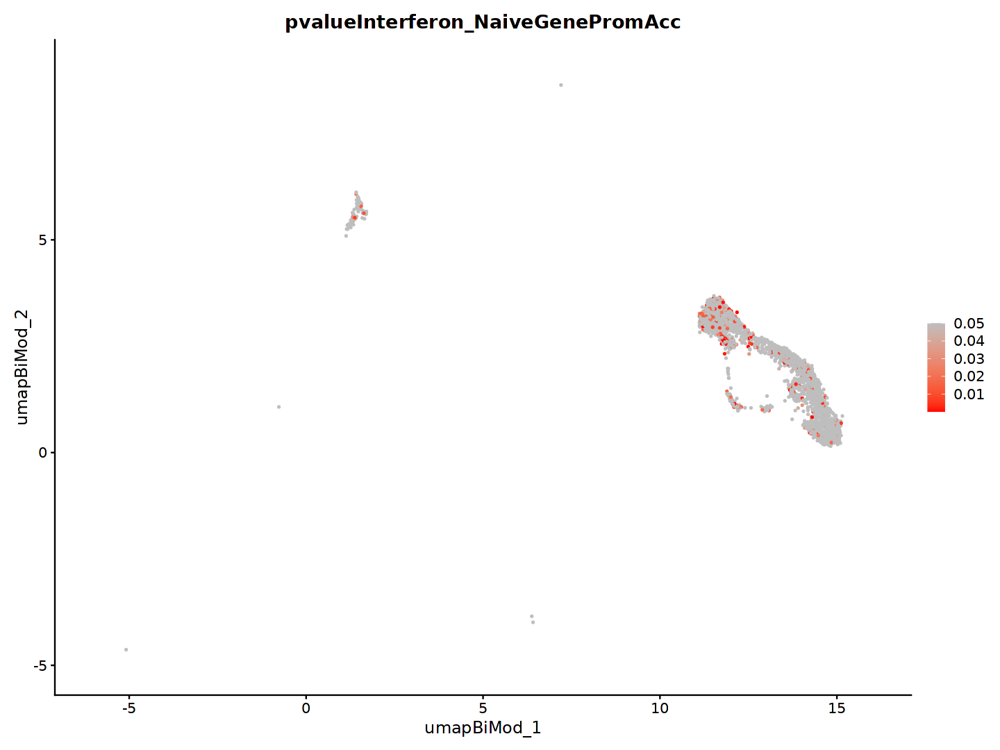

In [265]:
FeaturePlot(tmp, features="pvalueInterferon_NaiveGenePromAcc", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [266]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreGenePromAcc"] <- tmp$InterferonScoreGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaledGenePromAcc"] <-tmp$InterferonScoreScaledGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_NaiveGenePromAcc"] <-tmp$zscoreInterferon_NaiveGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_NaiveGenePromAcc"] <-tmp$pvalueInterferon_NaiveGenePromAcc

##### 3.2.1.5 Astro

In [267]:
tmp <- subset(MORNAATACC, subset = cellType == "Astro")

In [268]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [269]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
 1385  4703  2976    38    76 

In [270]:
tmp$InterferonScoreGenePromAcc <- NULL
tmp$InterferonScoreScaledGenePromAcc <- NULL
tmp$zscoreInterferon_NaiveGenePromAcc <- NULL
tmp$pvalueInterferon_NaiveGenePromAcc <- NULL
tmp$InterferonGenePromAcc <- NULL

In [271]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [272]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScoreGenePromAcc")

In [273]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaledGenePromAcc <- (tmp$InterferonScoreGenePromAcc - min(tmp$InterferonScoreGenePromAcc)) / (max(tmp$InterferonScoreGenePromAcc) - min(tmp$InterferonScoreGenePromAcc))

Picking joint bandwidth of 0.0286



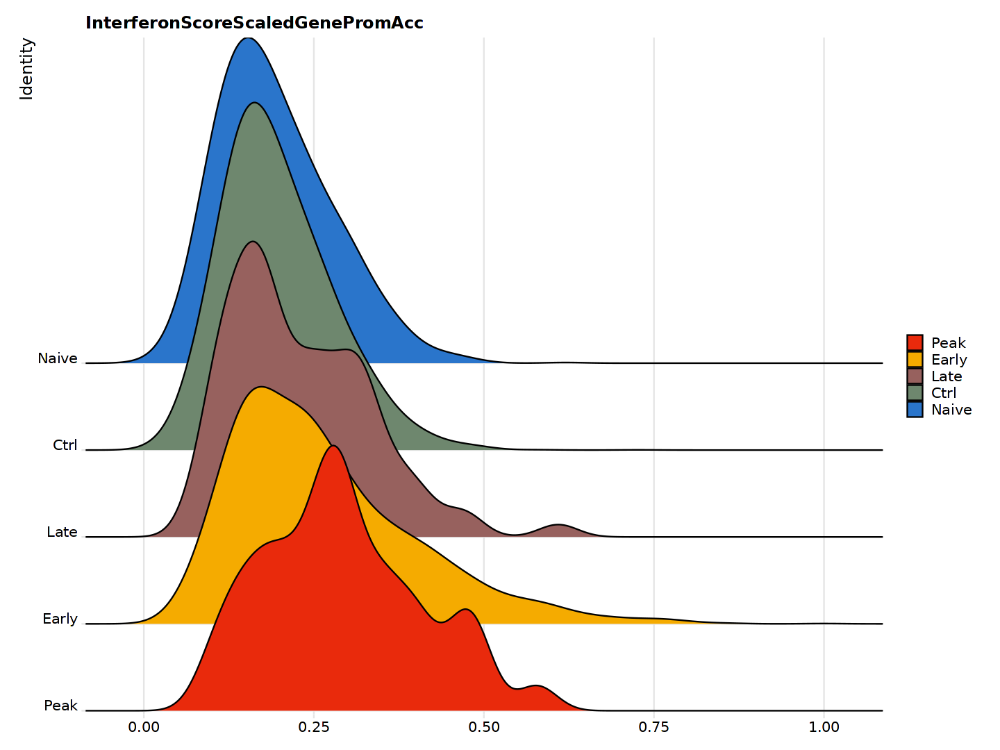

In [274]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaledGenePromAcc', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [275]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [276]:
#Calculating mean and standard deviation for Naive population
meanInterferon_NaiveGenePromAcc <- mean(tmp_Naive$InterferonScoreScaledGenePromAcc)
sdInterferon_NaiveGenePromAcc <- sd(tmp_Naive$InterferonScoreScaledGenePromAcc)

In [277]:
#Calculate zscore
tmp_Naive$zscoreInterferonGenePromAcc <- (tmp_Naive$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [278]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferonGenePromAcc <- pnorm(tmp_Naive$zscoreInterferonGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

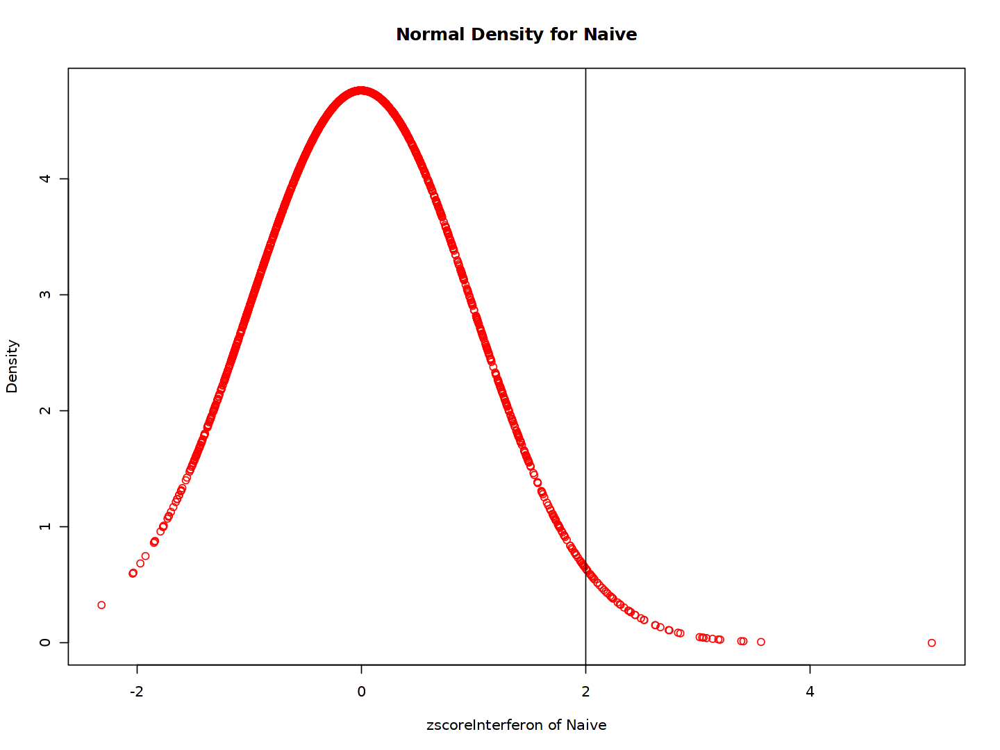

In [279]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,dnorm(tmp_Naive$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

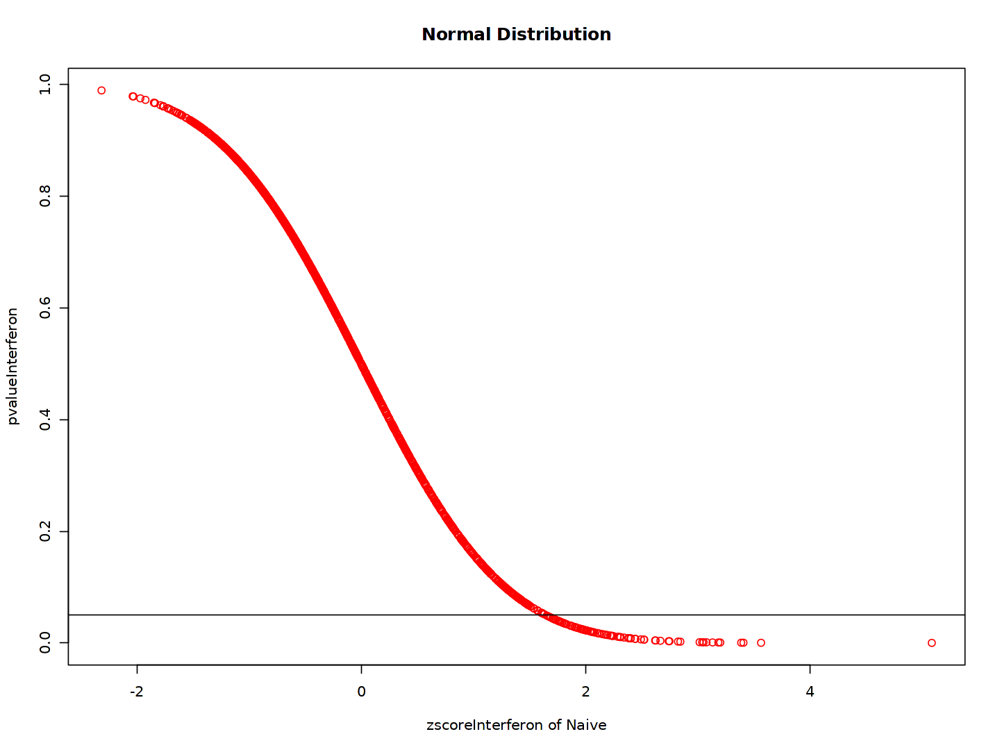

In [280]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,tmp_Naive$pvalueInterferonGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [281]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_NaiveGenePromAcc = (tmp$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [282]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_NaiveGenePromAcc <- pnorm(tmp$zscoreInterferon_NaiveGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

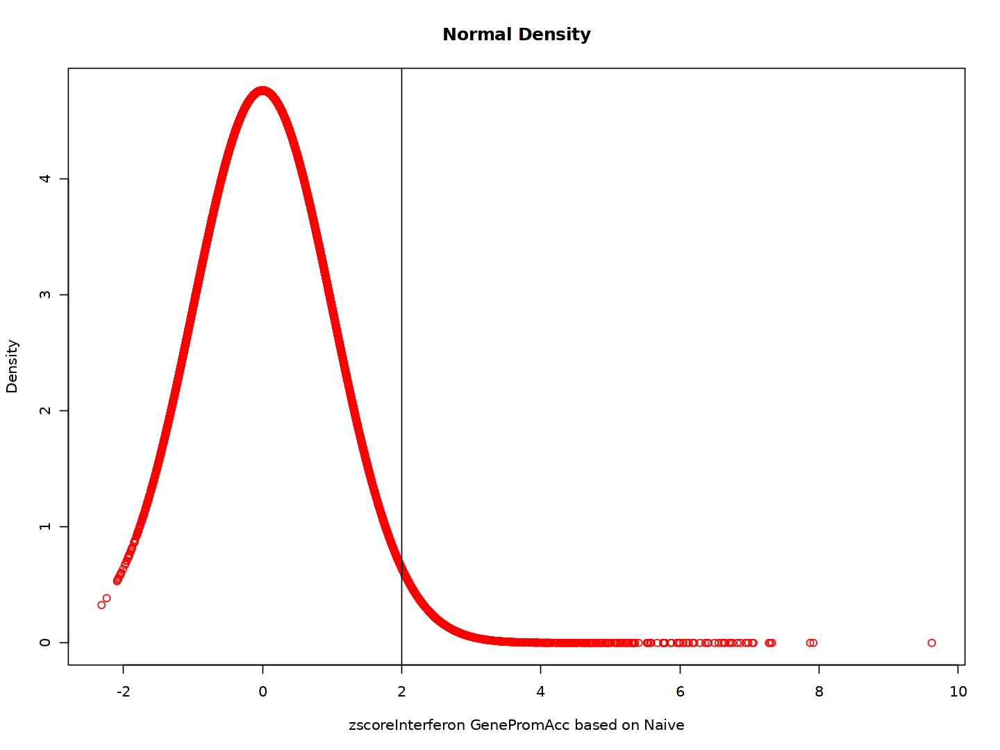

In [283]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="zscoreInterferon GenePromAcc based on Naive", ylab="Density", col = "red")
abline(v=2)

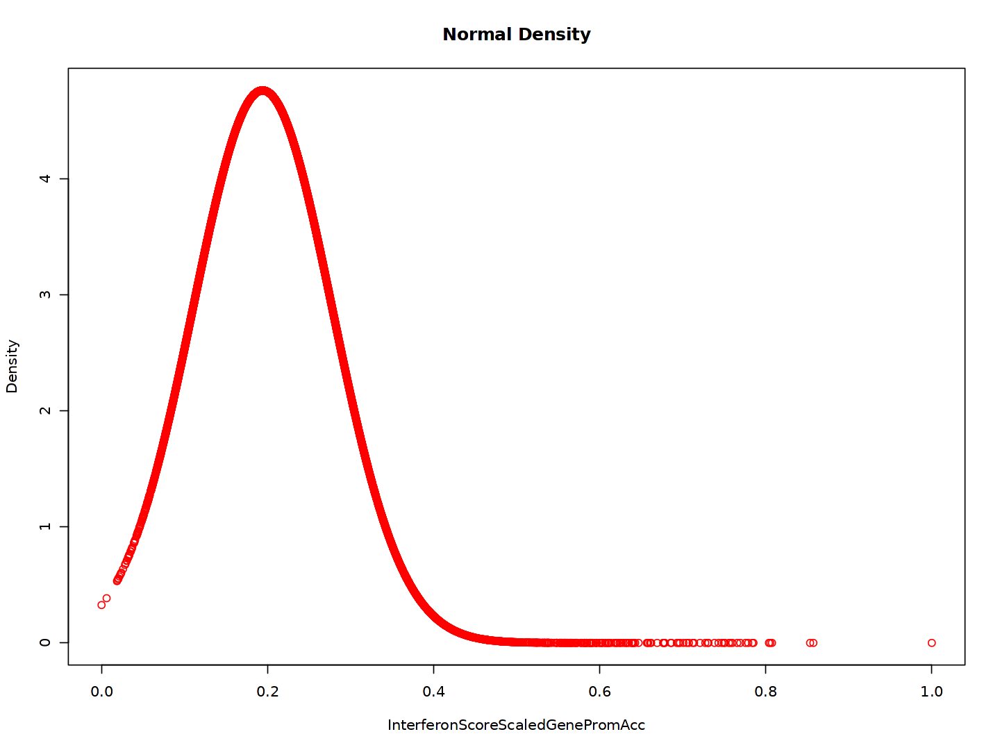

In [284]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="InterferonScoreScaledGenePromAcc", ylab="Density", col = "red")

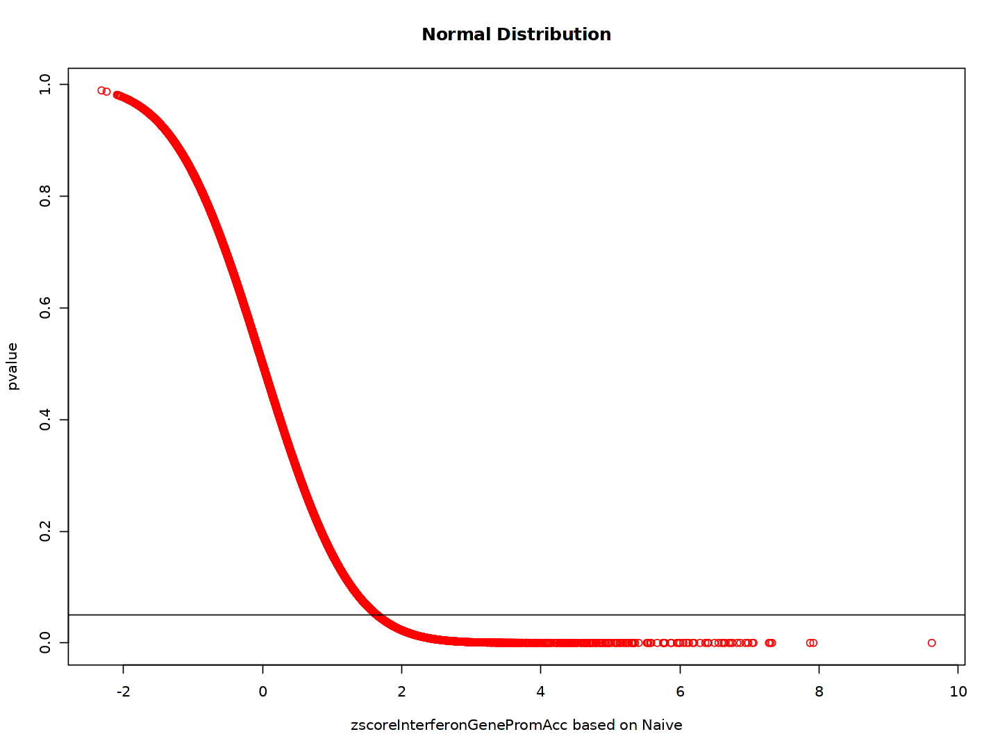

In [285]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferonGenePromAcc based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

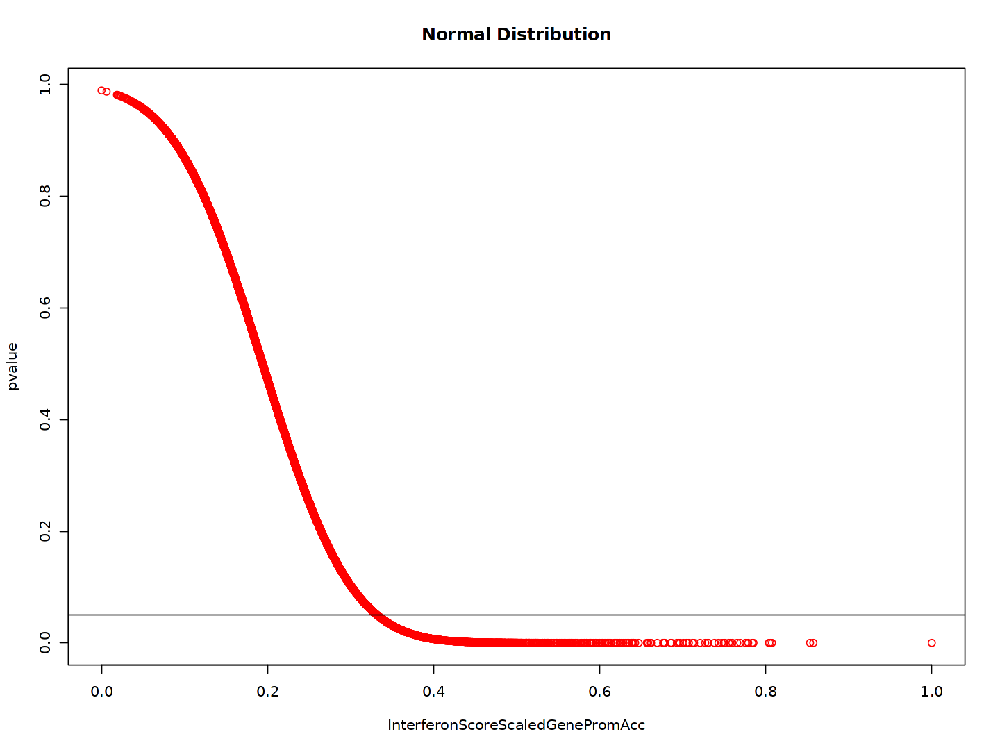

In [286]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="InterferonScoreScaledGenePromAcc", ylab="pvalue", col = "red")
abline(h=0.05)

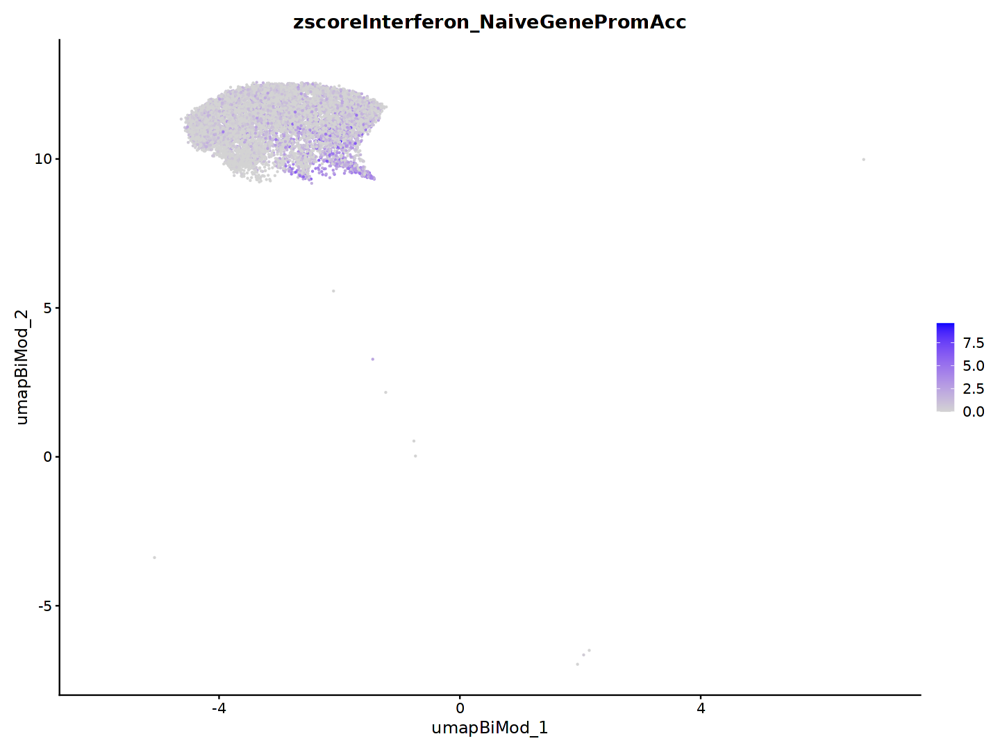

In [287]:
FeaturePlot(tmp, features="zscoreInterferon_NaiveGenePromAcc", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

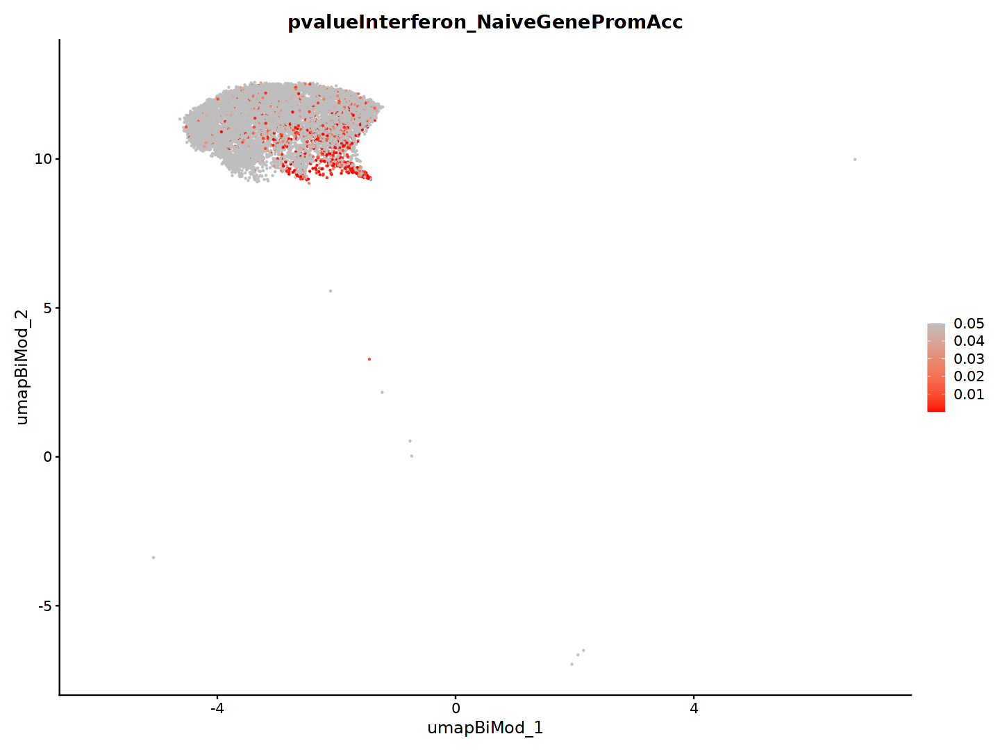

In [288]:
FeaturePlot(tmp, features="pvalueInterferon_NaiveGenePromAcc", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [289]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreGenePromAcc"] <- tmp$InterferonScoreGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaledGenePromAcc"] <-tmp$InterferonScoreScaledGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_NaiveGenePromAcc"] <-tmp$zscoreInterferon_NaiveGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_NaiveGenePromAcc"] <-tmp$pvalueInterferon_NaiveGenePromAcc

##### 3.2.1.6 Ependymal cells

In [290]:
tmp <- subset(MORNAATACC, subset = cellType == "Epen")

In [291]:
tmp$orig.ident_merge <- factor(tmp$orig.ident_merge, levels=names(orig.ident_merge_colors))

In [292]:
table(tmp$orig.ident_merge)


Naive  Ctrl Early  Peak  Late 
  256   600   261   188   132 

In [293]:
tmp$InterferonScoreGenePromAcc <- NULL
tmp$InterferonScoreScaledGenePromAcc <- NULL
tmp$zscoreInterferon_NaiveGenePromAcc <- NULL
tmp$pvalueInterferon_NaiveGenePromAcc <- NULL
tmp$InterferonGenePromAcc <- NULL

In [294]:
tmp <- AddModuleScore(
  object = tmp,
  features = list(list_interferon),
  ctrl = 100,
  name = 'InterferonScore'
)

In [295]:
colnames(tmp@meta.data) <- c(colnames(tmp@meta.data)[1:length(colnames(tmp@meta.data))-1], "InterferonScoreGenePromAcc")

In [296]:
#Scaling to get values between 0 to 1
tmp$InterferonScoreScaledGenePromAcc <- (tmp$InterferonScoreGenePromAcc - min(tmp$InterferonScoreGenePromAcc)) / (max(tmp$InterferonScoreGenePromAcc) - min(tmp$InterferonScoreGenePromAcc))

Picking joint bandwidth of 0.04



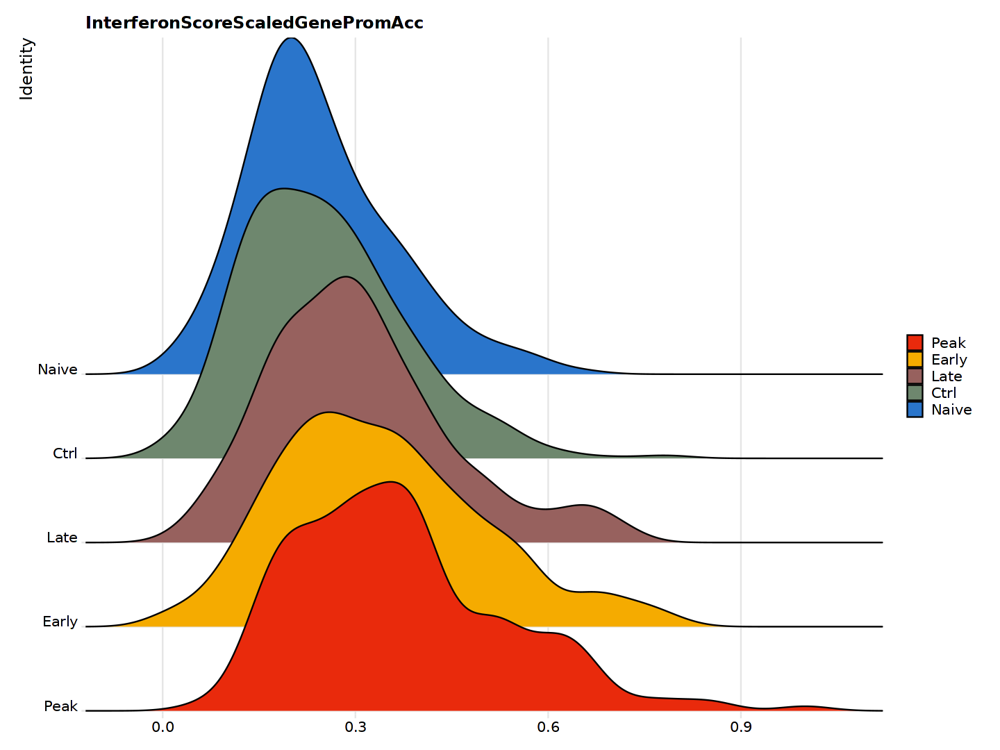

In [297]:
options(repr.plot.width=12, repr.plot.height=9)
RidgePlot(tmp, features='InterferonScoreScaledGenePromAcc', cols = orig.ident_merge_colors, sort = TRUE, group.by = 'orig.ident_merge')

https://news.mit.edu/2012/explained-sigma-0209#:~:text=One%20standard%20deviation%2C%20or%20one,sigmas%20would%20include%2099.7%20percent

https://en.wikipedia.org/wiki/68%E2%80%9395%E2%80%9399.7_rule

In [298]:
tmp_Naive <- subset(tmp, subset = orig.ident_merge == 'Naive')

Question : Is each value from timepoint other than Naive different from the mean of the Naive InterferonScore distribution ?

Null hyphotesis : The specific InterferonScore equals the mean of the Naive InterferonScore distribution

Alternative hypothesis : The specific mean value differs from the Naive InterferonScore distribution.

We can reject the null hypothesis of our hypothesis test if this p-value is less than a critical level of significance.

In [299]:
#Calculating mean and standard deviation for Naive population
meanInterferon_NaiveGenePromAcc <- mean(tmp_Naive$InterferonScoreScaledGenePromAcc)
sdInterferon_NaiveGenePromAcc <- sd(tmp_Naive$InterferonScoreScaledGenePromAcc)

In [300]:
#Calculate zscore
tmp_Naive$zscoreInterferonGenePromAcc <- (tmp_Naive$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [301]:
#Calculate pvalue
#As we are only interested in the lower tail the pnorm output, which are cumulative distribution value, equals the pvalue
tmp_Naive$pvalueInterferonGenePromAcc <- pnorm(tmp_Naive$zscoreInterferonGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

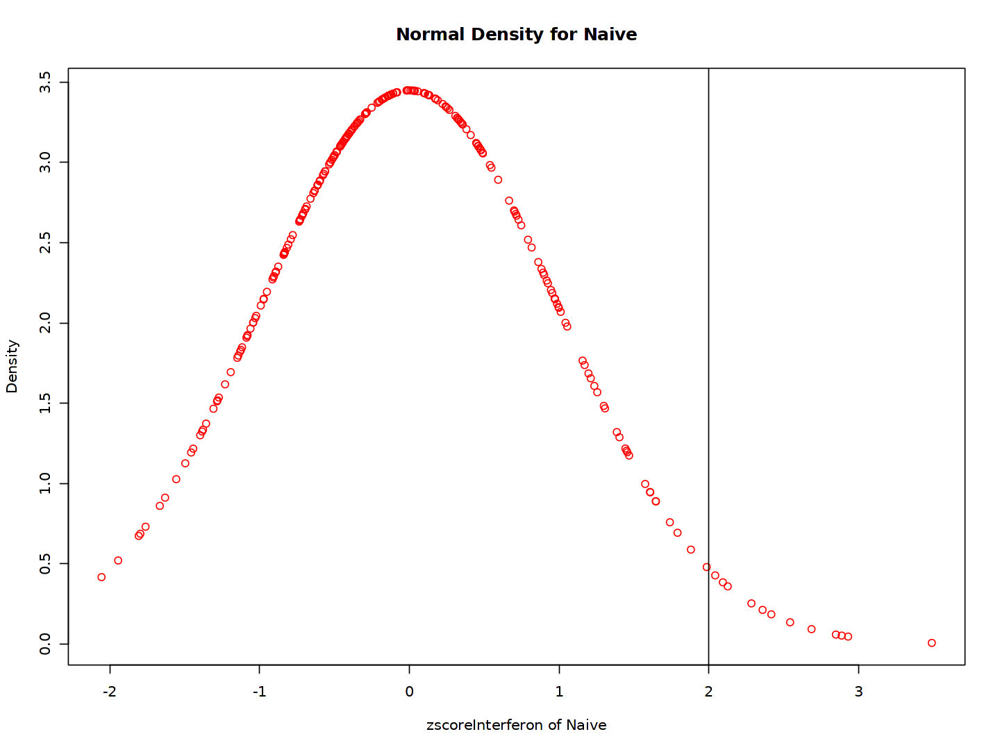

In [302]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,dnorm(tmp_Naive$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density for Naive", xlab="zscoreInterferon of Naive", ylab="Density", col = "red")
abline(v=2)

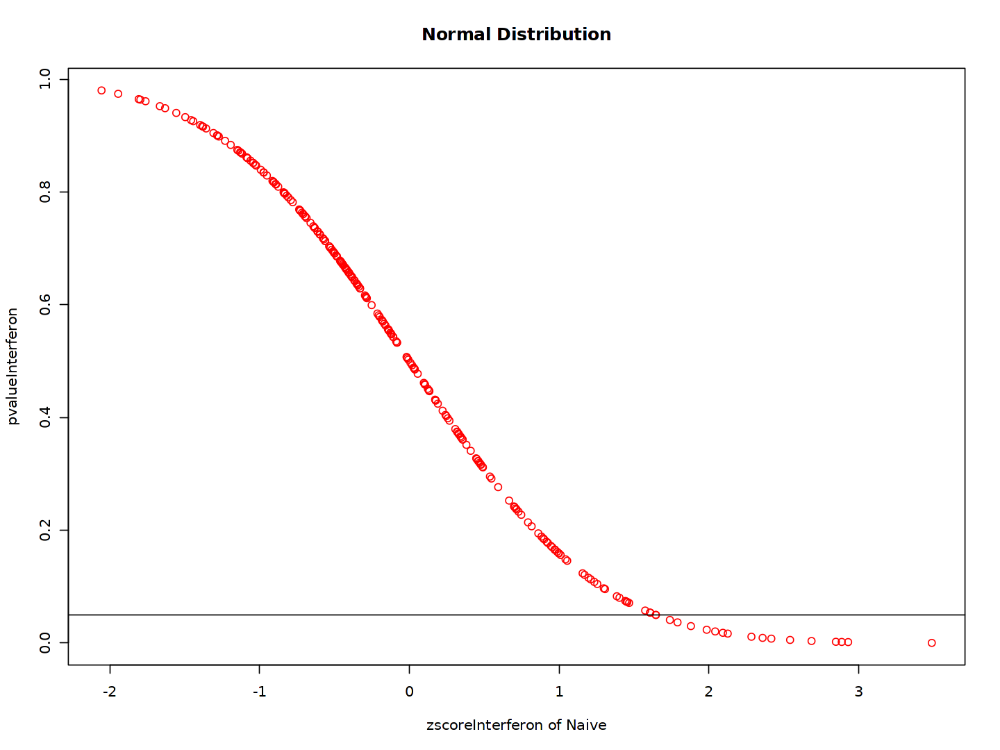

In [303]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp_Naive$zscoreInterferonGenePromAcc,tmp_Naive$pvalueInterferonGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferon of Naive", ylab="pvalueInterferon", col = "red")
abline(h=0.05)

In [304]:
#Calculate zscore of all cells based on Naive distribution (mean and sd)
tmp$zscoreInterferon_NaiveGenePromAcc = (tmp$InterferonScoreScaledGenePromAcc-meanInterferon_NaiveGenePromAcc)/sdInterferon_NaiveGenePromAcc

In [305]:
#Calculate pvalue of all cells based on Naive distribution
tmp$pvalueInterferon_NaiveGenePromAcc <- pnorm(tmp$zscoreInterferon_NaiveGenePromAcc, mean = 0, sd = 1, lower.tail=FALSE)

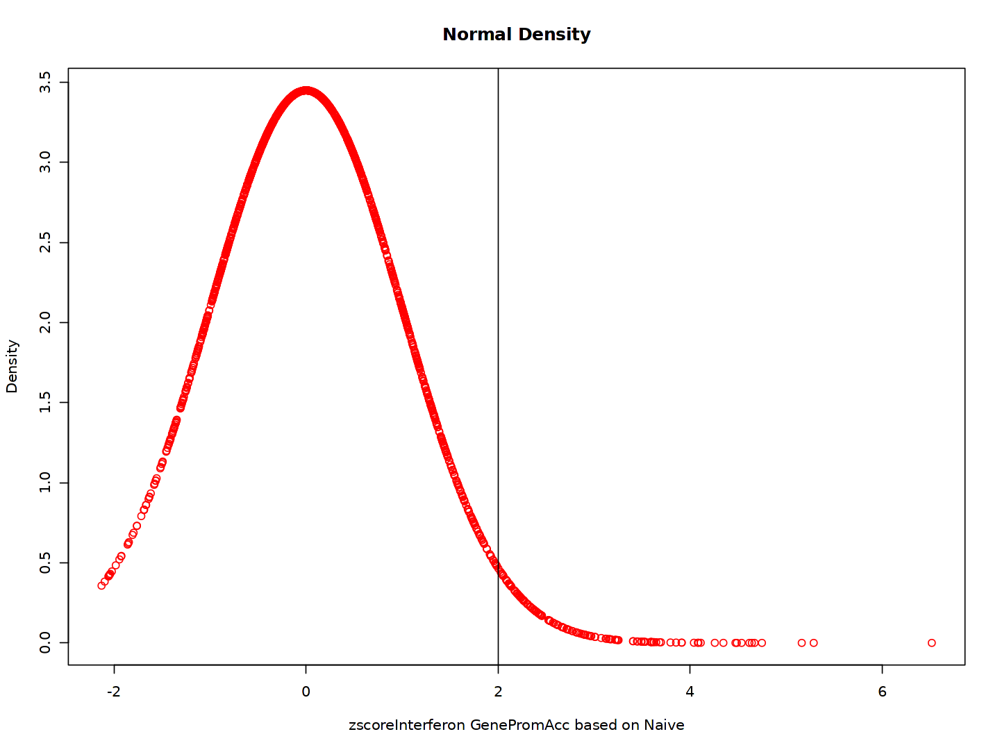

In [306]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="zscoreInterferon GenePromAcc based on Naive", ylab="Density", col = "red")
abline(v=2)

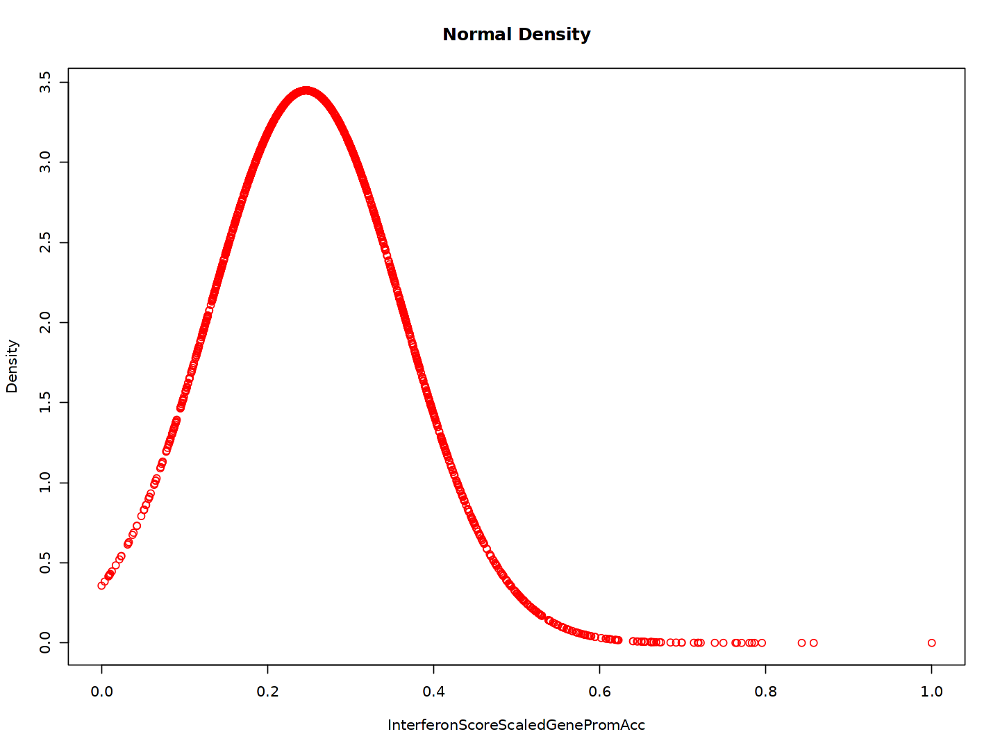

In [307]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,dnorm(tmp$InterferonScoreScaledGenePromAcc, mean = meanInterferon_NaiveGenePromAcc, sd = sdInterferon_NaiveGenePromAcc), main = "Normal Density", xlab="InterferonScoreScaledGenePromAcc", ylab="Density", col = "red")

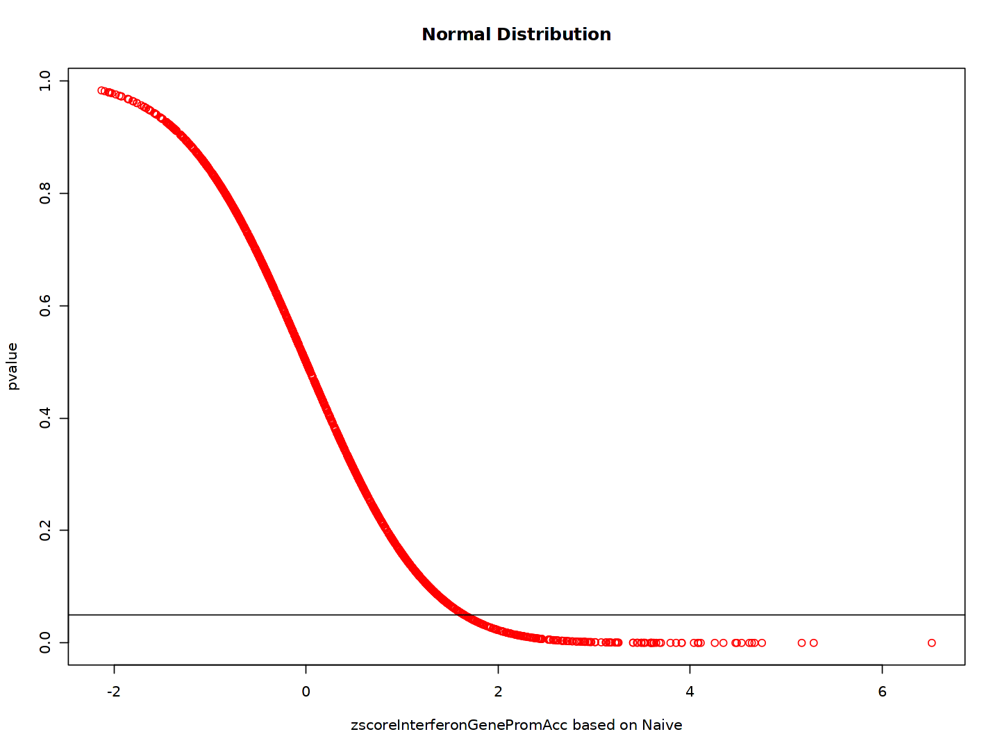

In [308]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$zscoreInterferon_NaiveGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="zscoreInterferonGenePromAcc based on Naive", ylab="pvalue", col = "red")
abline(h=0.05)

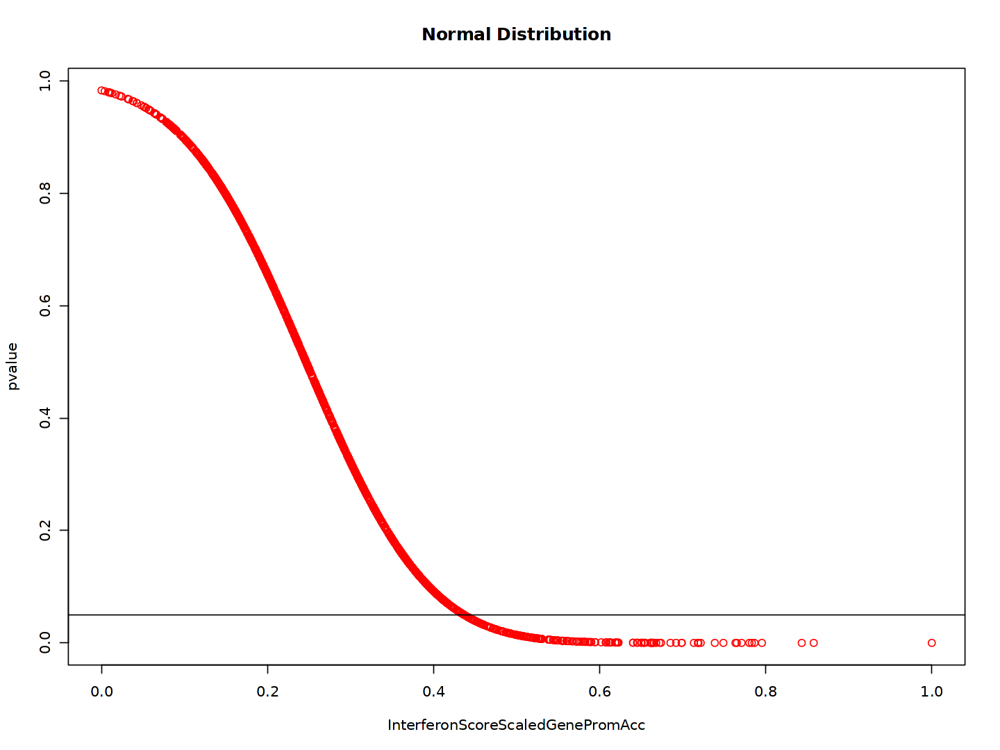

In [309]:
options(repr.plot.width=12, repr.plot.height=9)
plot(tmp$InterferonScoreScaledGenePromAcc,tmp$pvalueInterferon_NaiveGenePromAcc, main = "Normal Distribution", xlab="InterferonScoreScaledGenePromAcc", ylab="pvalue", col = "red")
abline(h=0.05)

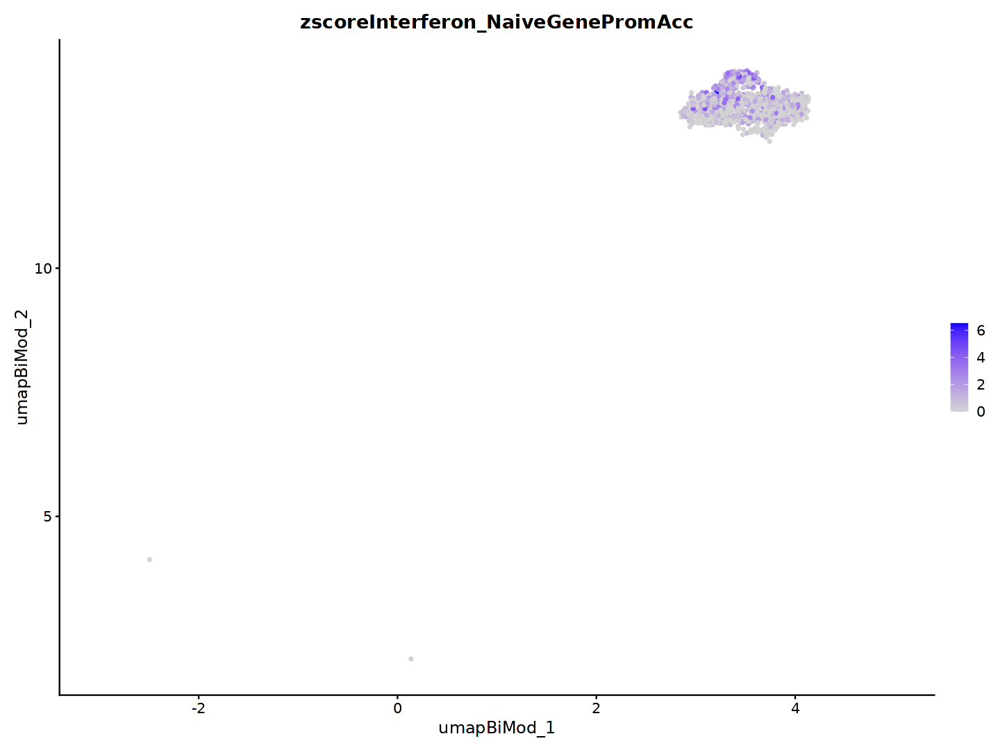

In [310]:
FeaturePlot(tmp, features="zscoreInterferon_NaiveGenePromAcc", reduction="umap_BiMod", min.cutoff=0, raster=FALSE)

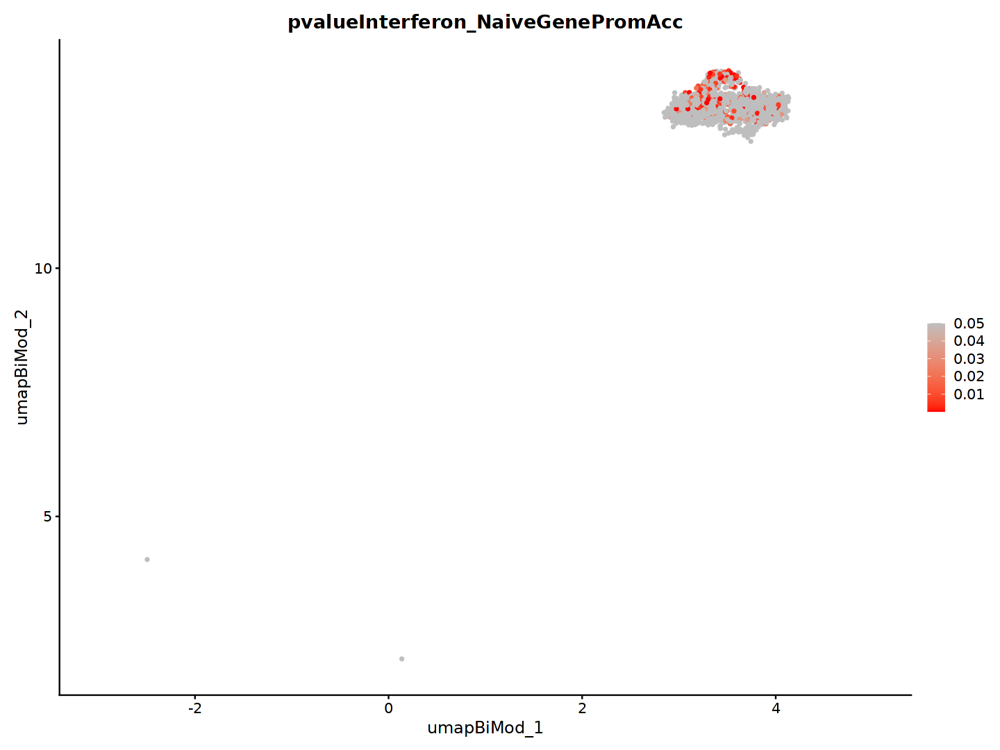

In [311]:
FeaturePlot(tmp, features="pvalueInterferon_NaiveGenePromAcc", reduction="umap_BiMod", cols = c("red", "grey"), max.cutoff=0.05, raster=FALSE)

In [312]:
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreGenePromAcc"] <- tmp$InterferonScoreGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "InterferonScoreScaledGenePromAcc"] <-tmp$InterferonScoreScaledGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "zscoreInterferon_NaiveGenePromAcc"] <-tmp$zscoreInterferon_NaiveGenePromAcc
MORNAATACC@meta.data[colnames(tmp), "pvalueInterferon_NaiveGenePromAcc"] <-tmp$pvalueInterferon_NaiveGenePromAcc

##### 3.2.1.7 Neurons

In [313]:
#Not enough Naïve cells

#### 3.2.2 Annotate Damage cells

In [314]:
for (i in 1:nrow(MORNAATACC@meta.data)){
    if(is.na(MORNAATACC@meta.data[i,"pvalueInterferon_NaiveGenePromAcc"])){
        MORNAATACC@meta.data[i,"InterferonGenePromAcc"] <- "NonInterferon"
    }else{
        if(MORNAATACC@meta.data[i,"pvalueInterferon_NaiveGenePromAcc"] <= 0.05){
            MORNAATACC@meta.data[i,"InterferonGenePromAcc"] <- "Interferon"
        }else{
            MORNAATACC@meta.data[i,"InterferonGenePromAcc"] <- "NonInterferon"
        }
    }
}

In [315]:
MORNAATACC$InterferonGenePromAcc <- factor(x = MORNAATACC$InterferonGenePromAcc, levels = names(interferon_colors))

#### 3.2.3 Visualizing the scores

In [316]:
ctrl <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Ctrl",]
early <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Early",]
peak <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Peak",]
late <- MORNAATACC@meta.data[MORNAATACC$orig.ident_merge == "Late",]

In [317]:
df <- data.frame(
   InterferonScoreScaledGenePromAcc = c(ctrl$InterferonScoreScaledGenePromAcc, early$InterferonScoreScaledGenePromAcc, peak$InterferonScoreScaledGenePromAcc, late$InterferonScoreScaledGenePromAcc), 
   timepoint = c(rep("Ctrl", length(ctrl$InterferonScoreScaledGenePromAcc)), rep("Early", length(early$InterferonScoreScaledGenePromAcc)), rep("Peak", length(peak$InterferonScoreScaledGenePromAcc)), rep("Late", length(late$InterferonScoreScaledGenePromAcc)))
)

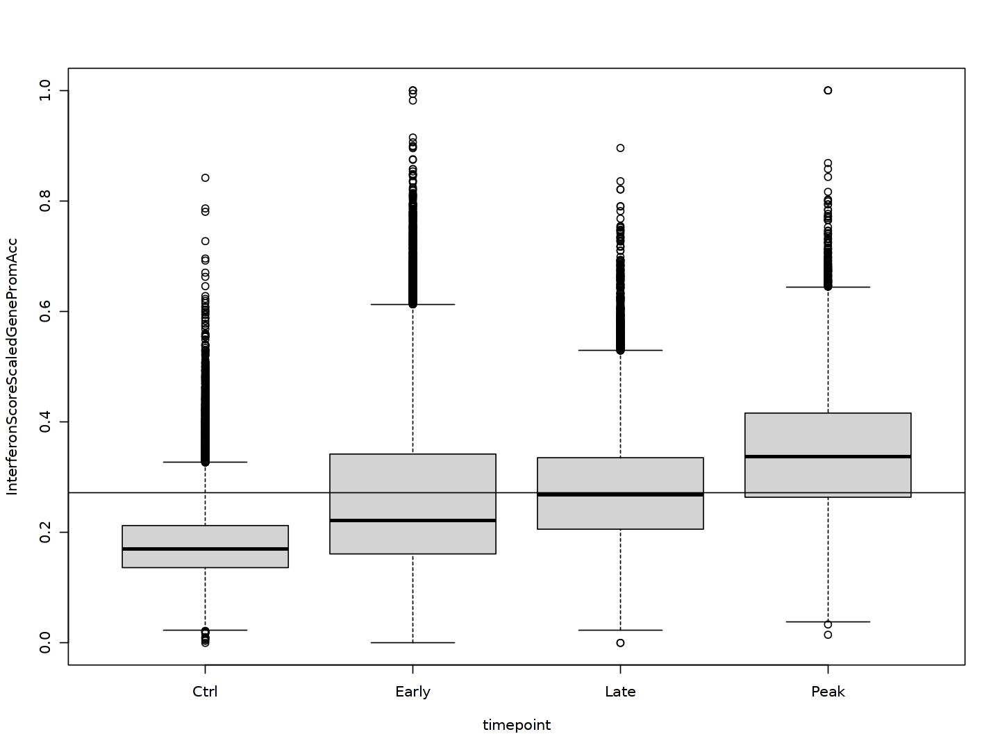

In [318]:
options(repr.plot.width=12, repr.plot.height=9)
boxplot(InterferonScoreScaledGenePromAcc ~ timepoint, data = df, ylim=c(0,1))
abline(h=min(MORNAATACC$InterferonScoreScaledGenePromAcc[MORNAATACC$InterferonGenePromAcc == "Interferon"]))

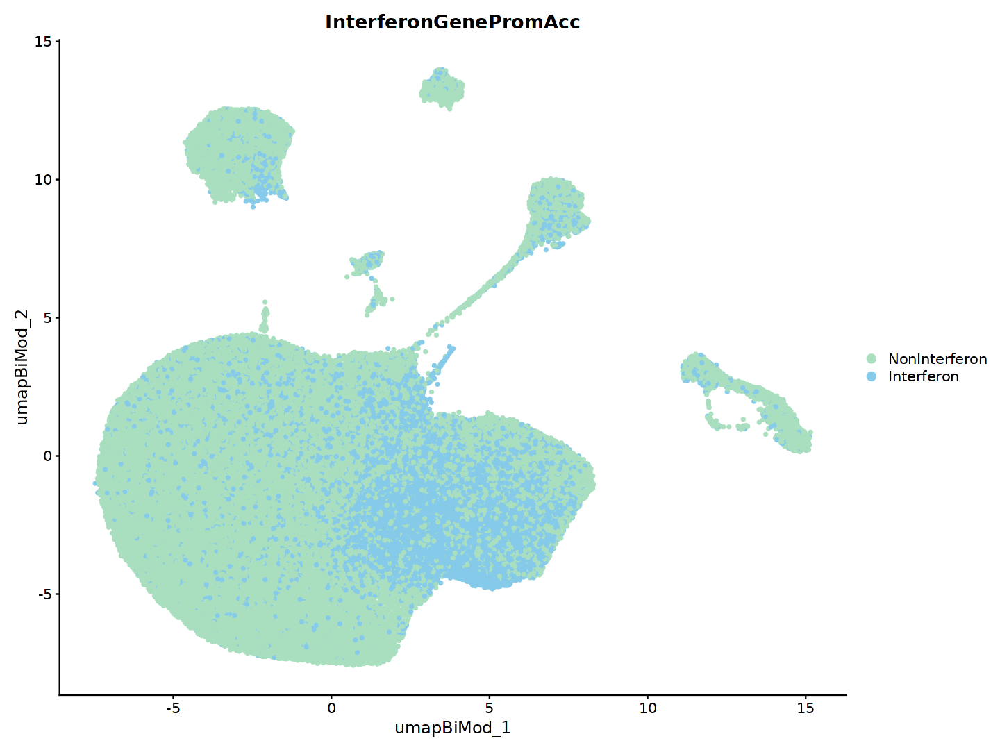

In [319]:
options(repr.plot.width=12, repr.plot.height=9)
DimPlot(MORNAATACC, reduction="umap_BiMod", group.by = "InterferonGenePromAcc", shuffle = TRUE, cols = interferon_colors, pt.size = 1, raster=FALSE)

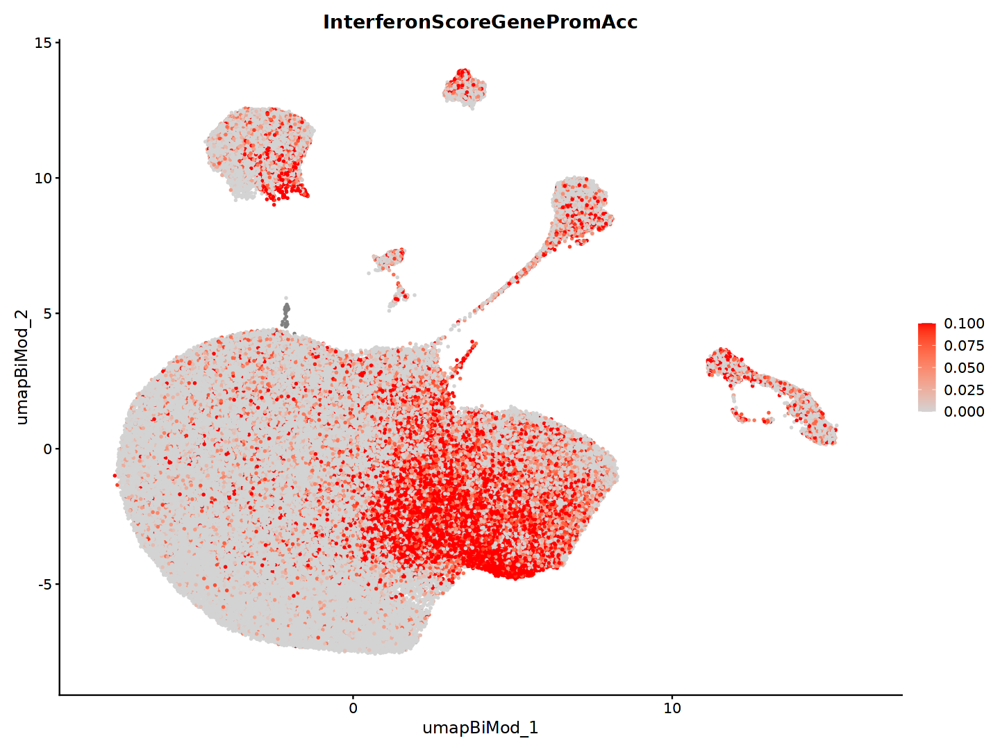

In [11]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC, features = "InterferonScoreGenePromAcc", reduction = "umap_BiMod", cols=c("lightgrey", "red"), pt.size=0.5, min.cutoff = 0, max.cutoff = 0.1, raster=FALSE)

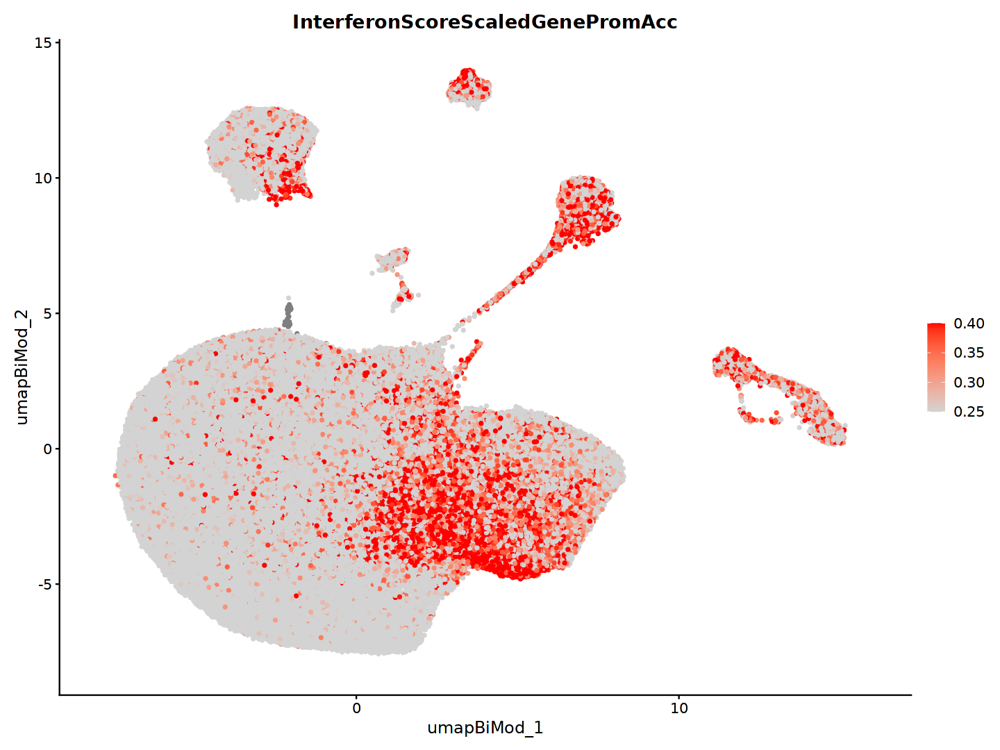

In [320]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC, features = "InterferonScoreScaledGenePromAcc", reduction = "umap_BiMod", cols=c("lightgrey", "red"), pt.size=1, max.cutoff = 0.4, min.cutoff = 0.25, raster=FALSE)

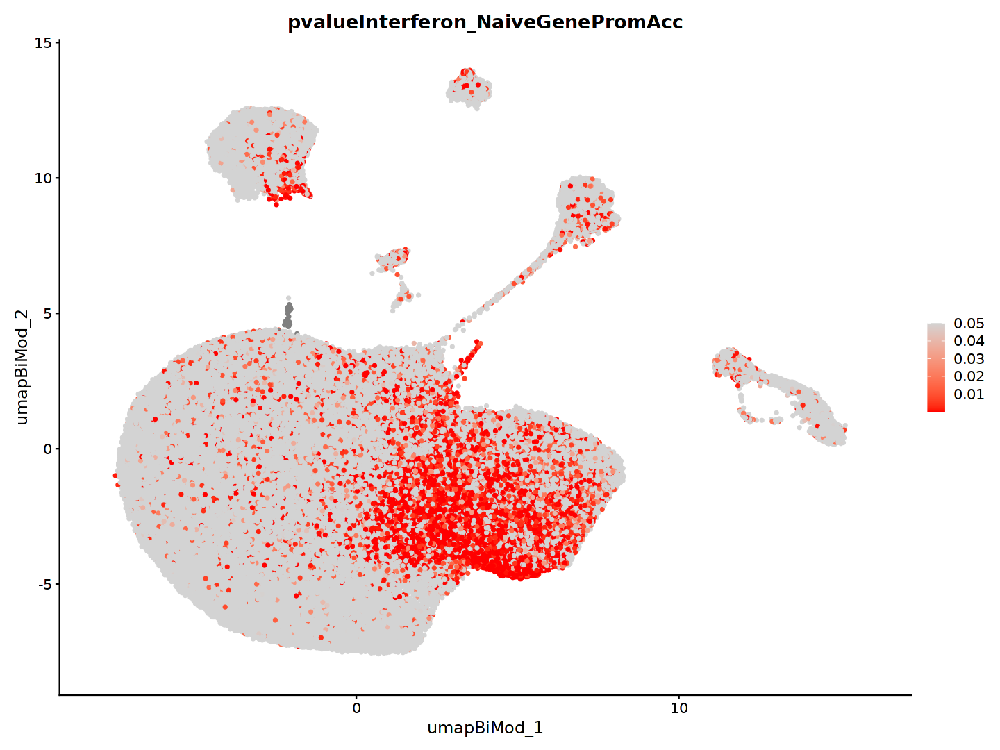

In [321]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC, features = "pvalueInterferon_NaiveGenePromAcc", reduction = "umap_BiMod", cols = c("red", "lightgrey"), pt.size=1, max.cutoff = 0.05, raster=FALSE)

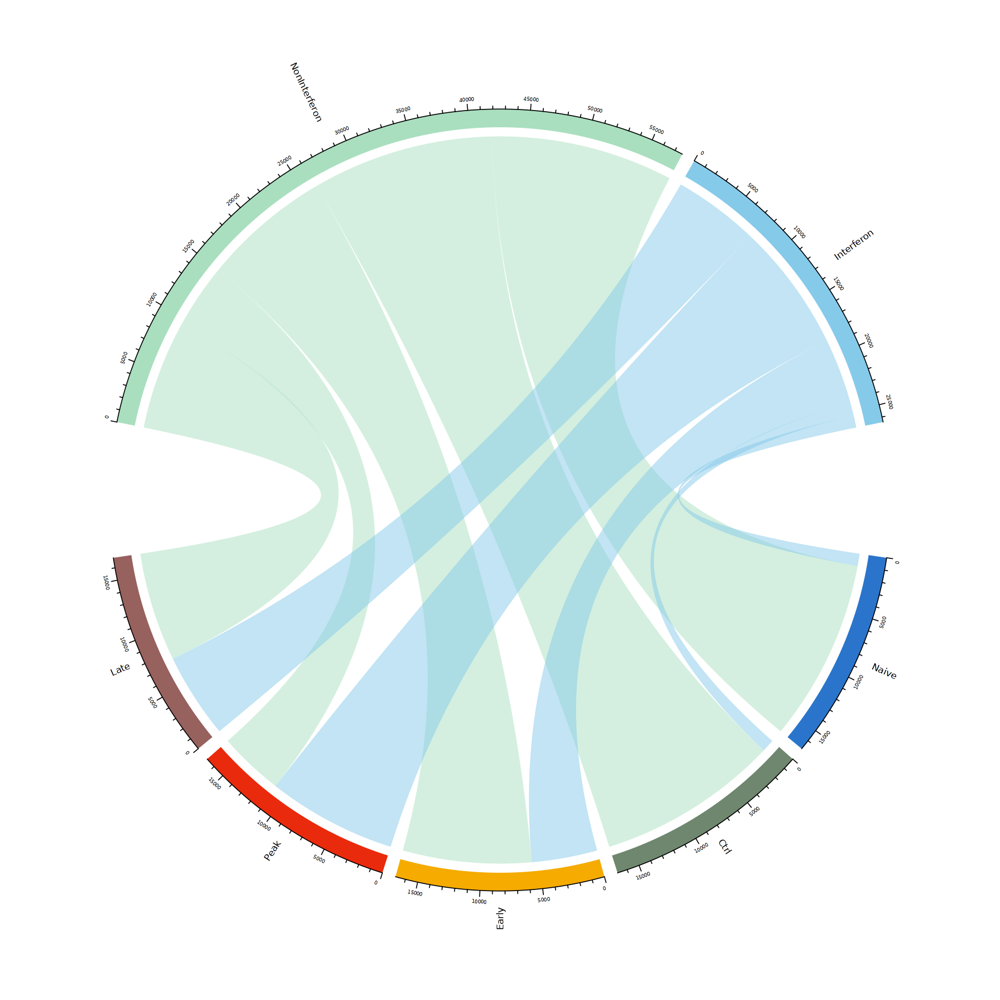

In [322]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(80)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$orig.ident_merge))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

### 3.3 Investigate cutoff

In [323]:
table(MORNAATACC$Interferon, MORNAATACC$InterferonGenePromAcc)

               
                NonInterferon Interferon
  NonInterferon         85204       7554
  Interferon            24929      33935

In [324]:
#OL only
table(MORNAATACC@meta.data[(MORNAATACC$cellType=="MOL" | MORNAATACC$cellType=="OPC"),]$Interferon, MORNAATACC@meta.data[(MORNAATACC$cellType=="MOL" | MORNAATACC$cellType=="OPC"),]$InterferonGenePromAcc)

               
                NonInterferon Interferon
  NonInterferon         75043       6787
  Interferon            21781      32682

In [325]:
for (i in 1:nrow(MORNAATACC@meta.data)){
  if(MORNAATACC@meta.data[i,"Interferon"] == "Interferon" & MORNAATACC@meta.data[i,"InterferonGenePromAcc"] == "Interferon"){
    MORNAATACC@meta.data[i,"InterferonAll"] <- "Both"
  }
  else if(MORNAATACC@meta.data[i,"Interferon"] == "Interferon" & MORNAATACC@meta.data[i,"InterferonGenePromAcc"] != "Interferon"){
    MORNAATACC@meta.data[i,"InterferonAll"] <- "RNA"
  }
  else if(MORNAATACC@meta.data[i,"Interferon"] != "Interferon" & MORNAATACC@meta.data[i,"InterferonGenePromAcc"] == "Interferon"){
    MORNAATACC@meta.data[i,"InterferonAll"] <- "GenePromAcc"
  }
  else {
    MORNAATACC@meta.data[i,"InterferonAll"] <- "None"
  }
}

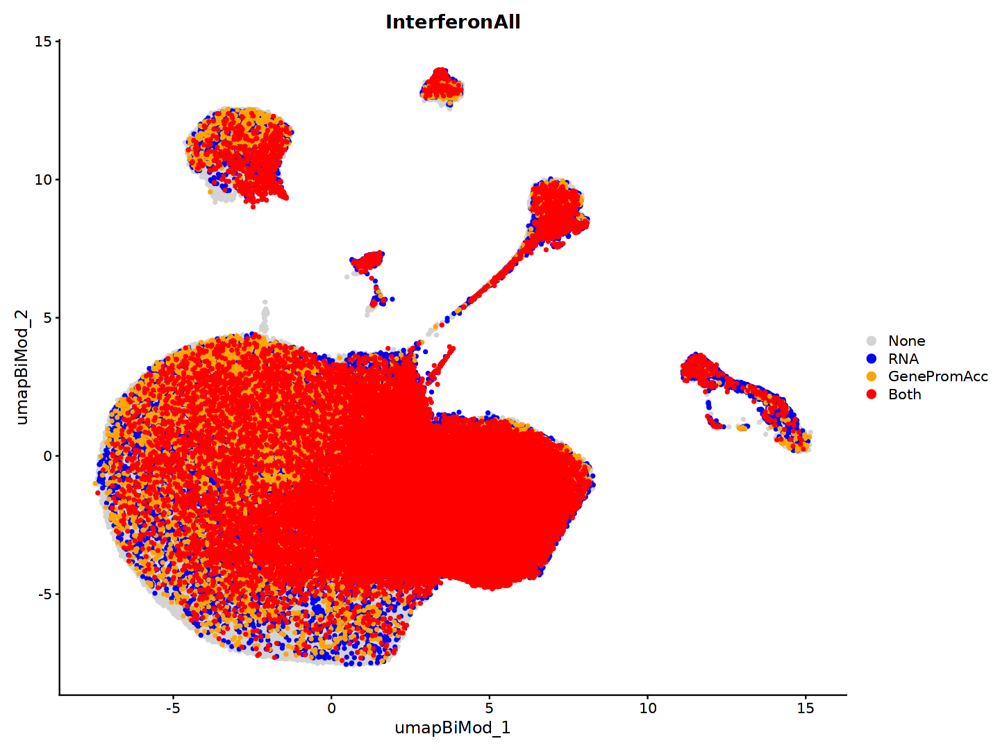

In [326]:
options(repr.plot.width=12, repr.plot.height=9)
DimPlot(MORNAATACC, reduction="umap_BiMod", group.by = "InterferonAll", order = rev(names(modality_colors)), shuffle = FALSE, cols = modality_colors, pt.size = 1, raster=FALSE)

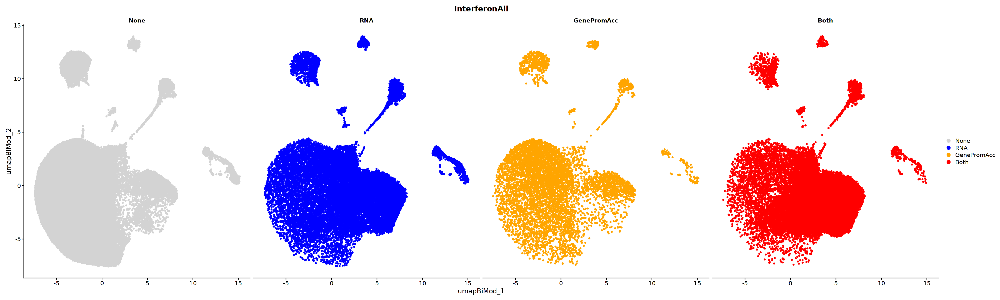

In [327]:
options(repr.plot.width=30, repr.plot.height=9)
DimPlot(MORNAATACC, reduction="umap_BiMod", split.by="InterferonAll", group.by = "InterferonAll", order = rev(names(modality_colors)), shuffle = FALSE, cols = modality_colors, pt.size = 1, raster=FALSE)

In [328]:
vector_col <- c()
for (i in 1:nrow(MORNAATACC@meta.data)){
  if(MORNAATACC@meta.data[i,"InterferonAll"] == "None"){
    vector_col <- c(vector_col, "white")
  } else if(MORNAATACC@meta.data[i,"InterferonAll"] == "Both"){
    vector_col <- c(vector_col, as.character(modality_colors["Both"]))
  }
  else if(MORNAATACC@meta.data[i,"InterferonAll"] == "GenePromAcc"){
    vector_col <- c(vector_col, as.character(modality_colors["GenePromAcc"]))
  }
  else if(MORNAATACC@meta.data[i,"InterferonAll"] == "RNA"){
    vector_col <- c(vector_col, as.character(modality_colors["RNA"]))
  }
  else {
    vector_col <- c(vector_col, "black")
  }
}

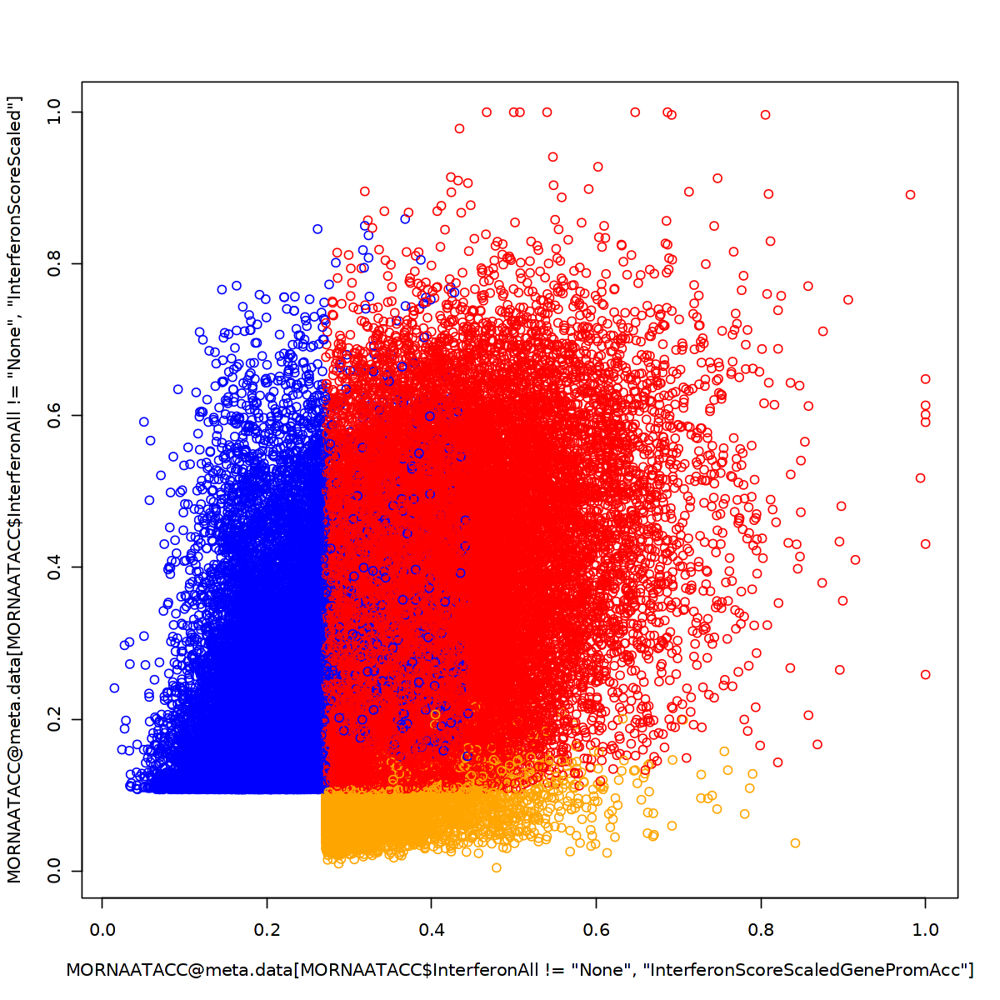

In [329]:
options(repr.plot.width=10, repr.plot.height=10)
plot(MORNAATACC@meta.data[MORNAATACC$InterferonAll != "None", "InterferonScoreScaledGenePromAcc"], MORNAATACC@meta.data[MORNAATACC$InterferonAll != "None", "InterferonScoreScaled"], col=vector_col[vector_col != "white"])

[Save](#X.1-Savings)

#### 3.3.1 MOL

In [330]:
tmp_celltype <- "MOL"

In [331]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(MORNAATACC$cellType)]

In [332]:
meta <- MORNAATACC@meta.data[MORNAATACC$cellType==tmp_celltype,]

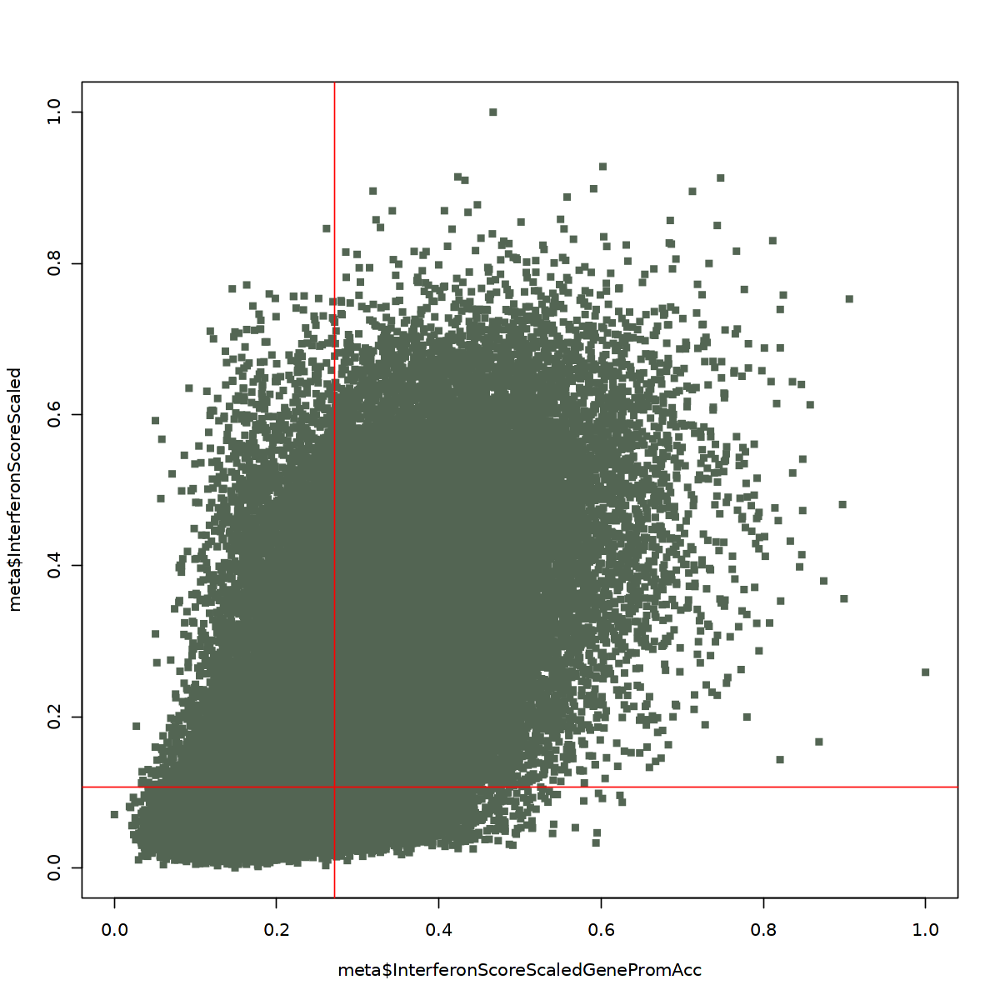

In [333]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta$InterferonScoreScaledGenePromAcc, meta$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta[meta$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta[meta$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.1.1 Naive

In [334]:
meta_tp <- meta[meta$orig.ident_merge == "Naive",]

In [335]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

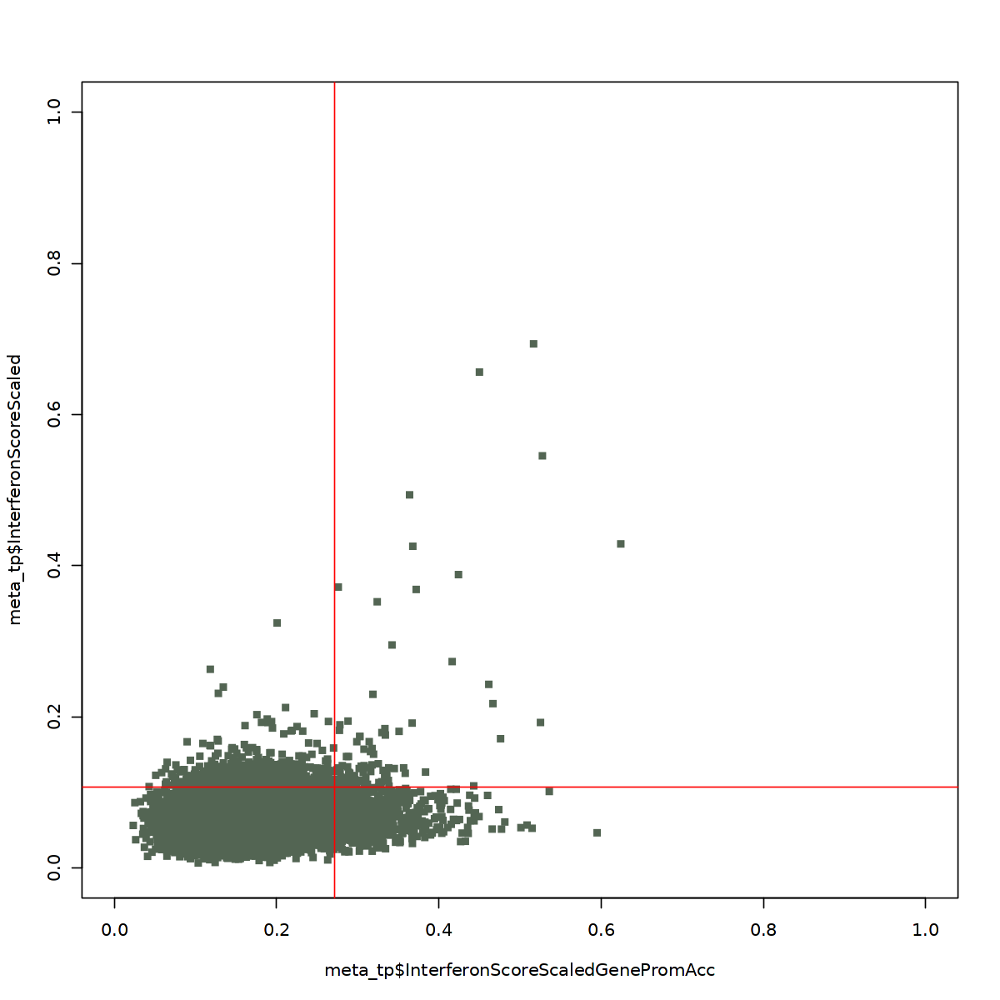

In [336]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.1.2 Ctrl

In [337]:
meta_tp <- meta[meta$orig.ident_merge == "Ctrl",]

In [338]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

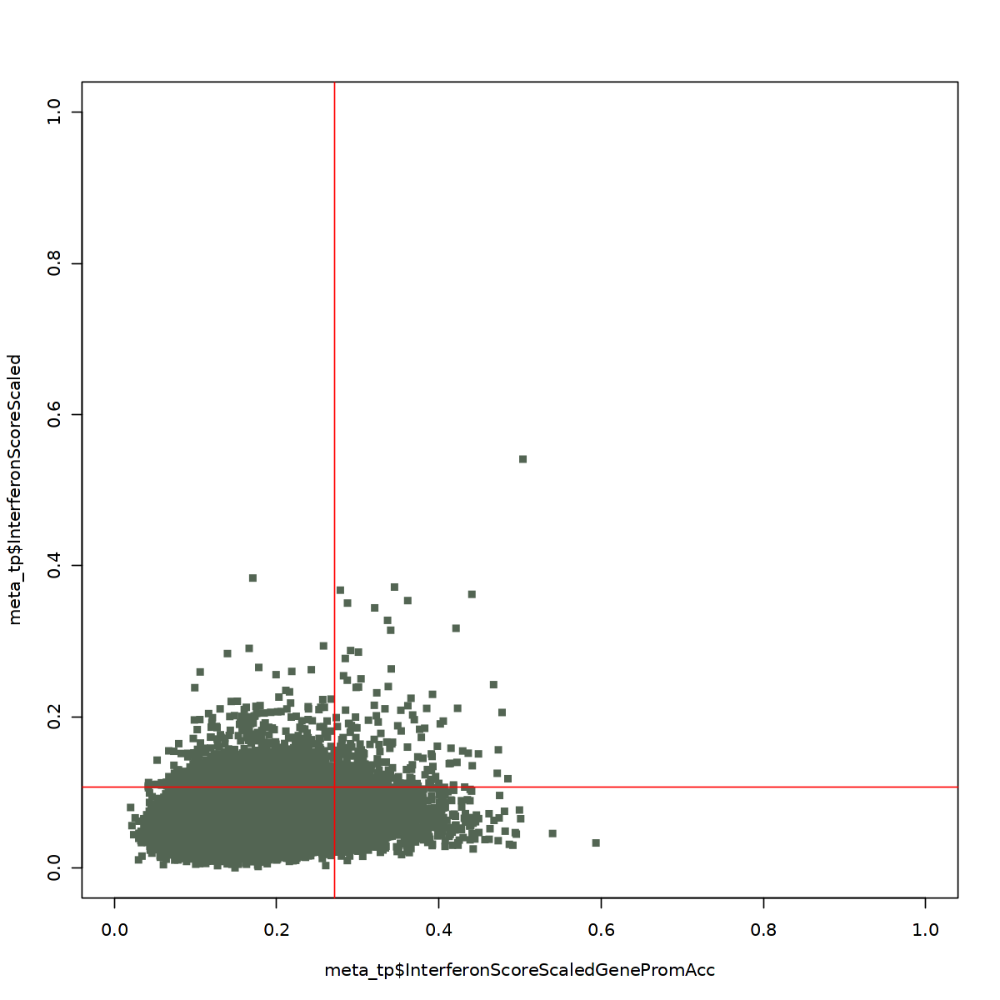

In [339]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.1.3 Early

In [340]:
meta_tp <- meta[meta$orig.ident_merge == "Early",]

In [341]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

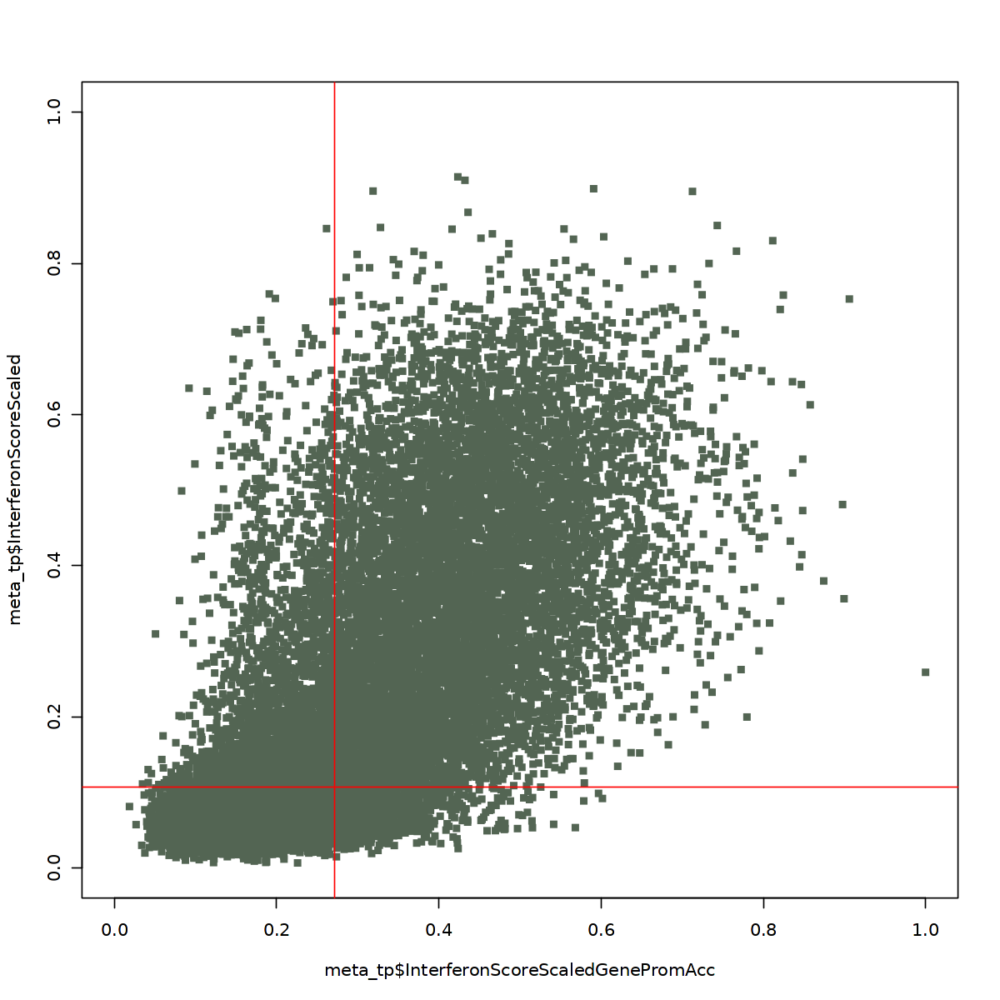

In [342]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.1.4 Peak

In [343]:
meta_tp <- meta[meta$orig.ident_merge == "Peak",]

In [344]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

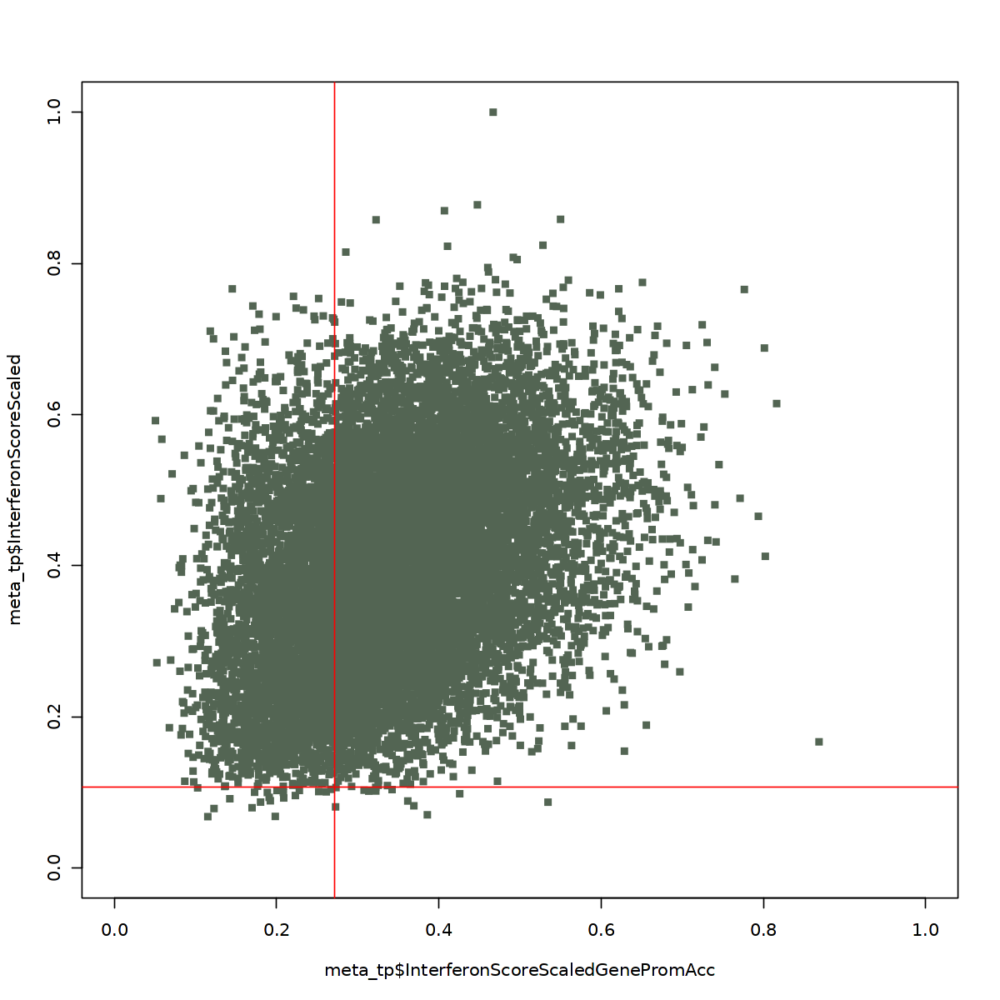

In [345]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.1.5 Late

In [346]:
meta_tp <- meta[meta$orig.ident_merge == "Late",]

In [347]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

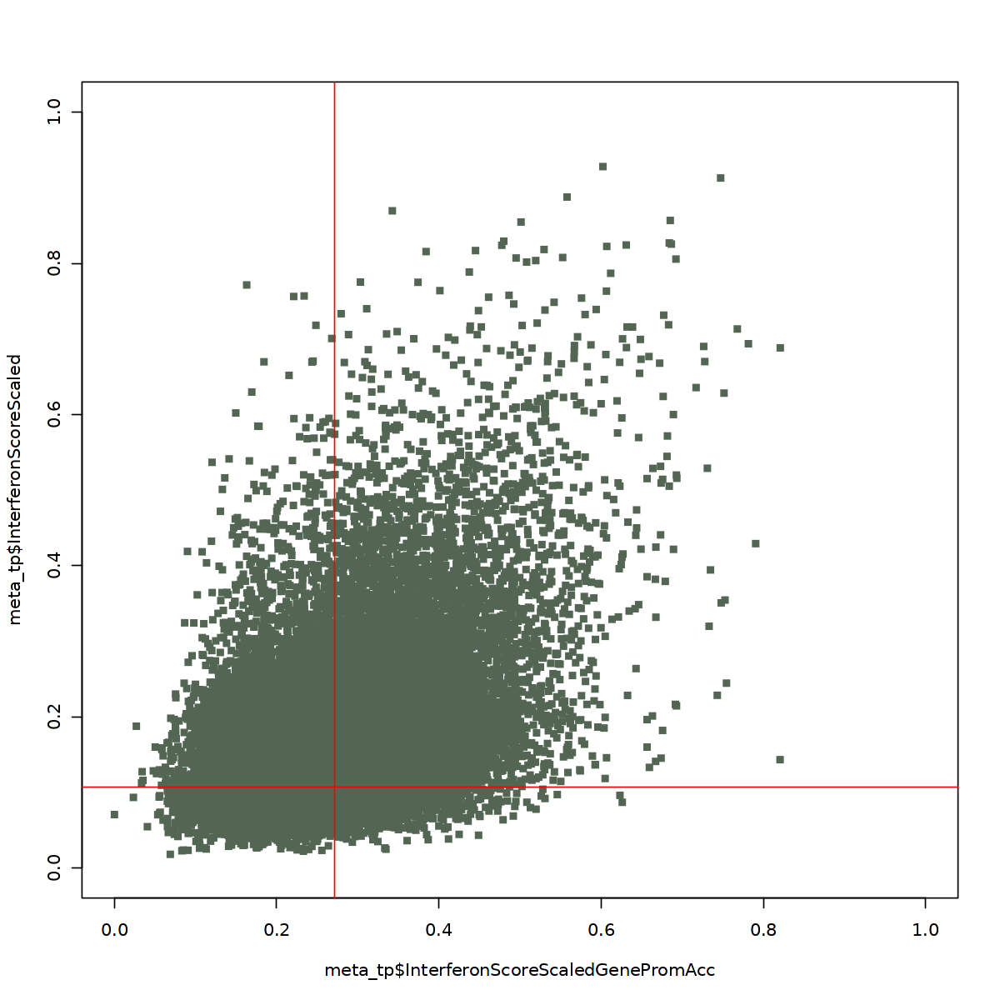

In [348]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

#### 3.3.2 OPC

In [349]:
tmp_celltype <- "OPC"

In [350]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(MORNAATACC$cellType)]

In [351]:
meta <- MORNAATACC@meta.data[MORNAATACC$cellType==tmp_celltype,]

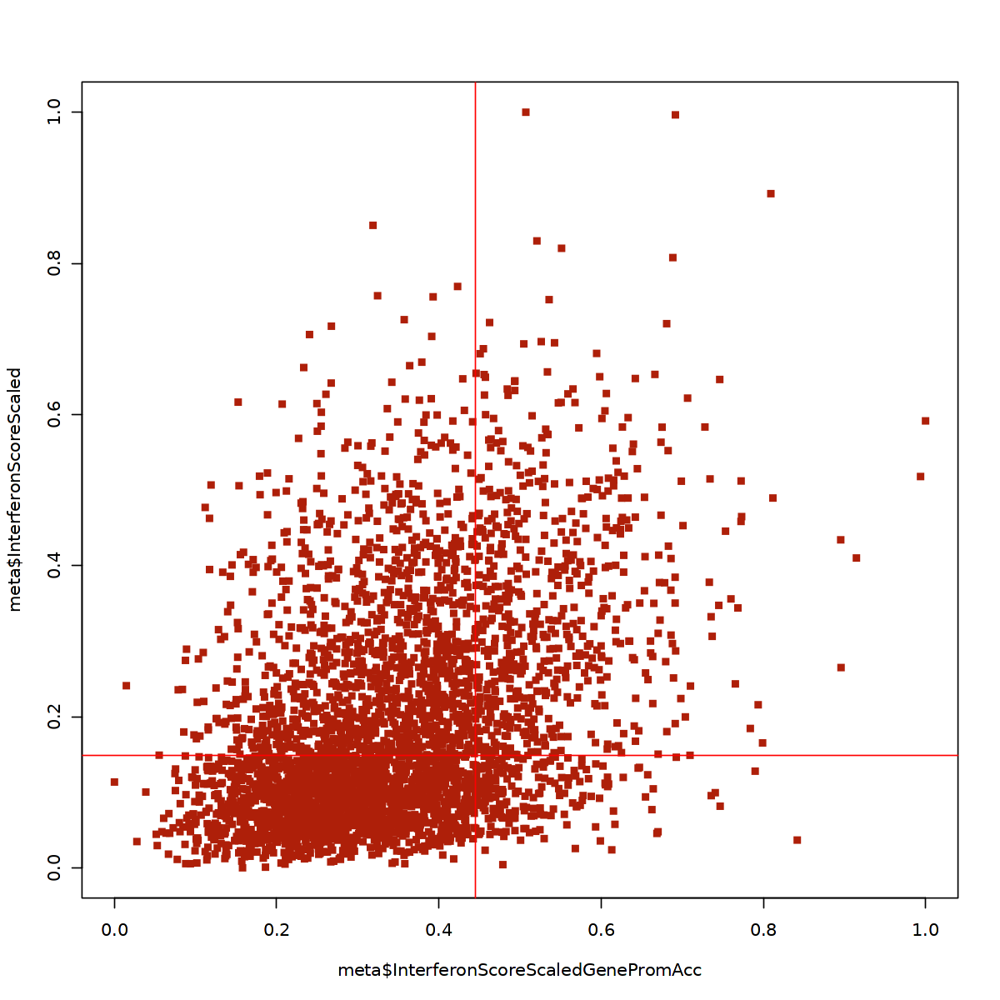

In [352]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta$InterferonScoreScaledGenePromAcc, meta$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta[meta$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta[meta$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.2.1 Naive

In [353]:
meta_tp <- meta[meta$orig.ident_merge == "Naive",]

In [354]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

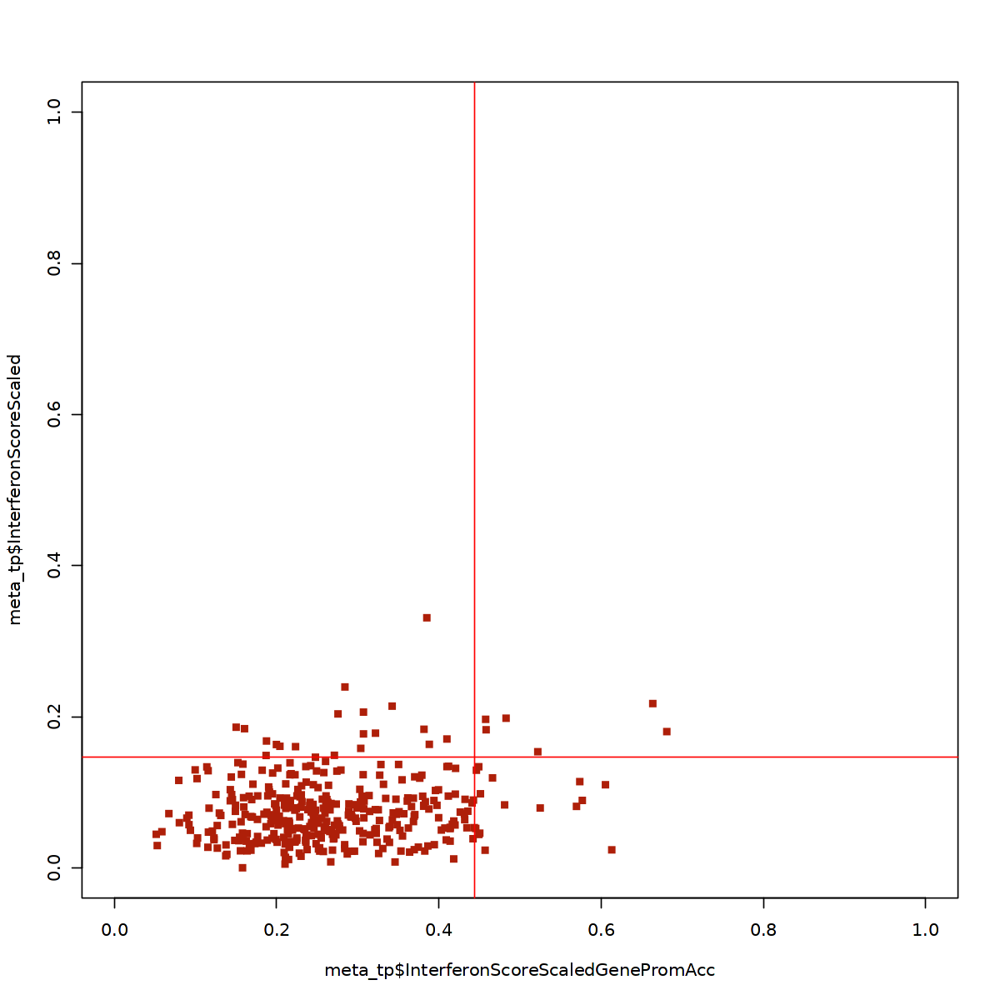

In [355]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.2.2 Ctrl

In [356]:
meta_tp <- meta[meta$orig.ident_merge == "Ctrl",]

In [357]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

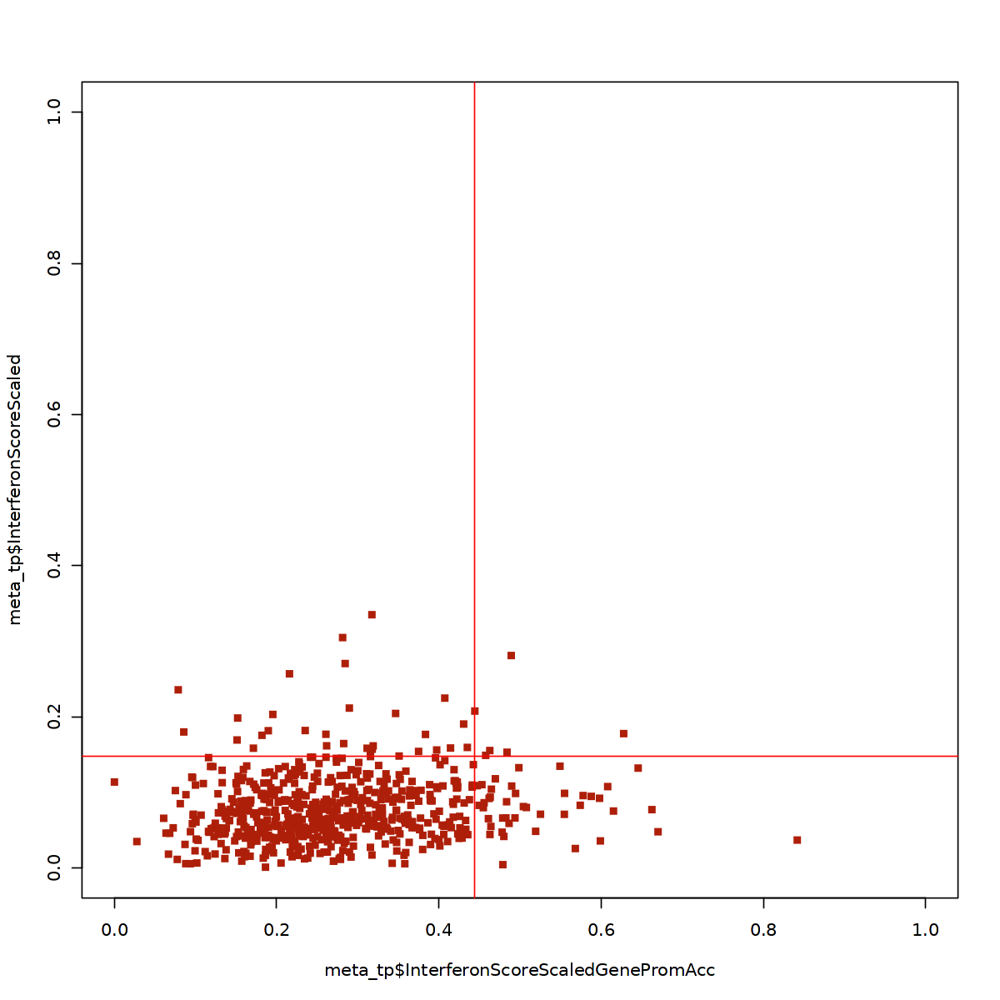

In [358]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.2.3 Early

In [359]:
meta_tp <- meta[meta$orig.ident_merge == "Early",]

In [360]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

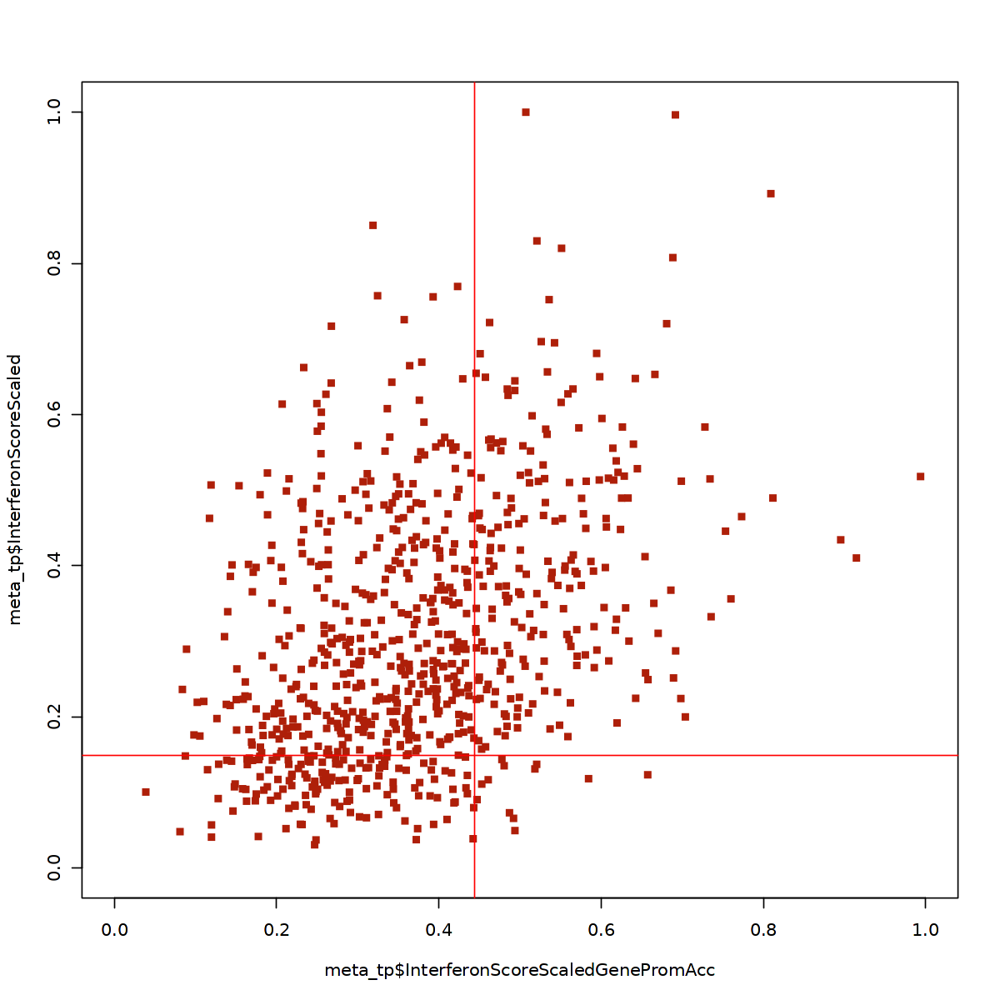

In [361]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.2.4 Peak

In [362]:
meta_tp <- meta[meta$orig.ident_merge == "Peak",]

In [363]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

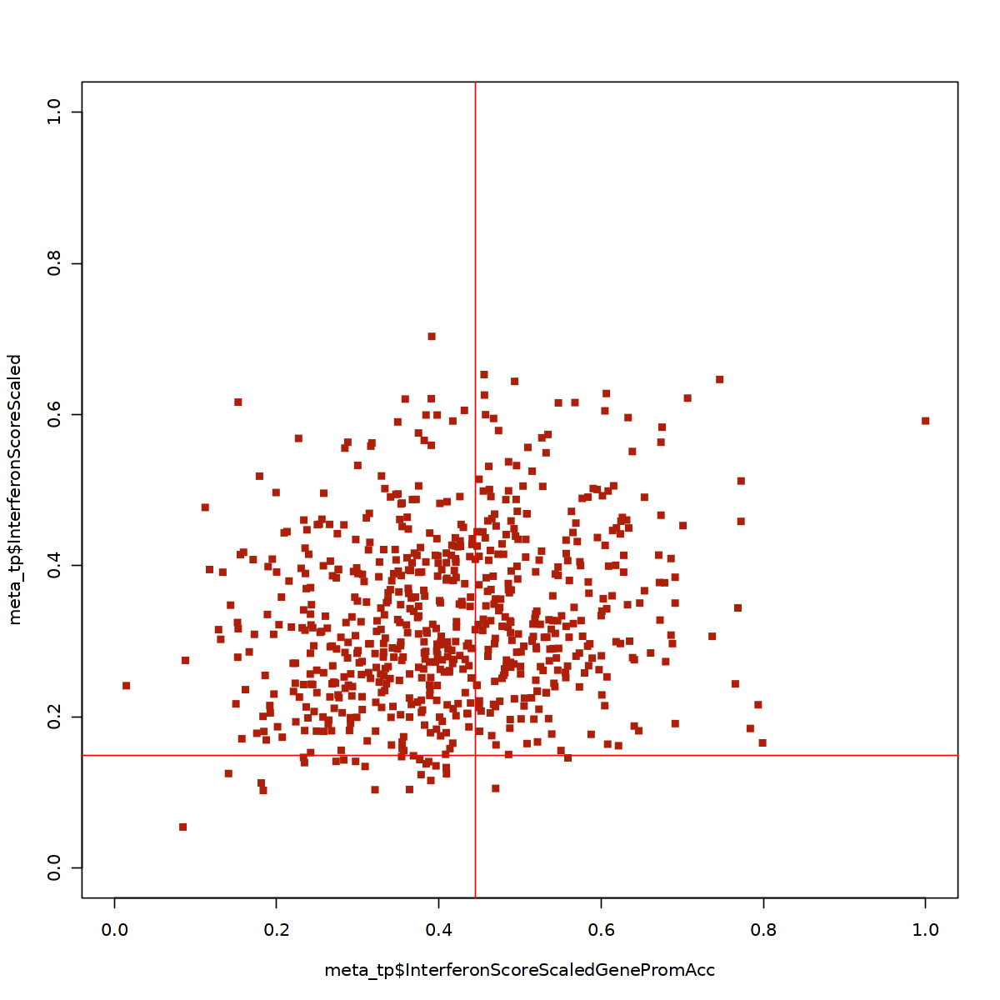

In [364]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

##### 3.3.2.5 Late

In [365]:
meta_tp <- meta[meta$orig.ident_merge == "Late",]

In [366]:
mapCelltype = setNames(cellType_colors, c(names(cellType_colors)))
vectorCelltype <- mapCelltype[unlist(meta_tp$cellType)]

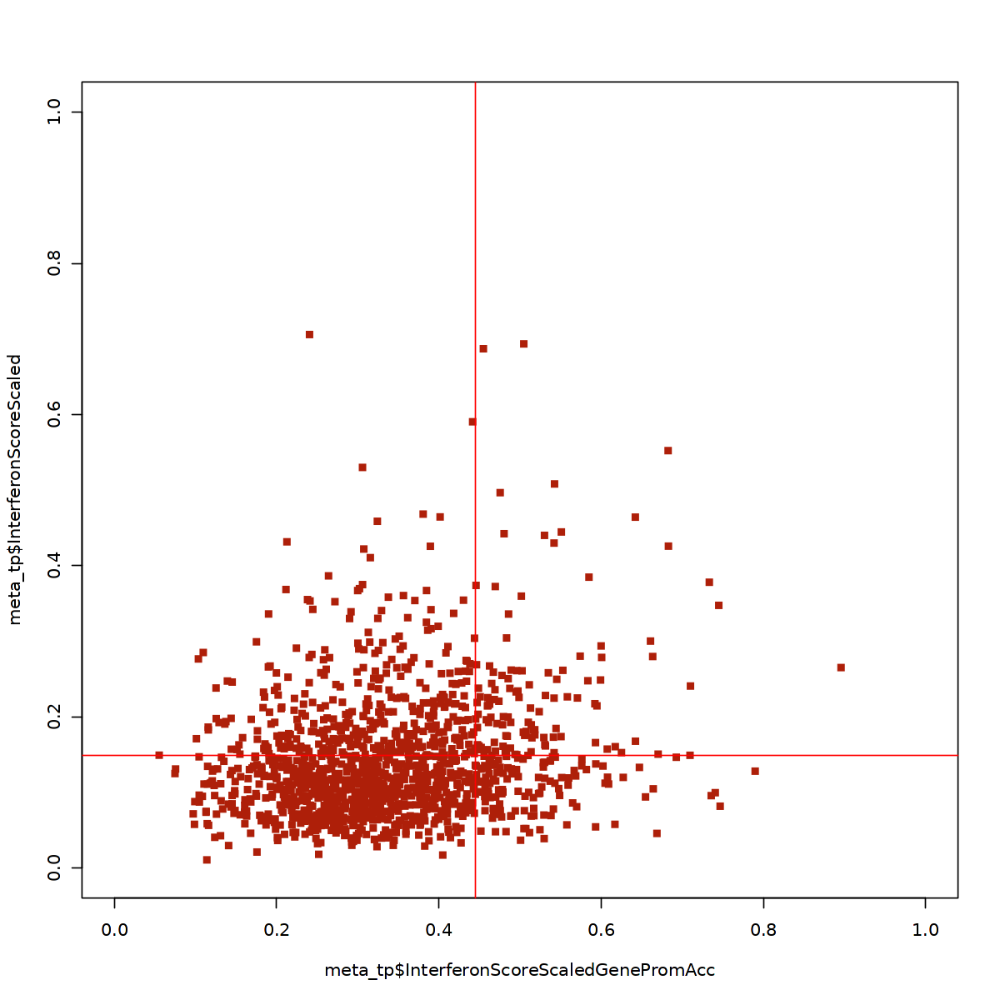

In [367]:
options(repr.plot.width=10, repr.plot.height=10)
plot(meta_tp$InterferonScoreScaledGenePromAcc, meta_tp$InterferonScoreScaled, pch = 15, col=vectorCelltype[names(vectorCelltype) %in% tmp_celltype], xlim=c(0,1), ylim=c(0,1))
abline(h=max(na.omit(meta_tp[meta_tp$Interferon == "NonInterferon",]$InterferonScoreScaled)), col="red")
abline(v=max(na.omit(meta_tp[meta_tp$InterferonGenePromAcc == "NonInterferon",]$InterferonScoreScaledGenePromAcc)), col="red")

## 4. Interferon plots

### 4.1 Interferon RNA (default)

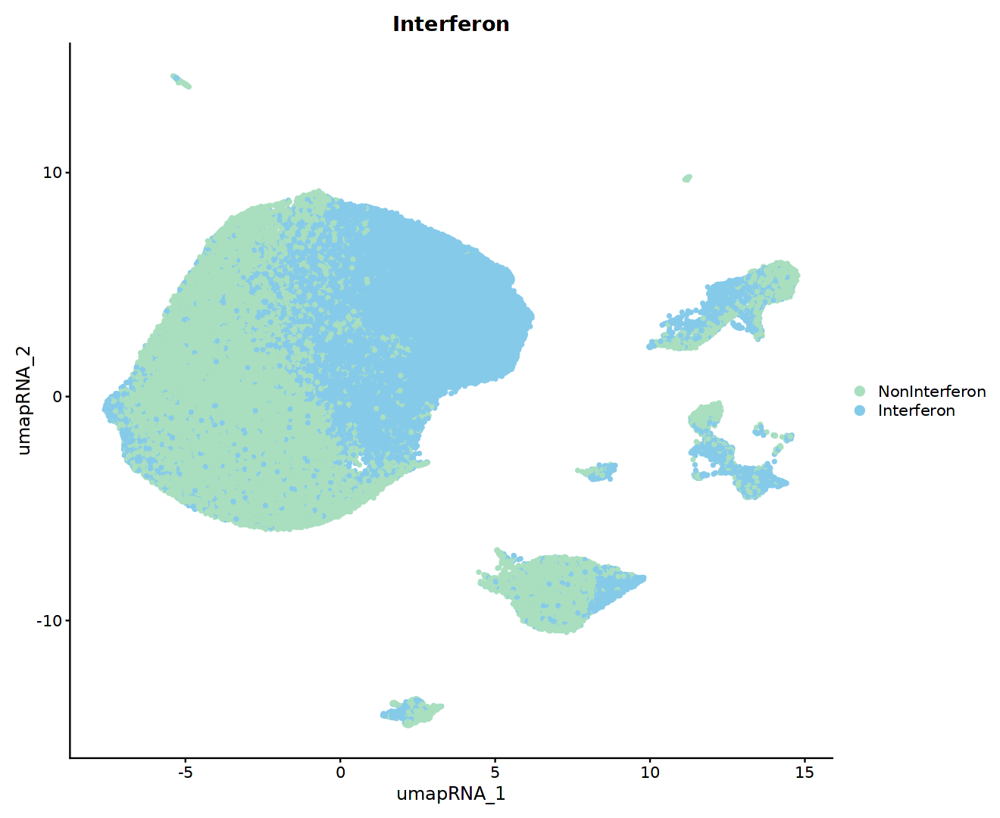

In [368]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Interferon", reduction="umap_RNA", shuffle=TRUE, cols = interferon_colors, pt.size=1, label=FALSE, raster=FALSE)

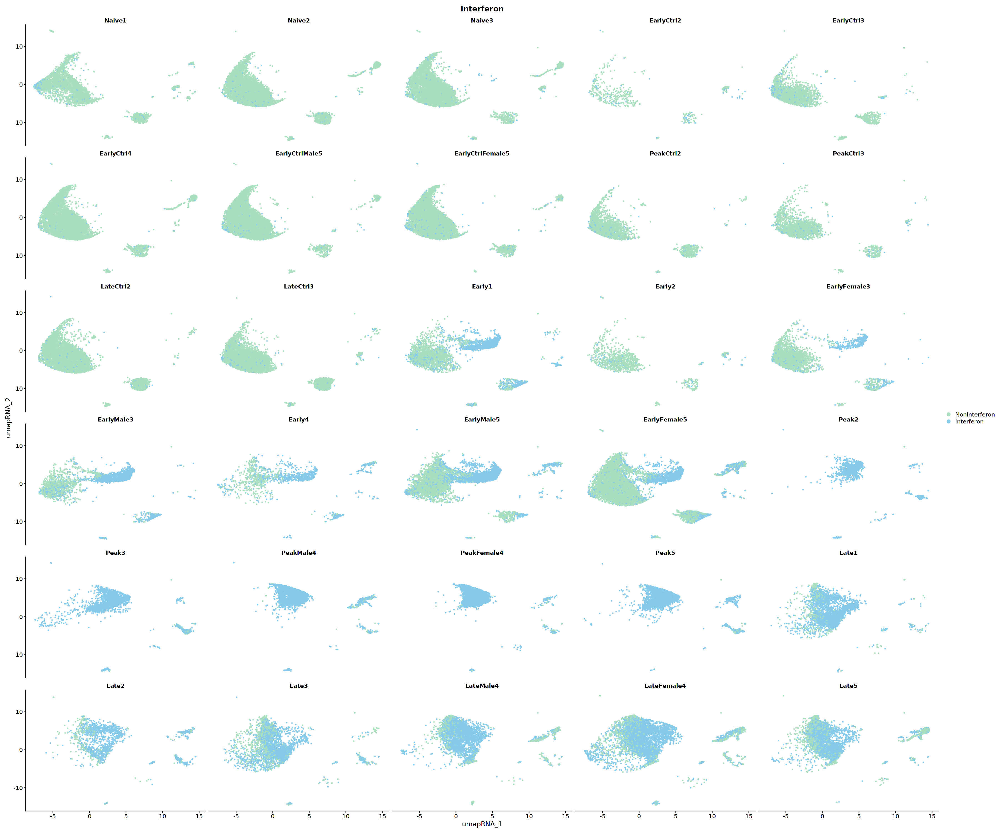

In [369]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Interferon", split.by="orig.ident", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols=interferon_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [370]:
t <- table(Cluster=MORNAATACC$seurat_clusters_RNA, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

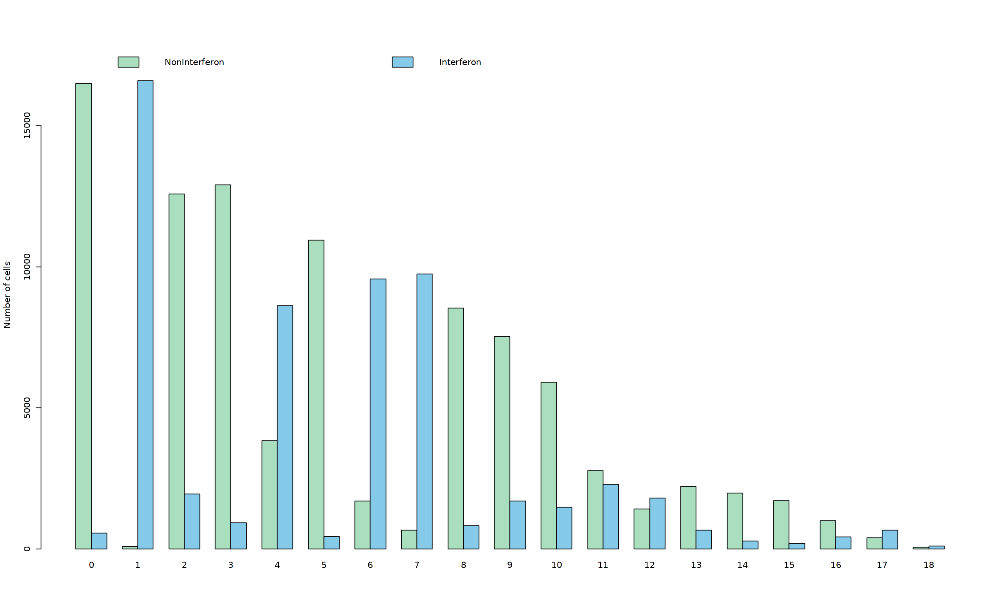

In [371]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

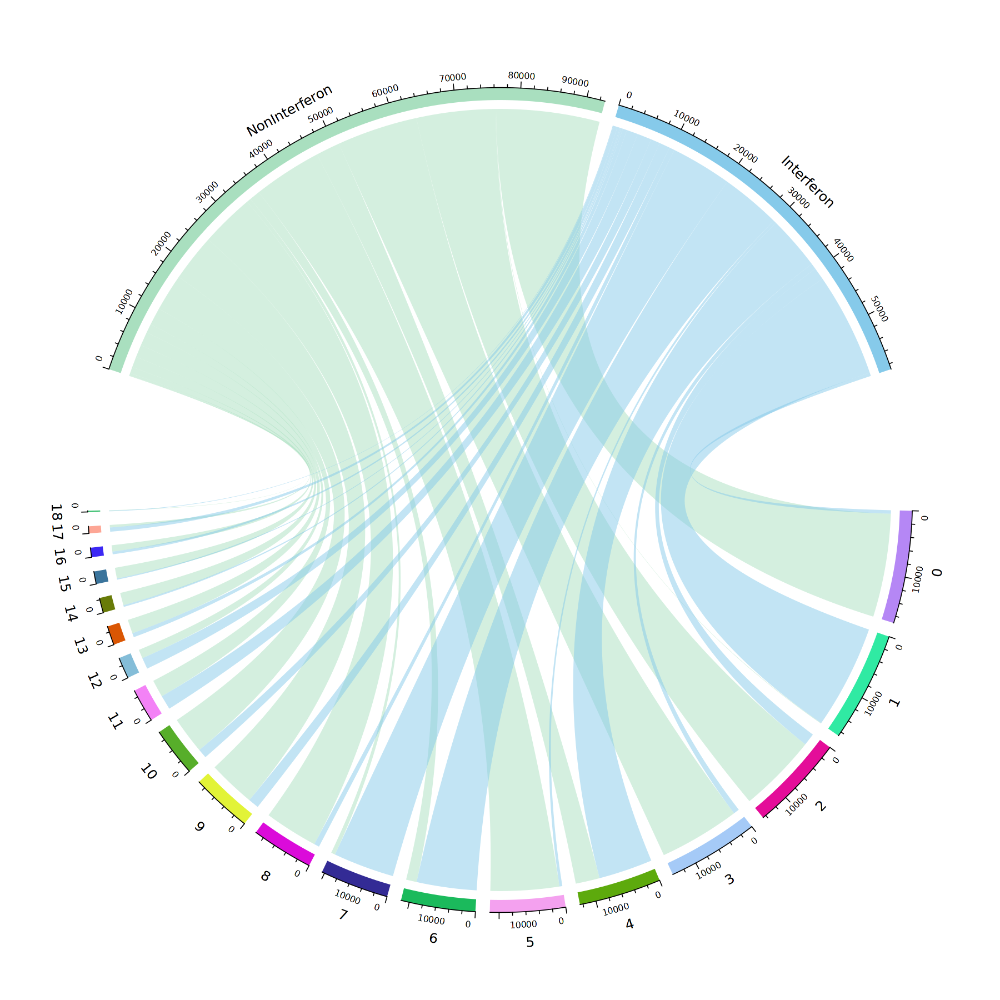

In [372]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$seurat_clusters_RNA))
circos.clear()
par(cex = 1.5)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(interferon_colors)), grid.col=rev(interferon_colors))

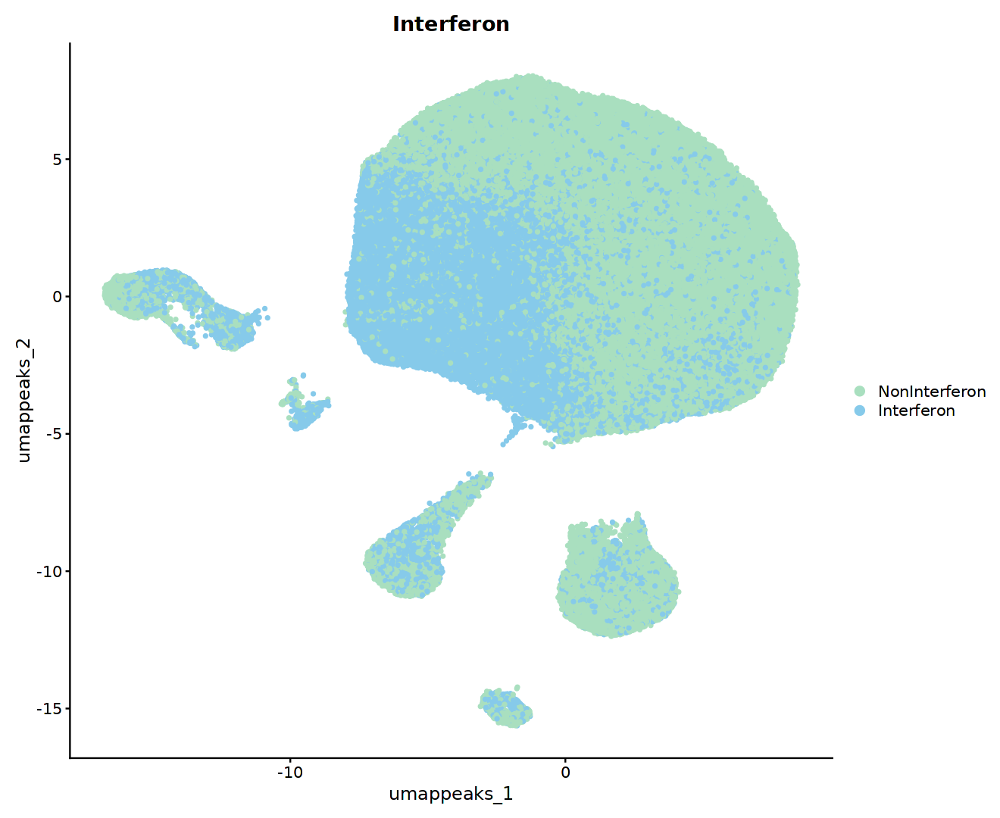

In [373]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Interferon", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols = interferon_colors, pt.size=1, label=FALSE, raster=FALSE)

In [374]:
t <- table(Cluster=MORNAATACC$seurat_clusters_peaks, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

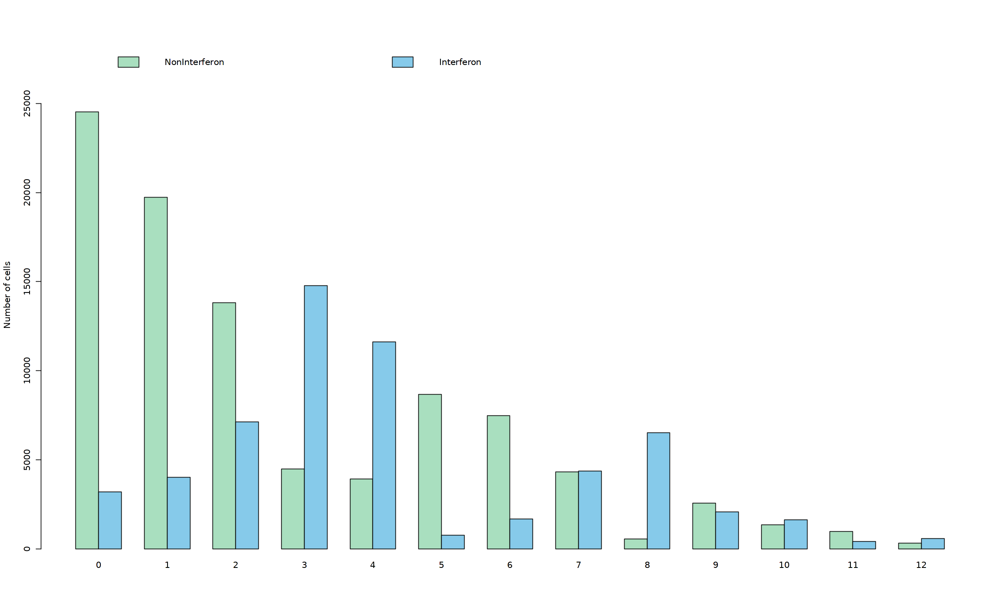

In [375]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

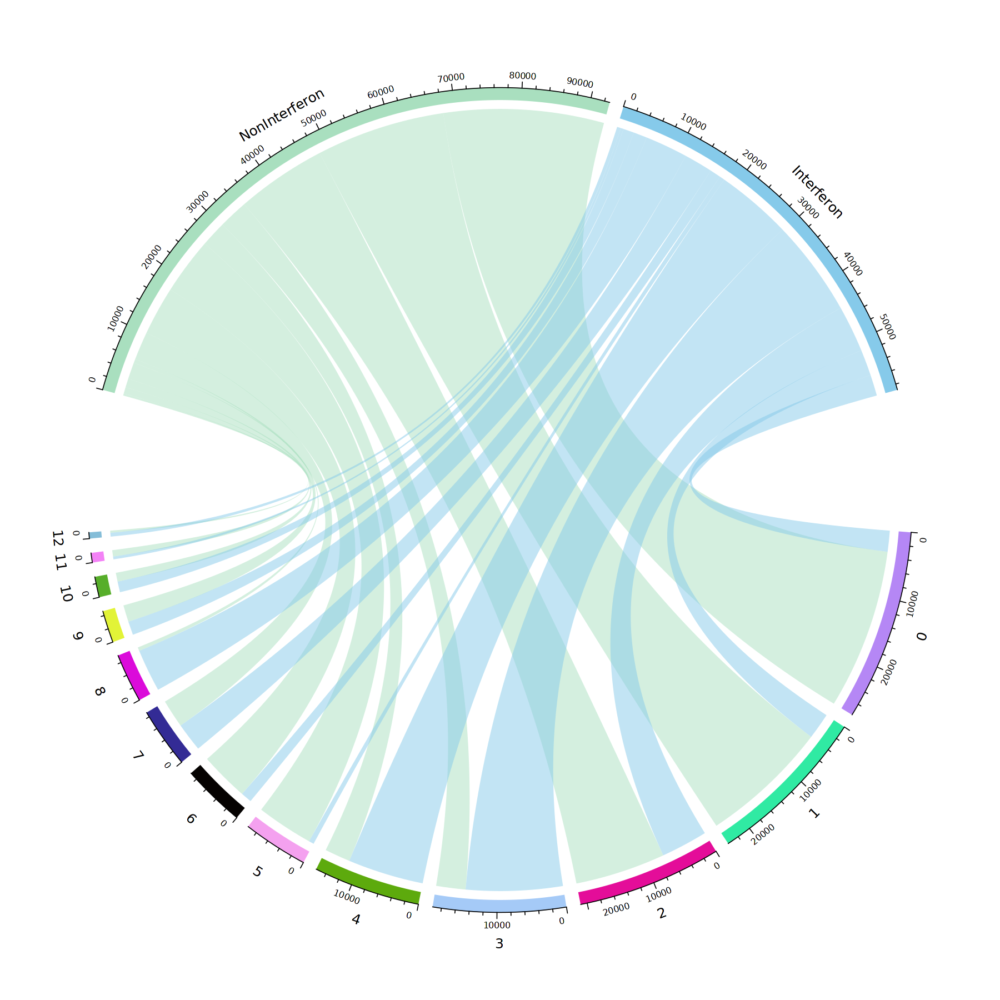

In [376]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$seurat_clusters_peaks))
circos.clear()
par(cex = 1.5)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(interferon_colors)), grid.col=rev(interferon_colors))

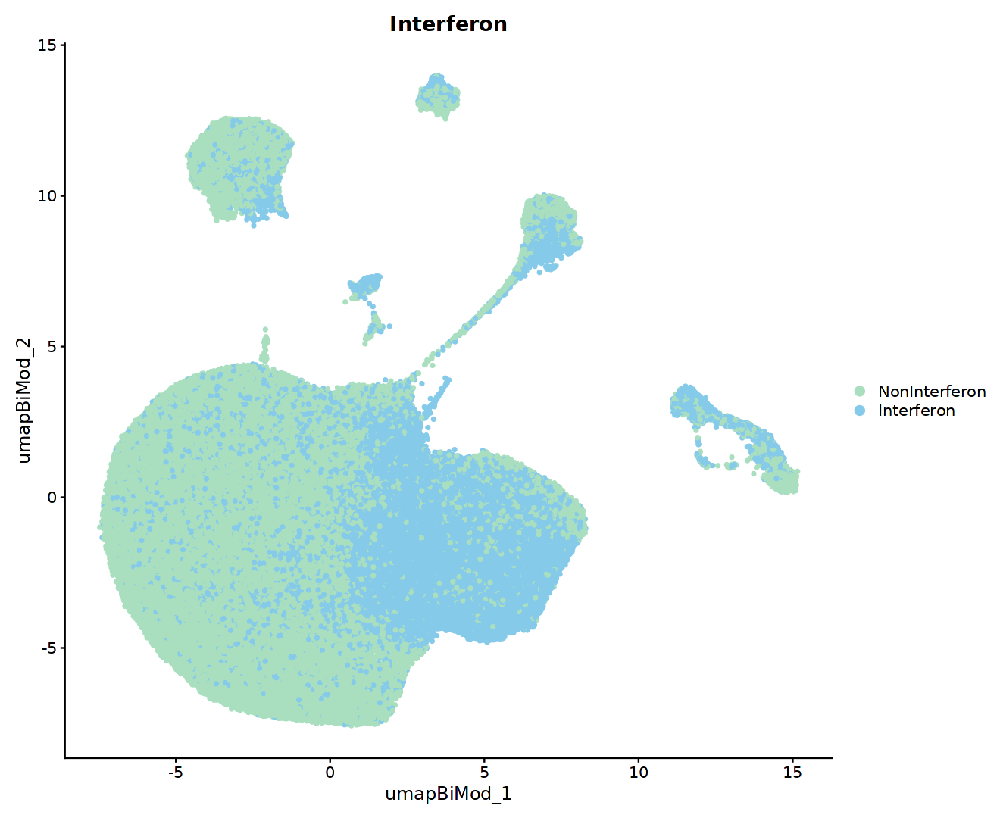

In [377]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Interferon", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols = interferon_colors, pt.size=1, label=FALSE, raster=FALSE)

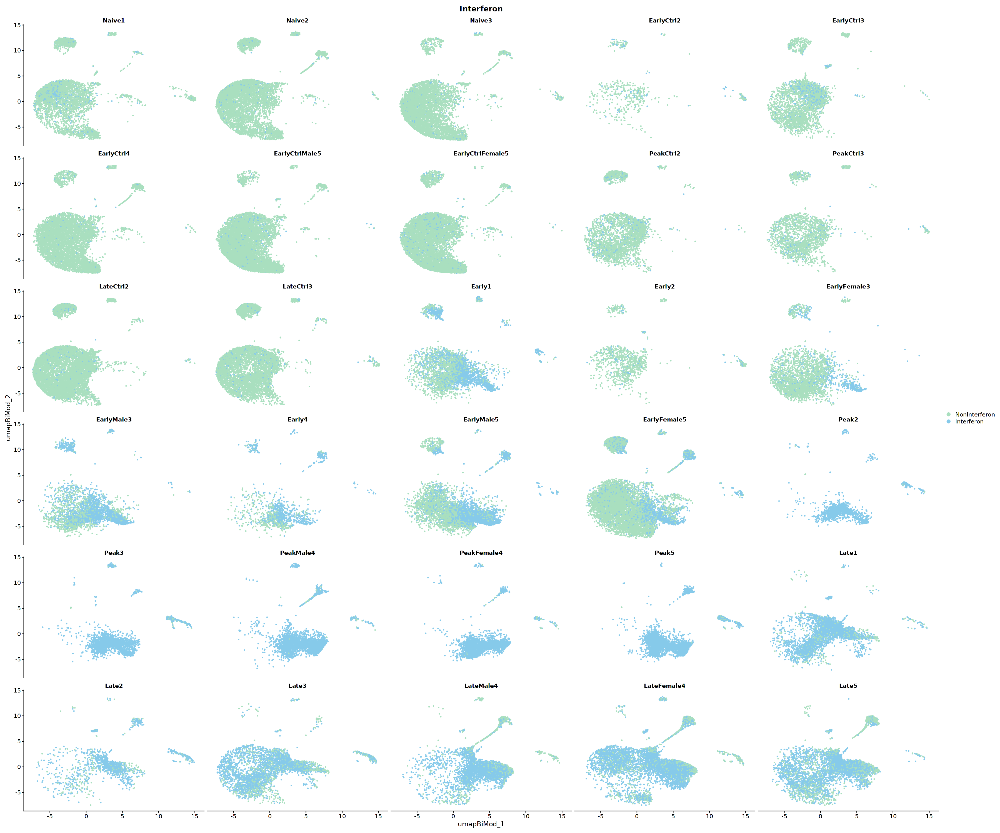

In [378]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Interferon", split.by="orig.ident", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=interferon_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [379]:
t <- table(Cluster=MORNAATACC$seurat_clusters_BiMod, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

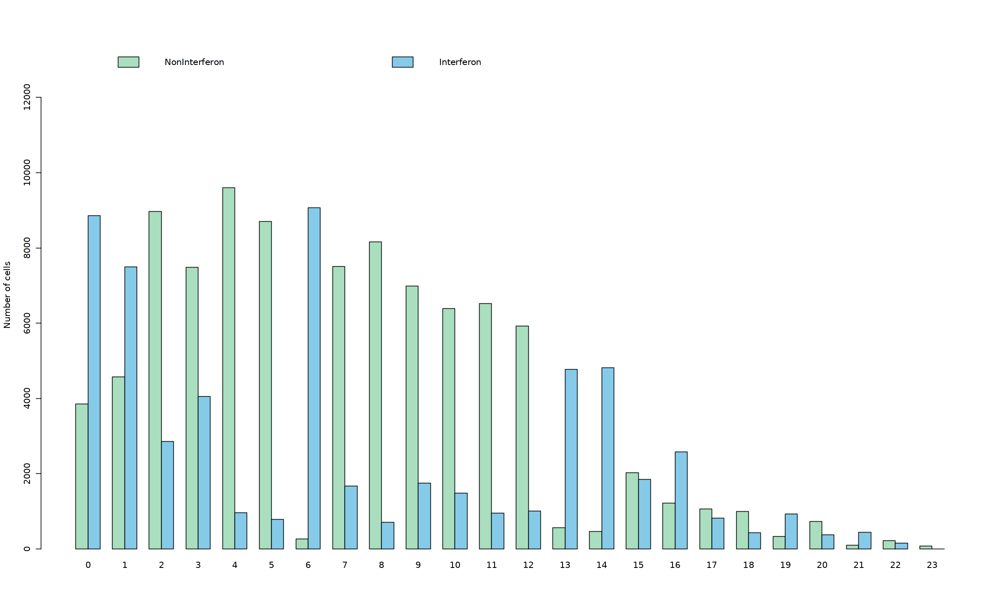

In [380]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

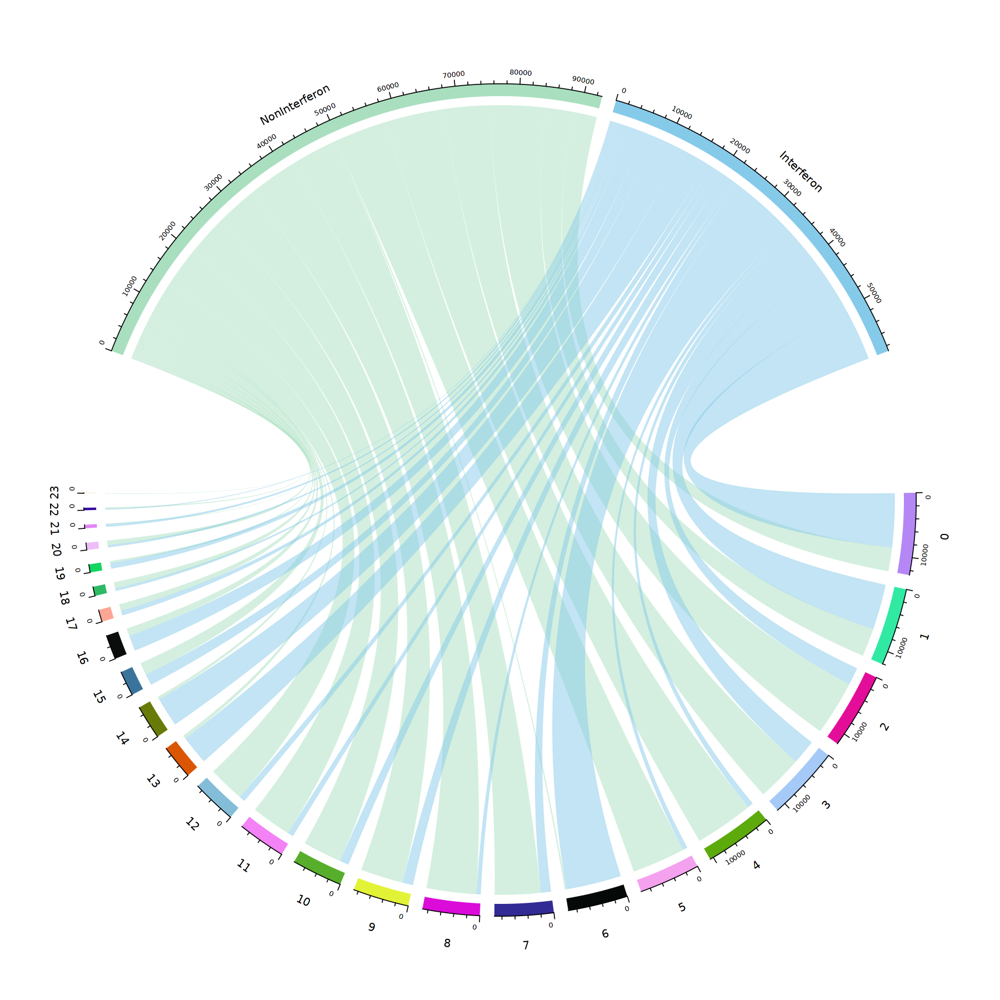

In [381]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$seurat_clusters_BiMod))
circos.clear()
par(cex = 1.2)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(interferon_colors)), grid.col=rev(interferon_colors))

In [382]:
t <- table(Cluster=MORNAATACC$cellType, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

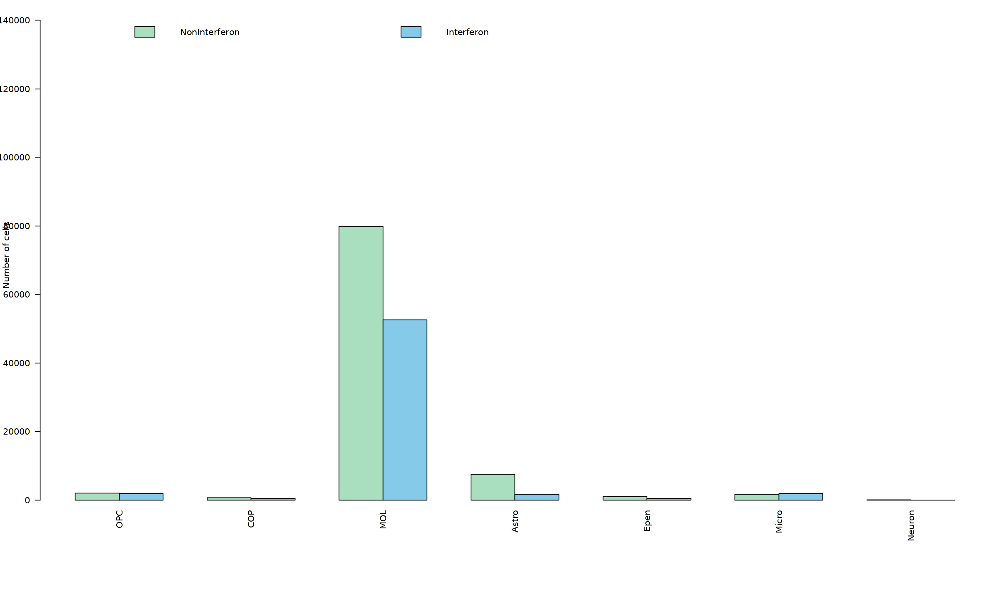

In [383]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+10000, 1000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

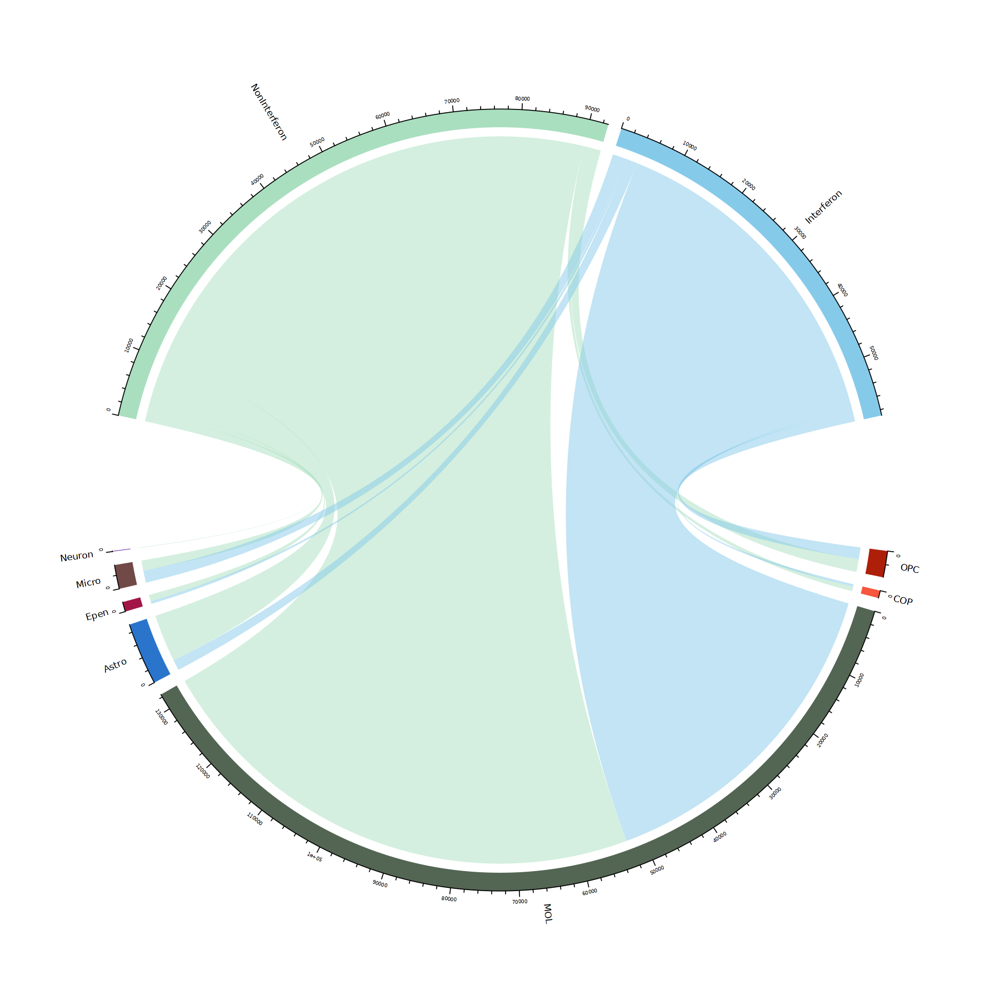

In [384]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$cellType))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(cellType_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),cellType_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [385]:
t <- table(Cluster=MORNAATACC$orig.ident, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

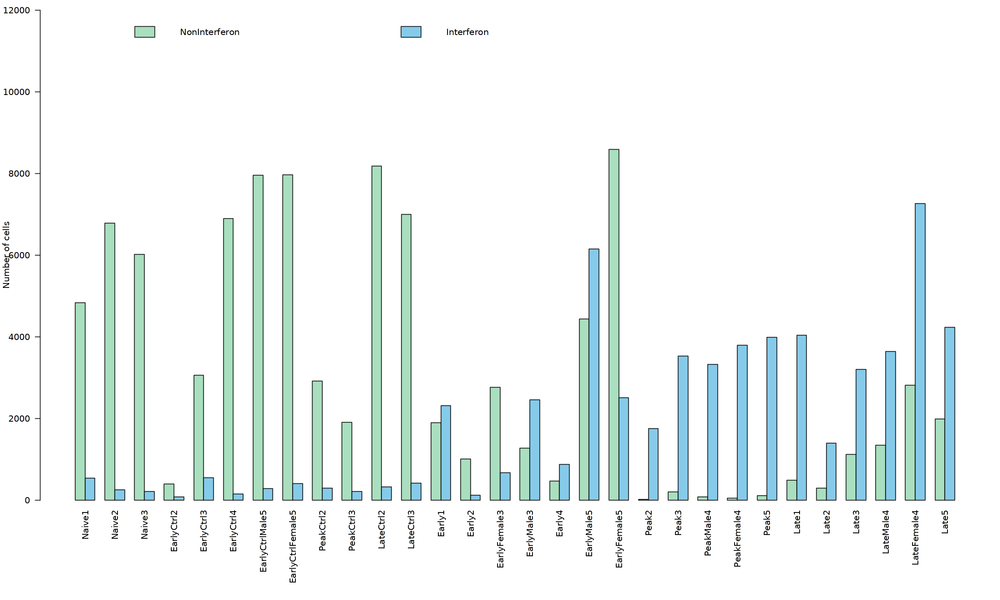

In [386]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 1000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

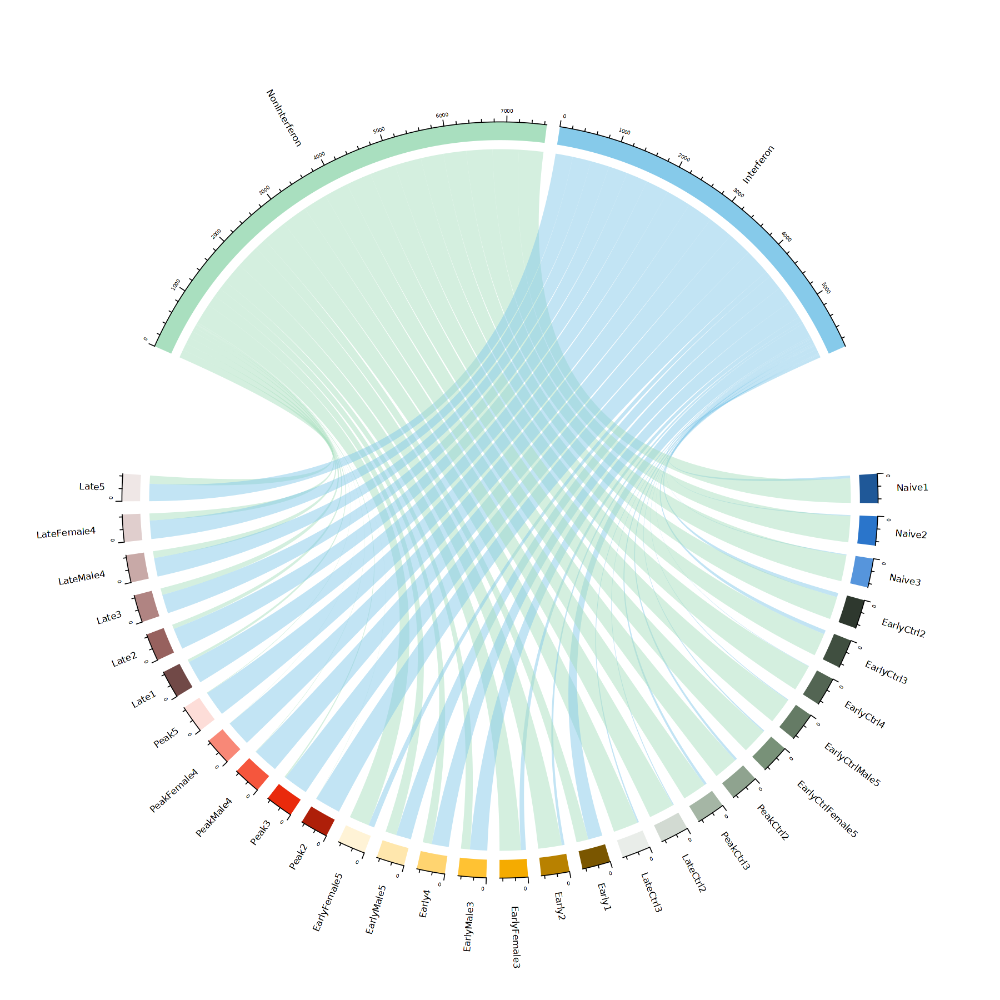

In [387]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$orig.ident))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_colors), names(interferon_colors)), link.zindex = rev(rank(mat)), grid.col=c(rev(interferon_colors),orig.ident_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [388]:
t <- table(Cluster=MORNAATACC$orig.ident_merge, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

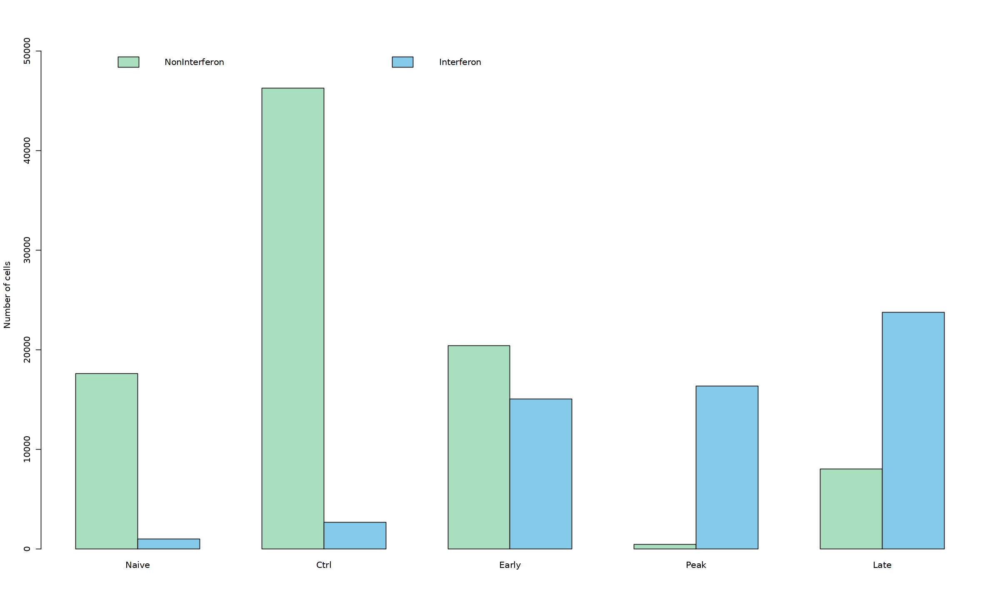

In [389]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+1200, 1000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

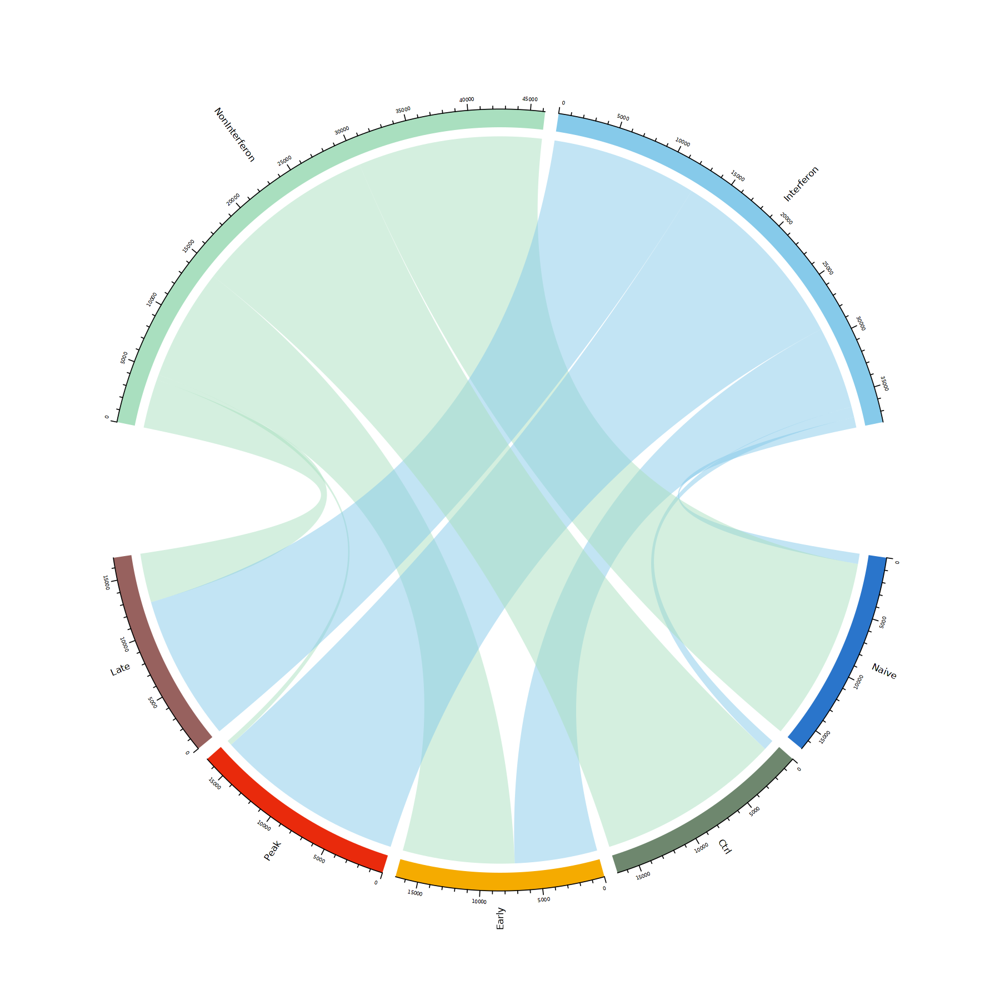

In [390]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$orig.ident_merge))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(interferon_colors)), link.zindex = rev(rank(mat)), grid.col=c(rev(interferon_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [391]:
t <- table(Cluster=MORNAATACC$model, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

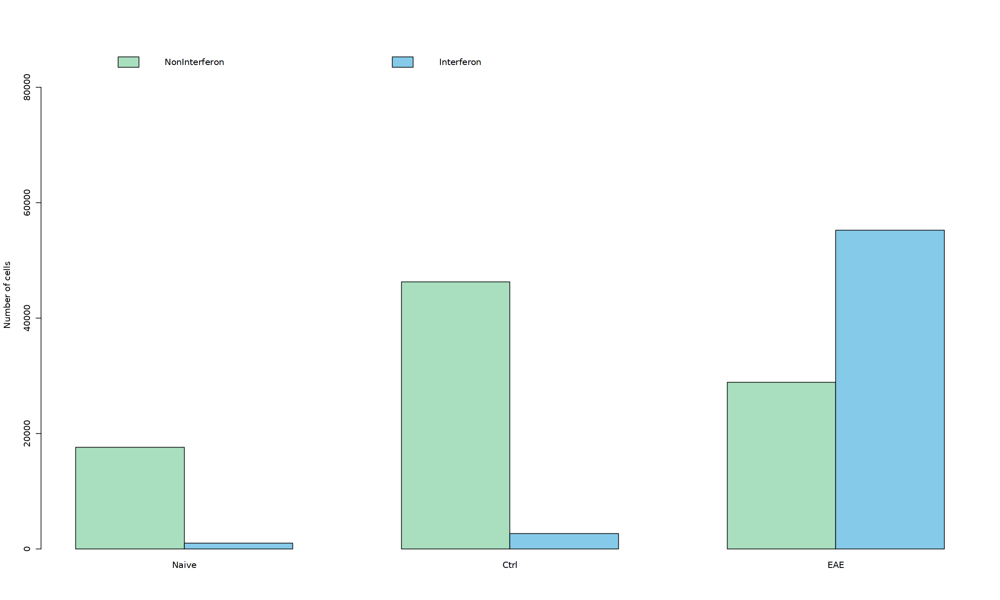

In [392]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+2000, 2000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

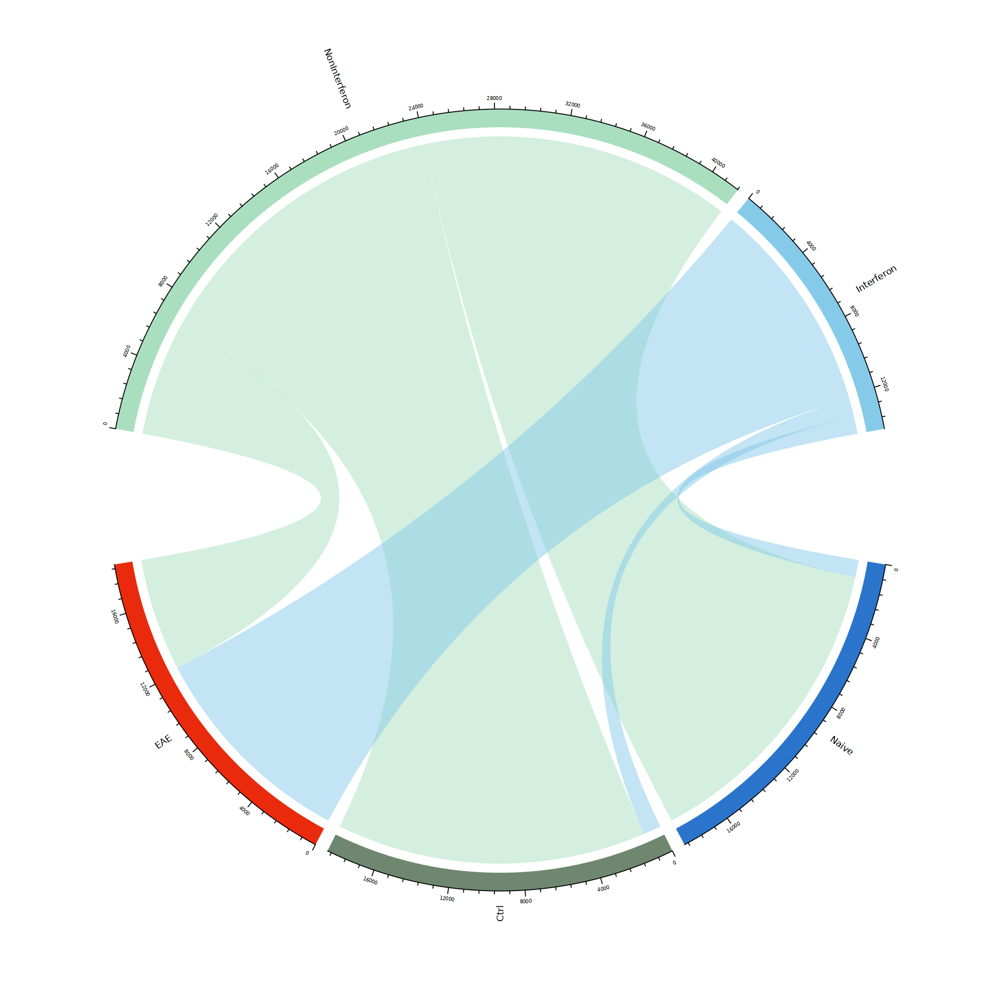

In [393]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$model))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(model_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),model_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [394]:
t <- table(Cluster=MORNAATACC$Sex, Batch=MORNAATACC@meta.data[["Interferon"]])
t <- t[,names(interferon_colors)]

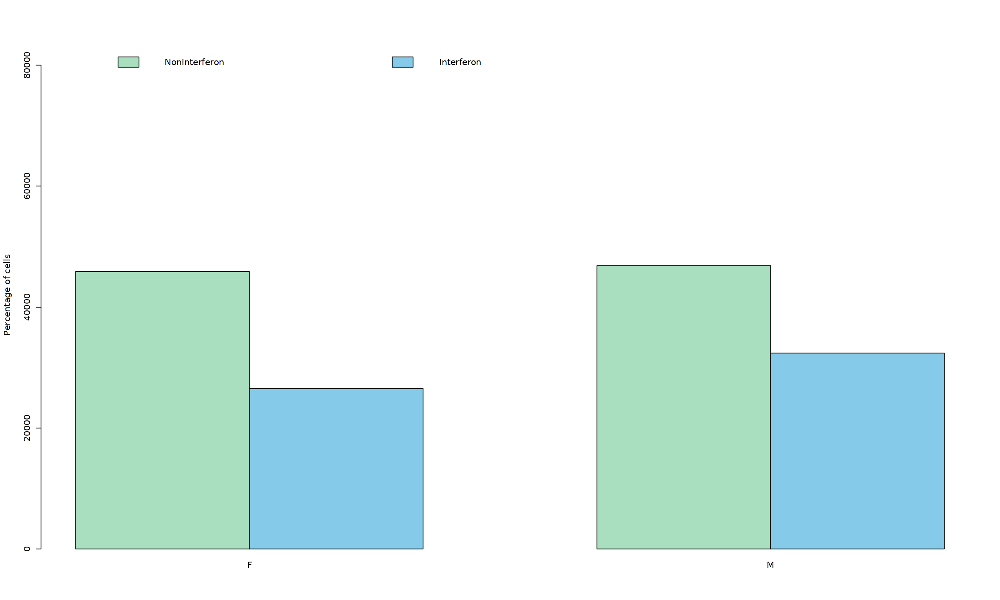

In [395]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+2500, 3000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

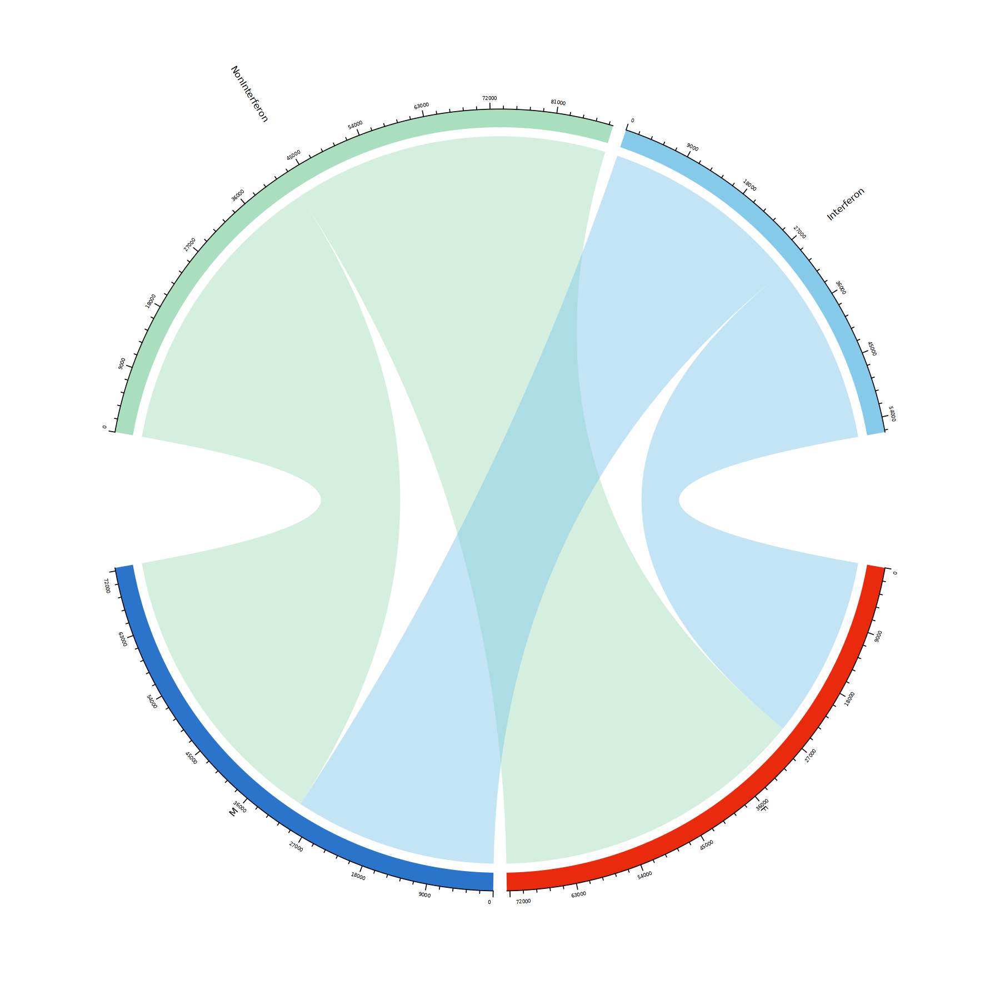

In [396]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Interferon, MORNAATACC@meta.data$Sex))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(sex_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),sex_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

### 4.2 Interferon ATAC

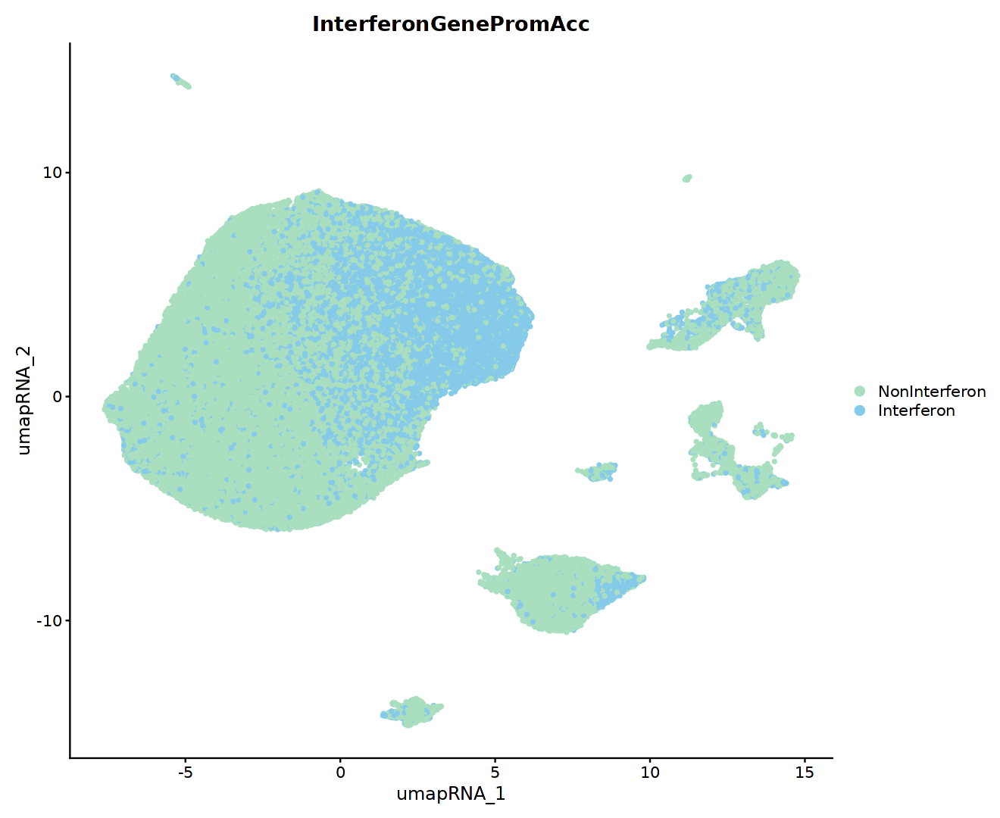

In [397]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="InterferonGenePromAcc", reduction="umap_RNA", shuffle=TRUE, cols = interferon_colors, pt.size=1, label=FALSE, raster=FALSE)

In [398]:
t <- table(Cluster=MORNAATACC$seurat_clusters_RNA, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

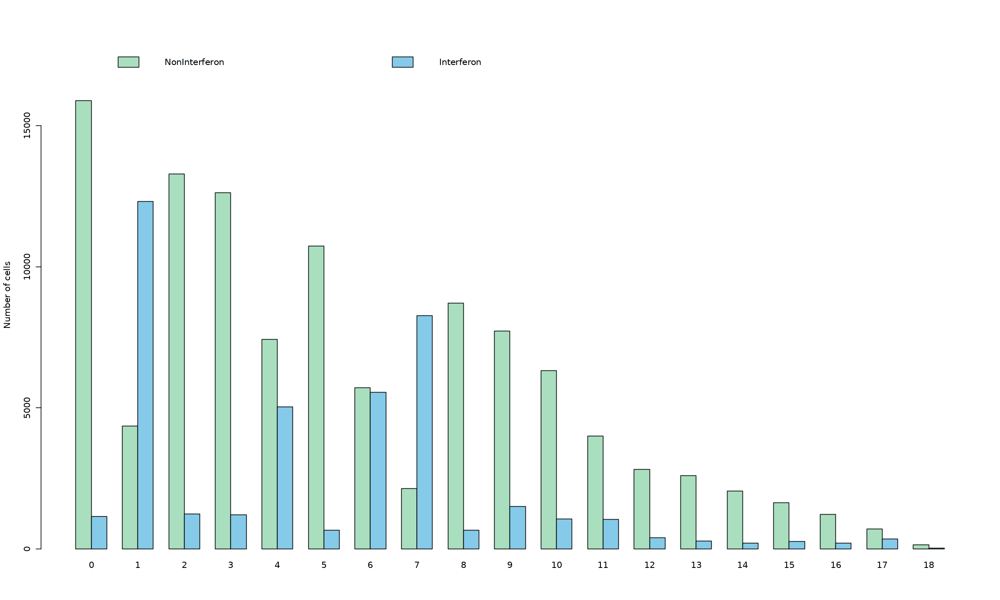

In [399]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

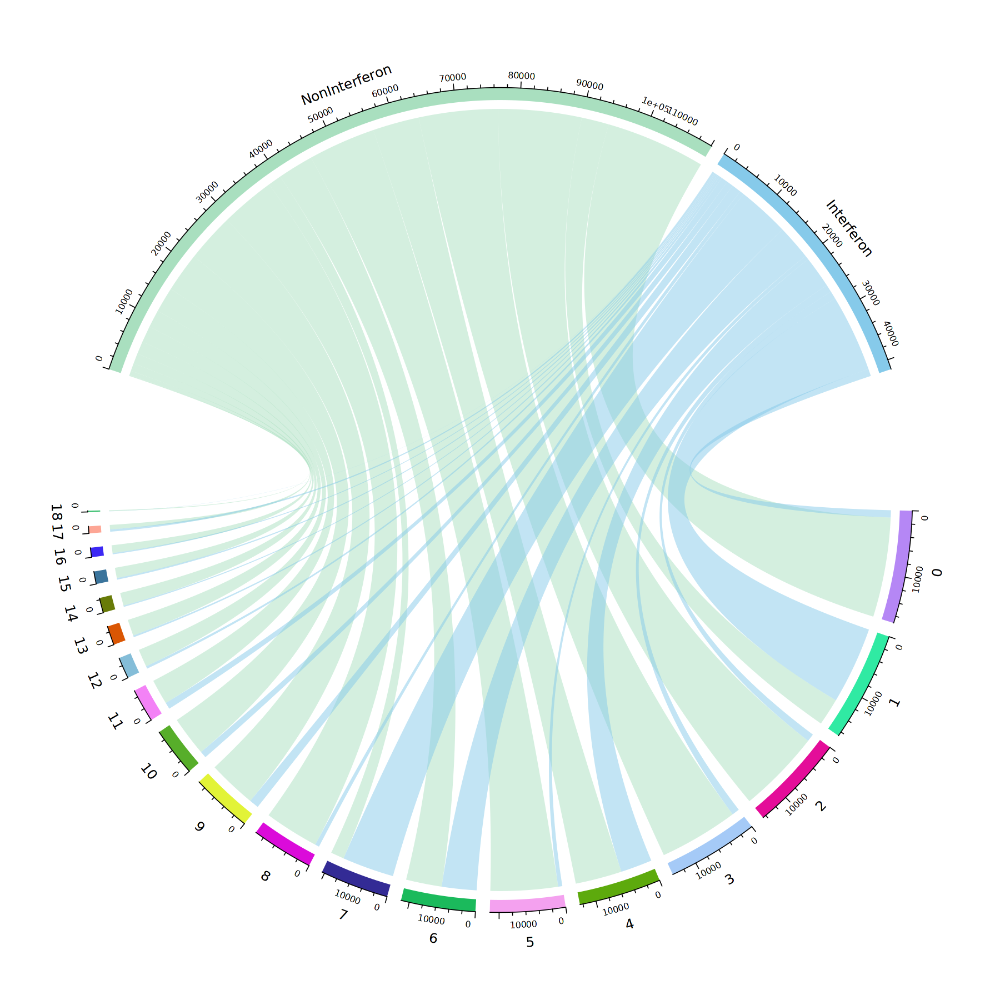

In [400]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$seurat_clusters_RNA))
circos.clear()
par(cex = 1.5)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(interferon_colors)), grid.col=rev(interferon_colors))

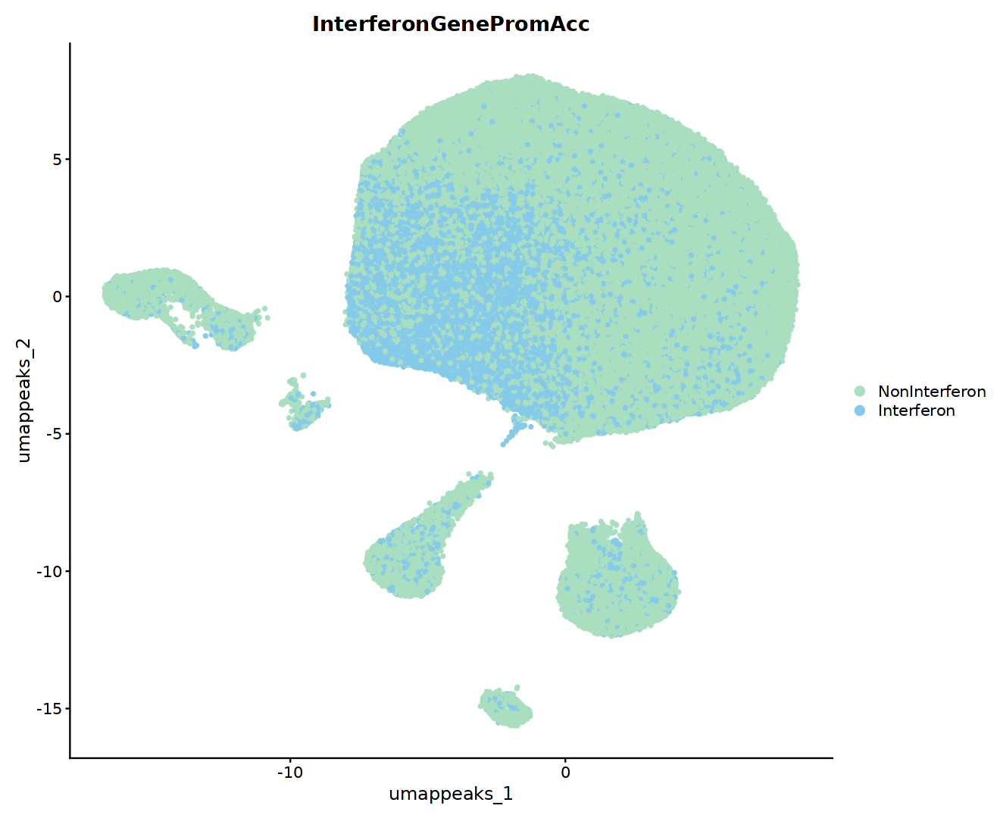

In [401]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="InterferonGenePromAcc", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols = interferon_colors, pt.size=1, label=FALSE, raster=FALSE)

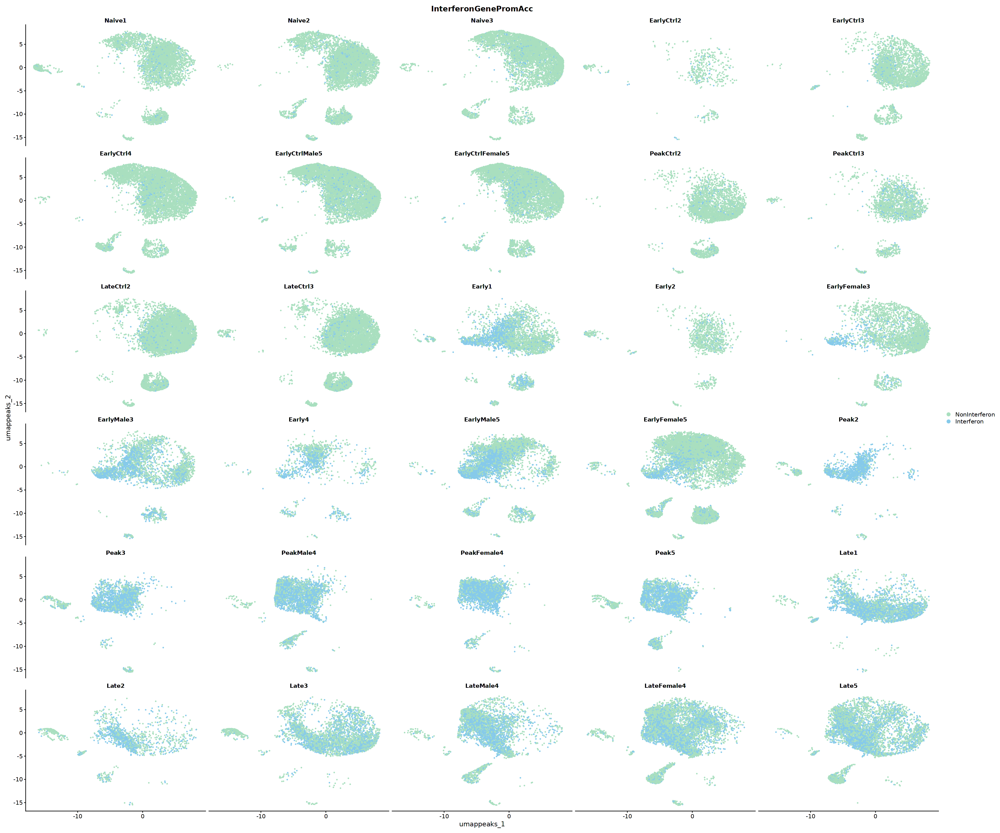

In [402]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="InterferonGenePromAcc", split.by="orig.ident", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols=interferon_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [403]:
t <- table(Cluster=MORNAATACC$seurat_clusters_peaks, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

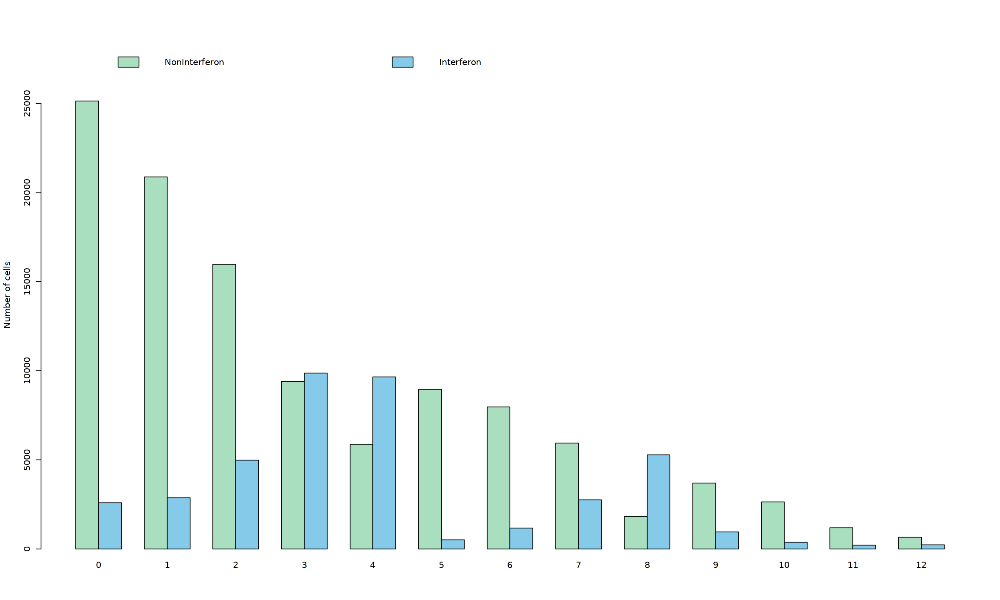

In [404]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

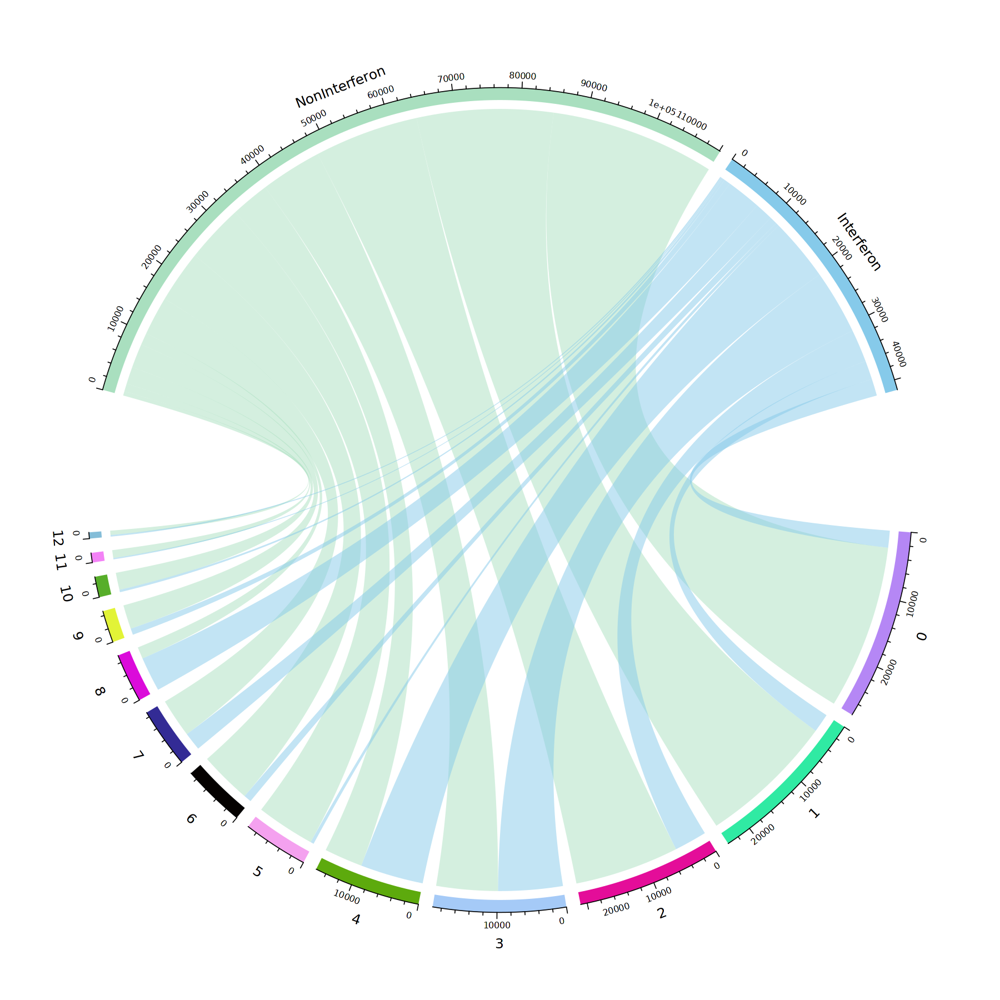

In [405]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$seurat_clusters_peaks))
circos.clear()
par(cex = 1.5)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(interferon_colors)), grid.col=rev(interferon_colors))

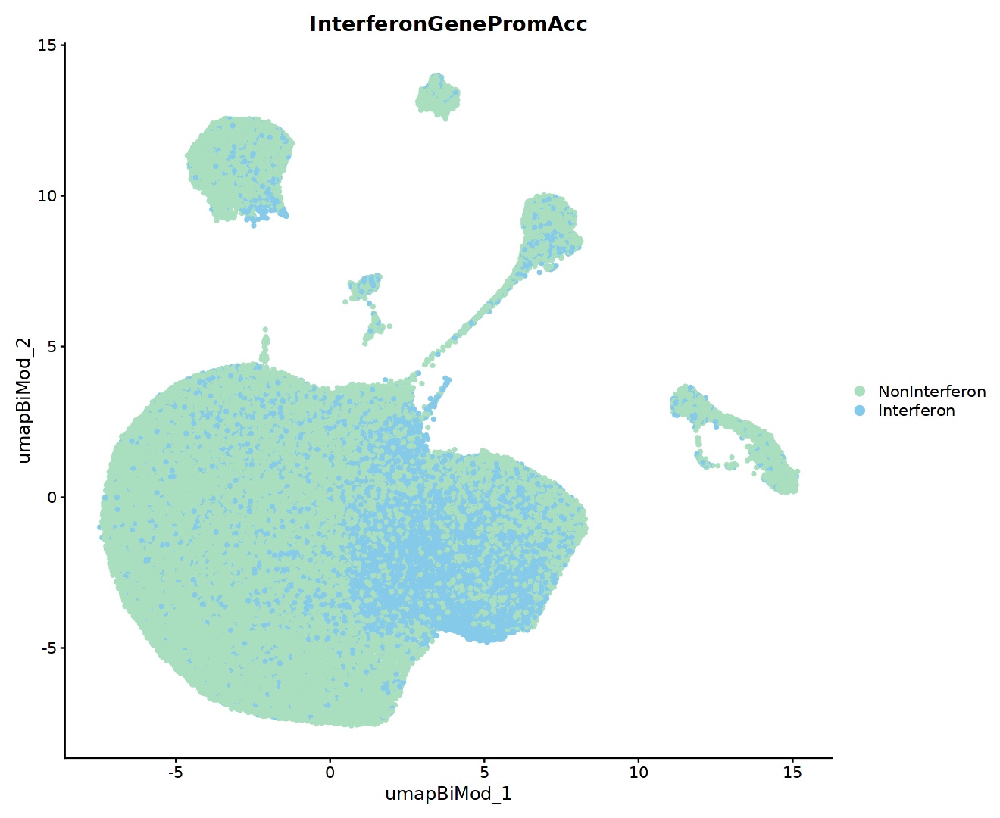

In [406]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="InterferonGenePromAcc", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols = interferon_colors, pt.size=1, label=FALSE, raster=FALSE)

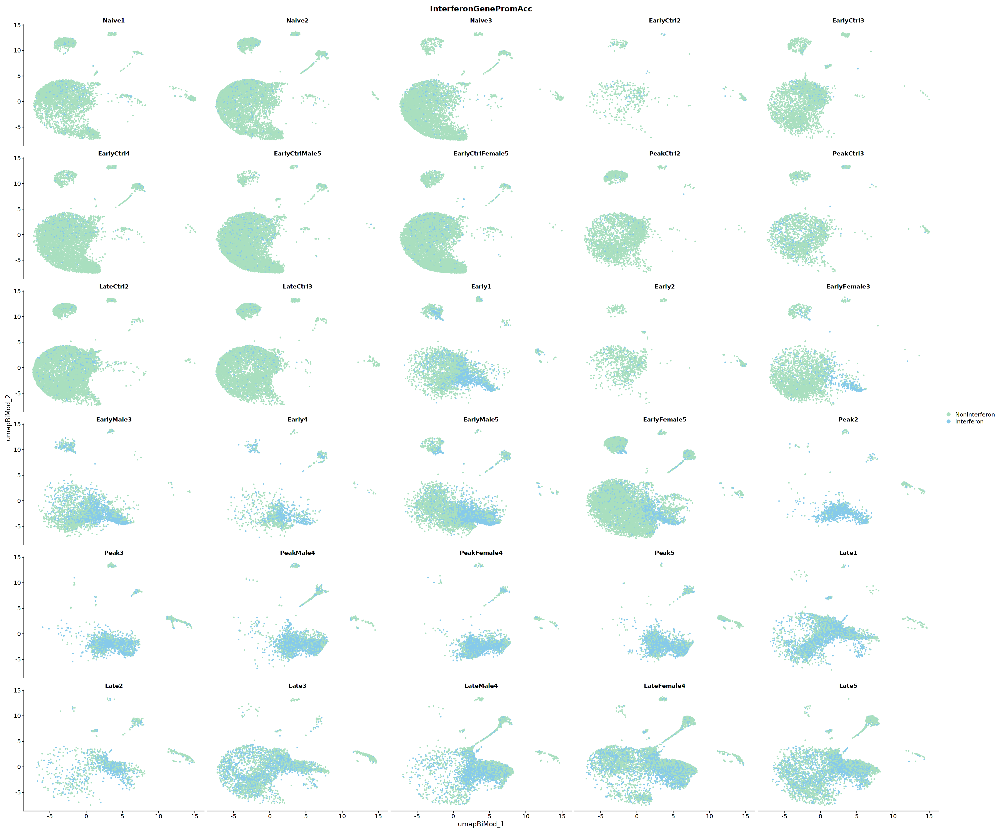

In [407]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="InterferonGenePromAcc", split.by="orig.ident", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=interferon_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [408]:
t <- table(Cluster=MORNAATACC$seurat_clusters_BiMod, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

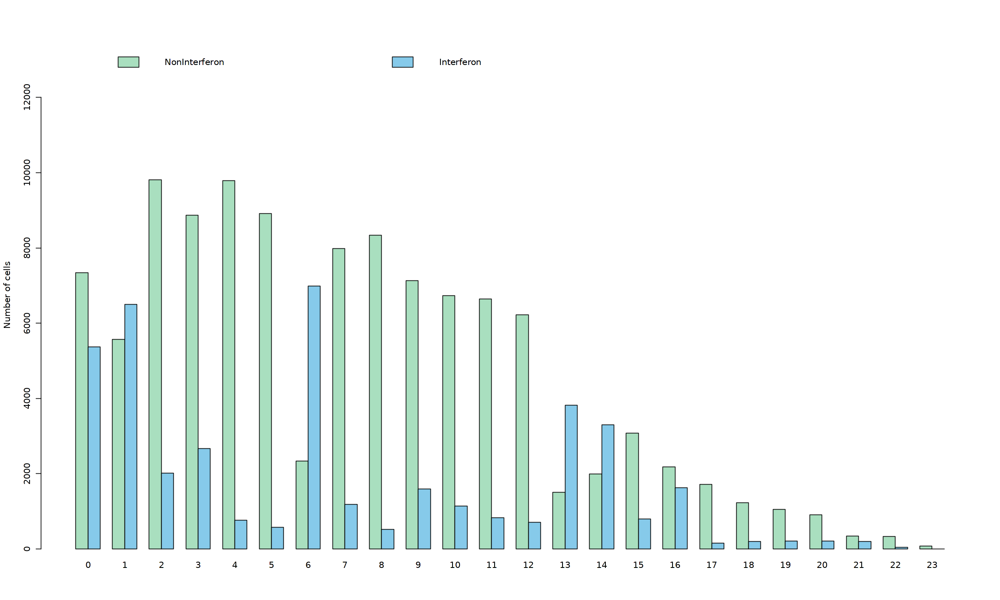

In [409]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

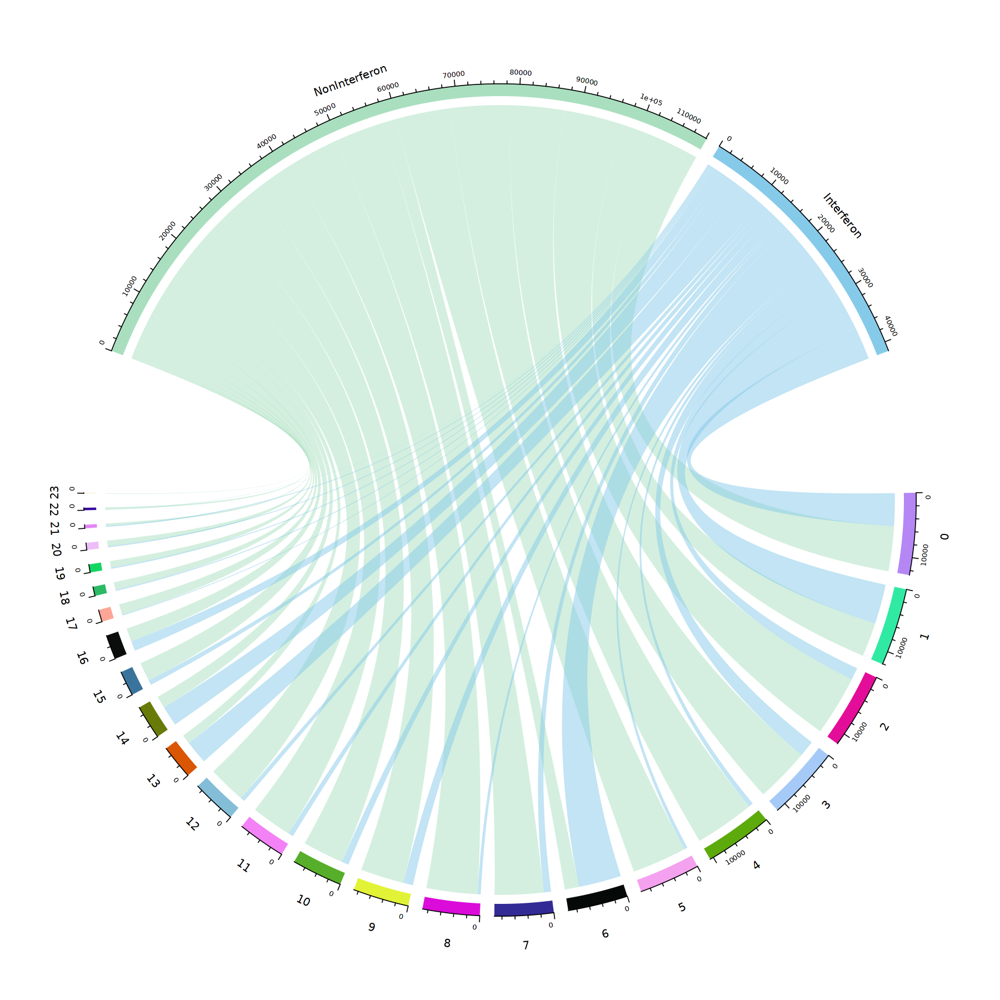

In [410]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$seurat_clusters_BiMod))
circos.clear()
par(cex = 1.2)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(interferon_colors)), grid.col=rev(interferon_colors))

In [411]:
t <- table(Cluster=MORNAATACC$cellType, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

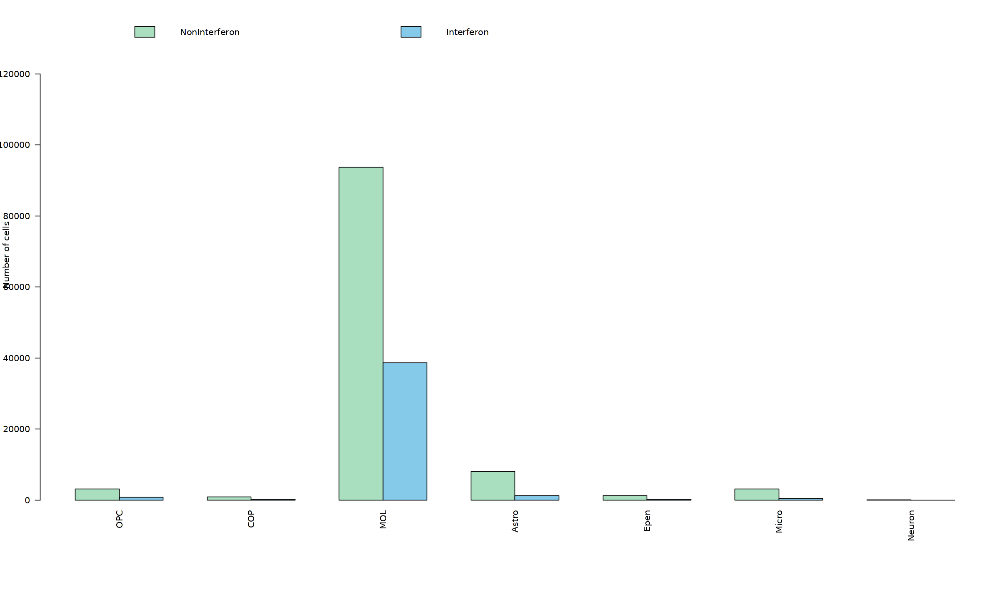

In [412]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+5000, 1000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

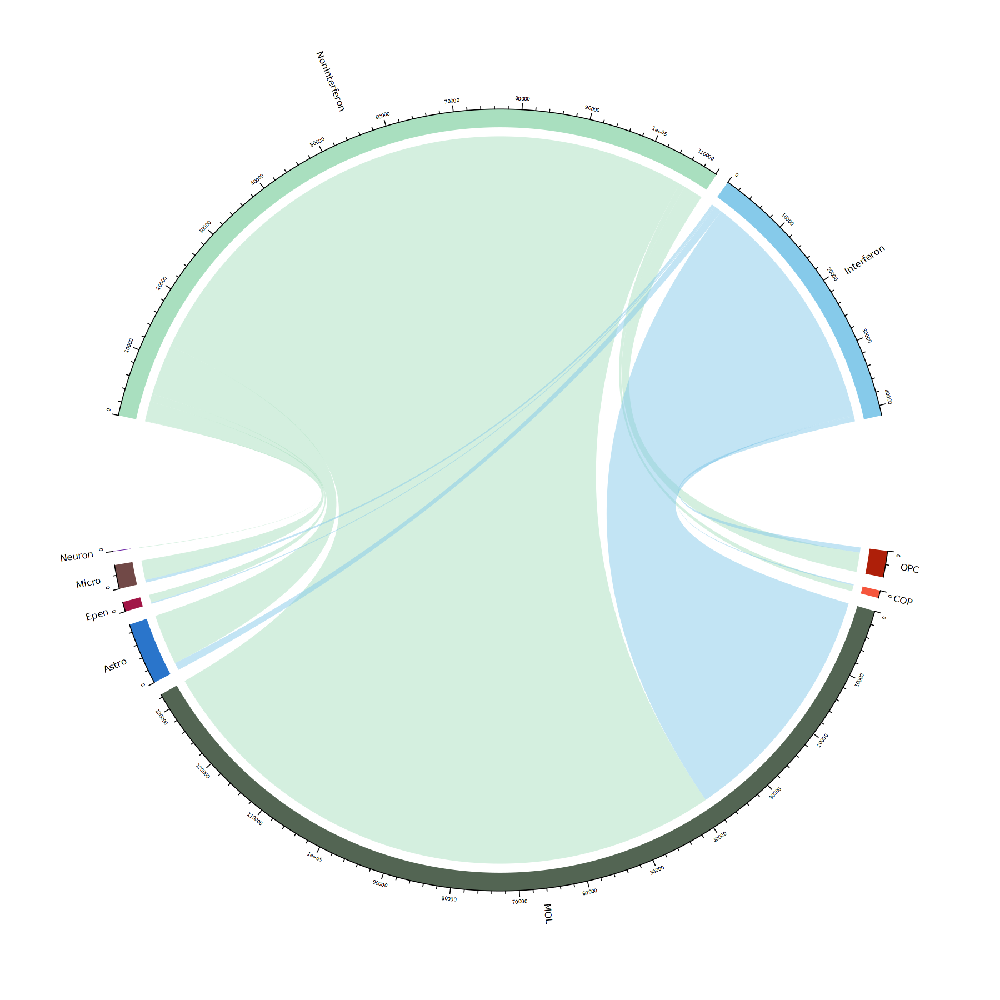

In [413]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$cellType))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(cellType_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),cellType_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [414]:
t <- table(Cluster=MORNAATACC$orig.ident, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

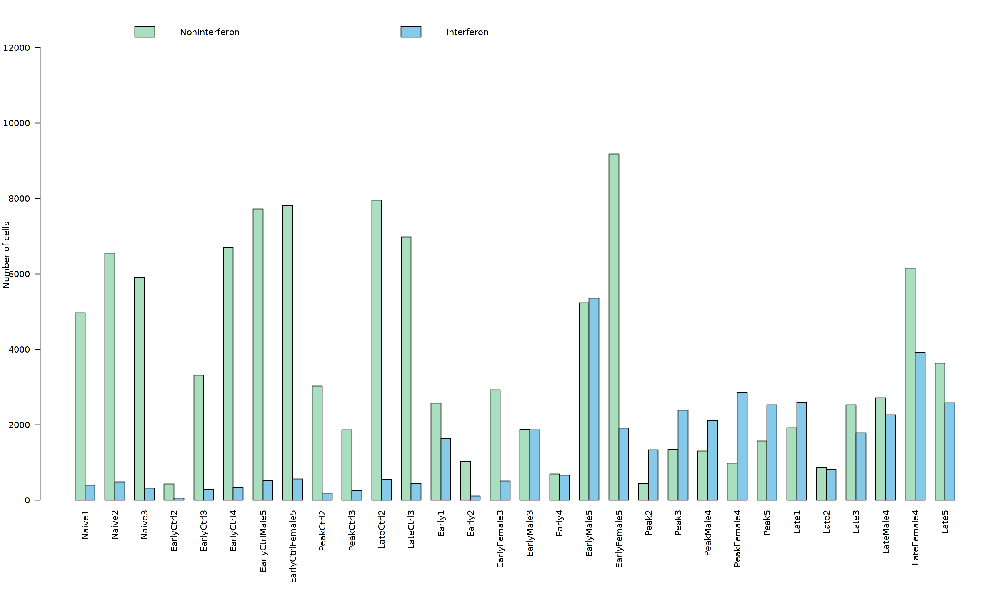

In [415]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+1200, 1000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

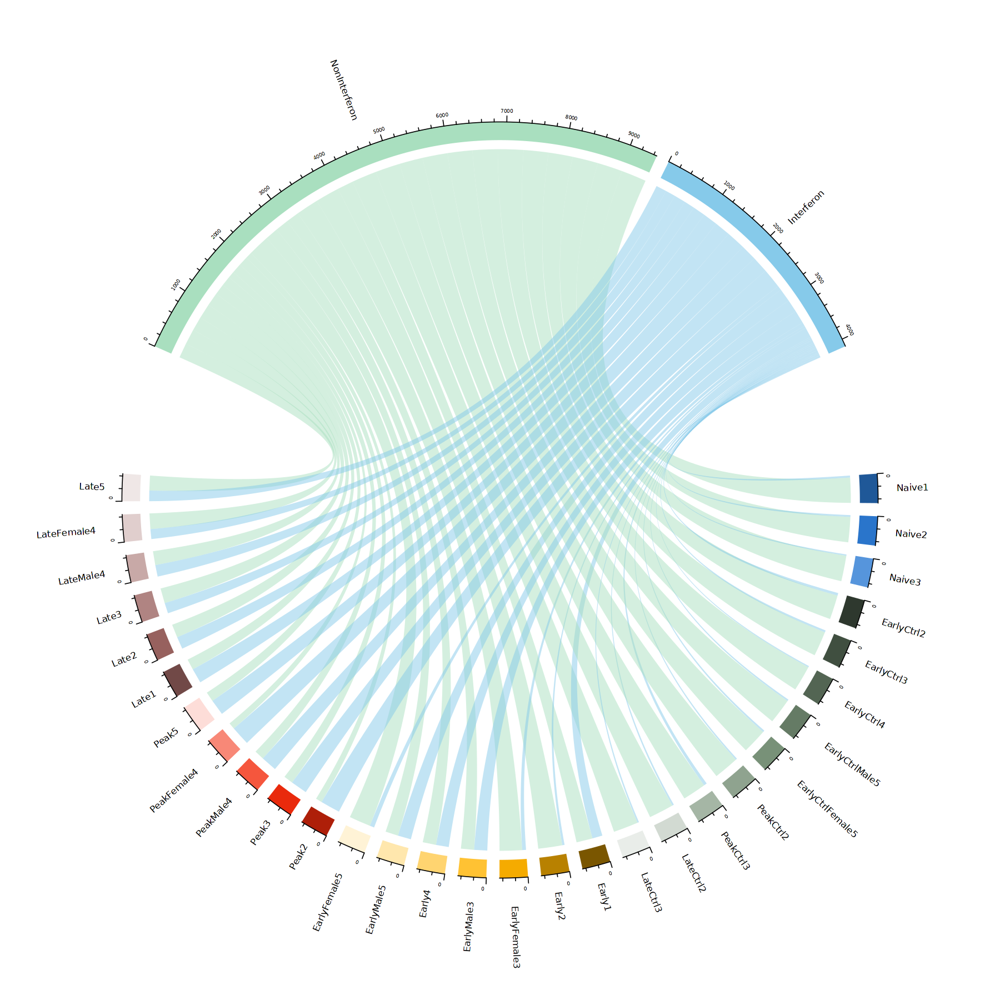

In [416]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$orig.ident))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_colors), names(interferon_colors)), link.zindex = rev(rank(mat)), grid.col=c(rev(interferon_colors),orig.ident_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [417]:
t <- table(Cluster=MORNAATACC$orig.ident_merge, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

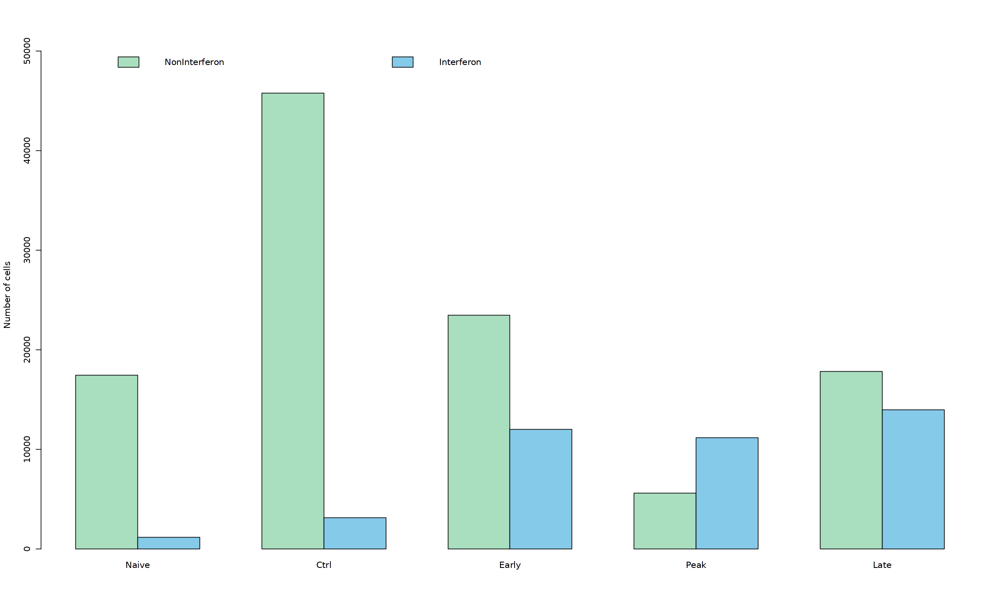

In [418]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+1200, 1000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

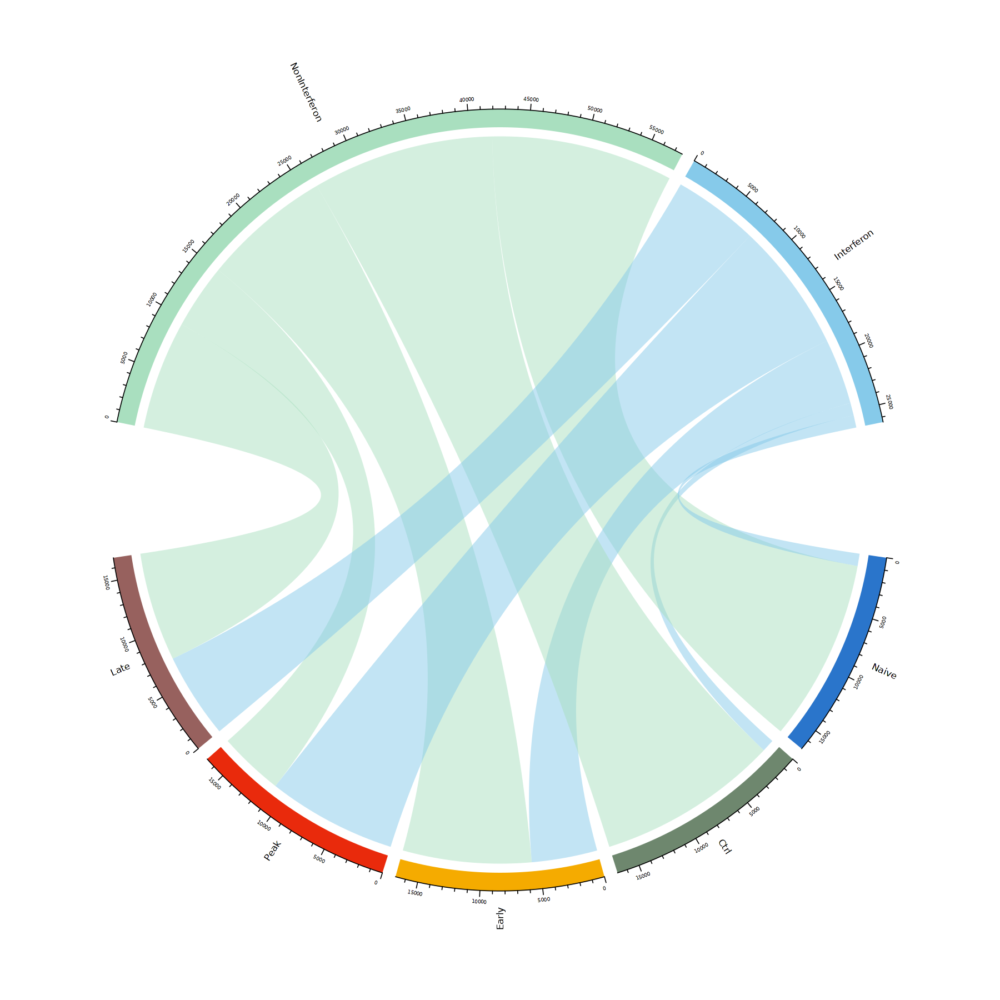

In [419]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$orig.ident_merge))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(interferon_colors)), link.zindex = rev(rank(mat)), grid.col=c(rev(interferon_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [420]:
t <- table(Cluster=MORNAATACC$model, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

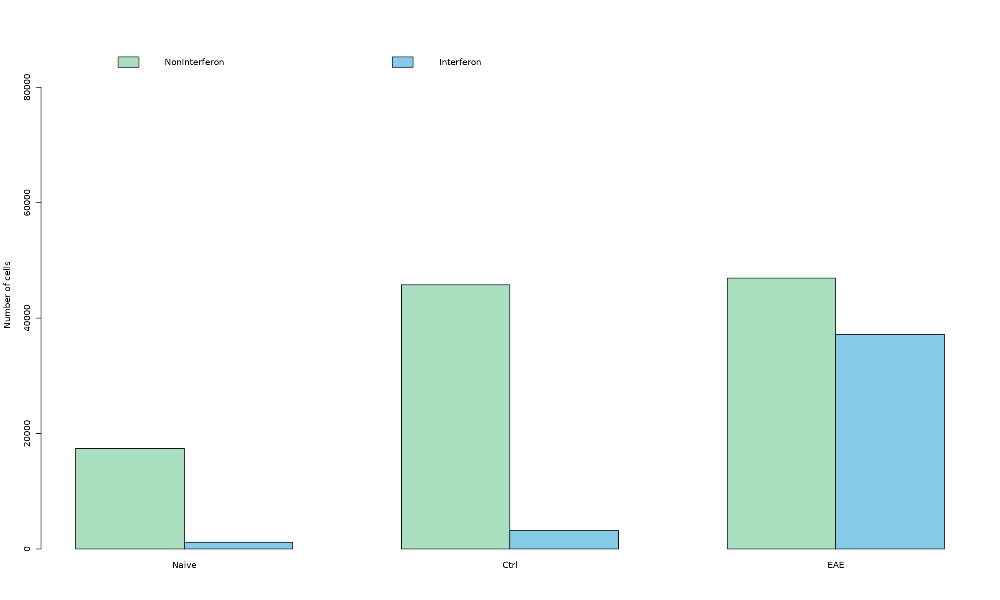

In [421]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+2000, 2000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

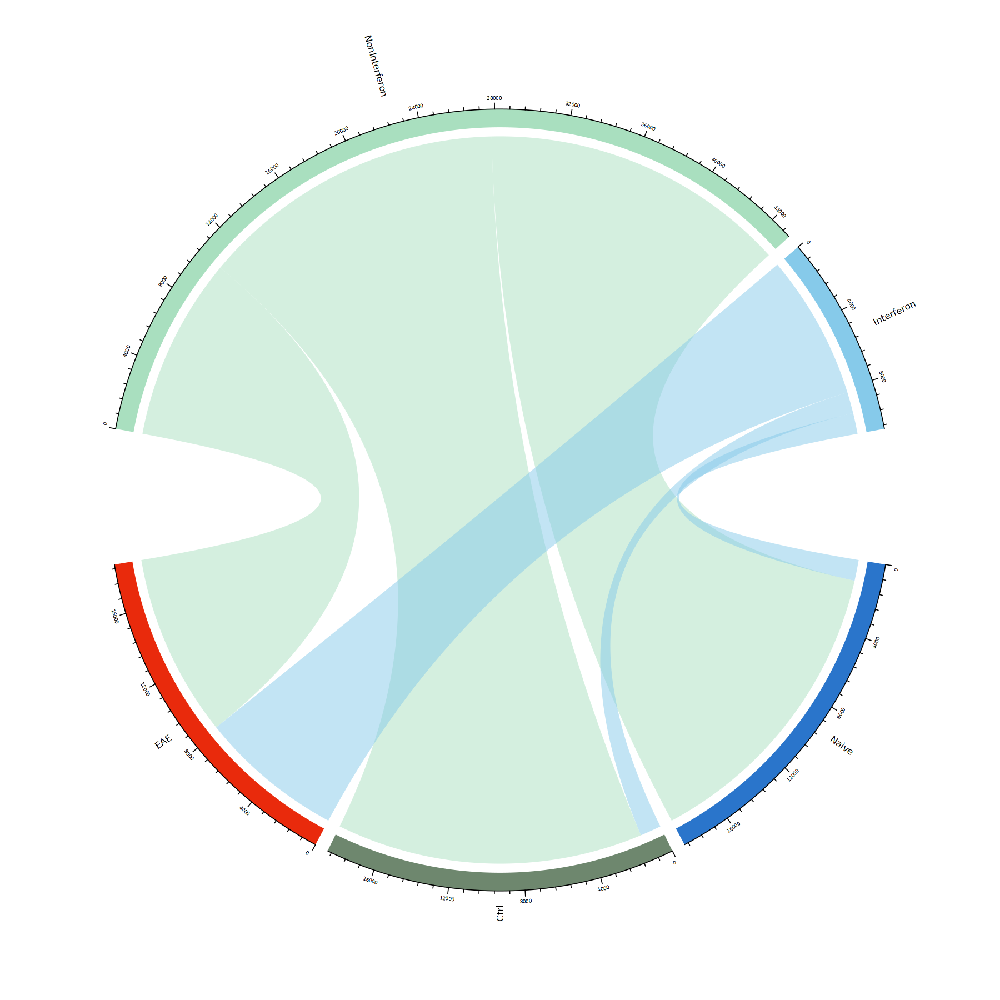

In [422]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$model))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(model_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),model_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [423]:
t <- table(Cluster=MORNAATACC$Sex, Batch=MORNAATACC@meta.data[["InterferonGenePromAcc"]])
t <- t[,names(interferon_colors)]

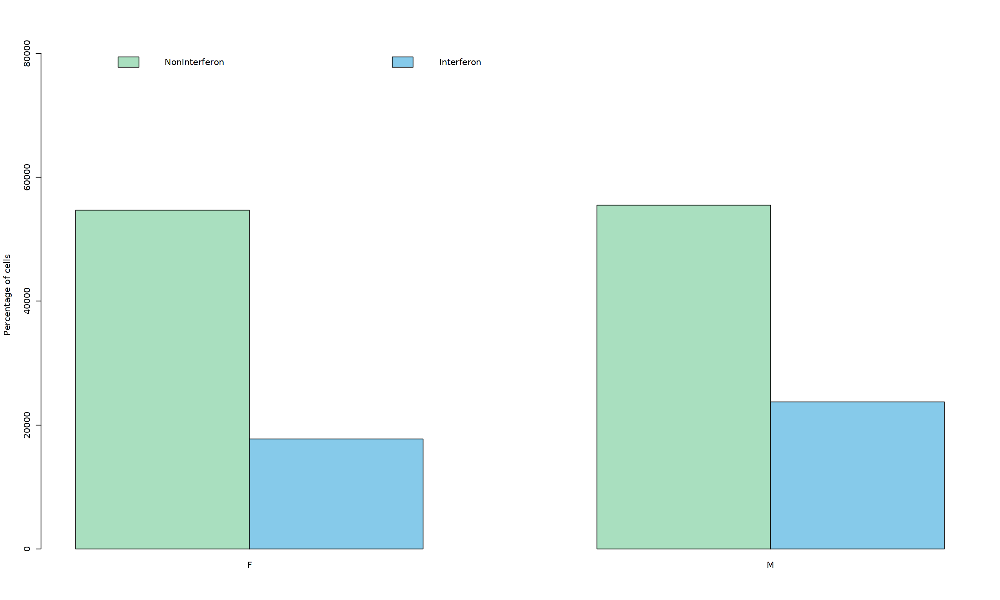

In [424]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+2000, 2000, f = ceiling)), col = interferon_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

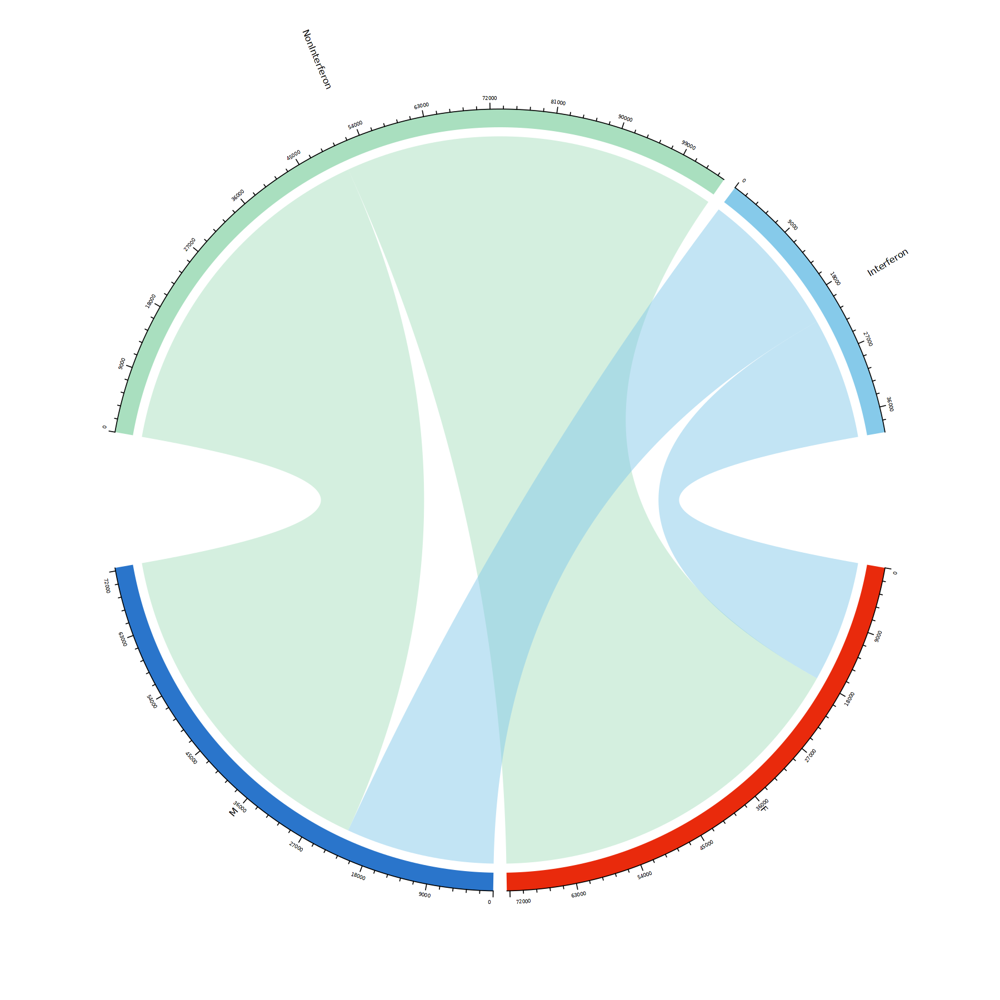

In [425]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonGenePromAcc, MORNAATACC@meta.data$Sex))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(sex_colors), names(interferon_colors)), grid.col=c(rev(interferon_colors),sex_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

### 6.3 Interferon RNA+ATAC

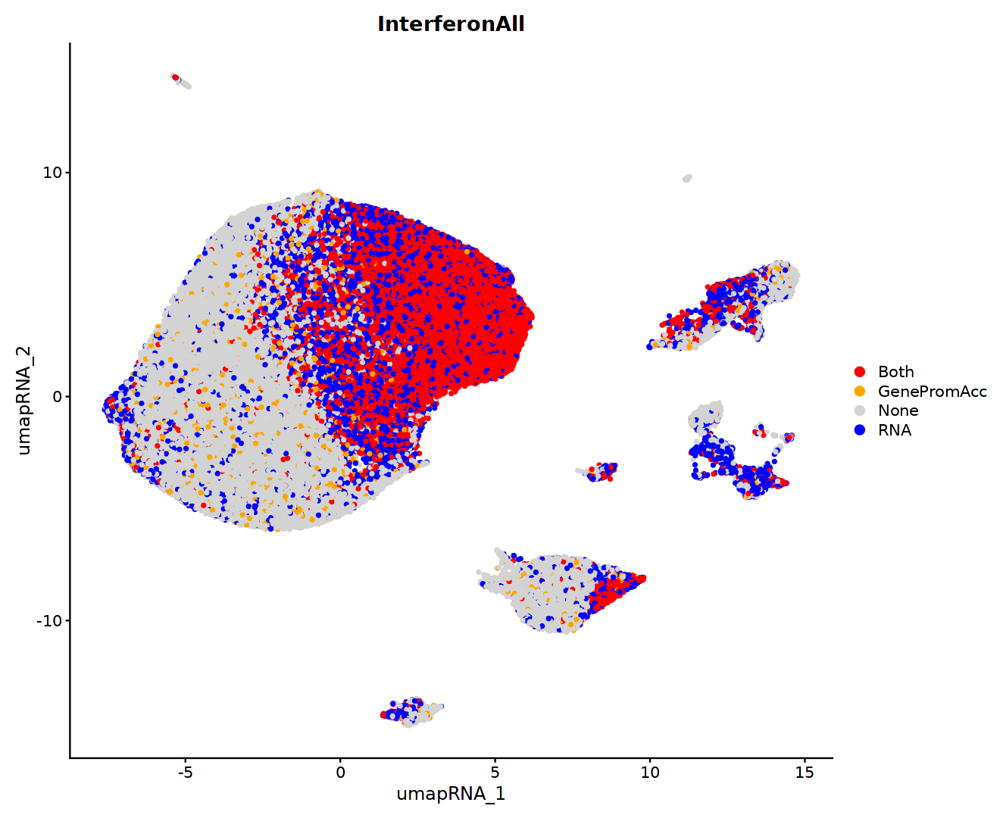

In [426]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="InterferonAll", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols = modality_colors, pt.size=1, label=FALSE, raster=FALSE)

In [427]:
t <- table(Cluster=MORNAATACC$seurat_clusters_RNA, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

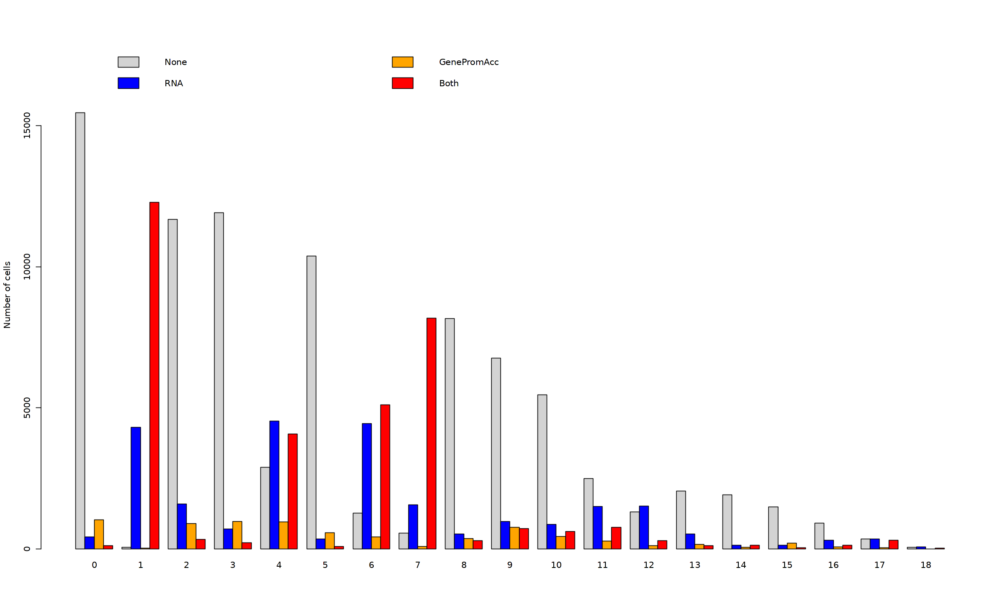

In [428]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

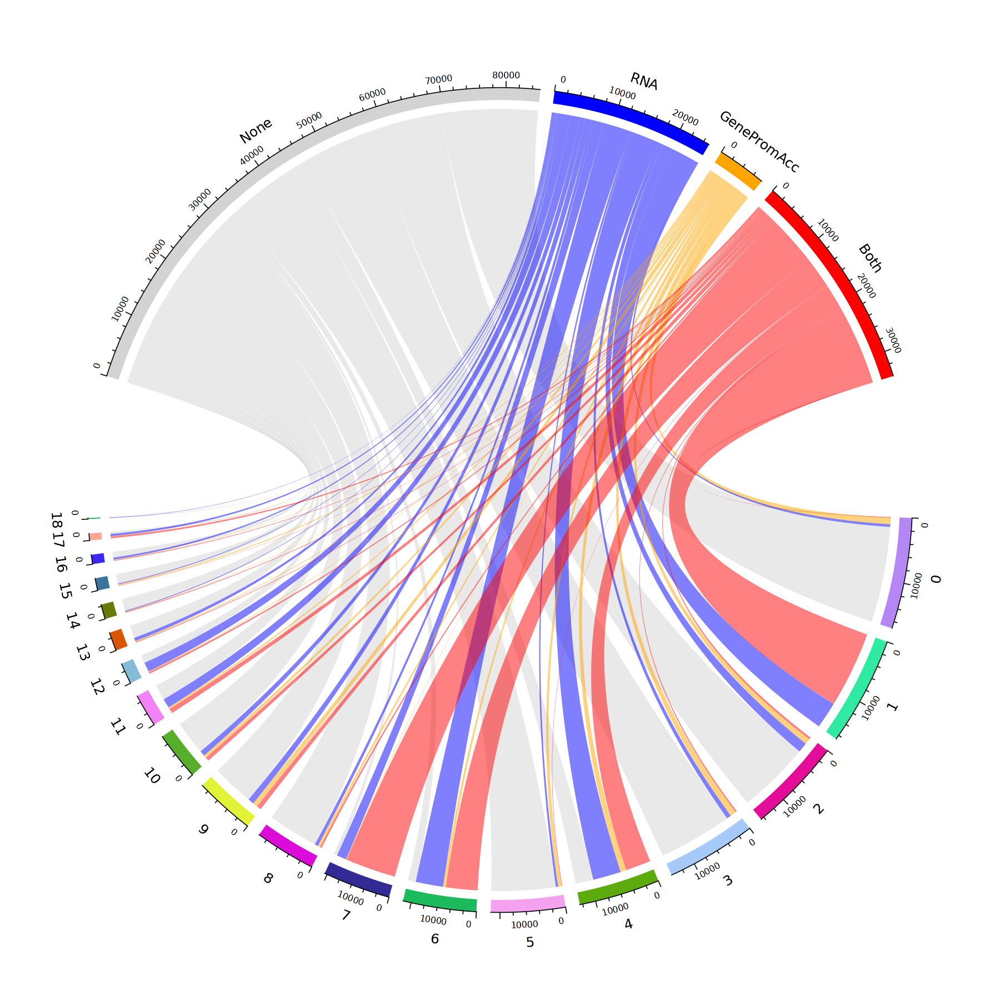

In [429]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$seurat_clusters_RNA))
circos.clear()
par(cex = 1.5)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(modality_colors)), grid.col=rev(modality_colors))

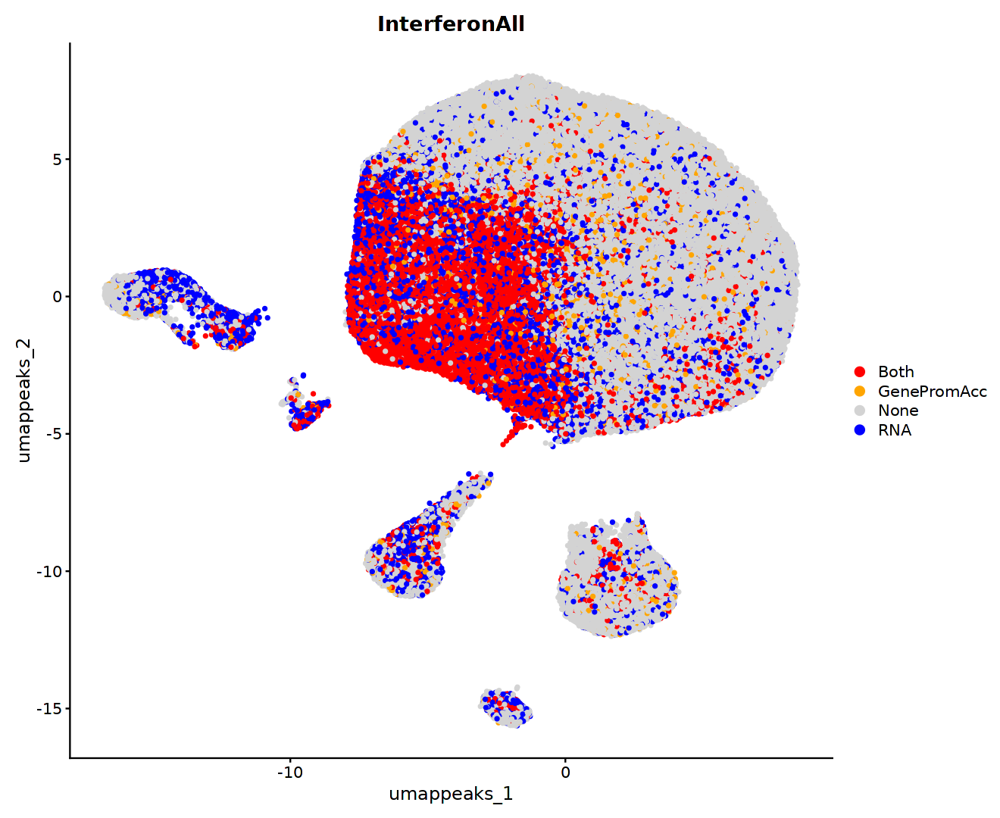

In [430]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="InterferonAll", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols = modality_colors, pt.size=1, label=FALSE, raster=FALSE)

In [431]:
t <- table(Cluster=MORNAATACC$seurat_clusters_peaks, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

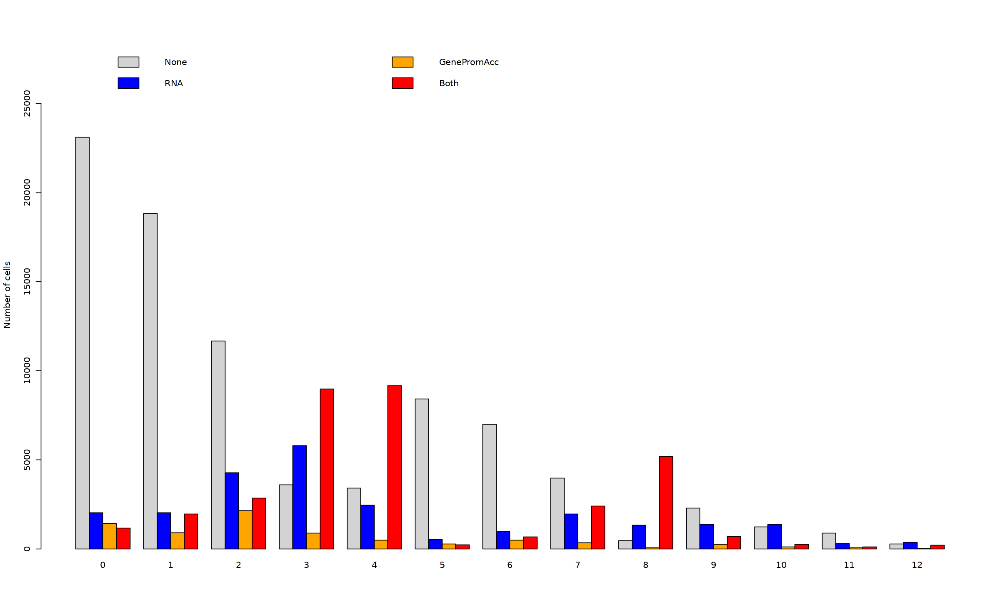

In [432]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

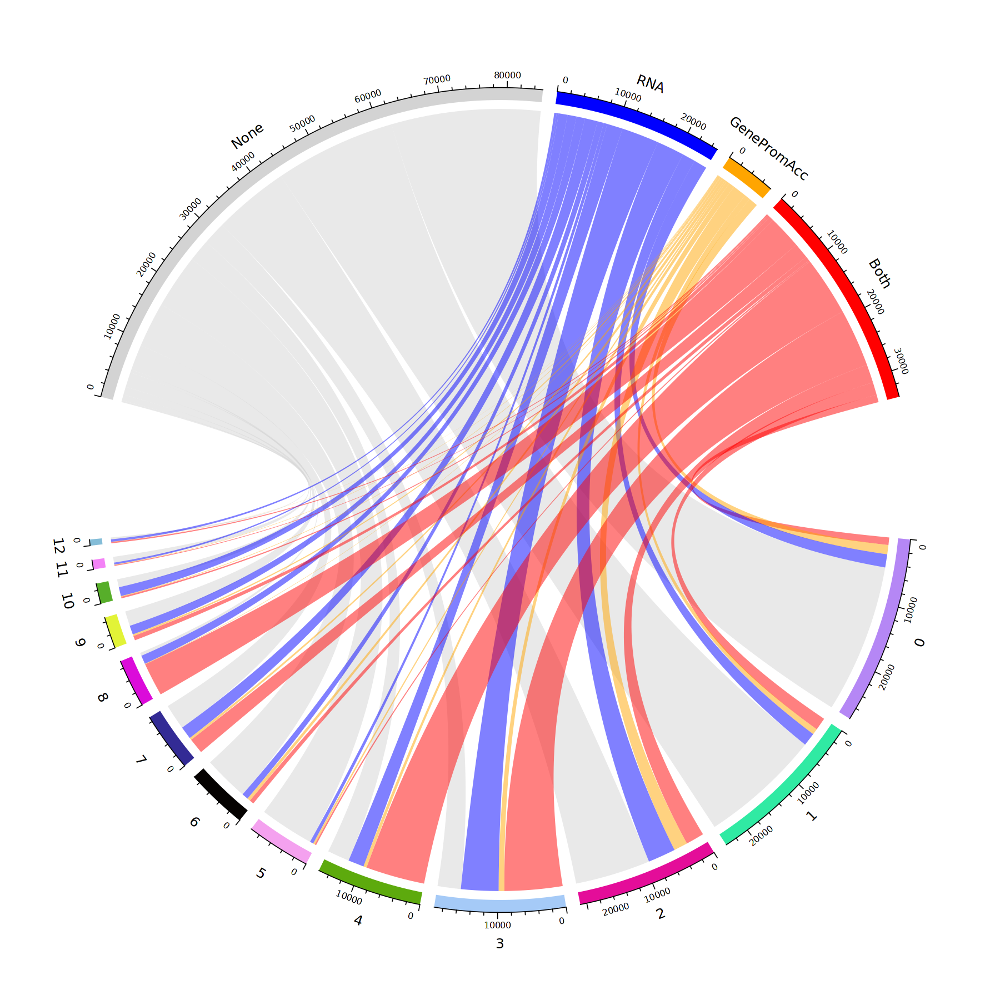

In [433]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$seurat_clusters_peaks))
circos.clear()
par(cex = 1.5)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(modality_colors)), grid.col=rev(modality_colors))

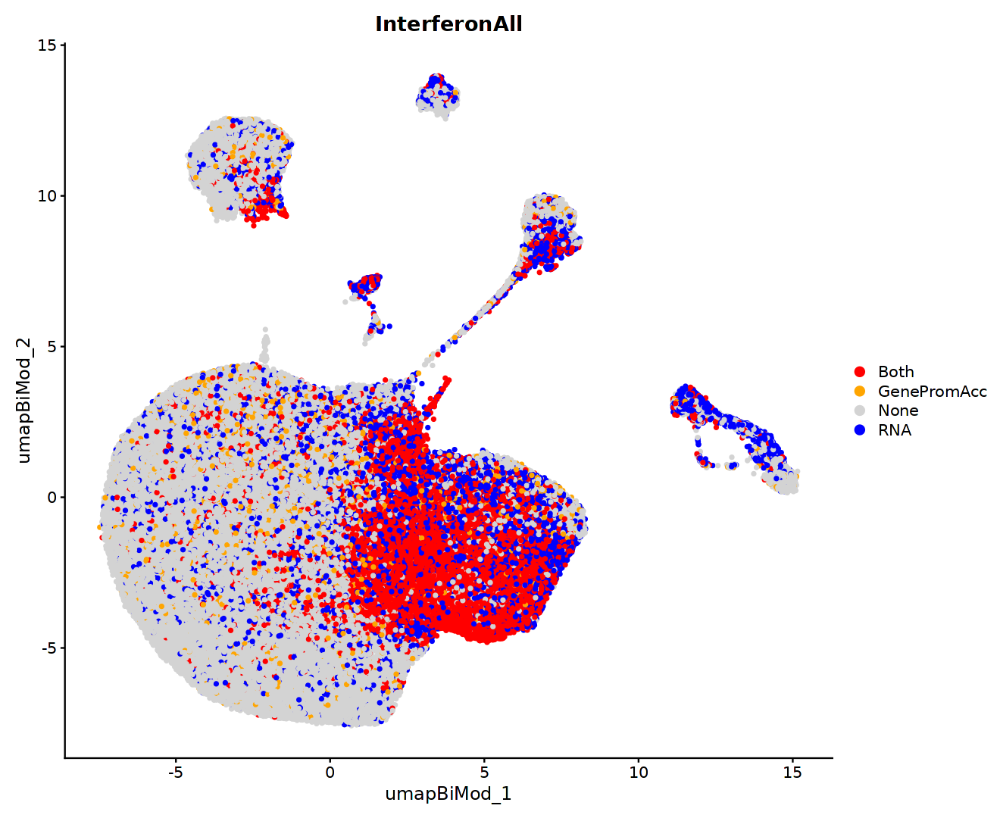

In [434]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="InterferonAll", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols = modality_colors, pt.size=1, label=FALSE, raster=FALSE)

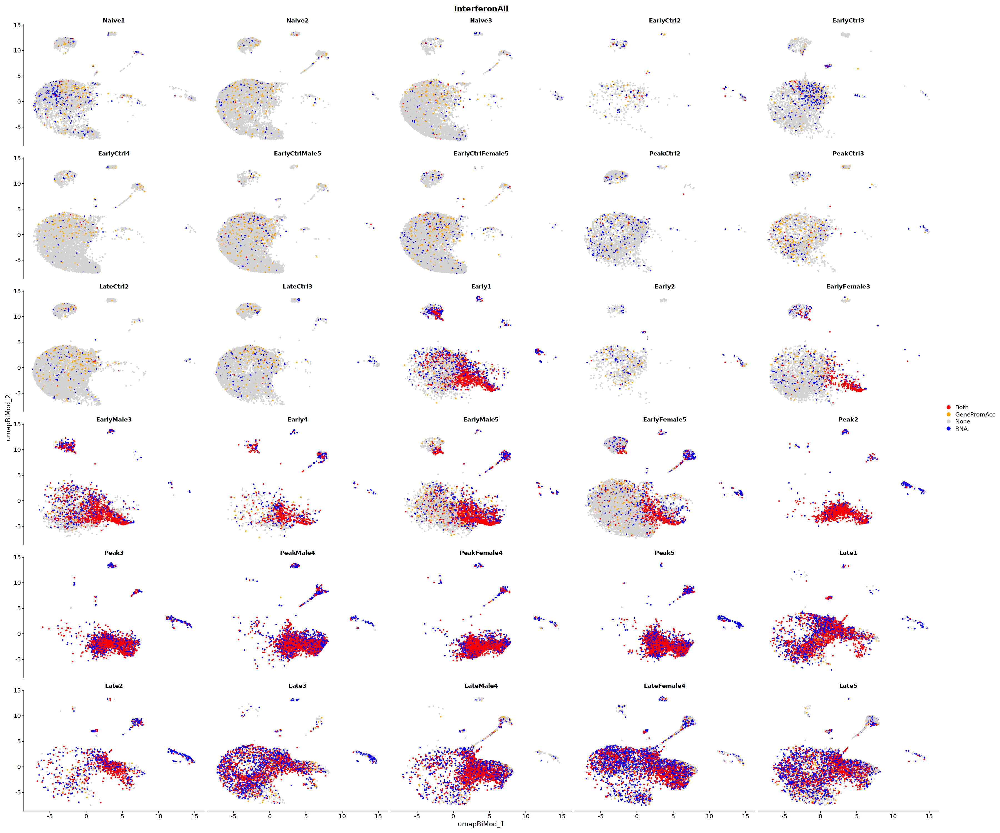

In [435]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="InterferonAll", split.by="orig.ident", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=modality_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [436]:
t <- table(Cluster=MORNAATACC$seurat_clusters_BiMod, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

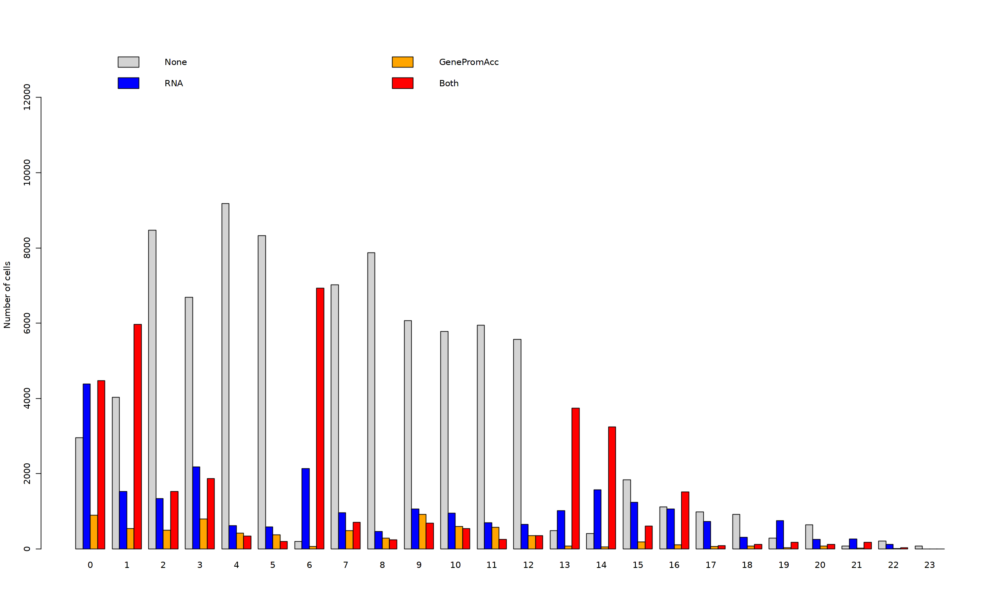

In [437]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+500, 500, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

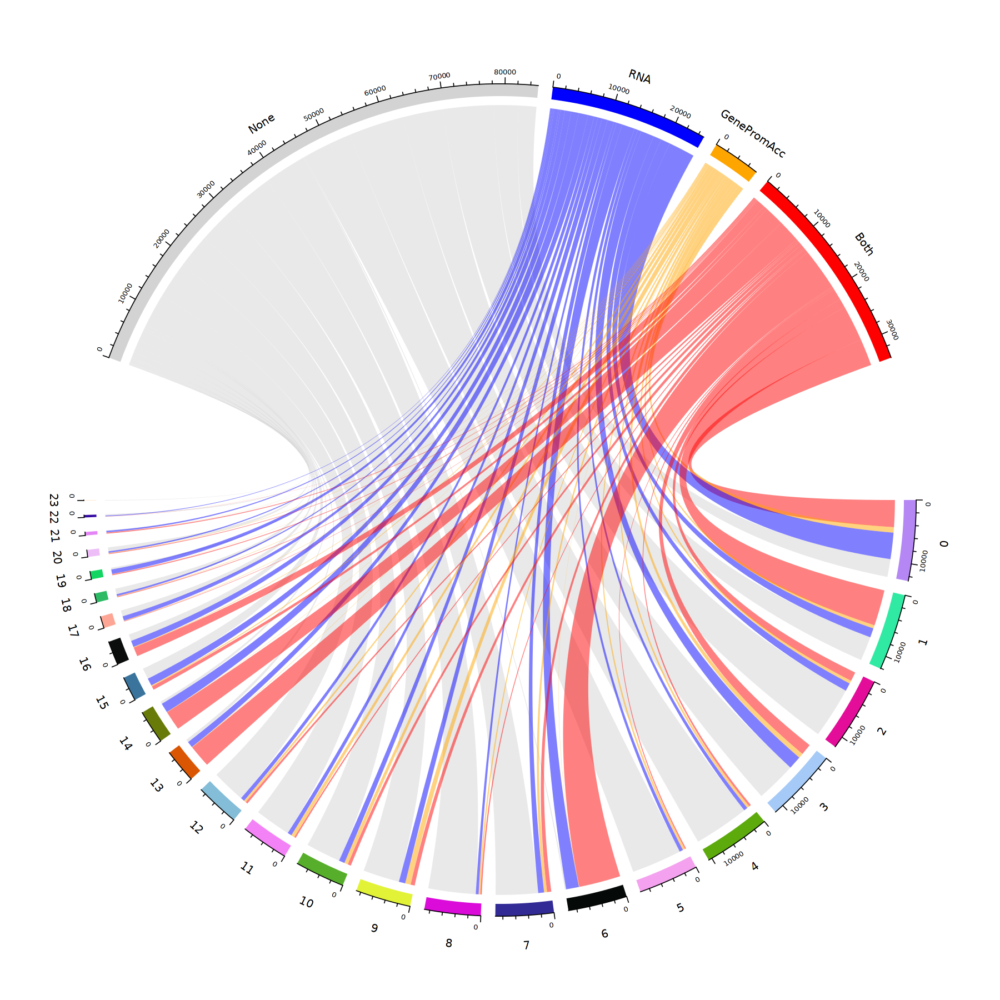

In [438]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$seurat_clusters_BiMod))
circos.clear()
par(cex = 1.2)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(modality_colors)), grid.col=rev(modality_colors))

In [439]:
t <- table(Cluster=MORNAATACC$cellType, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

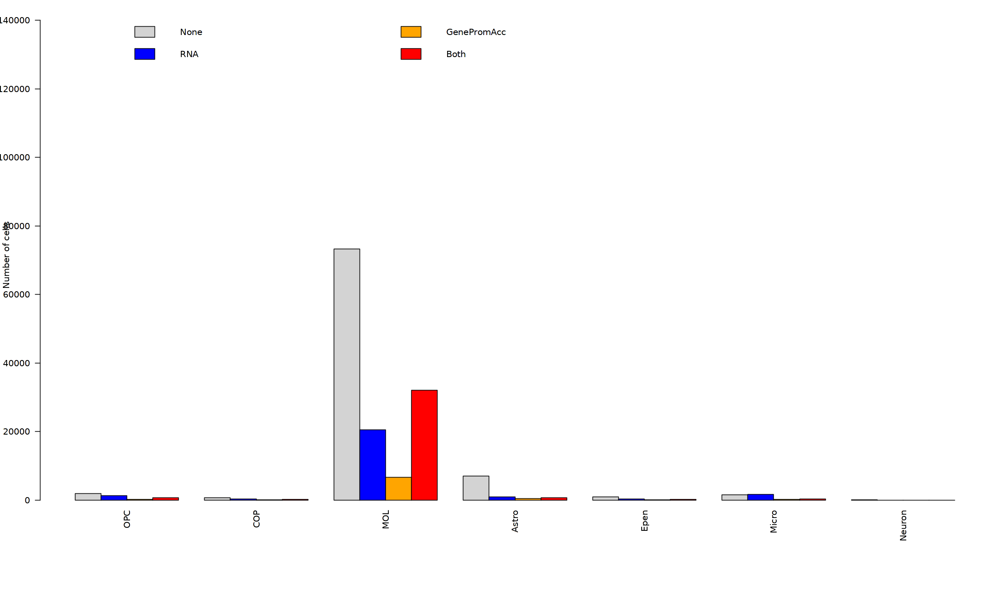

In [440]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+10000, 1000, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

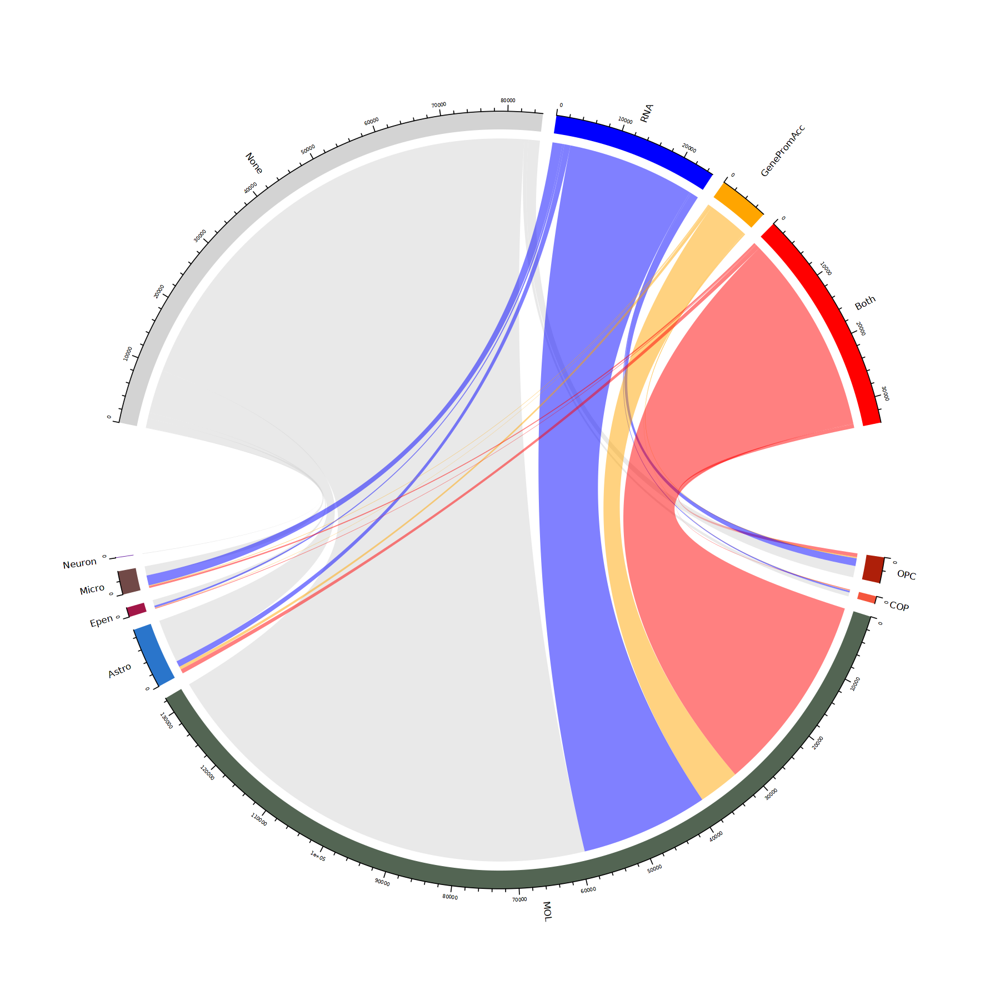

In [441]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$cellType))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(cellType_colors), names(modality_colors)), grid.col=c(rev(modality_colors),cellType_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [442]:
t <- table(Cluster=MORNAATACC$orig.ident, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

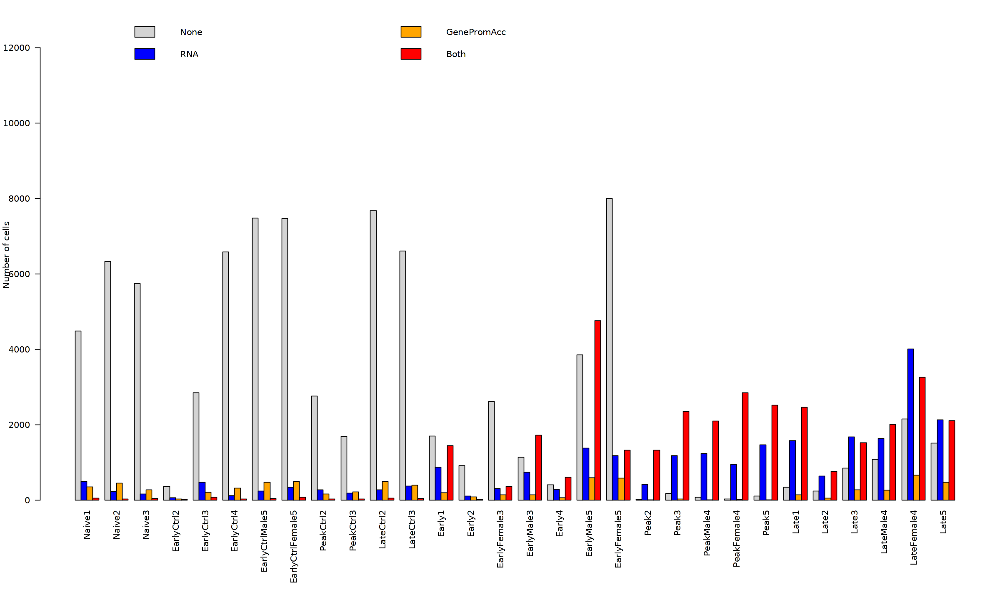

In [443]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+1200, 1000, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

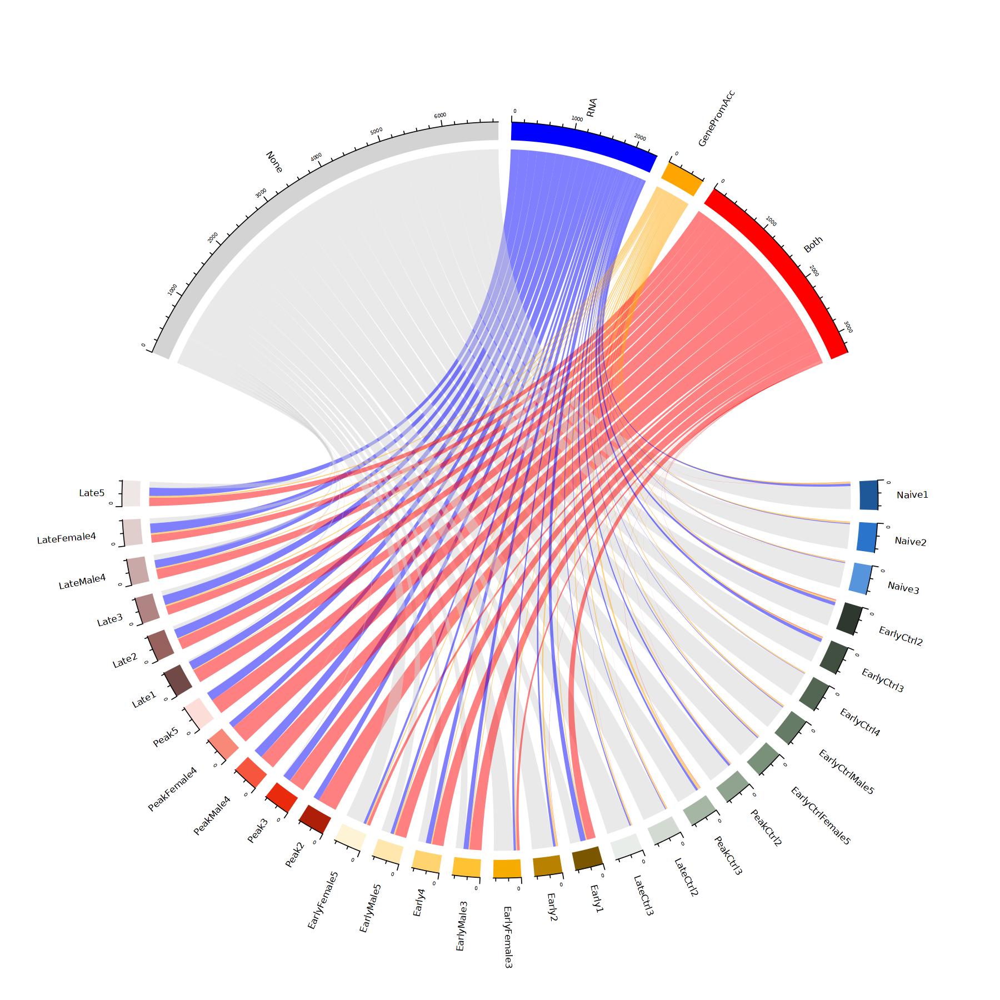

In [444]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$orig.ident))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_colors), names(modality_colors)), link.zindex = rev(rank(mat)), grid.col=c(rev(modality_colors),orig.ident_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [445]:
t <- table(Cluster=MORNAATACC$orig.ident_merge, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

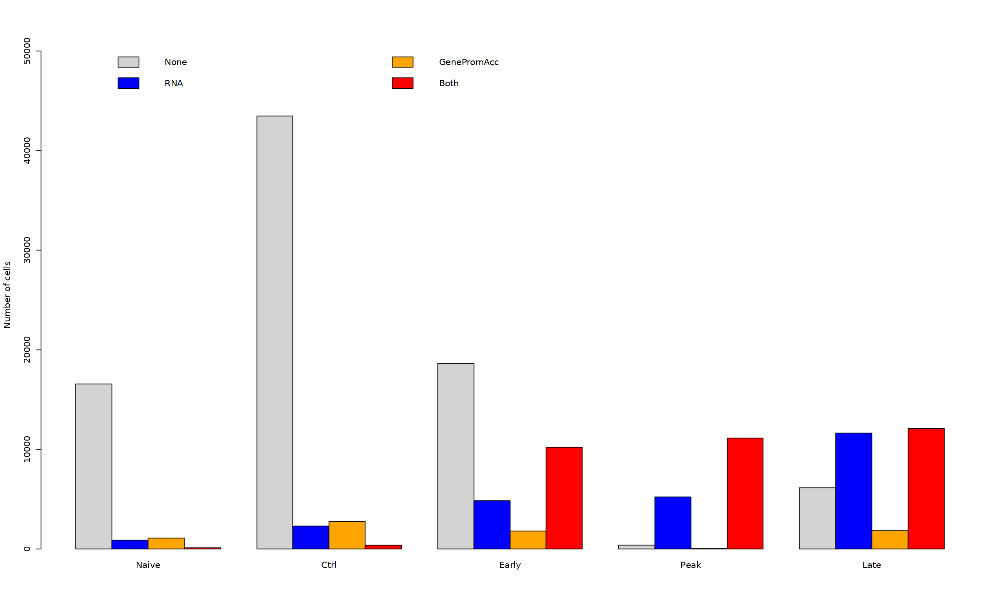

In [446]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+1200, 1000, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

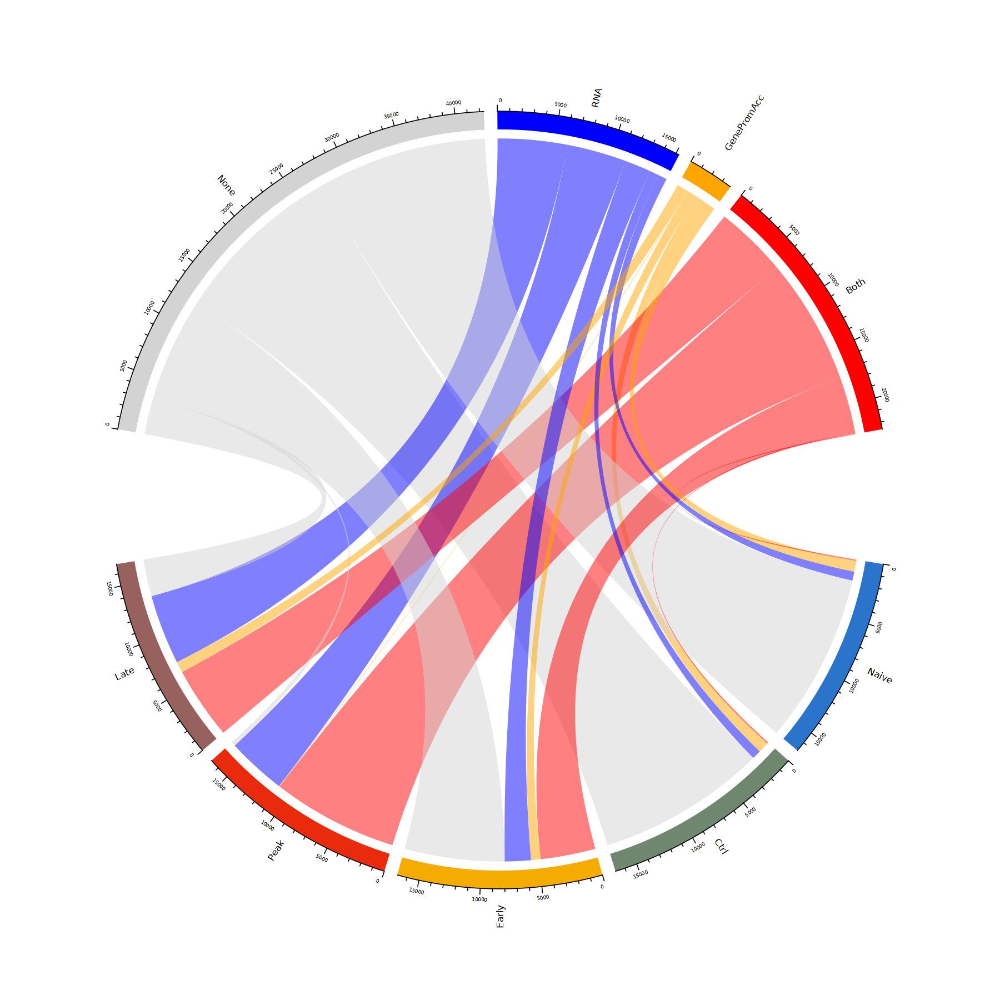

In [447]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$orig.ident_merge))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(modality_colors)), link.zindex = rev(rank(mat)), grid.col=c(rev(modality_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [448]:
t <- table(Cluster=MORNAATACC$model, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

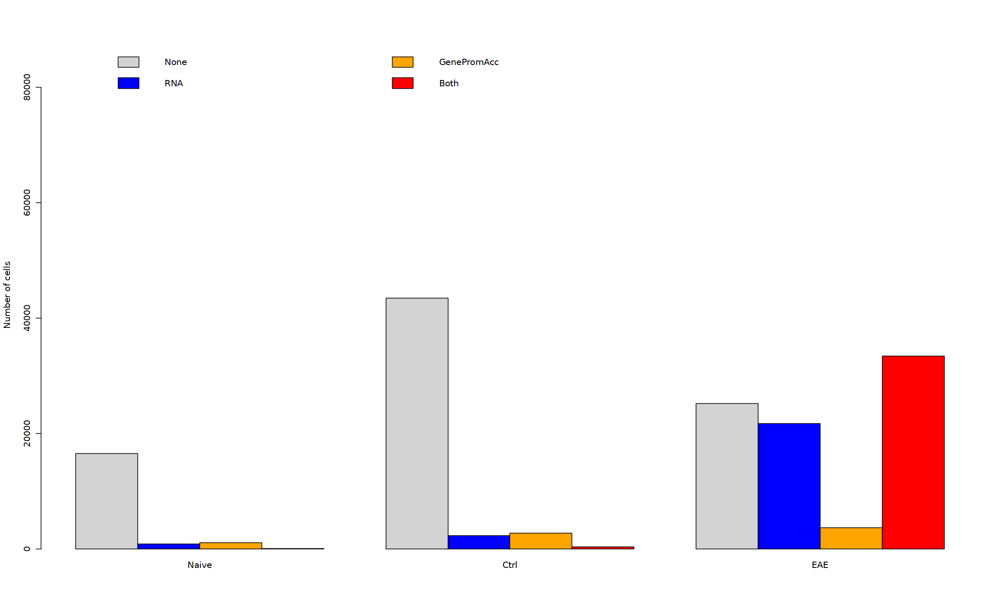

In [449]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Number of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+2000, 2000, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

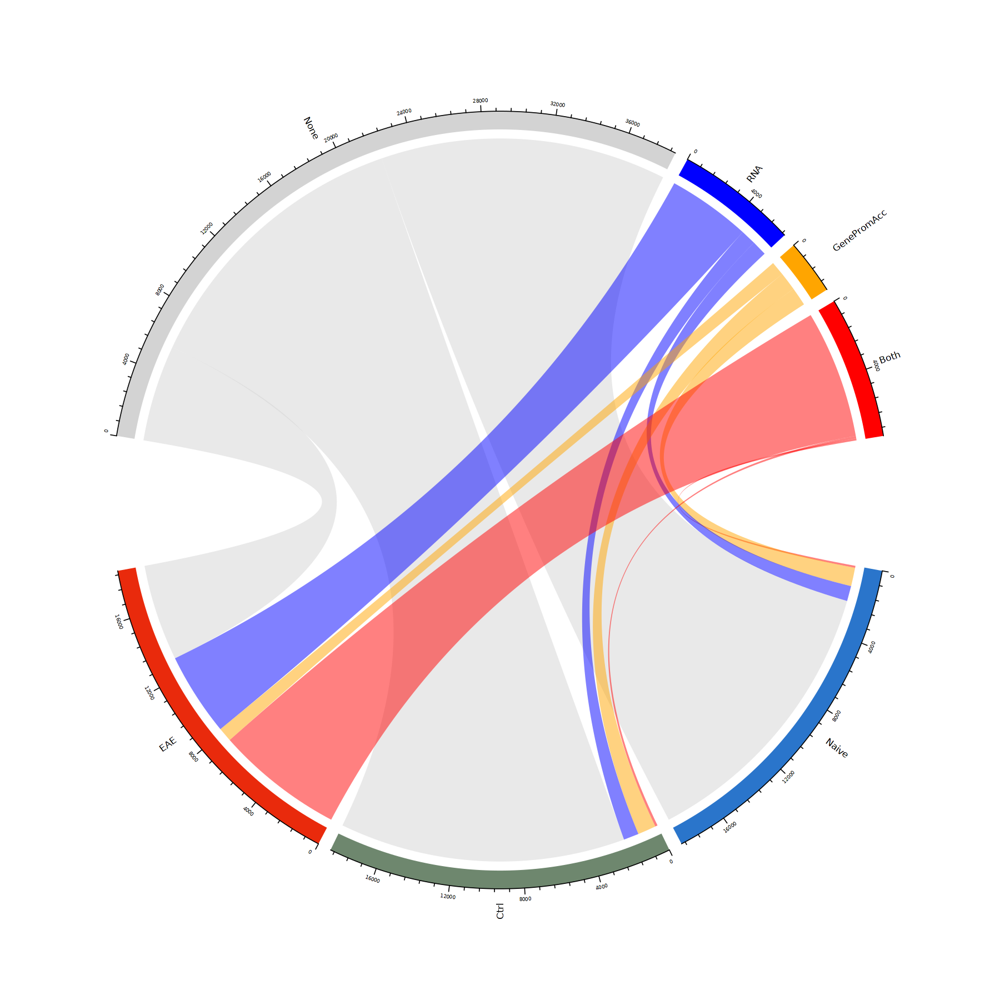

In [450]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$model))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(model_colors), names(modality_colors)), grid.col=c(rev(modality_colors),model_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [451]:
t <- table(Cluster=MORNAATACC$Sex, Batch=MORNAATACC@meta.data[["InterferonAll"]])
t <- t[,names(modality_colors)]

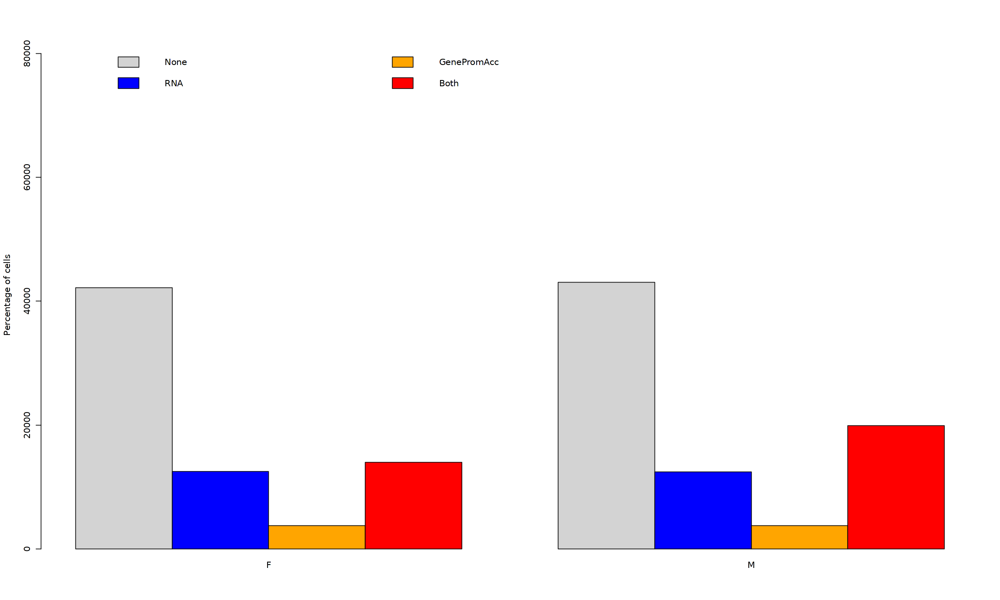

In [452]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t)))+2000, 2000, f = ceiling)), col = modality_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

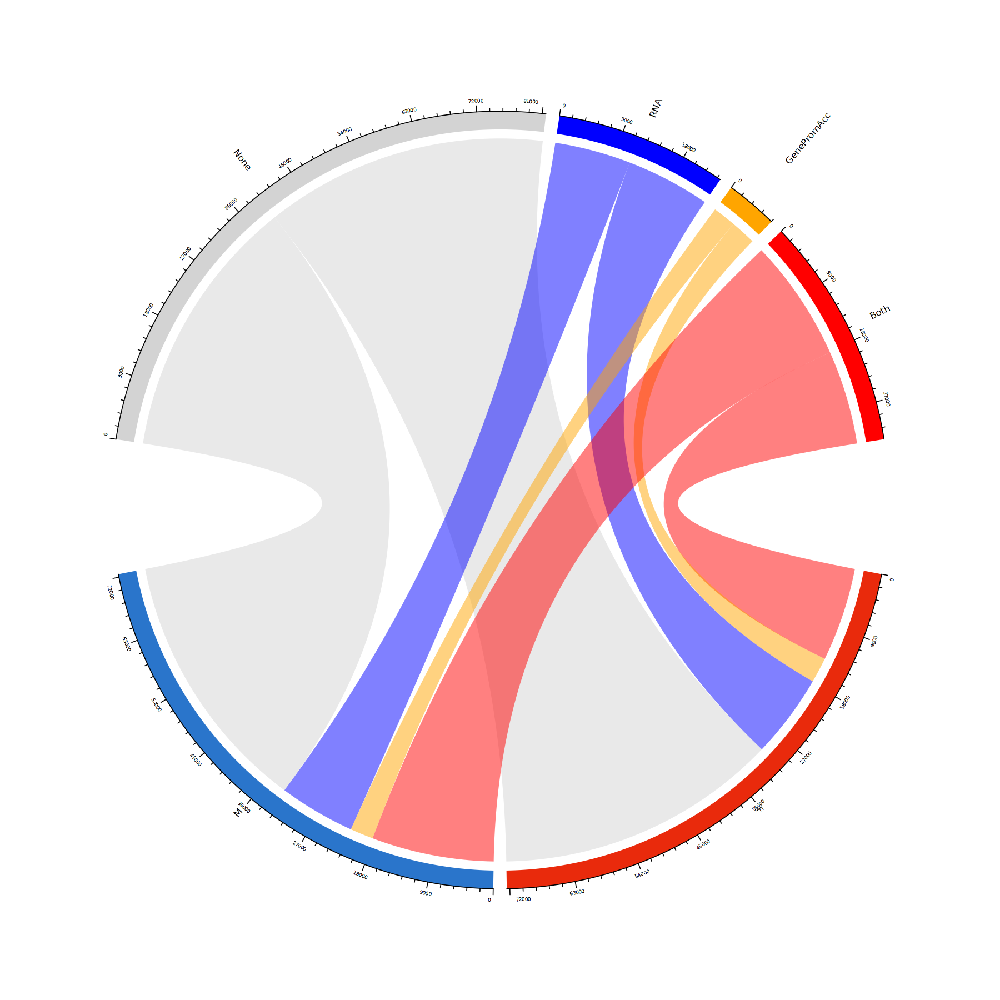

In [453]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$InterferonAll, MORNAATACC@meta.data$Sex))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(sex_colors), names(modality_colors)), grid.col=c(rev(modality_colors),sex_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

[Save](#X.1-Savings)

## X. Checkpoints

### X.1 Savings

In [ ]:
#End
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_6.rds"))

In [14]:
#End
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_6.rds"))